# Initial settings

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
from impzpy import post
from scipy.interpolate import interp1d
from cycler import cycler
import h5py
import xkinterface.interface.PostGenesis13 as PostGenesis
import sys

# Set global styles
font = 22
plt.rcParams['font.size'] = font  # Default font size (affects labels, titles, legend)
plt.rcParams['lines.linewidth'] = 2  # Default line width
plt.rcParams['lines.markersize'] = 10  # Default marker size
plt.rcParams['legend.fontsize'] = font  # Default legend font size
plt.rcParams['xtick.labelsize'] = font  # X-axis tick label size
plt.rcParams['ytick.labelsize'] = font  # Y-axis tick label size
import matplotlib as mpl
mpl.rcParams['savefig.bbox'] = 'tight'

# Define markers, colors, and line styles
markers = ['o', 's', 'p', 'v', 'd', '*', '+', 'D', '>', 'h', 'H', '^', '<', '.', ',']
colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', '#1f77b4', '#ff7f0e', '#2ca02c', 
          '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22']
linestyles = ['-', '--', '-.', ':', (0, (1, 1)), (0, (5, 1)), (0, (3, 1, 1, 1)), 
              (0, (3, 5, 1, 5)), (0, (2, 2, 3, 3, 5, 5)), (0, (1, 10)), (0, (5, 10))]
# Ensure all lists are the same length by repeating or trimming
num_styles = min(len(markers), len(colors), len(linestyles))
markers = markers[:num_styles]
colors = colors[:num_styles]
linestyles = (linestyles * (num_styles // len(linestyles) + 1))[:num_styles]  # Repeat & trim
# Set the default property cycle
plt.rc('axes', prop_cycle=cycler(marker=markers) + cycler(color=colors) + cycler(linestyle=linestyles))


def plot_dotpha(xdat,ydat,bins=64):
    
    # plt.figure(figsize=(8,6))
    plt.plot(xdat,ydat,'.b')
    plt.xlabel("t (ps)")
    plt.ylabel("$\\gamma \\beta_z$")
    
    axis_limits = plt.axis()
    xmin, xmax, ymin, ymax = axis_limits
    
    hist, bin_edges = np.histogram(xdat,bins=bins)
    hist -= np.min(hist)
    y = hist/np.max(hist)*(ymax-ymin) *0.3 +ymin
    
    plt.plot(bin_edges[0:-1],y,'r-')
    
    
    hist, bin_edges = np.histogram(ydat,bins=bins)
    hist -= np.min(hist)
    y = hist/np.max(hist)*(xmax-xmin) *0.3 +xmin
    
    plt.plot(y,bin_edges[0:-1],'r-')
    
    plt.grid()
    plt.axis([xmin,xmax,ymin,ymax])

def plot_heatpha(xdat,ydat,bins=64):
    
    # plt.figure(figsize=(8,6))
    h, xedges, yedges, img = plt.hist2d(xdat, ydat, bins=bins, cmap="jet")
    # Mask zero-count bins
    img.set_array(np.ma.masked_where(h.T == 0, h.T))
    
    plt.xlabel("t (ps)")
    plt.ylabel("$\\gamma \\beta_z$")
    
    axis_limits = plt.axis()
    xmin, xmax, ymin, ymax = axis_limits
    
    hist, bin_edges = np.histogram(xdat,bins=bins)
    hist -= np.min(hist)
    y = hist/np.max(hist)*(ymax-ymin) *0.3 +ymin
    
    plt.plot(bin_edges[0:-1],y,'r-')
    
    
    hist, bin_edges = np.histogram(ydat,bins=bins)
    hist -= np.min(hist)
    y = hist/np.max(hist)*(xmax-xmin) *0.3 +xmin
    
    plt.plot(y,bin_edges[0:-1],'r-')
    
    plt.grid()
    plt.axis([xmin,xmax,ymin,ymax])

In [5]:
from IPython.display import display, HTML

display(HTML("<style>.jp-OutputArea-child { max-height: none; }</style>"))


# IMPT section

## solenoid scan

In [12]:
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg'
os.chdir(workdir)

Isoll = np.arange(350,374+1,2)
Isoll = np.arange(350,370+1,1)

sigxl = []
sigyl = []

enxl = []
enyl = []
for Isol in Isoll:
# Isol=360
    imptpath = f"00_impt_{Isol}A"
    
    filex=np.loadtxt(imptpath+"/fort.24")
    filey=np.loadtxt(imptpath+"/fort.25")
    
    sigxl.append( filex[-1,3]*1e3 )  #mm
    sigyl.append( filey[-1,3]*1e3 )  #mm
    enxl.append(filex[-1,7] *1e6)    #mm mrad
    enyl.append(filey[-1,7] *1e6)    #mm mrad   
    
plt.figure(figsize=(8*2,6))
plt.subplot(1,2,1)
plt.plot(Isoll,sigxl,'-o',label="sigx")
plt.plot(Isoll,sigyl,'-o',label="sigy")
plt.xlabel("solenoid current (A)")
plt.ylabel("rms size (mm)")
plt.grid()
plt.legend()

# plt.figure(figsize=(8,6))
plt.subplot(1,2,2)
plt.plot(Isoll,enxl,'-o',label="enx")
plt.plot(Isoll,enyl,'-o',label="eny")
plt.xlabel("solenoid current (A)")
plt.ylabel("norm. emit. (mm mrad)")
plt.grid()
plt.legend()

plt.savefig("Isol_sigxy_enxy.png")



## beam phase space @booster exit

In [10]:
%matplotlib qt

workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg/00_impt_366A'

# workdir='/lustre/fs22/group/pitz/biaobin/2025/gauss_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-16.0deg/00_impt'
workdir='/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/00_impt'

# flattop with tuning gun phase
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcON_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg_phi1_-30deg/00_impt'

# gauss with tuning gun phase
workdir='/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-32.0deg_phi1_20deg_sigt4ps/00_impt'
workdir="/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/00_impt"

os.chdir(workdir)

def plot_xxp_yyp_zzp(fname):
    pha = np.loadtxt(fname)
    z0 = np.mean(pha[:,4])
    
    z = pha[:,4] - z0  #m
    t = z/2.998e8*1e12 #ps
    
    plt.figure(figsize=(8*3,6))
    
    plt.subplot(1,3,1)
    plot_dotpha(pha[:,0]*1e3,pha[:,1],bins=40)
    # plot_heatpha(pha[:,0]*1e3,pha[:,1],bins=40)
    plt.xlabel("x (mm)")
    plt.ylabel("$\\gamma \\beta_x$")
    
    plt.subplot(1,3,2)
    plt.title(f"Beam @{z0:.2f} m")
    # plot_dotpha(pha[:,2]*1e3,pha[:,3],bins=40)
    # plt.xlabel("y (mm)")
    # plt.ylabel("$\\gamma \\beta_y$")
    plot_dotpha(pha[:,0]*1e3,pha[:,2]*1e3,bins=40)
    plt.xlabel("x (mm)")
    plt.ylabel("y (mm)")
    
    plt.subplot(1,3,3)
    plot_dotpha(t,pha[:,5],bins=40)
    plt.xlabel("z (ps)")
    plt.ylabel("$\\gamma \\beta_z$")

    plt.savefig(f"{fname}.png")

# fname = "fort.40"
# plot_xxp_yyp_zzp(fname)

fname = "fort.90"
plot_xxp_yyp_zzp(fname)

fname = "fort.91"
plot_xxp_yyp_zzp(fname)

(2). heat 2D plot

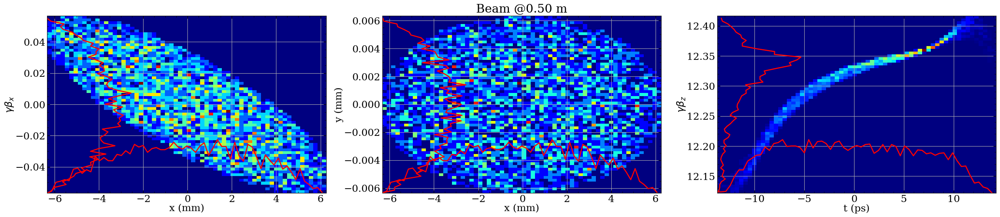

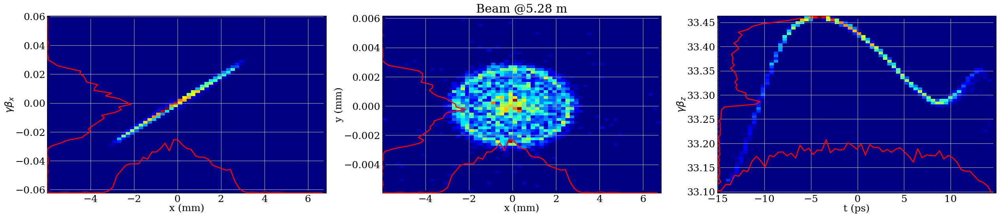

In [68]:
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg/00_impt_366A'
os.chdir(workdir)

def plot_xxp_yyp_zzp(fname):
    pha = np.loadtxt(fname)
    z0 = np.mean(pha[:,4])
    
    z = pha[:,4] - z0  #m
    t = z/2.998e8*1e12 #ps
    
    plt.figure(figsize=(8*4,6))
    
    plt.subplot(1,3,1)
    plot_heatpha(pha[:,0]*1e3,pha[:,1],bins=64)
    # plot_heatpha(pha[:,0]*1e3,pha[:,1],bins=40)
    plt.xlabel("x (mm)")
    plt.ylabel("$\\gamma \\beta_x$")
    
    plt.subplot(1,3,2)
    plt.title(f"Beam @{z0:.2f} m")
    # plot_dotpha(pha[:,2]*1e3,pha[:,3],bins=40)
    # plt.xlabel("y (mm)")
    # plt.ylabel("$\\gamma \\beta_y$")
    plot_heatpha(pha[:,0]*1e3,pha[:,2],bins=64)
    plt.xlabel("x (mm)")
    plt.ylabel("y (mm)")
    
    plt.subplot(1,3,3)
    plot_heatpha(t,pha[:,5],bins=64)
    plt.xlabel("t (ps)")
    plt.ylabel("$\\gamma \\beta_z$")

    plt.savefig(f"{fname}.png")

fname = "fort.90"
plot_xxp_yyp_zzp(fname)

fname = "fort.91"
plot_xxp_yyp_zzp(fname)

## current profile

(1). Initial beam current profile

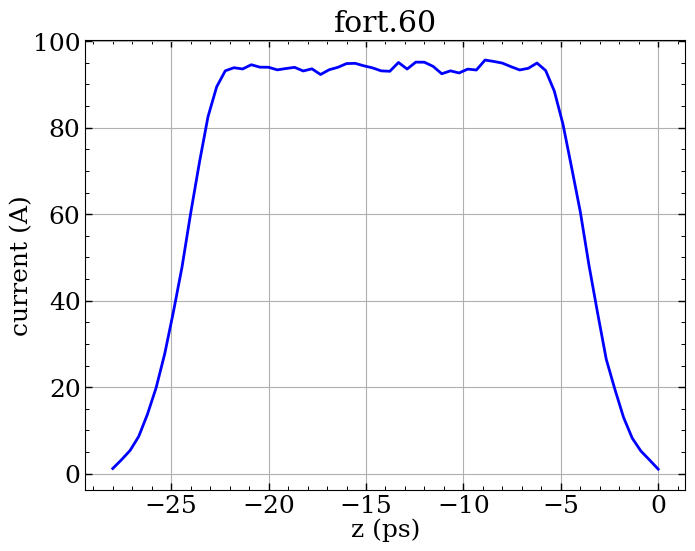

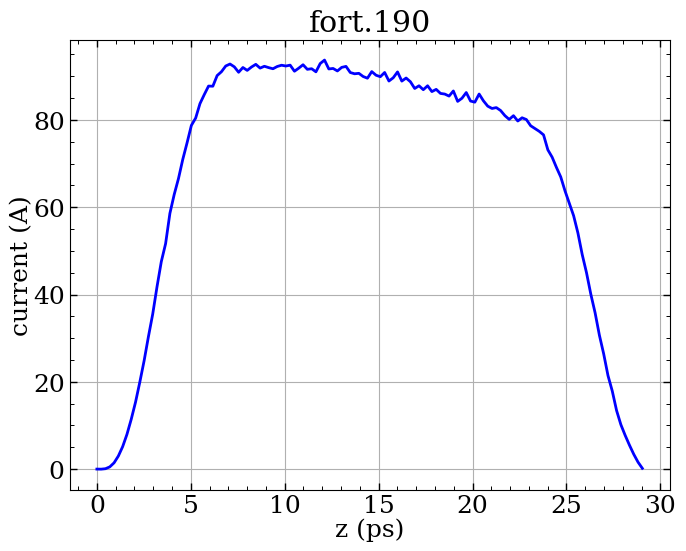

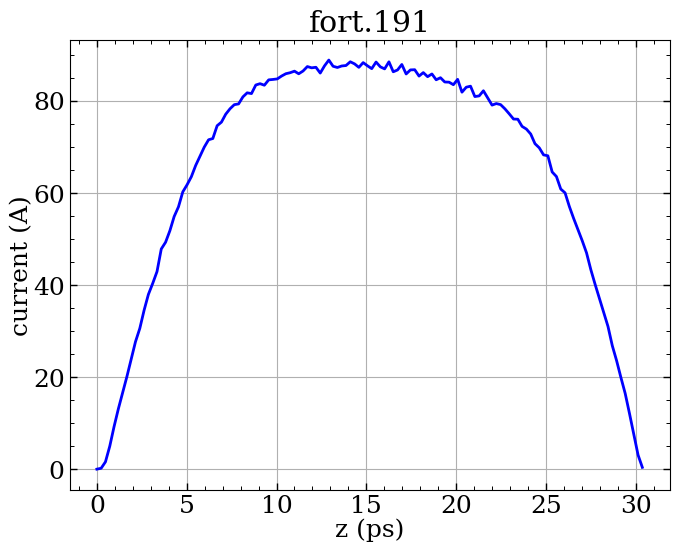

In [8]:
# %matplotlib qt
%matplotlib inline
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg/00_impt_366A'
os.chdir(workdir)

mass = 0.511001e6
clight=2.998e8

def plot_current(fname, Ekin=16.5e6, shift=False):
    gam = (Ekin+mass)/mass
    gambet = np.sqrt(gam**2-1)
    bet = gambet/gam
    
    pha = np.loadtxt(fname)
    z = pha[:,0]
    t = z/(bet*clight)*1e12 #ps

    if shift==True:
        t -= np.min(t)
    
    plt.figure(figsize=(8,6))
    plt.plot(t,pha[:,2],'-')
    plt.xlabel("z (ps)")
    plt.ylabel("current (A)")
    plt.grid()
    plt.title(f"{fname}")

Ekin = 1
fname = "fort.60"
plot_current(fname, Ekin=Ekin)

Ekin = 5.80e6
fname = "fort.190"
plot_current(fname, Ekin=Ekin,shift=True)

Ekin = 16.5e6
fname = "fort.191"
plot_current(fname, Ekin=Ekin, shift=True)

## Ekin along the line

Text(0.5, 1.0, 'fort.18')

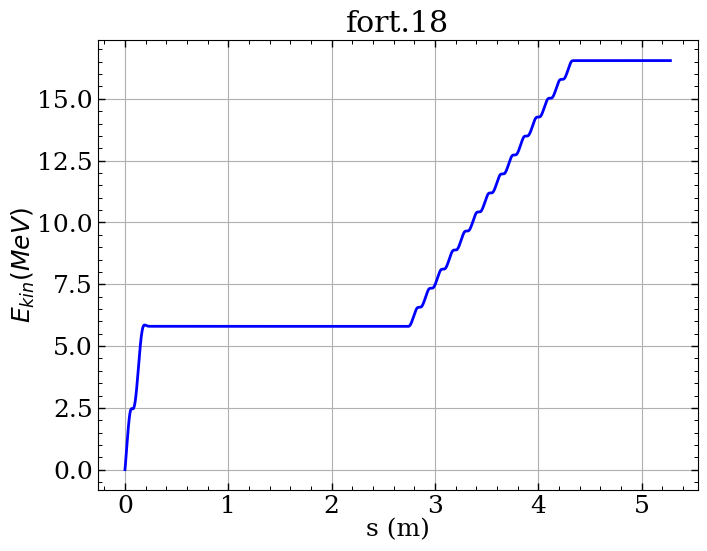

In [9]:
%matplotlib inline
# %matplotlib widget
    
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg/00_impt_366A'
os.chdir(workdir)

fname = "fort.18"
pha = np.loadtxt(fname)

plt.figure(figsize=(8,6))
plt.plot(pha[:,1],pha[:,3],'-')
plt.xlabel("s (m)")
plt.ylabel("$E_{kin} (MeV)$")
plt.grid()
plt.title(f"{fname}")


## rms size and emittance

(0.0, 10.0)

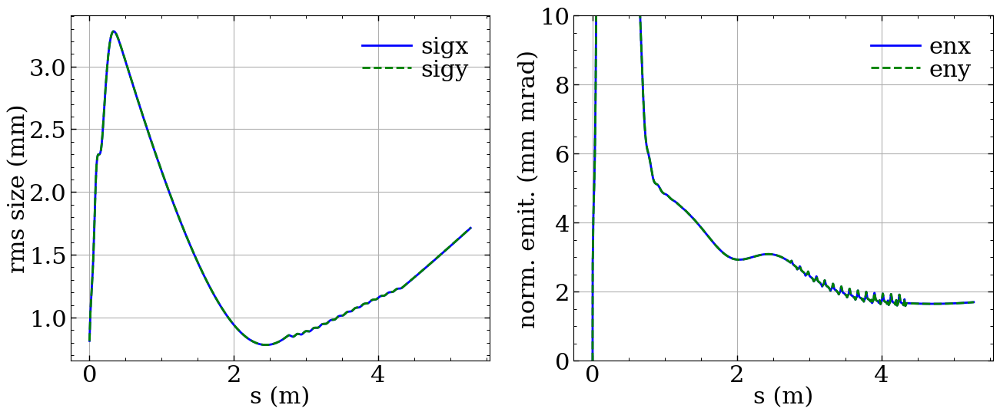

In [13]:
%matplotlib inline

workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-12.0deg/00_impt_366A'
workdir="/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/00_impt"
# workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcON_4nC/Np_5.24e+06_phi1_0deg_phi2_-18deg/00_impt'

os.chdir(workdir)

fnamex = "fort.24"
fnamey = "fort.25"
phax = np.loadtxt(fnamex)
phay = np.loadtxt(fnamey)

plt.figure(figsize=(16,6))
plt.subplot(1,2,1)
plt.plot(phax[:,1],phax[:,3]*1e3,'-',label="sigx") 
plt.plot(phay[:,1],phay[:,3]*1e3,'--',label="sigy") 
plt.xlabel("s (m)")
plt.ylabel("rms size (mm)")
plt.legend()
plt.grid()

plt.subplot(1,2,2)
plt.plot(phax[:,1],phax[:,7]*1e6,'-',label="enx") 
plt.plot(phay[:,1],phay[:,7]*1e6,'--',label="eny") 
plt.xlabel("s (m)")
plt.ylabel("norm. emit. (mm mrad)")
plt.legend()
plt.grid()
plt.ylim([0,10])

# IMPZ section

## rms size evolution

### impz 

In [63]:
%matplotlib qt
# rms-evo
workdir='/mnt/d/NextCloud/subjects/2025/202502_Experiment/flattop_bcOFF_2nC/02_matchedLattice_impz'
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-10.0deg/01_impz'
twi = post.twissplot(path=workdir)
    
twi.plot_rms(enxy='ON')

twi.plot_twiss()
# plt.savefig("phi2="+str(deg)+"deg-"+"rmsevo.png")

### genesis-4
How about the beam size evolution inside the undulator in Genesis simulations:

In [1]:
workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-10.0deg/02_gen4'

os.chdir(workdir)
fname = 'gen4.seed5.nper5.fitdeg1.out.h5'
pg = PostGenesis(fname, debug=0, version=4, fig_ext = '.png')

z = pg.zplot
current = pg.current[1:]

version=4
if version < 4: # version 2 or 3
    xx = pg.get_fielddata('xrms')
    yy = pg.get_fielddata('yrms')
    xrms = (xx[:,1:] @ current)/np.sum(current); #print(xrms)
    yrms = (pg.get_fielddata('yrms')[:,1:] @ current)/np.sum(current)
    
    #xrms = np.mean(xx[:,1:], axis = 1); #print(xrms)
    #yrms = np.mean(yy[:,1:], axis = 1); #print(xrms)

else: # version 4
    nn = np.sum(current>0)
    xrms = (pg.get_data('Beam', 'xsize')[:,:nn] @ current[:nn])/np.sum(current)
    yrms = (pg.get_data('Beam', 'ysize')[:,:nn] @ current[:nn])/np.sum(current)
    # xrms = (pg.get_data('Beam', 'xsize')[:,:nn])
    # yrms = (pg.get_data('Beam', 'ysize')[:,:nn])

fig, ax = plt.subplots(figsize = (10, 8))

ax.plot(z, xrms*1e3, 'r-')
ax.plot(z, yrms*1e3, 'b-')
# ax.plot(z, npdata:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAzIAAAKVCAYAAAAUW97PAAAAOXRFWHRTb2Z0d2FyZQBNYXRwbG90bGliIHZlcnNpb24zLjguNCwgaHR0cHM6Ly9tYXRwbG90bGliLm9yZy8fJSN1AAAACXBIWXMAAA9hAAAPYQGoP6dpAAEAAElEQVR4nOydd3hUVdfF18wkIaGEGghVehNBOoL03qsgNhRBBUUQEAWCtAgoiAhIFwFBBOlShVAFRYogoNLbSw01oafc94+Vkzt3WnpmQvbveXzenDO3nHsTvu+s2XuvbdI0TYMgCIIgCIIgCEIawuzuBQiCIAiCIAiCICQUETKCIAiCIAiCIKQ5RMgIgiAIgiAIgpDmECEjCIIgCIIgCEKaQ4SMIAiCIAiCIAhpDhEygiAIgiAIgiCkOUTICIIgCIIgCIKQ5hAhIwiCIAiCIAhCmsPL3QtIDaKjo3H58mVkyZIFJpPJ3csRBEEQBEEQBMEBmqYhPDwc+fLlg9nsOuaSLoTM5cuXUbBgQXcvQxAEQRAEQRCEeHDx4kUUKFDA5THpQshkyZIFAF+Iv79/oq4REBCA0NDQJK9l//79aNiwIUJCQlClSpUkXy+51pVc1/HUa3nqe08P15J3775rpYd374lrSg/v3VOvJe/efdeSd++eaz2N7z0sLAwFCxaM3b+7Il0IGZVO5u/vn2ghYzKZEn2uNZkzZ4793+S4XnKtK7mu46nX8tT3nh6uJe/efddKD+/eE9eUHt67p15L3r37riXv3j3Xeprfe3zKQdJVsX9AQAB8fX3h6+uL4OBgdy9HEARBEARBENI9wcHBsXv0gICAeJ+XLiIyitDQ0EQrw6CgoGReTfKQXOtKzufz1GslJ576jJ56reTEU5/RU6+VnHjiM3rimpIbT31GT71WcuKpz+ip10pOPPUZPfVayYW7ni8oKCj2+LCwMGTNmjVe55k0TdMStbo0hHohd+/eTbZwWWL5888/Ub16dezduxfVqlVz61rSE/Le3Ye8e/ch7949yHt3H/Lu3Ye8e/fwNL73hOzb01VqmSAIgiAIgiAITwciZFKZwMBAdOnSBYGBge5eSrpC3rv7kHfvPuTduwd57+5D3r37kHfvHtL7exchk8rkzZsXXbt2Rd68ed29lHSFvHf3Ie/efci7dw/y3t2HvHv3Ie/ePaT39y5CRhAEQRAEQRCENIdHCJkZM2bAZDJhxIgR7l6KIAiCIAiCIAhpALcLmdu3b2PYsGEJOufx48cYMmQISpUqhfLly6Nq1apYu3ZtCq1QEARBEARBEARPw+1CZtiwYahVq1aCzunWrRtWrlyJ3bt34++//8awYcPQrl07rF+/PoVWKQiCIAiCIAiCJ+FWIXPkyBEsX748QSllO3fuxJIlSzBixAjkypULANCmTRs0atQIH374IdJBWxxBEARBEARBSPe4Vcj06dMHo0aNQrZs2eJ9zpIlSwAADRs2NMw3atQIp0+fxoEDB5JziYIgCIIgCIIgeCBuEzJLlixBeHg43n777QSdd+jQIfj7+8dGYxRFixaN/VwQBEEQBEEQhKcbL3fc9MGDBxg0aBB+/PFHmM0J01KhoaHw9/e3m1dzoaGhTs/dv38/MmfObDcfGBiYav7bERERhv8VUgd57+5D3r37kHfvHuS9uw959+5D3r17SMvv/cqVK7h69ard/L179+J9DbcImbFjx+LFF19McJG/K1RtjMlkcnqMbTqaokuXLujatWuyrSU+bN68OVXvJxB57+5D3r37kHfvHuS9uw959+5D3r17SIvvffHixbElI4kl1YXM2bNnMX36dBw+fDhR5+fKlQvHjh2zmw8PD4/93BkhISEeEZHZvHkzGjduDG9v71S5pyDv3Z3Iu3cf8u7dg7x39yHv3n3Iu3cPafm9V6xYEf3797ebv3fvntPggy2pLmS2bNmCTJkyoWXLlrFzT548AcDGmKtWrULx4sWxbNkyh+c///zz+P3333Hz5k3kzJkzdv7MmTMAgAoVKji9d5UqVRympbkDb2/vFPuDu3LlCkqUKIFWrVrhp59+ip1fu3Yt2rdvj0GDBuHzzz9PkXt7Oin53gXXyLt3H/Lu3YO8d/ch7959yLt3D2nxvRcqVAiFChWymw8LC4v3NVK92L9nz544f/48Dh06FPuf6v/y3nvv4dChQ7EiJioqCtevXzec37lzZwCMrlgTEhKCokWLokqVKqnwFJ5N3rx5MWjQICxdujTWxW379u146aWX0KtXr3QrYgRBEARBEISnB7fUyMSX3r17Y86cOdi1axdq1qwJAKhXrx46deqEESNGoEGDBsiVKxfWrl2LzZs3Y+XKlS5rZBJFlSqAg0KkxOIFoMmjR/Dy9U38RQIDgf37XR4ycOBAzJw5E5988gnGjh2LNm3aoGvXrvjmm28Sf19BEARBEARB8BDcKmTu3LmDevXq2aWW9e/fH2+88Qby5MmDbNmy2aWD/fDDDxgxYgRq1aqFDBkywNvbGytWrEDr1q2Tf5FXrwKXLiXb5UwA/JLtas7JmDEjgoOD0b17d9SvXx8tW7bE7Nmzk1/oCYIgCIIgCIIbcKuQyZYtm8u+L6NGjcKoUaPs5n19fTFu3DiMGzcuBVcXQ2Bgsl5OA/Do0SP4+voi0ZIinmsqWbIkADq5zZs3DxaLJbF3FARBEARBEASPwqNTyzyCOFK4EkpkRAR+Xb8eLVq0SNGirEOHDqFVq1aoVasWdu/ejblz5+L9999PsfsJgiAIgiAIQmqS6sX+Qspz/PhxNG3aFC+88AK2bduGtm3bYsSIEbh79667lyYIgiAIgiB4IhcvAkOGAJGR7l5JvBEh85Rx7tw5NGrUCKVKlcLy5cvh7e2NcePG4fbt2xgzZoy7lycIgiAIgiB4GmFhQMuWwNixQNu2wL177l5RvBAh8xRx5coVNGrUCLlz58batWvh50dbgdKlS6N79+745ptvcO7cOfcuUhAEQRAEQfAcIiKAl14Cjhzh+L//gIcP3bumeCI1Mk8RefPmxalTpxx+NmvWLMyaNSuVVyQIgiAIgiB4LJoG9O4N/PorxzlyABs2AAEB7l1XPJGIjCAIgiAIgiCkR8aNA+bM4c8+PsCqVUCM621aQISMIAiCIAiCIKQ3Fi9mcb9i3jygdm23LScxpCshExAQAF9fX/j6+iI4ONjdyxEEQRAEQRCE1GfXLuDNN/XxmDFA165uW05wcHDsHj0gAWlt6apGJjQ0FP7+/u5ehiAIgiAIgiC4h+PHgXbtgCdPOO7RA/j0U7cuKSgoCEFBQQCAsLAwZM2aNV7npauIjCAIgiAIgiCkW0JDgRYtgFu3OG7SBJg2DTCZ3LuuRCJCRhAEQRAEQRCedh4+BNq0Ac6c4fi554Cffwa8vd27riQgQkYQBEEQBEEQnmaio4HXXwf++IPjfPmAdeuANF5yIUJGEARBEARBEJ5mPvkEWL6cP2fOTBFTsKDxmIMHgebN9bSzNIAImaeQDh06oECBAnbzkZGReP7559G4cWM3rEoQBEEQBEFIdaZNAyZM4M8WC7B0KfD888ZjTp2iiNm4EahTB7h6NdWXmRhEyDyF1KlTB5cuXcL58+cN8xMnTsR///2HadOmuWllgiAIgiAIQqqxbh3Qp48+/vZbChZrrl5l0f/16xxnzAjE0zXM3aQr++VEUaVKsqpSLwBNHj2Cl69v4i8SGAjs3+/04zp16gAA9uzZg2eeeQYAcPbsWYwcORJDhw5FiRIlEn9vQRAEQRAEwfM5eBDo0oX1MQAwaBDw7rvGY+7eBZo1A86e1ecuXqSoidlDejIiZOLi6lXg0qVku5wJgF+yXc0xzz//PPz9/bF79250jWlu1KtXLxQsWBCffPJJCt9dEARBEARBcCsXLgCtWgH373P80kvA2LHGYx49Yj+Zw4eN8xUrAg5KFDwRETJxERiYrJfTADx69Ai+vr5ItGN3HGsym82oWbMm9uzZAwBYtGgRNm3ahG3btsHHxyexdxUEQRAEQRA8nbt3gZYtgStXOK5ZE5g/HzBbVZRERQGvvgps325//okT/CI/f/5UWW5SECETFy5SuBJDZEQEfl2/Hi1atIB3Cvp216lTB8OGDcOFCxfQv39/dOvWDfXq1Uux+wmCIAiCIAhuJiIC6NQJOHqU4+LFgdWrAT+rfCBNA95/H1ixwvE1nnkGCAhI+bUmA1Ls/5RSp04dREVFoVWrVoiKisIE5VYhCIIgCIIgPH1oGvDee8CWLRznzAmsXw/kymU8buRIYOZMx9d49lnaNKeRDB6JyDylVK1aFX5+fjhy5Ajmzp2LXLZ/xIIgCIIgCMLTw5gxwNy5/DlDBkZibA2epk+nkHFEQABtmZNiSJXKpKuITEBAAHx9feHr64vg4GB3LydFMZvNyJ49O2rXro0333zT3csRBEEQBEEQUgjTjz8CQUH6xPz5QK1axoOWLWNKmSMyZaKAWbQIaNwYuHkz5RbrgODg4Ng9ekAC0trSVUQmNDQU/v7+7l5GqjBp0iTcuHEDW7ZsgcmUaFsBQRAEQRAEwYPJefQoLKNG6RPjxtF22ZqtW1ncr2n2FzCbgUKFgH//5fj0acArdSVCUFAQgmKEWFhYGLLGs49NuhIyTzsPHjzA4cOHsW/fPgwdOhSff/45ypQp4+5lCYIgCIIgCCnBf/+h2rhxMD15wvE777BfjDV//UWbZXWMLRUrAgcO6OMbN4Bbt9JEU0wRMk8Rv/76K9q3b4/AwEAMGTIEAwcOdPeSBEEQBEEQhJTg+nV4tW0L0717HDdrBnz7LWCdiXP6NNC8ORAe7vgaNWoAf/xhnFu4EChSJGXWnMyIkHmKaNeuHTRHIUNBEARBEATh6eHBA6BNG5jOngUAaOXLw7R0qTEl7No1oEkT/q8jqla1FzGTJwOdO6fQopOfdFXsLwiCIAiCIAhpmqgo4LXXgL17AQAPc+ZE5KpVQJYs+jFhYYzEnDnj+BrPPWdMJwOATz8F+vRJmTWnECJkBEEQBEEQBCGtMGgQsHIlAEDLnBl/BAUBBQronz9+zJqYv/5yfH6RIsCpU0B0tD73xhu0b05jSGqZIAiCIAiCIKQFpk4FJk7kzxYLohYvRlhUlP65itZs2+b4/IAA1ss8fKjPNW0KzJljrK1JI0hERhAEQRAEQRA8nV9+Afr21cfTpkFr2lQfaxrw4YfsF+OIjBmBzJnpSqaoVInHe3unzJpTGBEygiAIgiAIguDJHDgAvPyyng726ae0WrZm9Ghg2jTn1yhRAogxBwDAFLMNGyhu0igiZARBEARBEATBUzl/HmjVik5lAJtdfv654RDz7NnA8OHOr1GzJnD4sD7OkQPYsgXInTsFFpx6iJARBEEQBEEQBE/kzh2gZUvg6lWOa9UC5s0DzPoWPu/vv8Psym2sTh1gzx597OcHbN4MFC2aIktOTUTICIIgCIIgCIKn8eQJ0LEjcOwYxyVKAKtWAb6+sYeYduxA5a++gsnagcyaGjWAnTv1sdkMrF7N2pinAHEtEwRBEARBEARPQtOAd98Ftm7lOGdOYP16IFcu/ZhDh2Dp2BGmyEjH1yhfHti/3zi3YAHQuHHKrNkNpKuITEBAAHx9feHr64vg4GB3L0cQBEEQBEEQ7AkOZgoZAGTIAKxZAxQvrn9+5gzQvDlMYWEAAM32/CJFgNOnAWuRM3488OqrKbnqRBMcHBy7Rw8ICIj3eekqIhMaGgp/f393L0MQBEEQBEEQHLNwIfDZZ/r4hx9YrK+4fp29X2LqZjSTCSbNSsrkygXcv8//FP36AQMHpuy6k0BQUBCCgoIAAGFhYciaNWu8zktXERlBEARBEARB8Fi2bwe6d9fHX34JvPSSPg4PB5o3B06dAgBoXl5GEePrC2TPTrGj6NQJ+OqruO/95Amwbl3S1p/KiJARBEEQBEEQBHfz779A+/ZARATH771njKI8fszPDx7k2Nvbvj6mbFng5El9XKsWIzzmOLb8UVHAG2/Q5vmLL5L+LKmECBlBEARBEARBcCfXrgEtWtBuGWDUZcoUwGTiODqaQiMkhGNvb13wKOrU0UUOAJQqRYOADBlc31vTgF69gCVLOB4xgjU4aQARMoIgCIIgCILgLh48AFq3Bs6d4/j55ykqvGJK2TUN6NsXWLqUYy8vOxETXa+e0WY5Tx6mqcVVG65pwKBBwOzZ+twXX6SZHjMiZARBEARBEATBHURF0Uls3z6OCxQA1q4FsmTRjxkzBpg6lT+bzUYnMgA3S5eGaft2fSJzZoqawMC47z92LDBhgnFu6FDg7NmEP4sbECEjCIIgCIIgCO5g4EA2uQQoXtatA/Ln1z+fPRuIcfMCwAiKFdHlyyP7yZMwqQkvL2DLFqBkybjvPXUqRYst3boBhQsn4CHchwgZQRAEQRAEQUhtJk8GJk3izxYLsGwZm1gqVq5kwb/Cx8coZIoUgen0aZijojg2mXhO9epx33vBAqBPH/v59u2Bb77Ra3M8HBEygiAIgiAIgpCarF7N3i6KGTOAJk308c6dQNeuLPIHgEyZaI+syJEDePAAJuteMTNn0nUsLlatMlo8K2rWBBYtoqhKI4iQEQRBEARBEITUYt8+ihQVXRkyBOjRQ//877+BNm1otwywL4y1YMmQAciZk05nMUQNHgz07Bn3vUNCgC5dWJtjTcmSwJo1gJ9fIh/KPYiQEQRBEARBEITU4Nw5OpQ9fMhx167A6NH652fPAk2bAnfvchwQANy+bbxGuXKGXjEX6tZF9IgRcd/7jz+Atm2NkR2ADmcbN1IcpTFEyAiCIAiCIAhCSnPnDnvFqEhK7drA99/rzSqvX6eIuXqV4zx5gNBQ4zXq1gUOHIgdRtepg78+/DDumpa//2ZvGuvIDsCUtXXrgCJFEv9cbkSEjCAIgiAIgiCkJE+eAB06AP/+y3HJkizMV80qw8OBli31SEvu3IbUMQBA/frAjh36uEwZRK1dG3dNy8mTrL9RzTYVymCgcuVEP5a7SVdCJiAgAL6+vvD19UVwcLC7lyMIgiAIgiA87Wga61e2beM4Vy5g/Xo9lUuJnP37Oc6Zk9EZa2rV0s8H2CNmzx7A19f1vS9eBBo1shdFAK2dmzVL3DMlM8HBwbF79ICAgHif55WCa/I4QkND4R9Xh1NBEARBEARBSC5GjaLdMUDhsWYNUKwYx9HR7NuyZQvH/v726V8VKgB79+rjzJlpGJAtGxAR4fy+oaFA48bAhQscm0y6wcDIkcBbbyX50ZKLoKAgBMX0ywkLC0PWrFnjdV66isgIgiAIgiAIQqoxfz6gCvFNJmDhQuCFFzjWNOCjj4CffuLY1xfw9gYePdLPL1yYqWGRkRx7ewO7dwMFCri+7927rLc5fpxjs1kXMT17AsOGJcfTuR0RMoIgCIIgCIKQ3GzdarRVHj8e6NhRH48bx6aYAOtVAgOBmzf1z3PkAO7dAx484NhkYmG+ddNMRzx4wH4yf/2lX1v1o2nRApg2Lc00vIwLETKCIAiCIAiCkJz88w/rXlQkpVcvoH9//fPvvmP/GEXZsrRmVvj4AFmzAjduGM9p3Nj1fVW9zW+/cWyx6D1jqlQBliwBvJ6eyhIRMoIgCIIgCIKQXFy9ysiH6gXTogUjLyoKsmYN8M47+vE1agBHjhivUbYse8ooPvss7pqWqCjg1VeBTZs4thYxRYsympM5c+KfywMRISMIgiAIgiAIycH9+2x4ef48xxUrGqMgu3YBXbroqV5167JRpTW1agGHDunj119ncb4rNI3iaNkyjs1mXcTkysWGl7lzJ+nRPBERMoIgCIIgCIKQVKKigFde0W2UCxQA1q7VoyBHjgBt2ujF/HXrGvvCAGySuXu3Pq5Th4YBrtA0mAcNAubO5dhk0oWSnx/XUKJE0p7NQ0n1JLkLFy5gxowZ2Lx5M6Kjo/Hw4UN4e3vj7bffRp8+fWByUXx07tw5lCtXDsWLF7f7bMqUKahdu3ZKLl0QBEEQBEEQHNO/P9PGACBLFvaKyZeP4/Pn2bNFNaV84QWjpTIAVK/OiI2iZEkgJCTOwvySS5fCsngxB9YWy2YzHdGqV0/ac3kwqS5ktm7diilTpiAkJATVqlUDAKxevRodOnRAeHg4hg4d6vL8KlWqYPv27amwUkEQBEEQBEGIB998ozuQeXkBy5cDzz3H8Y0bQJMmwOXLHD//PHD6tNFm+dln2RtGERAAHDwYZ2G+ecoUlFEixpZvv2UE6Ckm1VPLAgMDMXDgwFgRAwBt27ZFuXLlsHz58tRejiAIgiAIgiAkntWr2Q9GMWOG7i527x6L/U+c4LhECQqY69f14wsVAk6d0tPBMmYE/v4byJTJ9X3nzYNlwAB97OWlR2OGDAHeey9pz5UGSPWITLNmzdCsWTO7+fDwcJR4SvP3BEEQBEEQhKeQffuArl11ATF0KPD22/z5yRP2jVGRlnz5+J91XUy2bHQ3e/yYYy8v4Pff2VPGFStW6PcBoPn5wfTwIQdvvAEEByf92dIAbjeSDg8Px5gxY3D//n2MHTs2zuOvXbuGN954A0ePHkV4eDjKlCmDDz/8EI0aNYrz3P379yOzA9u5wMBA5M2bN1HrTygRERGG/xVSB3nv7kPevfuQd+8e5L27D3n37iNdvvuzZ+HVqlWsgIh++WVEffYZEBEBREfD8uabMP/6KwBAy5YN0bVqwfLzz7Gna97egJ8fTFeucGwyIXLFCqBMGV7DCabNm2F5+WWYYiI4EX5+8FZraNgQUdOm6f1rPJgrV67g6tWrdvP37t2L9zVMmqYkZOpTtmxZnDhxAqVLl8bMmTNRq1Ytl8dfvHgRjRo1wqxZs/Diiy8iIiICY8aMQXBwMGbNmoUe1t1TrQgLC0PWrFmdXrdLly7o2rVrkp5FEARBEARBSB9437uH2p9+iiz/+x8A4EbZsvh95EhEe3sDmoZyc+ei2C+/AACifHxwrlEjFFu/PvZ8DcC9/PmR5dKl2PHh997DeQdZS9bk+PdfvDBiBLxiIjhPMmeGT8zG/06RItj9+eeIzJgxmZ82ZVi8eDGWLFni9PO7d+/C39/f5TXcKmQA4MmTJ1i4cCF69eqF4OBgfPzxxwm+RtWqVXHy5Elcu3YNGTJksPtcCZmQkBCPiMhs3rwZjRs3hre3d6rcU5D37k7k3bsPeffuQd67+5B37z7S1bt/8gSWli1hjkkR00qWROTOnUCOHAAA8/jxsMSYV2lmM6I//hjmL7+EyWrLHV2xIsx//cVjAEQPGIDouDKTDh2CV+PGMMU02tRy54YpptYmumBBRO3apbukpQFcRWQaNmwYLyHj9tQyHx8fdO/eHb///jsGDx6MDh06oFixYgm6xgsvvID9+/fj2LFjqFSpktPjqlSpEucLSS28vb2f/n/oHoi8d/ch7959yLt3D/Le3Ye8e/fx1L97TWNtiqpzCQiAacMGeOfJw/H337NOJgbTkCGwTJig19AAQNWqMFs5lJk6doRlwgRYXN33xAmgZUvW0wBAvnwwxbigPcmUCaa1a+H9zDPJ8ICpR6FChVCoUCG7+bCwsHhfI9Vdyx4+fIgo1WnUiueffx5RUVE4ePCg03Pv3r2Lh6qQyQqLhb/6yDSQDygIgiAIgiCkUUaOBH74gT/7+rJvTNGiHP/yC9Czp37soEHArFlGm+UKFYw2y1WqAMuWub7nhQtAo0ZAaCjH+fPHWjlrGTJg75AhrKtJh6S6kGnevDmWLl1qN3/+/HkAQK5cuQAAUVFRuG5tTQegb9+++Prrr+3OPXDgAPz8/PDss8+mwIoFQRAEQRCEdM/8+RQyABtPLlwI1KjB8e7dQOfOgPqy/r33gLVrjTbLJUrQVllRsCAdylxx7RqtnC9e5Dh/fiCmrgYmE6LmzcOt5Nr/RkQAMeYEaYVUFzIAMHbs2FjhAgA7duzAtGnTUK1aNdSpUwcA0Lt3b+TNmxd79uwxnDt9+nScUF7cMeNdu3YhKCgImeLy2xYEQRAEQRCEhBISAlibSk2YQGtlADh2DGjVSo+8vPwycOYM8M8/+vF58wJnz+opZlmzUtS4anh5+zbQtKnegyZfPsC6puTrr6GpNSSV6GjgzTd5v6++Sp5rpgKpXiMzZswYfP/992jZsiXMZjPu378PHx8f9OnTB4MHD45NE8uTJw+yZctmqGkZMGAAsmXLhk6dOsFkMuH27dvIly8fFixYgNdffz21H0UQBEEQBEF42jl2jKJFlTC8/77eAPPCBW7+79zhuHFjIHNm4Kef9POzZOHn6nwfH+DgQfaQccb9+6yJOXyY49y5KWxUxKd/f6BvX5c2zfFG0/g8P/7I8dChQPv2esqcB5PqQqZmzZqoWbNmnMeNGjUKo0aNMsw999xzmDRpUgqtTBAEQRAEQRCsuHoVaNFCL7Jv1QqYNImpZTduAE2a6KleVaoA9eoZiv3h5QV4ewPh4RybzcDWra5FwuPHFBIq7SxHDoogVSfepQswfnzyPeOYMcDkyfzZZAIWL04TIgZwU2qZIAiCIAiCIHg09+9TuFy4wHGlStzke3npnx0/zs9KlAA++AAICjJeIzAQuHVLH//wA+Cqb2JkJPDKK8DmzRxnyQJkyqRfo25d1uqYk2kLP2uWcc2axnof93ZniTciZARBEARBEATBmqgooGtX4MABjgsWZPF+5sxM5+rUCdi7l5/lzcuamXffNQqA4sWBmIaZAIDRoylSnBEdTdezFSs49vXlfVWh/7PPAqtWAQ56JiaK5cuBXr3s56dNA6xq2T0ZETKCIAiCIAiCoNA0oF8/2ikDgL8/sH49BUt0NNC9O7BxIz/LmpW9Y95+mylhilKlgFOn9HG3bvbRGtt7fvQRMG8ex15etGpWhgH58gEbNriuq0kIW7dSVEVH23/25InjeQ9EhIwgCIIgCIIgKL75Bpg6lT97eTFyUa4cx4MG0XYZYGRk8WIW3d+4oZ9fooSecgYAdepQ7LhixAhjnUr9+nrEx9+fIqZgwSQ/GgBGmdq2pWCxxWQC5s6VGhlBEARBEARBSFOsXElHMMWsWWxGCbDAXlkTm83AokUcW4uWQoWAkyf1cYkSrHcxmZzfc+JEwNrgqn17vUbG25trKl8+ac+lOHECaN4cuHfP/jPVG+eNN5LnXqmACBlBEARBEARB2LsXePVVvc5l2DDgrbf48/z5jMYoZsxg88iQEH0uVy69ngUAcuYE/vyTdsvO+O47YMAAffzKK3qNDMBUswYNEv1IBi5doj10aKj9Z2YzsGSJ6xoeDyRdCZmAgAD4+vrC19cXwcHB7l6OIAiCIAiC4AmcOQO0bq1bHL/2GjByJH9et441MIrgYCAsjNEahZ8fe8UoEeTrC+zb57qm5eefgXfe0cevvQYsXaqPx41LPmFx6xb73SgHNmvMZqbPvfRS8twrEQQHB8fu0QMCAuJ9Xqr3kXEnoaGhhgabgiAIgiAIQjrn1i32ilGRirp1gTlzmGr1++/c4KtGlB98AJQpQ9cyhcXCY1XDS4sF2L4dKFLE+T03bmT0RxXVv/IKHcmsm25aR4CSgrKKPnbM/jOzmfdt3Tp57pVIgoKCEBRjhhAWFoasWbPG67x0JWQEQRAEQRAEIZbHj4EOHfQ6l9KlWZOSIQMdw1q21KM0nTszalKnjtFm2d8fuH1bH//4I1C9uvN77trFe0ZE6NfdulWvW2nfnoYDrupq4ktEBIWYaq5pjdlMS+nmzZN+HzchQkYQBEEQBEFIf2gaU8Z27OA4d27aLGfPzlqXpk11gdKwIfvAvPCC0e0rd27g+nV9PHYshYkzDh5kdESJozZtgL//Bq5e5fiFF2giYLEk/fmio1njs2GD/WdmM1PmmjVL+n3ciAgZQRAEQRAEIf0xfDhFA8Aal19+YTrYzZsUMaqZZeXKetH9rVv6+fnyAZcv6+Pu3YFPP3V+v//+43XDwjhu1Ii2zf/9x3HJklyDn1/Sn03T6L6mns+ap0TEAOms2F8QBEEQBEEQ8P33jLAATOFatAioVk2vJ/n3X35WvDiwejVTyqxtlQMDjSKmQQNg9mzn9zt3ThcuAFCzJpApE7BnD8d58rBuJmfO5Hm+sWOZnmaLSid7CkQMIEJGEARBEARBSE9s2WJ0C5s4kXUpERFMC/vjD84HBgKbNgGffaannwG0WVapYADrataupUhwxNWrtD2+dInjChXYF2b1ao4zZWKExJU5QEKYNQsYOtR+3mTiPdNwTYwtImQEQRAEQRCE9MHRo0DHjro7WJ8+QN++TMXq0YM1MgAL+DdupC3x3Ln6+Vmy6FEVAAgIAHbudJ4OdusWRcypUxyXKkXRNGMGxxYLbZgrV06e51u+HOjVy37eZGJ/mlatkuc+HoLUyAiCIAiCIAhPP5cv02ZZ1ai0bg18/TU3+YMGAQsWcD5DBmDNGuD0aaMFcoYMQHi4PvbzA377jWLGEffu8X5Hj3JcqBCF0wcf6MfMnp18EZKtW2njrCydFSYTsHgx0K5d8tzHgxAhIwiCIAiCIDzd3LtH4XLxIseVK3Nzb7EAX30FjB/PebOZ9skZMzKSojCb9SiOGm/cyAJ9Rzx6ROGwdy/HefIAn39ubKw5ciRdxZKDgweBtm2NjmqKefOALl2S5z4ehggZQRAEQRAE4eklMhJ4+WVu9gHgmWdY05IpE/DDD8DAgfqx06ZR5FSooPd5AQAvL6NIWLCA/WRc3S8khONs2YBvv6WIUdfo0QMYNixZHi/TpUvw6tlT70NjzfTpwBtvJMt9PBERMoIgCIIgCMLTiaaxBmbdOo6zZuXPgYHsr9K9u37syJEUIBUrAnfv6vOZMtHNTDFqFPDqq47vFx3Na1oX8s+bx3Qydc0WLSgwkqPh5aVLqDliBEyhofafjR8PvPde0u/hwYiQEQRBEARBEJ5Ovv6aURaAUZUVK4Bnn2XKV6dOerpY797sAVO/PnD2rH6+v79eUwMwuhEU5PhemgZ8+CGjPADg40Nb52HD9J40VaoAS5ZwLUnl1i14tWwJb0ci5rPPjJGmpxQRMoIgCIIgCMLTx/Llxs38nDns9/Lvv4yKPHjA+U6d2HPlrbf0vi6AvYipW5fXcBZJGTaMKWQAa29++AGYPBk4coRzRYsyGpQ5c9Kf7cEDoFUrmP75x/6zvn0ZXUoHpCv75YCAAPj6+sLX1xfBwcHuXo4gCIIgCIKQEvzxB5tYahrHw4cD3boxMtK0KW2RAQqbhQuBL7/k/yoyZzaKmFKl6GTm7e34fuPHs5hfMWcO08u2buU4Z06aA+TOnfRni4ig+Pr9d/vP3nyTUag0RnBwcOwePcCZC5wD0lVEJjQ0FP7+/u5ehiAIgiAIgpBSnD4NtGlD5zAAeP11CplbtyhilHNZxYrAypUUKNYNJDNkMBbO58rFJprO9pCzZxttmidPZtTnxx859vOjuUCJEkl/NlWDs2GD/Wdt2wLffZc8tTepTFBQEIJiUvbCwsKQNWvWeJ2XriIygiAIgiAIwlPMrVtMG1N1I/XrMzry8CHtl1UqVrFiFAP//sveKwovL+DxY33s6wts3gwUKOD4fj/9BLz7rj4ePZpC4ssvOTabeUyNGkl/Nk0DBgwwRo5iiK5fn401zelra5++nlYQBEEQBEF4Onn8mL1bTpzguEwZ1smYTOyjoupf8uQBNm1ixKZRI73g32Sy7xWzYgXw/POO77duHaM9Kn1t4ECgbFkW/Cu+/ZbRoeRg7Fhg0iS76VslSiBq5UrnaW8JwZFxgAcjQkYQBEEQBEFI20RHs1h/1y6Oc+cG1q9nD5d33mFqFwBkycJITK5cwIsvOu69opg+HWje3PFnO3YYXc969KCIevVVXdgMHpx89sezZxvT32LQypTBH8OHs4FnUpkzByhSRH+HaQARMoIgCIIgCELa5rPPgMWL+bOqSSlcmGJi3jzO+/iwAL9cOUZilCUyQJcxJUAA4JNPKIAcsX8/09RUDU7nzsBHH9nX5VgX/yeFFSscC6LChRG5cSMiksMF7YsvgJ492S+ndWvg3LmkXzMVECEjCIIgCIIgpF2++04XDSYTBU3VqnTv+uILfX7RIqBePUZN9u/Xz/fxAaKi9HHnzsCYMY7v9c8/QLNmQHg4x82b07GsZUvdCa1RI9c2zQlh61Y26YyONs7nyQOEhAB58ybt+poGfPwxe+go3n4bKFQoaddNJdKVa5kgCIIgCILwFPHrr8Zi+0mT6N61aBHQv78+/+23TAX77DMWxSt8fIAnT/TxCy8A8+c7Lpo/exZo3Bi4eZPj2rWB77+nuYCKYFSowLocH5+kP9uBA4yOREQY57Nm5XMXLWr/WUKIjGTU6fvv9bkxYyhq0ojzmQgZQRAEQRAEIe1x5AjFiYqm9O3LQvtNm9hPRTF8ONCrF8XN6NH6vLe3UcQUK0YrZl9f+3tdvsxIy+XLHFeuTOvmV18FDh7kXKFCrMtJjlYfJ07wfqppp8LPjyYD5csn7fqPHjHSs3o1xyYTMGOG83Q6D0WEjCAIgiAIgpC2uHyZkRCV4tW2LfDVV8CffwIdO+pF+O++SyGzZw/wxhv6+RaLMZqRPTsbVubKZX+vmzeBJk2AM2c4LlOGhgEff0zRBNBUYMMGIF++5Hm2OnWAO3eM815ejPbUqpW069+9y/e1YwfHPj4UeZ06Je26bkBqZARBEARBEIS0w717QKtWerF+1arciJ86RXFz/z7nO3RgStm5c4xuqDoTk8lYE+PjQ3OA4sXt7xUezjqYY8c4LlyYfWWmTtVTsjJkYCSnbNmkP9vt2xQq164Z500mYMEC5y5q8eX6dfbWUSImUyZGeJQD27p1Sbt+KiNCRhAEQRAEQUgbREayJ8xff3FcuDDwyy+MXjRpotev1KtHcRMezrqXhw/1a1i7kwFsMFmzpv29Hj6kE9m+fRwHBlLErF8PjBrFOZOJ59eunfRne/CAIsaRY9iUKUDXrkm7/rlztJxW7y5nTpoJNGpEYffGGxSIEyYk7T6piAgZQRAEQRAEwfPRNKBPHwoJgEXv69YxotKsGXDhAucrVABWrWL6WJ069tENa8aPB156yX4+IoKCaft2jrNnZ4H98eOst1FMnJg8KVkREVzrv//afzZyJPD++0m7/rFjFEknT3JcoAD7xVSrxkhVjx66ffXQoXoanYcjNTKCIAiCIAiC5zNhAgvSARbqr1zJBo5NmgBHj3K+SBHWqvj7sw7kyBHn1+vVCxgwwH4+Kgro1o2RHgDInJn1M48e0ZpZpaX17w/065f054qOZlTkwAH7z/r0AYYNS9r1//iDKXe3b3NcqhRFWaFCFIe9e+u9dlQdTtGiSbtnKpGuIjIBAQHw9fWFr68vgoOD3b0cQRAEQRAEIT78/DMwaJA+/u47pnO9/DLw22+cCwjgBj1vXh6rhIgjWrQAJk+2txnWNOCDD/TohKp/yZmTvWKUi1iXLozmJBVNYzrXzp32n736Ku2kk2KFvGkT0LChLmKqVGEkRomYfv2AmTP5mcUC/PQT15PKBAcHx+7RAwIC4n1euorIhIaGwj85LPEEQRAEQRCE1GHPHuD11/XxyJHAa68xHWrNGs5lzsxITPHiFDnWdR4mk7EupmJFYMkSRh9sGTJEj/pYLMDSpUC5cqyhCQ3lfN26znvNJJQuXbhuW1q2pJlAUu6xZAnfm3Jna9CAKXdZsvB9fPIJxRzA+/zwAx3f3EBQUBCCgoIAAGFhYciaNWu8zktXERlBEARBEAQhDXHqFAvuHz/m+M03mWoVFATMncs5b29u0CtXphtXz576+bYipkABOpRlzmx/r3Hj+J86b/58pny1bs11AMCzzzKlLUOGpD/bW28Zm3MqXnyRAsrbO/HXnj6d5gBKxHTowHqiLFk4HjHCGFGaOzfpZgJuQISMIAiCIAiC4HncuEG7YeVE1rAh06CmTGEHekB3DWvYEDh9GmjaVBcutiLG359GAY56vUyfDgwerI+nTmW0pGtXYO9ezuXLx+hJ9uxJf7ZevfS6FGvKl2dKXMaMibuuprHpZ+/e+rP36EFhpBp9jhmju64BfKfduiXufm5GhIwgCIIgCILgWTx6BLRrZ4yELFsGrFgB9O2rHzd5Mgvw79yhA5eK3ABGEaOK2J97zv5eixYZXcHGjqXQ6NNHT13LkoUipmDBpD9bv356+po1xYqxpiVbtsRdNzqa1/7sM33u00+BWbOYJgewaejQofrnkycD77yTuPt5AOmqRkYQBEEQBEHwcKKjGSHYvZvjwECmRe3bx14niqAgFuZHRADVqwO3bjm/5syZTBOz5ZdfeC8lej75hJv/MWPsHdLKl0/6sw0YAHzzjf183rzsURMYmLjrRkQwVW3RIn1uwgSjK9u33wIDB+rj8eMp1tIwImQEQRAEQRAEz2HIEKZCAUyxWruWHenbt9drPnr2ZHqUpjH97MQJ59cLCgK6d7ef37aNPWSUnfK77zIas2CBMWrx/fdMXUsqgwax74wt2bIxElOkSKIua3n8GJaXXtL761gswJw5rCdSzJlD0acYPdooatIoImQEQRAEQRAEz2DmTOCLL/iz2UznrSxZ2Mzx/n3Ot2sHTJvGGpjevYGQEOfXe+UVYz2I4s8/jSYCXbsyYrFlC/D22/px48bRBjmpfPKJY7vmjBkpQBylvMWHO3fwwogRMKtGmhky8J21basfs2CBMX1s6FCKu6cAETKCIAiCIAiC+9mwwVirMmUKUKkSrY9v3OBcnTrs8eLlxc+nT3d+vTp16MZl24fl6FGgWTPg3j2OW7WiQ9mRI7Qfjozk/PvvG3vXJAZNY6ral1/af6bqdl54IXHXvnIFXk2bIqcSMVmyMFWubl39mCVLmHKmUucGDmQ05ilBhIwgCIIgCILgXg4dYtG+SvMaMIDRlDp1gPPnOVe+PLB6Nd23Nm40Fv3bUqqUY5vk06eBxo31BpH16jGN7fJlNskMD+d8u3asZUlKM0rVq8VRJMZkYt+WZs0Sd+3Tp4EmTWA6c4a3CgiAadMm9shRrFzJaFJ0NMcffEBBlZRn8jBEyAiCIAiCIAju4+JFNoBUEZKOHdn0snlzRkkAoHBhRmyyZQP+/ZdpYdauZNbkzs1jc+Qwzl+6xIL/q1c5rlqVrmQPH/JeV65w/oUXgB9/1J2+EoOmUYx9/bXjz7/9Fnj55cRd+/Bh2kxfuwYAeBAQAO9t2+D97LP6MevW0T5aCcOePZMuzDwQsV8WBEEQBEEQ3ENYGEXM5csc16jB4vrXXgN27eJcrlwshs+Xjz1lqlfXi/5t8fNjepVt4fyNG4zEnDvHcdmyFDve3oy+qPSskiV5vp9f4p9J0xgtciZiRo2ivXNi+O03po7FiBitTBnsGjeO61Zs3kwxqN5Rt250YDM/fdv+p++JBEEQBEEQBM8nIoKuYSrqUrQoU8f69wdWreJc5swUHCVL8viKFfX0L1tMJtoPV6tmnA8LYwqXEitFinCznz078PrrumDKnZspazlzJv6ZoqNpQDBliuPP+/ZNfKH9unUUY3fvclyjBiK3bcMj6/Xu2MFCf2Vi8PLLwHffPZUiBhAhIwiCIAiCIKQ2msaoxK+/cpwjBwXLlCm0CgYYLVmxAqhShcfXqcM0NGdMnEiLZmsePABatwYOHOA4Xz46k+XLx9SvZcs4nykT3cMSaYEMgCLm3XcdN7sEGGWaODFx6V0LF1KgPHrEcdOmfA7r9Lk9exjdeviQ4/bt6ViWlBQ5DyddCZmAgAD4+vrC19cXwcHB7l6OIAiCIAhC+mTsWEYKAMDHhxGYTZsAtT8zmbgJb9yY427dgD/+cH69Pn3si/+fPAE6dQJ27uQ4Z05GYooWpaCYNInzFgvw889A5cqJf56oKPaqUSLMllat6KCWmMjI5MmMHKl6ly5dWNuTKVPsIab9+1nnoyyqW7YEfvqJYjANEBwcHLtHDwgIiPd56UrIhIaG4tGjR3j06BGCnhL/bEEQBEEQhDTFjz8aG07On89Ce2sh8s03ejH8mDF0+HJG69asR7GOdERFAW+8wSgPQGvijRtZG7NkibHj/ezZFAGJJTKS95o/3/HntWvTGS2hokLTgM8+M76X3r2ZPufjEzvlf+YMLC1bMoUOoPhbtsxwjKcTFBQUu0cPDQ2N93niWiYIgiAIgiCkDjt3sq+JYuxYFvO3aKG7kA0ZwggLwA25teixpUoV9pWxTp9SaWtLlnDs68sC/ipVgO3bKToUI0ca15NQIiJocfzzz44/r1AhceYBUVG0S7ZOU/vsM2DECKNgO3oUNUeMgEmJmHr1GN3y9U3Y/dIoImQEQRAEQRCElOf4cTqEPXnCcc+eQMOGQIMGusPW22/r6WUHDri2KH7mGYoEqxQraBqbWM6ezbGXF8VQ3brAsWPG+/foAQwblvjnefKE61u50vHnxYszXS5r1oRf9/XXGcVRfPMN8OGHxuOOH4dX8+a6iKlZk+8jY8aE3S8NI0JGEARBEARBSFmuX2f6lmpE2bQp0K8fIwiqf0zbtoxAmEzs9VK7tl4XYkvWrCzODww0zo8dC0yYwJ9V08mWLdlDplkz3fGrRQtg+vTE91V5/Jj1N2vXOv48Xz4aGeTJk7Dr3rtH62RlguDlBcybx6iPNadPAw0awBRjwxxdpQrM69fT5S0dIUJGEARBEARBSDkePGADy7NnOS5fngXsTZsCqh6idm2miHl50ZmrQgXdfcsW5WZWtqxxfupUYxrajBmMmNy9SxH1v/9xvkoVpp15JXIb/PAh0KEDa24ckT07IzEJdUC7eZOia+9ejv38GE1q0cJ43PnzjGLF9N65U6QIMq1bB3NCIz9PAemq2F8QBEEQBEFIRaKiaDusNuf587PY/6WX9OaUzz1HFy4/P6aGVa3KCI4z5szhRt6aBQv0uhoA+PJL4J13mKbVoYOxV83atYmPXChR5kzEZMzIfi/lyiXsupcu0V5avads2eiwZitiLl3is1+4AADQypbF7yNHUjylQ0TICIIgCIIgCCnDoEF6DUnmzMDy5XTe+vtvzj3zDEVBtmwct2sHHD3q/HojRhiL9QEWt3fvro+HDAE+/ph9Xbp3B7Zu5XzOnHQxS2i6l+LePUZMtmxx/LmKFL3wQsKue+IEUKsW8M8/HAcGsrFlrVrG465epYg5c4bjUqUQuWkTnvj7J+x+TxGSWiYIgiAIgiAkP1Onsl8LQFexn34Cxo3T+7rkysVakHz5OB40iJEZZ3TrRucua0JC2FdF1dL07q2bBQwZQqtigNGetWuBkiUT9yxhYYyO7N7t+HNVj9O0acKue/Aga3dUil3RonqvG2tCQ4FGjSh61HEhIUDu3Am731NGqkdkLly4gCFDhqBq1aqoXLkyypYtiwoVKmDy5MnQlO2eCx4/fowhQ4agVKlSKF++PKpWrYq1zgqtBEEQBEEQhNTnl1+M/U++/ZaRk1WrOM6UicX6Slh89x0wfrzz6zVoAMyaZSzO/+MPGgQoF7LXXgOmTOEx334LfPEF581miqgaNRL3LHfuUKA4EzEAMG0aBVVC2L6dZgdKxFSowHvYiphbt4AmTei6BgCFCjHKlD9/wu73FJLqEZmtW7diypQpCAkJQbVq1QAAq1evRocOHRAeHo6hrrzCAXTr1g2HDx/G7t27kStXLqxZswbt2rXDmjVr0MI2j1AQBEEQBEFIXfbvZ5F9dDTHn37KQnvV9d7bm+lmVatyvGMHrZidUbYsU9KsGzz+/bexk33btsD331O0rFxprJeZOpV1LYnh1i2KmP37nR8THAy8917CrrtqFd/R48ccv/gixZ9KsVPcvcuIzaFDHOfPTxHzzDMJu99TSqpHZAIDAzFw4MBYEQMAbdu2Rbly5bB8+XKX5+7cuRNLlizBiBEjkCtXLgBAmzZt0KhRI3z44YfxiugIgiAIgiAIKcT580CrViyKB7hZz5tXT/cymViY37gxx2fOMNrgbA8XGMjIjfUG/+RJnnPnDscNGjDi4uUF7NkDvPKKfr3Bg9kcMzHcuME+N65ETL9+TGFLCN9/T4tlJWJatqTLma2ICQ9nOtu+fRznycN0smLFEna/p5hUFzLNmjXD8OHD7ebDw8MREBDg8twlMR1aGzZsaJhv1KgRTp8+jQMHDiTfQgVBEARBEIR443XvHrzatAFiepvgxRe5Ee/XTz/om2/0JpdhYUClSnpqmC0ZMzJKYR19uHiRtSLqHtWr653sjx8HWremfTPAppKff564h7l+nQJJRUIc8cYbwFdfJawXzfjxNCBQ0arXXmMEybaJ5YMHfJY9ezjOlYsiplSpBD3G047bi/3Dw8MxZswY3L9/H2PHjnV57KFDh+Dv7x8bjVEUjcklPHToEKpUqeL0/P379yOzA7u9wMBA5M2bNxGrTzgRMZ1r1f8KqYO8d/ch7959yLt3D/Le3Ye8e/cRcf8+qn3xBUz//gsA0IoXR9QHH8Dy+uswxURHoj75BNHvvQdERABRUfCqUAEm1aDSBs1sRtTChdAqVODxABAaCq9GjWBS1sPPPovI1aspYi5ehFezZjDdugUAiG7YEFHTpwORkQl/mCtX4NW0KUz//cf7ALCVKtEtW/L6UVHOm3YaHkiDecgQWL76KnYqqk8fRKu6IOu/2UePYOnQAeYdO3hq9uyI3LCB9UQ2f9tp+W/+ypUruHr1qt38PdUgNR6YNDfmY5UtWxYnTpxA6dKlMXPmTNSytZmzoWTJknj48CEuXrxomN+yZQsaN26MMWPGYPDgwXbnhYWFIauLJkFdunRB165dE/cQgiAIgiAI6RlNQ8XJk1Fo2zYAwGN/fxzq3RuVJ02CV0x05Fzjxjjcu3ds9KLW0KHIpYrXHfB3z54427Jl7Njr/n3UGjYM2WKsh+8FBuK3MWPwOEcOWB4+xItBQch2+jQA4G7hwvhtzBhE2kY54oHvzZuoNWwYMsc0m3QkYm48+yx+/+wzRGfIEK9rmqKiUGH6dDxjZdv876uv4kSnTnbRHFNEBKp98QUCY9LZIjJmxJ6RI3GnRIkEP4uns3jx4thsK0fcvXsX/nFYS7s1IvPPP//gyZMnWLhwIRo0aIDg4GB8/PHHCb6O0mKmOEJ7ISEhHhGR2bx5Mxo3bgxvb+9Uuacg792dyLt3H/Lu3YO8d/ch7949mEePhiVGxGi+vrBMn45qffvCFCNiotu0Qf6ffkJ+L247Le+8A7MLERPVrx/KfPklyqiJBw9gadkS5hgRo+XPjwzbtqFh4cJARASjFzEiRitUCBm3b0cTZemcEC5cYCRGiRiTKTaapNCefx5ZN29GMxdfkBt49AiW11+HOUbEaCYToqdMQfF33kFx22MjImB55RWYY0SMlikTTOvXo6aLvjRp+W++YsWK6N+/v938vXv37MpInOH21DIfHx90794dv//+OwYPHowOHTqgmJMiply5cuGYgz/88PDw2M9dUaVKlTiVXWrh7e2d5v7gngbkvbsPeffuQ969e5D37j7k3aci8+cDo0cD4CY9auJEeA0dykJ5AKhdG+affoLZz4/jCROAefOcX69DB1i++goWc0wZ95MntDVW1se5csG0eTO8S5RgQf+777JQHgCyZYNpwwZ4J8bR69w51t6cO8ex2QyTqmNRlCgB06ZN8I5jvxlLWBgbfMaIPHh7w7RwISydO8Nie2xUFGtnVq/m2M8PpnXr4FWnTrxulRb/5gsVKoRChQrZzYeFhcX7Gqle7P/w4UNEOcglfP755xEVFYWDBw86Pff5559HWFgYbt68aZg/E6PQK1SokLyLFQRBEARBEByzdSvQo0fs8N+XX4Zl2jRdDDz3HBtcKhGzahXgKvOmenU2lVQiJioKePVVXaj4+/PnMjGxmhEj6AAG0Jp59WpaNSeU06eBOnX0dXt56cX4inz52Lwzvg0oQ0NpFqBETKZMwLp1QOfO9sdGR1PEqDSrDBn43urWTfizpDNSXcg0b94cS5cutZs/f/48AD2qEhUVhevXrxuO6Rzzyw8JCTHMh4SEoGjRoi4L/QVBEARBEIRk4tgxoEOH2GL6qB49kPvwYZiOHuXnhQsDGzfqlsKHDwOdOjm/XpEi3LyruhZNA955B1i2jGNfX2DtWrqcAWyOOWoUfzaZgIULKUYSyvHjPE/VX/v42BsE5MhBEVO4cPyueeECHduUm26OHHQcU5bT1kRHswfNggUce3sDK1YwOiTESaoLGQAYO3ZsrHABgB07dmDatGmoVq0a6sT8Efbu3Rt58+bFHmU7B6BevXro1KkTRowYgRsxIcu1a9di8+bNmDRpUpw1MoIgCIIgCEISuXqVtsrKcax5c5iuXUOuf/7hOFcuRk5Uncq1a0DNms7dvbJnZ68YFe3QNGDAAGDuXI7V5r52bY7XrjX2hvn6a+CllxL+HP/8A9SrB8TUxMDPz94KOlMmru3ZZ+N/zZo1gRMnOM6fH9i1i9EmWzQN6NsXmD2bY4sFWLqU71aIF6leIzNmzBh8//33aNmyJcxmM+7fvw8fHx/06dMHgwcPhsXCrME8efIgW7ZsdjUtP/zwA0aMGIFatWohQ4YM8Pb2xooVK9C6devUfhRBEARBEIT0xf37bHgZY4GMihWB3Llhnj8fAKBlzgyTsgoG2NOlQgW9QaYtPj5MOStdWp8bPZriBGCa2aJFQPPmHO/dy/Qslfo1YADFQEI5coTNLkNDOc6ShQ0orfH2Zo8XRyLEEX/+yXXGWECjZElGchzV7Gga0+ymTuVYPWe7dgl/lnRMqguZmjVrombNmnEeN2rUKIxSIUMrfH19MW7cOIwbNy4llicIgiAIgiA4IioK6NpVT5kqWJBpWd98AwCI9vJC9M8/w0ul+kdHA9Wq6c0rHTFvnjEl7JtvAOvG6bNm6dGWkycpoh4+5Pjll4Evv0z4cxw6xNQtVXOdPTtw+7bxGJOJwsJROpgjtmyhCLl/n+NKlYANG5zX1Awbxmaa6l7z5tHUQEgQbkktEwRBEARBENIQmgb06wf88gvH/v4sxI8RMZrJhAP9+kGzts1t356RD2eMGUNhpJg3j/dQfPUV8Pbb/Pn6dUY7lBta/fo83pzArez+/SzCVyImTx57EQMAM2bEP11t2TKmgykRU68ei/ydiZjgYODzz/XxrFnA66/H+xEEHREygiAIgiAIgmsmTdLToLy8gD59gC++iP04euJEXH7xRf34gQNZvO+Mnj2BTz/VxytW6KIFYMRC9Ri5dw9o2ZLuYgBQrhyPj2dDylj27mUkRgmXQoUcR4vGjKHRQHyYOZOpbhERHLdrx0iMs3Yf48fz2RRTpxqc34SEIUJGEARBEARBcM6KFaxFUfTrx5Qu1Sxy6FBEv/++/vns2XralCOaNQOmTdO72v/6K9PEVN1Lnz7AyJH8OTKSKVcxTSJRoACFgnJDiy+7dzNNTBkUlCih1/lY07+/UWA5Q9MoeN57T38P3bsDP/9MhzVHTJ4MDBqkj7/6CrB+b0KCESEjCIIgCIIgOGbvXqaQqc16jx7A9Ol6BKJnz9iGmABg2rqVTSqd8fzzdObyiinT3r2bKWjqet26MfpjMvGe771H1zAAyJqVls4FCiTsGXbsAJo21Yv5y5UDTp2yP65bN0ZM4nLBjY6msBs6VJ/7+GNgzhz9uWyZOdNoSjBmjB5xEhKNCBlBEARBEATBnjNngNat6TwGAG3b0mFM1YK0a2eIrGT63/9gad1aFz22FCjAppBZsnB86BBTxpSjWfv2FAOq7mXUKOC77/izangZXxtkRUgIa2vUmitXZu8Y2zW2aWO8tzMiIoA339Rd1QCm2H35pXMBNH8+BZnis8+AwYMT9hyCQ1LdtUwQBEEQBEHwcG7dYgG7sid+4QUKD1VsX6cOsHixHoG4cQN1Bw2CSUVWbMmShZEV1VvmxAmgSRM91atxY+P1vvsOGDFCP3/BgoR3ut+0iWJLCbFatfgMtmusWxdYssR5NEXx8CHT3JThgdnMQn3r2h5bFi9mypli0CDjcwlJIl1FZAICAuDr6wtfX18EBwe7ezmCIAiCIAiex+PHjI4cP85xyZIUHKqZefnyjI6oWpBHj2CpUQPeznrFeHkBy5cDzz3H8YULLLq3FkkrV+rF++vXG9PTJk5MuDXx2rWMsigR07Ah8N9/emRGUakSTQmc1bUo7t5lepoSMT4+dCtzJWKWL6cbmar96dsXGDcu7tS1dEhwcHDsHj0gICDe56WriExoaKhdg01BEARBEAQhhuho4K23gJ07OQ4IYG3Kvn0cFy7MOhVVbB8dDdSvD7OjwnnFrFl6P5Zr1/jzxYscly/PdLNMmTjet4+2x1FRHH/0Ef9LCKtWGZ3EWrYEDh/WLZcVJUu6dhhTXL1Kg4LDhznOkoVCrn595+f88gsNDNRzvPce09FExDgkKCgIQUFBAICwsDBkzZo1Xuelq4iMIAiCIAiC4ILPPmM6FMAoRZkyuogJCKDDWN68+vGvvQb88Yfz6w0bRmEE0Pa4aVOmlQF0Dvv1VzakBGivbF0z07kzMGFCwtb/888UQkrEdOjA6/7vf8bj8ufnvZ31elGcPQu8+KIuYnLlYo8YVyJm0yagUyc6rgGsqfn2WxExKYAIGUEQBEEQBIF1KdaNGl98UY/MZM7M6EWJEvrnw4froicGQwn966/rNsr37+uREQAoWBDYsoUNKQGmmTVrpqeb1a3LIvmENLz88UdGQZSA6NqVkZ///jMelyMHRcwzz7i+3pEjrKtR/WsKFQJ++42GAc7Yto11OU+ecPzKK/EzEfAUnNU4eShp5K0KgiAIgiAIKcavvxrrUho3ptAAAG9v1rBYb+AXLaKrmBUagNiYQ/363MCbTHrNze+/87OAAGDzZgoDgCKnVSvdEvnZZ5keFlfdijULFhjrUd56i6JIRZMUmTJRkJUt6/p6e/bQ0ODKFY7LlKFVdKlSzs/57Tc+h6rL6diRYsxiif9zuJMtW4DSpYGTJ929kngjQkYQBEEQBCE98/ffTIVS9Rx161JoABQiP/zA4nzFb78Bb7xhuIRBxJQtyyaaPj6Mjrzyin69rFmZeqUEQWQkoyh//slx/vwJb3j53XdM31Ii5t13gXv3dCGm8PamQKpWzfX11q/n8965w3G1asCuXa771+zdS5c3lRbXujUjRHE5oXkKK1cyYnbmDJ/90iV3ryheiJARBEEQBEFIr1y6xA2sahZZpYqeTgawG721Y9ipU9zoKtEQgxIxWp48LN7Plo3H9OxJUQMAfn78rGLFmIM1oHdvOowBLLrfsIFpZ/Flxgw26VR9Yfr0ofj6+WfjcWYzhYW1IHPEjz+yX87Dhxw3bsxeNDlzOj/n4EFjw82mTXl/H5/4P4c7WbCAdUUqHS5PHtfP60GIkBEEQRAEQUiPhIczFUoVwpcsyRoWJQqCgoAPPtCPv3EDqFGDqWIOiMyQAVGrVtHZTNPoNjZvHj9U6Wm1auknBAcDs2fzZx8fRkuURXN8mDwZ6NVLHw8YQAE1Y4b9sTNmMOrkiqlTgVdf1WtsXnqJ7mOZMzs/58gRYz+c+vWNVtKezpQpQLduejQOAP76S0+p83BEyAiCIAiCIKQ3IiMZaTl0iOO8eSloVLH3O+8Ya2AePgRq1rS3MI5BM5uxf+BAaKqOZsQICg2A0ZDFixmpUHz/PR3SFPPnu3YCs+Wrr9iXRTF4MGtuRo+2P3bsWEaGnKFpXG+fPvrcu+9yza4EyX//McKj3smLL1L4+PnF/znchaZRSH74of1nkyYBRYqk+pISQxpJ3BMEQRAEQRCSBU1jpGXDBo6zZGGBuqrvaN8emDZNtwuOigKaN3dZBB49aRKuqeL9iRONImjOHBa+KzZsMAqLCRNYJxNfxo4FhgzRx8OHM5r06qv2xw4cCHzyifNrRUdzM//tt/pcUBDX78ou+dQpoEED4Pp1jqtXN/bD8WQ0Dfj4Y4pBa8xmCsrXXnPPuhKBRGQEQRAEQRDSE+PHAzNn8mcvLyBjRvZ4AejU9eOPRqetnj2BHTuM17De5A8ciOj33uP0998zxUsxaZLeRwYA9u83Nrzs2xfo3z9+69Y02jlbi5jgYKa7detmf/xbbwFffulckDx5wk27tYj5+mtGdVyJmHPnKGJU+lWlSmwSmhaarkdFMdpmK2J8fFjLlIZEDCARGUEQBEEQhPTD0qXGCEXevOy1AgDly7NjvbXt8ZgxTAOzxmLRhchLLwFffAFERSHfb7/BYr1BHjHCmP515gyNBe7f57hTJ0Zv4tMoUtMYKRkzRp/78kumczVqpNe1KNq1A2bNcn7t+/d5/40b9Wf6/ntaOLvi4kWKGPXOnnuO1tUJcVlzF0+e8PmWLjXOZ8oErFnD50pjiJARBEEQBEFID+zebbRNfuYZ4Px5/lykCDf11hvyJUuAoUON17AWMTVrxjatNK1bh8qTJsGkjAL69TPWwKiGlyoVq3Zt2jrHp1GkpgGDBjEFTTFpEgVM7dp6SpyiXj3WtzizPr51iyYHqq+Nry9dxlq1cr2OK1eAhg2Bs2c5Ll2aFs9pweHrwQMKN5VOqMienXPVq7tnXUlEhIwgCIIgCMLTzsmTtBVWjmOFCukiJiCAvV3y5tWP372b/V+ssRYxxYszeuPnB+zcCUvnzjCpqEj37sZIy4MH7KuiamzKlrWP/DhD0yiKlHEAwPqdFi3ogKZS4hSVK7u+9qVLNB04doxjf3/aP9eu7Xod169TxKhnKF6ctsy5c8f9DO4mLIwibdcu43zevIwmlSvnnnUlA+mqRiYgIAC+vr7w9fVFcHCwu5cjCIIgCIKQ8ty4wY2/ctfKlw+4cIE/Z87Mb+RLlNCPP3mS/VOse8WYTLqIyZmT5+TKxZqXVq1giulmH92xozGlKzIS6NqVDSPVvTdsYCQgLqKj2WdGiRiTicYBnTrR8ti2aWPJkry2s1qVkyeZiqZETJ48rP2JS8TcusX38e+/HBcuDGzdymfxdG7cYMqYrYgpUoRzHiJigoODY/foAQEB8T4vXUVkQkND4Z8WCrEEQRAEQRCSg4cPgTZt6LIFMPpy+TJ/Vr1dlGUywBSwF1/UG0IqVMpYhgyspyheHPjnH6aLxTSCvFapEnLMnw+zMgpQ7mhr1nCcJQuwfj2jQXGhitLnzuXYbGYNS/v2tGk+ccJ4fIECwObNfD5H/PWXMbWtSBEeX6yY63XcuUPR9Pff+n22bk1Y0053cemSUYApypZlJCZ/fvesywFBQUEICgoCAISFhSFr1qzxOi9dRWQEQRAEQRDSDdHRdPNStSD+/hQqAKMbCxcaO90/eMD6ErXZt0WdU7MmC/eteqhEv/gi9n3yibGb/ZgxujuaEk0VKsS97qgoOo4pEWOx8L6dO7OI/8AB4/E5c3Jj7kwg7dxpfK7nnmPqXFwiJjycttPqfoGBFDFpocfKqVMUpLYipkoVRqE8SMQkBREygiAIgiAITyODB7OIHWAkJSxM/2zKFAoDRVQUa2j++cd4DWvXr/HjmdZ16RJFjLIfrlwZUatWIcq6eeT8+XQZU8ybxxqTuIiIoAXwDz9w7OUF/PQT1/rqqxQS1qjUuDJlHF9vzRrWxKhnr1mTG3nreiBH3L9Ph7U//uA4IIA1MdYpeJ7K0aNMlzt3zjhfty6fIVcux+eFhgJvv80oVBohXaWWCYIgCIIgpAtmzKA9MWCsbwGAYcOA99/Xx5oG9OpFBy5rvLx0W+P332e/lxs3mK6knLvKlrXvobJpE9Cjhz7+4gt74wBHPHnC45Yv59jbm0KsTRvg3XfZ58QaHx9g1SqgalXH15s/nxtz9ezNmwPLlrFvjisePqSoU3UlOXLw3ZQtG/czuJs//2QKna0JQqtWtF3283N83u+/00r70iVG2VaujJ8ttpuRiIwgCIIgCMLTxPr1RqHi46MLknfeYVNJa8aPB2bPNs75+urntGpFu+OwMG6SVbqSqjOx/ob/r7+Ajh31c/v0YRf5uHj8mNEeJWIyZKBIaduWwst2fWYzLZadRXkmTgTefFMXMa++SjezuETM48dcf0gIx1mzMm2tfPm4n8HdbNvG92ErYl55hSLQkYjRNJop1Kmjmyfs3aubQXg4ImQEQRAEQRCeFv76i2lYynHMz0+3XG7fntbF1t+02zbIVOfEuJChcmWmdj15QgtlVS+SNy+jFFbOXRmvXYNXmzZ6w8sOHYCvv477m/2HD1n78ssvHPv68ucWLYBvvgE+/9z+nJkzeX1bNA0YMgQYMECf69MHWLCAER5XREQAXbrovVYyZ2a0ydoMwUMx/fILI0737hk/eO89puk5evZ79+go17evLjxr1wYOHmSPoTSACBlBEARBEISngYsXWdehhETGjLr7WN26wI8/snBe8dtv9ilffn76Oc88wx4r3t6MUqhUq5w5GYkpWlQ/78YNvDByJEzXrnFcqxYL9K3v54gHD5g6tnGjvub165m+tnAhe8jY8sUXxtQ1RVQUU9DGjtXnRo2iGIqr8WZkpB61sV5HjRquz/MACuzYAUvnzrpgVQweTOHq6Nn//ReoVo1NTxUDBzISFVf9kAchNTKCIAiCIAhpnbt3GcFQBfh+fnrH+woV7JtEHj/ONDHr2pkMGXQRkzUrN/IBAfzWXgmNLFn487PP6uc9eABLhw7IrGydS5dmkb2zegzFvXuM8mzfznHmzLxn7dr837fesj/n44+BQYPs5x8/pknAsmUcm0zA1KnsQxMXUVFMQ1PGCCoiFFd/GQ/APHMmKk2aBJOyx1aMG2cfaVMsWcLaISV4s2ShGYOjCJeHI0JGEARBEAQhLRMRwULto0c59vXVBUmRIkyVsu7Lce0ae7GojSzAwn71jb6ySi5dGujZ07jBX7uWFr6KqCjg1VdhjnH30vLmhWnjRhbIuyIsjMJr926O/f1pElCjBuc6ddLTnRRvv81ojC3h4UybU3UtXl5Mp3r5ZddrAJiC9+67wKJFHPv48NkbNIj7XHczbhwsgwfbz8+YwWey5ckTCkHVYBSgFfWyZWwmmgYRISMIgiAIgpBW0TTWQWzezLG3t17fEhDAQnXrVKH795m2pSI3AKMX1qJh7lz2XenfX+/l4uXFQvw6dYz3/vBDFuUDiPDzA1avhndc9RV37jAatHcvx9mycf1VqgBHjtBcwLYhZ/v23KDb1tvcuEFBtG8fxxkzcp3Nmrleg1r/Bx8A332nP+PPP8fvXHeiaUwbsxV1FgsFXNeu9uf873+snVI9hQDg9df5TuMyQPBgpEZGEARBEAQhrTJmjC42zGZGZwC9v0rx4vqxkZGsdTlyxHgN6zqW0aOZojVqFJ3K1HUXLaJgsGbcONZgANC8vNgQ8/nnXa/31i32oFEiJmdOum1VqUJL56ZN7fuYNGjA+h4vm+/fL15k+pcSMdmz04AgviKmf39g+nT9GRcvZr2OJxMdzXQ5GxGj+foyfdCRiAkJASpV0kWMjw8FzPz5aVrEABKREQRBEARBSJssWmRsOqmcylR/FWu3LU2jJfOmTcZrZMyo19J07w4MHUoBM2KEfsysWcbmmQC/+R8yJHYYNWsWQuNKJwsNZTTo8GGOc+fmJrtcOaa7NWlijBQBFDirVhnrewDgv/94/MWLHOfLx+iTde2OM5SzmRJqJhNdzTp1ivtcdxIRwVqeH380Tvv5wfTLL/CytaKOjqbYHDZM/9t45hmmklmnB6ZhJCIjCIIgCIKQ1tixg8LDFpOJbl+2m9rx4ylIrPH310VM48b8lv7774GPPtKPmTiRtSnWbN5svPfYsdBee831eq9eZV2OEjGBgSzyL1eORgXNmwOnThnPKVWKRf9Zshjn9+0DXnxRFzHFi7OuJj4iBmC0adw4fTxnDh3LPJlHjxhNsxExWs6c2D16NDTrlD+AvWTatqUwVSKmWTPaZz8lIgZIZ0ImICAAvr6+8PX1RXBwsLuXIwiCIAiCkHD++481I0+e2H82dSoL/6356Sd7B6vs2VlwD+gF36tWsbhfMXy4UdQA7FPToYNeU9O7t3N3LMXly6y5OXaM4/z5KcTKlOEGvW1bXteaggUpmAICjPMhIUw1u3mT4+efp4104cKu16D44gtjtGnaNMeC0JMID2dan+qzo8iXD5EhIbhrnT4IsA9M5co0ZgAobkeOBNatYyqfBxIcHBy7Rw+w/Z27IF0JmdDQUDx69AiPHj1CkHUoVhAEQRAEIS1w7RqjF6p7u3Xx+2ef2dsN79zJmhdrsmXTz8+Xj1GP3bsZlVDf3vfrRyFjzblz3FCrpovt2tEBy1XDy4sX2cPm+HGOCxXimkqWpBjq2pWixppcuZgmVrCgcX7FCuP969RhVCdPHuf3t+brr4FPPzWOe/WK37nu4uZNRte2bTPOFytGAVe2rHH+u++AmjVZbwRQuGzYwL+NuHrpuJGgoKDYPXpoaGi8z/PcJxIEQRAEQRB0VPPIc+c4NptZ7wEA77xjjDQAbHrYooWxV4y/v15Mnzkzv6U/c4ZRFmUU0L07U8qsBcrNm0xNunqV45o17Rts2nLuHEWMShkrUoQipmhR3W0txvEsFmVSULq0cX7OHEaaVBRKNdG0tpV2xbRpLO5XjBvnuNmmJ3HlCt+fMjNQlCvH5qRFiuhzDx/y99ajh26jXa0aozNNm6bemlMZETKCIAiCIAieTlQUIyt//smx2axHTzp04EbdWnhcvcpv8q17xfj56elkFguthiMjaXesLJtfeom1NNbXeviQwkFFVUqVirvh5enTjJioyECJEhQxypp58GDd9ljh40PnLesaDk1jOljPnvrzdutGi+W4Gm4q5syh0YFi5Mi40+HczdmzrANS6XiK6tUZwbKy1M545Qq86tRhfZOid2++70KFUmnB7kFcywRBEARBEDydjz9mo0aAIkNt6uvVo3uZdWTk3j17BzAvL2NvlunTucmtU4c1GABT1hYuNF4rpuEl9uzhODCQkRBXtRbHj7OO5fJljkuXBrZu1TffX31l3wPFbGYtj3UjSk3jc3/1lT43YADw5ZfxT5NasIDRKsWQIXTx8mT++YfmC+r9KRo2ZAQrc+bYKdMvv6DegAEwKdOGjBkpRD3dvCCZkIiMIAiCIAiCJzNlCus5FCqdrEIFe2tiR71iTCajOBk8mJviRo30ovnatVnw7+NjvE/fvrqAypyZ9TSuCuv/+YfpUGoTXq4c61iUiJk/Hxg40P682bNpYGD9HN27G0XMuHF0X4uviFmyBHjrLf199e8PBAe7rulxN/v3U1zaipi2bVm8r0RMZCQweDC8OnaEtxIxJUuyP086ETGARGQEQRAEQRA8l9WrKSZsKVLEvkZE05hS9OuvxmP9/WlxDLC4vlcvig0VsalUiY5Yts0Rv/wS+PZb/uzlxXSuihWdLtX/3Dl49ezJfjEAHcU2b2bxPsB72Fo5AxQn1s5hDx8CL7/M9DWAwmXGDKOjWlysXGk0L/jgA2DCBM8WMTt2AK1b6xEyxRtvMA1PNQS9do2/RysDgOgOHWD+/nv+rtMREpERBEEQBEHwRPbt44ZVRRQUuXNTrAQGGufHjWNkw/ZYJWLq1KFoaNpUr10pU4ZNMm2L5hctMjp8zZnDdDVn/PUXag0bBpMSMVWq0CpZiZidO9lU09p4AGCtinWERvWUUSLGxwdYujRhImbtWqBLF/1ePXsC33zj2SJm/XqaKdiKmD59WPuiRMzu3RSeMSJGs1hwpHt3RC1enO5EDCBCRhAEQRAEwfM4d47fzlvXtQBsDrlhA5tAWrNoEes/rMmXD7h+nT+XKsW0rrZt6WYGMKpjHTFRhIQwJUvx+ecssHfGn3/Cq2lT+KhNeI0awJYtQI4cHB8+zGdRhgKKHj2AsWP18fXrbJqp7JhVKlvHjs7vbcuvv/J45cDWrRujOR5sPYwlS/h7sX0/w4ZRgCl3ukmTWBOl0s7y5kXUli0406aNZ4u0FMSDf6uCIAiCIAjpkNu3aZt87Zpx3seHNTGVKhnnt21j+pE1efPqG97cudmDpVs3dnZXn2/ZwuaU1hw+zFoVJQTee481Nc7Yswdo1AimGEvn6Fq1KCZUhOf0aUaAlFuaokMHCgy1AT93ji5dqjFmzpw0CGjY0Pm9bdm2jYJAWTR37cqULE8WMbNnc52qwajiq6+AUaP4fsLDGWH66CP9uHr1gIMHodWqlepL9iQ8+DcrCIIgCIKQznjyhJt8FTVRmEyMuli7egG0523VSq8FARhhUfUvfn4UMQMHMr0LoEjYvJn9XKw5f55pXSqy0qYNMHWq82/7d+5kulnM8aHPPYeotWsZNQK4hiZN7AVZw4bGHjTHjgG1agEnT3JcoACbPVat6uJF2fDbb0Yb6Y4d6Vjmqs+Nu5kwgY5q1qmDJhPT+FTPm2PH+B5+/lk/5pNP+PuzTS1Mh4iQEQRBEARB8AQ0jelW27fbf/btt0CnTsa5y5cpbJRrFcA6iRs3+LMSP998w3Q0gCJj40bg2WeN17p1iyJGCaAaNYDFi50LgZAQ1nTE9KmJbtQIe4OCgEyZ+PmdO/z8zBnjeVWrshA/QwaOf/+djmnWVs179tg3xHTF3r2MYKn30Lo1hZKXh3paaRoQFERraWu8vFgPpAwRfvyRTS1V/56sWRmRGzfOc58tlREhIwiCIAiC4AmMHAn88IP9/Gef0WnMmvBw9hpRNTAAxcG9e/r466+Bdev0b/N9fVkIb91wEmAUw7p2pkQJxy5mik2bGP1Q9TstWiBqxQpEKXGiGmj+/bfxvNKlWfOiIjabNtEC+vZtjqtWZcf6ggUd39cRBw4wdU1FkZo14/Na20h7EtHRwIcfsu7IGvW76dSJUbk+fei6psRZ+fK0Zm7bNvXX7MGIkBEEQRAEQXA38+dTyNjy7rvAiBHGuYgIoF079mxRWCz8T6WY9e3LVLHvvuNY2SfXqWO8VlQU8NprTM0CWE+zcaO9AYBi7VqKFJXC1bYtU9dUL5vISNZz7NplPK9QIaOxwE8/MXKiNuoNGxpdzuLD4cNMXVOubA0acC1KUHkakZHAm28yXc8af3++m6ZNgYsX+TuyPubNNxm5sjV4ENKXkAkICICvry98fX0RHBzs7uUIgiAIgiBwA9+jh/18x45MKbOuUdE0FuBv3arPmUxAtmy6KGjfnmlIqomm2cwUsxYtjNfXNNZiLF/OcaZMjJjY1s4oVq5k/Y4qpu/UidEPJRyio2F5911Gc6wJCOBGvUABjqdNA155RTcU6NiRkSMVqYkP//zDiNStWxzXrk3LZj+/+F8jNXn0CHjpJfuIW0AAUwlffJHvqGJFpsoBfK+zZwNz5zqPjj0lBAcHx+7RAwIC4n1euhIyoaGhePToER49eoSgoCB3L0cQBEEQhPTO0aMUB7auVfXqAQsX2teoBAdzY2tNvnzAzZv8uXp11reMGqV/PmsWe7jY8tVXwOTJ/NliAZYtAypXdrzOpUu5EVfio2tX1tB4e3OsaXh2/nyYbTfqqianZEkKp1GjgPff1wvc33mH9sMJiaKcOMEIjupZU6MGhZCqz/E07t1jKt6qVcb5ggUZuapQARg9mhEZ9XssXJg9Y3r0SBfWykFBQbF79FD1e40HUikkCIIgCILgDq5cAVq2tLcmfv55bnpVupZiwQLWy1jzzDNMIQMYSXn5Zdr0KiZO1IvHrfnxR2Ox+Zw5rC9xxMKFtG5WaWtvvEExZSWyzBMmoPjq1cbzfH0ZnalUied+9JEunADaOn/+ecI26mfOMIXs6lWOK1emkUFCojmpibLS/uMP43yJErS/zpyZIkeZMQD8m1iwQO/DIzhFhIwgCIIgCEJqo76lv3DBOF+0KDe1qg+LIiSEtRLWFCqki5gcOVhErmx7AWD4cKOoUWzdarzW6NH211bMmwd0765HUHr0AGbONPZm+e47WIYONZ5nsTCKU7cuozhvvcX0NsWECcCAAY7v6Yzz5yliLl3iuEIF9qzJli1h10ktrl5llMXW9KBCBRod/O9/rIdRv0OTib+LwYM9u/eNByFCRhAEQRAEITWJimJq1sGDxvncubkxt+0PcuQIRY91v5G8eXUR5OMDfPopIyzWxf7Dh9vf+++/jQ0v33kHsBUhilmzaDag6N0bmDLFuMleuZLXsOX77/Vi/pdeYu0NQIHz3XeM8CSES5coYtSm/9lnWVPiqVGL8+fpyHbqlHG+Zk0aJvz8M53JVL1RrlyMkjVunPprTcOIkBEEQRAEQUgtNI0iY+1a47yqJSlWzDh/6RJQv77uEgYA2bPr/V4AfoP/2We6OHnrLaaU2aZsXbjAXjEqla11a3szAcXUqdxoK/r2pXmA9bHbt1OQWTfjBIBJk4DXX2daVevWrPUAWAezdCldzxLC1asUMaonTcmSTMtKQFF4qvLffxQk//ufcb5JE6bpffQRXeoUNWrwvSTEdloAIEJGEARBEAQh9fj6a4oHa3x8gNWr6VhlTVgYi/5VAThAVy7VMwUAPviAokUJnU6d6HRlm5p0+zZFjGo8Wa0ai/UdNVacONGY9jVoEJswWouYgwcpSB4/NpwaNWQILH37Umg1bcpoEkCL4TVrmGqWEEJDWdh/4gTHRYsyNc5Tu9r/9Ref27ZgvWNH2ms3amRMNevTh2l2ntr3xsMRISMIgiAIgpAaLF8ODBxonDOZWDtSv75xPiKCReLWqUkWC4WHakTZuTPTkaybQS5aZO909uiRse9M8eKMCDly+Ro3jhEeRVAQncasRczJk7yXtaACcLZ5cxQYPhyW06cZkTh7lh+o3jS2Qi0ubt3iddS6CxWiiMmfP2HXSS1272ahvupro3jrLc7XrKlHwzJmpMFC166pv86nCBEygiAIgiAIKc0ff7DxpHWdC8DoTKdOxjlNY2qWSslS5MwJXL/On+vVo3WvdR+V5cvtv9mPjqbL2M6dHCtR4Sgta9QoY13NqFHAsGHGYy5fZoqUTcQhunNn/P3yyyjw99+s57l2jR8ULsy6nxIl7O/nirt3eZ/DhznOnx/Yto0ubZ7Ipk2sPVIiU9G3L38n1r/j0qX5uypbNnXX+BSS6kLmzJkzmDVrFkJCQhAZGYmHDx+iSJEiGDJkCGrXru3y3HPnzqFcuXIo7qCz6ZQpU+I8XxAEQRAEIdU5fZq1ItZ1LgBFQ69e9scPHcreKtYULMiu7wBQrhxw7pxeJ1OpEm2OHTVNHDCAheUAP1+71r4OR9MoWD7/XJ8bNw745BPjcbdvM23q3DnjfLNmiJo7FzkmT4bXW2/pEYly5bjBz5fPfl2uCA9nxOfAAY4DAxmJcdao090sW2Zs8Kn4+GM2t1QiEmAUbc4cz7WLTmOkupDp3bs3rl+/jrVr1yJfvnyIiIjAhx9+iHr16mHlypVoE0cBWJUqVbB9+/bUWawgCIIgCEJSuHmTKWI3bhjn33vPsavYnDnA2LHGucKFdfGQPz/rUtS4TBmKBVu7ZoC1LpMm8WeLhYKmalXjMZpGwTJ+vPE8W9vmBw8YaTl61DhfsyawfDlMmzej5ogRMCkXrhdeoGhKqKvY/ftMw1J9VwICaD1dsmTCrpNazJ0L9Oxpb3jw4Ycs7Fdi08uLtTAffujZDS41zbPXZ4NbTKqHDRuGfDHq3NvbGxMnToTZbMaECRPcsRxBEARBEITkR9WmqEJ1RadOdAWz3TBu3MhNsTWFCumixd+fguXkSY6LFKEFca5c9vf+6Sdjwf6sWRRU1mgaBYu1iJk61V7ERERwzXv2GOefe45iZflyWDp2hEWJmGbNEmeN/PAhDQR27eI4Rw66k3lqCtakSWw2ai1iTCbWvXz7rS5i8uUDduxgmpkni4SDB2kCoSJ/aYBUj8j88ssv8LJxyPDz80OOHDlw+/bt1F6OIAiCIAhC8hMdzSLv334zztevz2/qbQvyDx+2tyUODNR7xXh5sT5EuYDlzctNvqPC9+3bjX1aRoxgU0vb9X3wATB9OscmEzBjhn1PGPUc1p3nAaZ5bdrEDvT9+kFtz6M7d4b5hx8S7sL1+DHQoQNTyAAKts2bgfLlE3ad1EDTWD80YoRx3tsbqFyZbnCKBg04zp07VZeYYFatAl59lZG31q35d5s5s7tXFSepLmS8vb3t5m7evInQ0FC8/PLLcZ5/7do1vPHGGzh69CjCw8NRpkwZfPjhh2jUqFGc5+7fvx+ZHfxSAgMDkTdv3vg9QBKJiMmfjLDNoxRSFHnv7kPevfuQd+8e5L27D0969+Zhw2D56SfDnFahAiJ//pnWyNZrvHgRXrVrw2Q1p2XNCly9qguEMmVgjhExWs6ciFy/nnUzts965Ai82rWLTfGK7t4dUYMHG4+LjoalVy+Yv/+e1zOZEDV7NrQ33jAep2kwDxwIy6JFxufImxeR69bBPGUKLFZpcGdatEDgd9/B22SyX5crnjyBpUsXmDdu5PWzZEHUunXQnnsuYddJDaKjYR40CJbJkw3Tmq8vkCMHTColDkDUJ58gesQIitYUeo4k/81rGswTJ8I8ZAhMMUYU0b6+iAoLY9+fFOTKlSu4evWq3fy9e/fifQ2TptnaZ6Q+wcHBmDx5Mv7++28EuvAFv3jxIho1aoRZs2bhxRdfREREBMaMGYPg4GDMmjULPXr0cHheWFgYsjrKHY2hS5cu6Cr2d4IgCIIgJAPP/Pornp82zTB3P08e7Bo3Do+zZzfMe92/jwZ9+sBPuY8BiIr50tcSszkNK1AA/jHNFSP8/LBn9GjccWB85Bsaijqffgq/mL4zV6tUwZ+DB0Ozjv5ERaHi1KkotG0bAEAzm3Gwb1/8z0F/l5I//4wyNiLmSaZM+G30aBTZtAlFNm2Knf+vSxccf/nlBKdOmaKiUGXCBOT7/XcAQKSvL37/7DPc8sB0MlNUFCpMm4ZnQkIM85EZMgDR0fBSoiJjRhzo1w/XqlVzxzLjjSkiAhVmzDA8z/9q18ZfffogOhX62ixevBhLbE0trLh79y78/f1dXsPtQmbfvn1o3LgxVqxYgQYNGiTqGlWrVsXJkydx7do1ZHCgHpWQCQkJ8YiIzObNm9G4cWOH0SkhZZD37j7k3bsPeffuQd67+/CEd2/atAmWtm1hsqqb0PLkQeT27fZuYU+ewFKrFszKYhgUFsicGaaYfiNa8eIwxfSS0Xx9Galw5NJ65w686tWDKabnSnSVKojavNnYKyYyEpY334R56VJez2JB1IIF0F56ye5y5tmzYXn/fcOcljEjotasgXn6dJiXL4+dj5o0CY979kz4u4+KgqVbN309vr6IWrMGWr168Ts/NXn8GJY33oB55UrDtObnB5OV5bJWoQIilyxJNYe1RP/N37rFKNiOHbFTUZ99huihQ1OtjsdVRKZhw4bxEjJu7SNz9OhRtG/fHgsXLky0iAGAF154Afv378exY8dQqVIlp8dVqVIlzheSWnh7e8v/g3MD8t7dh7x79yHv3j3Ie3cfbnv3hw4BL79sLP7OkgWmDRvgXbq08VhNY98RKxEDAKZcufReMQULxooYeHnBtHw5vBztlx4/Bl56SW8cWawYzOvWwZwtm35MRAR70ygB4u0N05Il8Grf3v56y5axfsYab2+YFi2C1xdfsHYlZk2YPx+WV16Bd0w0It7vPjqaxgYxIgY+PjCtWgWvxo3jPje1uX+fZgdWESgAXLN135i334ZpyhR4+/ml7vqQwL/5EyfoQKdMIzJkAObNg+Xll2FxfWayUqhQIRQqVMhuPkw1DY0HbhMyf/31F9q1a4e5c+eiSZMm8Trn7t278PHxgZ/NH4glJmQaGRmZ7OsUBEEQBEGIk4sXaRt8/74+5+MDrF7tuKN9nz7AunXGuQIFgJgUMgQE6O5RJhMNAmxdxwAKgm7d6Iqlztu40Vhc/vgx+5esWaOva/lybmZtCQlh0bd1wo7JBEybxt4ye/dyzs+P12je3Pk7cYam0X56/nyOvb15raZNE36tlObOHb4n2+akZjOgXNoyZKBL2dtvp/ryEsy2bUDHjuwJBPDvZPVqoEYN964rkbjFfvnPP/9E27ZtsWDBAoOIqVKlSuzPUVFRuK6+kYihb9+++Prrr+2ud+DAAfj5+eHZZ59NuUULgiAIgiA44u5diozLl/U5kwlYtIguZbZ89RU3vtYULKiLmCxZgNBQ/bNZs4AuXRzf++OP9eaZquGldf3Mo0eM/CgR4+vLnx2JmP37aRetNuiKMWPYW0aJmGzZGJVJrIj58ENg9myOLRau39F63M316/z92YoYQI+6FS0K/P572hAxc+YATZroIqZcOeDPP9OsiAHcIGR+++03NGrUCO3bt8eVK1fw008/xf53QHVwBRtn5s2bF3tsPMunT5+OE1Z+7NOnT8euXbsQFBSETNZ5oIIgCIIgCCmN6rFi2yhy2jTO27JiBTBwoHEuXz49+pIhAzvbK776CnBiZoRJkygwAEYIlixhHxDFgwe0dFbWyRkzMgrkKPJx/DiFia1j1Ecf0aL53385zpuXnepr1XK8JldoGoXX1Kn6mhctotDyNC5eBGrXZrqgM1q3pvhzFHHzJKKi+N579gRU9lLz5hRozzzj3rUlkVRPLfvwww8RHh6OyZMnY7KNdZ01efLkQbZs2Qw1LQMGDEC2bNnQqVMnmEwm3L59G/ny5cOCBQvw+uuvp8byBUEQBEEQiKax78qWLcb5ESOYOmXLn3+ylsWanDn1SI7JZIyGfPYZ0L+/43svXWr8bMYMY1Tj3j1utLdv5zhTJmD9eqBOHftr/e9//Kb+xg3j/KuvMqVNRYeKFQN+/TVxheyaBgQFUZgBfNZ585xHmtzJyZNAo0Z6Dx9bzGYgOBj45BP+7Mncu8ffo4rIAWzMOWECa5zSOKn+BAcPHozXcaNGjcKoUaMMc8899xwmTZqUAqsSBEEQBEFIIKNHczNuTe/eFCC2nDsH1K1rNALIlAmwsl2GyaR/3revfcNFxY4dLNxXdSyffcZv2xVhYUx1UylR/v6MytSsaX+tmzcZobHdtDdtys2vig5VqMDaGxdtMlwyejRT1BSzZ/MZPI2//6aou3bN8ecBAcBPP7HRpafzv/9RzKqoksUCTJkC9Orl1mUlJ2lfigmCIAiCIKQ2CxYAw4cb5zp1AiZPtrevvX2bHd8fPdLnvLyY5qPEiBoDwFtvMWXMkQ3usWPGOpbu3Y2C584doFkzYz3Lpk3GlDPF/fuM4ii3M0XVqiwKV/eoXZuixtoFLSF88YXxXXlqYfzvv1MA3rnj+POaNRkJy58/VZeVKPbvZ1rhlSsc+/sDP/9MkfYU4eHxMEEQBEEQBA9j61YKCGvq12calsXGwPbxYwoD68gLwGjM48f82VrEdOrEaIWjlKX//Y8iRW20mzdnSpkSPLduMSVKiZgcOehC5kjEPHlC9yqrTvQAgFKlgAMHdBHTujWFUGJFzNdfA59+qo8nTmTUytPYsoXvzpmI6dePaXppQcQsW8YUQiViihShSHvKRAwgQkYQBEEQBCH+qIhIVJQ+V7EisGoVC/Wt0TQKnNOnjfMBAXQ6A4wiplkzFr/biiFAd0ZTzmaVKzM6oHqH3LjBdCdlnBQQwKiKo/560dHAm2/a90XJn59F/yq97Y03aIuc2L4o06YZ63jGjqV5gKexahWtsx88sP8sc2aaKHz9tf6uPRVN4zt+6SVA9bd58UUK27Jl3bu2FCLRqWWPHj3C2bNncffuXZjNZuTIkQNFihSJ7ekiCIIgCILwVHHlCsWGtatYsWKsP3HUcPuVV/hNuDWBgYDqZm6x6CKmdm2KBh8f++s8fkxnryNHOC5alO5jmTNzfO0a0LAhRRYA5MnDqJGjzaumsf5m8WLjfI4cwKVL+rhfPxbmJ7aY/bvvgPff18cjRhgjM57CDz8wlc9amCrKlOHvpEyZ1F9XQnn8mO52Cxboc6+/zuiercB+ikiQkHn8+DFmzZqFhQsX4sCBA9CsmyUB8PHxQe3atdGjRw907tw5WRcqCIIgCILgNu7d47f2KiICsJngr79SONgyZAiLwq2xFjFms755rlQJ+OUX2iPbEh3Njfa2bRznysWie3XPy5cpYv77j+N8+ShiSpVy/ByjRun2x4qMGY2pb59/Dgwe7LhGJz788IPRfGDwYMcGCO5m6lQ2JnVE167s36PEogfjExYGS7Nmxn43Sf0dphHiLWSOHj2Kdu3aISwsDPXq1UOzZs2QO3du+Pn5QdM03L9/H1euXMGRI0fw9ttvY8qUKVixYgUCAgJScv2CIAiCIAgpS2Qk0Lkz8Ndf+lzmzEzNcmRFPHs2U3ysyZVLFzHW7mRlyvA6WbM6vvcnn+jREz8/NrwsUYLjixeZTnbqFMcFC1LEWDfEtGbqVHsnNB8fPaXKZGLPmHffdXx+PDAtXcq0NfVld//+3FR70oZa0+igFhRk/5nFwv4877/vWWt2xr//os7HH8OsXNZ8fSkkHfUwegqJl5C5cOECWrVqhYEDB+Kdd96Bj6OwpxV3797F2LFj0axZM+zZswcZPCSkFRAQAFPMH2VQUBCCHP0BC4IgCIIgKDQN+OADvakkwFqJNWuA55+3P37TJvaWsSZLFmOPFrXJL1IE2LyZIscRkyez3wegN7ysXp3jc+coYs6e5bhwYUZtChd2fK0ff7SPPlgselG/tzfrc2z73CSAvH/8Acv48bpI++ADrt+TBIGmAYMG6e/VmoAA/l7TSqf7zZvh9dJL8Fb1VoGBXH/Vqu5dVyIIDg5GcHAwANhlfLkiXkJmyZIlmDt3LhrE0zM7a9asGDduHIoVK4ZNmzahTZs28V5QShIaGmposCkIgiAIguCSL78EZs7UxyYTIyT169sfe+SIsSklYIx4WJM3L52ynLlgLVvGOhXFtGl0EANoHtCggd77pVgxipiCBR1fa8MGFu5bYzLpqW2ZMgErVwKNGzs+Px6Y1q1DlQkTYFLX7NkT+OYbzxIxUVHsoTJ7tv1n1aox2pVWMolmzAA++CD2fWvly8O0dq3zvwEPxzrAEBYWhqzOIpQ2xEvIfPzxx4laVE/r/EhBEARBEIS0xE8/2ReoT59O22JbrlzhN/mqeF9hNutRD0WOHIzEOEpLA4CdO4HXXtMjN0OH6ulex4+zJkYV5pcqxXSyfPkcX2vPHq7XtphdXTtHDgodRxbN8eXXX2Hp0gUm9ezdunGj7Uld7588oZhbssT+s/feY9pdWjCsiooCBg5k+lsMV6pWRa5Nm+CdPbv71uUmUuQvrLcn+oMLgiAIgiDEl1277DvPjxrluH7kwQN2vreNvPj7G5tgAkwz27gRePZZx/c9epSNDFWPmTffBEaP5s///APUq6eLmGefBXbscC5ijhyhQYGy4rUlf37gt9+SJmK2bQPatoUpRqxFd+5MxzJPEjEPHtD1zVbEmM3A3LkUp2lBxISHA23bGkRM1Ecf4c9PP00TpgQpQaLtl8PDw7Fv3z5cuXIFUTYqf/369UlemCAIgiAIgls4fpwCwDq68v77jovDo6JYKxMaapzPkcO+CaavL93JnNUw/O9/bHKpah6aNaNzlslEUdKwoX6f8uWZmuYsFerMGaBpU+cNHkuVouNaoUKOP48Pv/3GVLoYsXa5Rg0EfP89zJ4kCsLC+Lv87TfjvJ8fRWBaqSe5cIHvWllwe3kB06Yh+s03gXS8706UkNmwYQO6du2K8PBwhwU5Jk/KhxQEQRAEQYgv169TMFj3iuncmYX3jvY3DRoAJ08a53LmBG7eNM55ebEnSd26ju975w5FjLJ3rlIF+PlnFuH/9RfrV9Q1K1WiCMmZ0/G1rl5lF3fV2d2WypWZTpaUepC9e9mgMyYKFd2yJfa/+Saae1LTyBs3WMt09KhxPjCQ7zQw0D3rSih79zISo5zJsmXj31KDBkBEhFuX5m4SJWQGDBiAt99+G127dkXOnDlhtgofapqGli1bJtsCBUEQBEEQUoUHDygArBtD1q9PO1tHqVKvvcZ6FmuyZbMXMSYTsHAhN/6OePQIaNdO33AXK6Y3vNy3j2tSkZXq1Zmali2b42vducNIzunTjj9v0ICd7LNkcfx5fDh4kNEeJfaaNkXUTz9BCwlJ/DWTm0uXgBdeoEW1Nc89xyalmTK5Z10JZelS1hypFMXixWlK4KxPUDojUULGZDLhq6++cvr50KFDE70gQRAEQRCEVCcqir03Dh/W5ypUAFavpvOYLUFBtCu2JnNmx6lcs2YBXbo4vm90NIvQd+zgOCCAQiV3bm64mzVjehQA1KzJSIozB9YHD+hsZv0M1nTowDX7+jr+PD78/TejQyr9rUEDOp55JbpaIfk5cYJ1P2qNiiZNmNoXRxsRj0DTgOBgYyPRunUZiXEWiUuHJKoSq0KFCnjgyEowBkktEwRBEAQhTdGnj7FXTOHCdBZzFLmYPZtNHq3x8QHu3bM/9quvgB49HN9T09gw8uefOc6Ykd+2Fy/OSE+TJrqIqVuXPWqciZiICIol21oQRc+e/HY/KSLmn3+ARo302p/atdm3xM8v8ddMbnbsYNTFVsS8/jprSdKCiHn0iOu1FjFvveU6nTCdkij5PHnyZIwZMwaVK1dG6dKlkckmPPf555+ja9euybJAQRAEQRCEFOWrr+hcpciVC9i+3XENycaN9s5lJpO97TLAjWj//q7v+803/NlioaCpVo12yq1b6y5ojRoxMpQxo+PrREcDb79NEeSIwYMpvJLyRfOJE0azgRo1mP7mSSlas2fzd2Nbv92/v+c15nTG9et0WNuzh2OTCRg3Dvj447Sx/lQmUULmzp072LhxI8aOHZvc6xEEQRAEQUg9li9nXw5FxowUMc88Y3/s4cMUGLYbZR8f3S5Z0bcvMGKE8/v++CM3p4pZs1hDs2kT62VUTUSzZsCKFc6jHpoGDBjAOh5HTJjAz5PCmTNMIbt6lWNlFpCUOpvkRNOADz5g01BbgoOBIUPShgg4dozOZOfOcZwxI2ur2rd367I8mUQJmbfffhu+vr4YP348cuTIYUgl0zQNI1z9wxUEQRAEQfAEfv/dWLvi5cV0Mkc9XlTxuG3kJVMm4P5949xbbwETJzrfPIeEsD+MYtQooHt3RlQ6dtQbaLZuzShNhgzOn2HsWENfkVgsFvZz6dbN+bnx4fx5ihhlgFChAlOcnJkNpDbh4XR7273b/rOpU2mbnRbYtInueCqVMF8+1vNUquTedXk4iRIyZ8+exZkzZ+DlpLDr77//TtKiBEEQBEEQUpTTp5mypXrhmUwsWq9Z0/7Y8HD2bbFtLJkli9GmGaBhwOzZzhtCHj7Mb9iVbe4779A4YNUqbmTVfIcOwOLFrms6Zs4EHBksZchAAdS6tfNz48OlSxQx589zXLYshV6OHEm7bnJx7BiNB2xtps1mYP58usqlBb79FvjwQ6YIAhQva9awYangkkQV+5csWdKpiAGAXr16JXpBgiAIgiAIKcrNm4yuWBsXzZnDtB5bIiMZhbBtbulIxDRrRlcwZw0hz51j9ECd16YNN7HLlgEvvaSLmC5dgJ9+ci1ifv4ZeO89+/nMmRkxSaqIuXqVIubMGY5LlmQkKSm9Z5KTRYuAihXtRYyPDwVpWhAxkZE0mfjgA13EtG9PowcRMfEiUUJm6NChGDx4MG7fvu3w8y7OLAbdTEBAAHx9feHr64vg4GB3L0cQBEEQhNTm0SOgVi29aB0ARo9mapctmsZjz541zmfMaC9iXnyR9TbOxMfNmxQ6auNdowYjLkuWAC+/rKesvf466yJcNZbcvBl45RX7+ezZgV27gDp1nJ8bH0JDGa06cYLjokVpQOAJDSQfP2a62Guv2TeDzJSJZgxt2rhnbQnh7l2KzalT9blPPqGo9SQDhVQiODg4do8ekACxnKjUsu7du+POnTsYP348cubMaedadvny5cRcNsUJDQ2FvzPbQkEQBEEQnm6ioykmjh/X5959l6ldjujYEfjzT+Ocj48xkgMwFWjtWueuYg8fcnOt7luyJOsffv6Z9TTKPKB7dxb9O4voAOzy3r69fa1OYCBFTPHizs+ND7duMV3r2DGOCxWiiPGECMGFC0zd27fP/rPs2SliqlVL/XUllLNnKWLUO/b2ZprgW2+5d11uJCgoCEEx/w7DwsKQNWvWeJ2XKCETFhaGdu3aOfxM0zSsdWb/JwiCIAiC4C7eektvPAlwM2ltu2xNv35MUbLGZNIL8RWlS3MD7WzjFRXF6Imy0w0M5PErVxqtgt97j2lmzmprAPZxadHC3lygYEEKnLx5nZ8bH+7eBZo21Rtq5s8PbNvm2MEttdm0ie/RNsUP4HM7M2nwNPbsoSudigjmyEFXurp13bqstEqihEyhQoXw/fffO/28Ro0aiV6QIAiCIAhCsjNqFLBggT6uXp0bSEfOYpMm6f1drDGZjNbLhQsDW7Y4rxvRNNZArFrFcebMbMq4fj3rIhQffsh7urIIPn+eDTJtN/JFiwL79zMikRTCwxmt2r+f48BARmKKFk3adZNKdDRT/5w54hYtShHj7nXGhx9/ZNRNWXWXLMlIXokS7l1XGiZRNTK7du1y+fkff/yRqMUIgiAIgiAkOwsWAMOH6+NixRhpcGRctGwZ8NFH9vM+PnpBNsCN/pYtrlOuxo7VIz5eXhRO27cbRcyAAXGLmOvXKWKUBbKiRAngyJGki5j794GWLQG1fwsIYGF/yZJJu25SuXGDEShnIqZcOeC33zxfxGga//5efVUXMQ0a8H2LiEkSiRIymTNndvl5tbSQnygIgiAIwtPP9u3Gni25cjHq4KjB5J49xr4yCj8/Y0pZ9uwUMcWKOb/vvHlGa+S5c4GDB9llXjFkCDB+vGsRExZGpzNVeK8oVQo4etR5XU58UfU76kvqHDn4bGXLJu26SeXPP9l4c9Mmx59Xq8Y0waSm06U0Dx8CXbsyIqjo2ZPphUkVoMnNkyfA11/rvWzSAIlKLQOAnTt3YsuWLbhy5QqilAd7DGeUVZ8gCIIgCIK7OH6ckQyVDpYpE/DXX46bOZ44AdSvb4y6ABQx1v1jMmfm5tpVPcbGjUCPHvp43DhaL3/2mT43YgTHrkTMo0cUGQcPGudLl2YkxkUrjHjx+DH71WzdynHWrLRuLl8+addNCprGKFa/fvauZIoGDZiulyVLaq4s4Vy9ynqYvXs5NpmACRMY8XP1e3cHu3ezZuvYMZoRTJ7s7hXFi0T9CxgzZgyCgoKQKVMm5MiRA2abwrR79+4ly+IEQRAEQRASxY0bQJUq+mbY25upPAUK2B8bGgpUrWpfyO/raxQxGTKwpqFqVef33b+fzlrqS94PPmD9yeef68d8/jmjMa6IjGR0yNqcAGAk5vDhpIuYJ0/Yu2bjRo4zZ+bPlSsn7bpJ4f59bqYXLXJ+TNu27LHj65t660oMf/9NM4kLFzjOlIl220nt75Pc3L5N2+fZs/W56dOBQYMc/1vxMBL1r2DWrFlYvXo1Wjv5ZVSsWDFJixIEQRAEQUg0jx8zqqC+WDWZgA0bWFNhy/37wPPP26fTeHszIqKwWOJ2lzp9mrUmylWsY0duuK1FzIQJrItxhaYBb7/N7u7WFC/OiJKrRpnxITKSDmC//MJxxox8P+40azp+nO9LWRI74o03gO++S7qIS2nWrWNvIPX3V6AABXCFCu5dlzWaRmH10UeswbImZ06K9jRAompkcuXK5VTEAMCSJUsSvSBBEARBEIREo2nwql7d2PF9wQKgYUP7YyMi6F5m2//ObLZPa1q0iIXnzggNpeuX2hTWrk1DgAkT9GMmT45bxADcXFo7rAF0SHNW25MQoqIoCJYv59jXl4LmxReTdt2k8PPPjJ4pEeMo7apPH+D77z1bxGga3e7atNFFTNWqrPfxJBFz+jRttl991V7EAPy3ktTaq1QiUUKmcePGOHnypNPPZ86cmegFCYIgCIIgJJYXRoyA6Z9/9InPP2cXeFtUc0xHEQDbOpk5cxybACiU69epUxyXLUs3qm+/1Y+ZPp2b8bj47DN76+d8+VhnEc8mgU6JjmbtzuLFHPv4sNakQYOkXTexRERQtHXurG/8LRajxTWgvxNXPXbcTUQE0Ls3a3vU30+nTjSb8BRDgidPgDFjGJncvNn+c29vYOpUYOFCpsKlARIlaz///HOMHj0at27dQunSpZHJ5mGXL1+Or776KlkWKAiCIAiCEB/M776L3KqZIwC8847zWpQ339SL3K2x7RXz9ddM83JGZCQ34qrbfP78TGubO1e/3pw57B8SF19+yZ4p1gQE0E0td+64z3eFpgG9etFNDeCmdflyfjPvDi5d4ntTjUIBRlsiI43HTZzo2A7bk7hzh89iLQ6CgoCRIz1HfP32G+uPrEW+NQUKMDKWxnpBJkrIbNy4EePGjcNj5YVtg8nTnBgEQRAEQXi6+fxzmK2bdTdtCjjLEBk6FPjhB/t5i0Uv0gfoLNavn/N7ahrw3ntscAkA/v5AxYosRge4iZ03D3j99bjXP3kyi66tyZqV3+g/80zc57tC09h0c9Ysji0WYMkSoFWrpF03sYSE0JJYdbe3WOzT+RIiAN3JmTN8j//+y7GPD9cdn995anDrFv+u5sxxfkzDhozSOWvs6sEkSsgMGDAAffr0wcsvv4wcOXIYhIumaWjZsmWyLVAQBEEQBMElP/wABAVB7Uain3sOZiUubJkxg+k1tthGA/r1M9olO2LECBafA9zAVqrEom6Am/NFi1ynpCmmTQP69jXO+fnRCjmp/Vw0Dfj4Y6YMARQMixYB7dsn7bqJITqaVtTDhunpVzlzMqJhLWK8vCgGO3ZM/TUmhF27aF994wbHuXIBK1e6t95IoWnAjz8ymqUEI8CaKGsTiyFD2OPGYkn9NSYDiRIyJpMJX375pdPPh1o3gPIgAgICYkVXUFAQgoKC3LwiQRAEQRCSxNatQLduscOHOXLA6/ff7VpDAKDI6NXLft5WxHTrxpQmVxkms2YZmxxWqMDoCcC0rSVL4icWpk61r53x9mYBflIbjGsaU5xUur/JxAhRfMRVcnP7Nk0GlNAD2Ivnn3+MqXx+fqzbadIk1ZeYIBYsYL2REmBlyvDZihZ177oA1mr16sXGpgpfX0YblYjJmpVfAHiIHXRwcDCCg4MBMCgSXxKVuFeqVCk8ePDA6eeemloWGhqKR48e4dGjRyJiBEEQBCGtc+wYC/ZjNj6avz+2TZ7s2J547142J7TFYjGKmLZtGWVxtZf55RejICpbVq+R8fGhTXN8RMzXX9uLGJOJ0QhHLmsJZfRoY/Rp1iz3pDwdPMj+NErEmEwUKseOGUVM1qzcfHuyiImOZhSjWzddxDRuzFofd4uYJ09oblGunFHEFC1KAaPWW6ECcOCAx4gYgAEGtUcPtY4gxUGihMxHH32E119/HatWrcK///6LCxcuGP773NovXRAEQRAEIbm5coXWyWpz5uODyD//RETmzPbHnjgB1KtnrH8BuKG2nqtXjwXPrtJs/viDEQ2VGvXMM3oBtbIyjk/tyZgxQP/+9vOzZzNdKal88QUwfLg+njqVEYTURNNYm1GzJrvFA0COHOyx8uuvxmMDAtj8s2bN1F1jQrh/n01Ex47V53r3Zo1UtmxuWxYAmH77jf2QgoLYRwmg213JkqzjUbz5JvD770CxYu5YZrKTqNSyevXqAQBWrVqVjEsRBEEQBEGIB+Hh/FZZNZ40m5nWVbQo8N9/xmOvXAFeeMFYF6CwjgZUrMimkN7ezu97/DhFysOHHOfODZw/z58zZmTEoX5912vXNH6jP26c/WdffunaIS2+TJoEfPqpPp44EXj//aRfNyE8eMB7Kpc0gD1VypYF5s83HluwIA0ASpRI1SUmiMuX2R/mwAGOzWa+5/hYaqckt26hwrffwsvaMc1sphjetk3vkeTjo4tZD82cSgyJEjIFCxbEKOu8UCs0TcOIESOSsiZBEARBEATHPHnConrr9JPFiylWbJtY3r3L+Vu3XF+zeHFg505GVJxx9SrT2G7e5DhrVr2ZYJYs/FY+riLv6Gh+g+/ITe2TT1iUn1SmTzfaFY8dm/r2xadOsYeKtRV2r178fdiKmNKlaVtcoEDqrjEhHDxIEXPpEsdZsrAGqnlz961J04BFi+DVvz8KW/9bqFqVkcpp04xRw2XL2HQ0Lh48SDPNMIFECpkXXngB3awK62zZv39/ohckCIIgCILgkOhopn+pxpMAoxidO9sf++gRoyMqYuKMwEB2XneUkqYIDwdatADOneM4Y0ZuygEKmk2buHl0RUQE61OWLLH/rGdPY7pSYvnuOwolxYgRxshMKmBavZpRpbAwTmTMyE31qlX8z5pKlYCNGz3b9nfVKuDVV7nBB4DChZk+WK6c+9Z08iSFYUhIrFOfliULTEFB7BejHOoAiu+FC+kOFxcrV7LXzNq1STeaSCUSVSPzk/JHd8JU6xcoCIIgCIKQVDSN3/L//rs+9+67jqMYUVEs7P/rL9fXzJqVx2TP7vyYJ094X3UtHx99U5sjB13T4hIxDx7wG31HIqZTJ0ZRkprus3AhBZFi8OC47aOTk8hIlJ0/H14vvaSLmFKlmPK3cKG9iKlTh+/OU0WMprHOqEMH/fddsyZNI9wlYh4/BoKDgeeeYypeDJdfeAGRixfTzOGXXzhpMrEh57p1cYuYJ09oN96hAyOdnTvHHcX0EOIlZEJCQhAeHp7gi58/fx6HDh1K8HmCIAiCIAgG+vXjN8aKpk0pAGzRNJjffZdRElf4+lKcBAY6P0bTWFOgCtMtFm76AG7At21jVMEVt2/T1WrjRvvPGjfmJj+pPTyWLKGLlqr56d+f7lWpVQtx9SoszZqhhPXvp3NnvrcPPzQ6aAFAy5Z8H1mzps76EsqTJ4wqffqp/k5ffZXiIXdu96xp507WcQ0bphfzFyqEyBUrcLVqVXh16gScPs35HDmY6vjZZ6yXccX580Dt2sA33+hz1avTkjwNEC8hEx4ejmbNmuGGavgTD/777z80a9YMGdNQnp0gCIIgCB7I+PHsfK8oX57pLw426qUWL4ZlwQLX1/PyovtYkSKujxsyhL02AKPDWWAgIw3ly7s+//JlRh727LH/rHp12jRnyOD6GnGxYgU32aoe4v33gQkTUk/E7NoFVKwI886dAADNy4tF8JMm0d73jz+Mx7/8MgWpn1/qrC+h3LhBgfn99/rc6NH8O3BVQ5VS3LxJUVW3LvDvv5yzWICBA4EDB2Bavx6VJk+GSZlZVKnCmp5mzeK+9tq1FEd//smxjw/w7be0//b3T5nnSWbiJbfatWuHI0eOoGjRonj33XfRpEkTlCpVCrlz54avry80TcODBw9w5coVHDt2DKtWrcKyZcuwYMEClCxZMqWfQRAEQRCEp5VFi4BBg/RxvnysA3DwjbFp9myUXrrU9fXMZkYKKlRwfdzUqUZnMfXNfP78TImKa39z6hQ3xKquxpqyZZny46ouJz788gutoJXAeucdCr7UEDGaxkabn34ae/+HOXLAe+VKeD3zDAWcdS0TwFTAb7/13C7y//1HVzoV2fD1pTmBoxqslEbTGK3r35/iSlGtGs0ismUDmjeHxbou/Z13GFmJS3BFRABDh/ILAkWRIrQer1w5WR8jxdESwNq1a7Xq1atrJpNJM5vNDv/z9vbWmjdvrv31118JuXSKcvfuXQ2AdvfuXXcvRXvy5Im2atUq7cmTJ+5eSrpC3rv7kHfvPuTduwd578nI5s2aZjZrGrd1mpYli6ZduuT42JUrtWh1nKv/Fi+O+77LlmmayWR/7jPPaNrp03Gff/CgpuXO7fj+hQtr2v/+l6DX4JD16zXNx0e/7ptvalpUVNKvGx/u3NG09u0NzxVVv762ft487cmRI5pWsKD9c3/6qaZFR6fO+hLD5s2aljWrvt48eTRt7173rOX4cU1r0MD4/rJk0bSpUzUtMlLTNmzQtBw5Yj+L9PHRIubMid+1L17UtFq1jNdu107Tbt9O0UdKCAnZtycoAa5ly5Zo2bIlzp07hy1btuDy5cu4du0avLy8EBgYiEKFCqFZs2bIGR9nBEEQBEEQBGccPEinMJUy5e0N7N7NiIwtv/0GvPSS7uAEwGFM4uuvmdrkil27mKpl3WMGYAPBrVuBQoVcn79zJ1OqVMG7NblzMxqUP7/ra8TFli1A+/Z6vc6rr7LxZFz1EMnB338DHTsaoy1DhyIqKAh+06fDq0EDozU2wMjWJ5+k/NoSy8yZTMlTka3y5Rntiut3ndw8fkwXvs8/1+tgABpCfPMNUxpHj2YRf8zfp1asGHZ+8AFefOONuK+/aRPw2mt6hMfLi1GZvn3TbG+ZRFXyFC5cGD1SuzusIAiCIAjpg1OnWBOg+sKYTMznf+45+2OPHmXhf2Rk7JTDLdnAgTQMcMU//9BdzHoTCdB9KyQkbgGyZg1TvRw13/T350YyqU0ft283rrFzZzadTI10rfnzafurGoJmy8bakVatYNqxA7WCgmBSDl+KGTOYUuaJREXx72LSJH2udWumM2bJkrpr2bGD7+n4cX3umWeYiteyJWtllEmC1Vojv/sOYY5qsKyJiqIV9+ef6wK9UCGaRNSokeyPkpqkgnQXBEEQBEGIJ1euALVqAffu6XMzZgBNmtgfe+EC+8rYbp5tefllYz2AIy5dYoH0nTvG+WefpXiIS8TMm0f7WkcixteXQuz5511fIy5++401HEpItG/POoqUdph69Iib7Dff1O9dqRKjZq1aAZs2wdK8Obytfw8WCxuVeqqICQsD2rY1ipgBA2hEkJoi5uZNoHt3/h0rEWOx0Fb82DGKl/37WbuiRIzZzL5Dq1ZRTLriyhWgUSPaNisR07Ilf3dpXMQA6UzIBAQEwNfXF76+vggODnb3cgRBEARBsObOHRaJX7+uz33yCYuYbbl5k1GbmzddX7N2beDHH+O+b/PmwMWLxvkKFWix7MqiGWDR+1tv6alJ1lgsLKKuXdv1NeLijz+Yanf/PsetWtFdyts7adeNi7NnKSxnzdLnevZkml+RIsDy5UDr1jApgQPQiW316rjT+NzF+fN8pnXrOPby4vNNmJB6RgSaBixYAJQubXRIq14dOHCAKWYZM3JdtWrpjV0DApie+OmncacSbt1KV7Lt2zm2WNgbZ82a+DXITEWCg4Nj9+gBCegtlDZMopOJ0NBQ+KcROzlBEARBSFc8fMioi3XtRefOjjve37/v3BHMmtKlmRLmKv//8WNGNo4cMc5XqcJUsBw5nJ+rabRotnY3s2X+fIqOpLB/P6NFqqdfs2bAsmW0y01J1q0DXn+dvXAARpZmzGDPGoAb8B499DomAFrmzDCtW0dB6on88QcjMUosZ89OMVa/fuqt4cQJ4L33KJIV/v78W3/3XQqOhw+B3r0Z6VPUqEFRXKCA6+tHRQFjxjCdTP1u8uVjKtmLLyb30yQLQUFBCAoKAgCEhYUhazx7DKUrISMIgiAIggcSGckC8n379LkXXmD9ha0IiYhgCtdff9ldxlDkHxjI/hiuIhbR0dyUq2+sre+9YYPrho2RkawXmTPH+TGTJ7MQPykcOkSBd/cuxw0bJk//GVdERQHDh7OmQlG8ODf8qnfON9/Y1Rw9zpIF5s2b4V29esqtLSksXszImaovKlGCKX+p1Srk8WOK3jFjdKMGgIL96691I4vTp/nv4fBh/Zg+fRgxiku8Xr/Ogv7Nm/W5Jk2YgpiASEdaIV2llgmCIAiC4GFoGhv+bdigzxUrxrHtpk3TGAH49VeHl4p1LcuShVGMuGodBg7kt9TW1KnDSIwrEfPoETefrkTM8OHcfCaFo0dZ36AiInXrMi0oJZtJhobSPMFaxLRrx/dZvjx/ByNH2okYLX9+/DZ2LGtnPA1NY3TilVd0EVO/PqMzqSVitm9nquKIEbqIeeYZRr2WLNFFzC+/sB5GiZiMGZkaOXly3CImpjlprIgxm+lytmHDUyliABEygiAIgiC4kyFDWCugyJGDKTeOhITtsQ6I8vJC5M6dcRfnT5zIb8GtadgQWL/etQAKC2OtysqVHDtKW/vgAwqZpPDvv1yPqgGqVYvRg4wZk3ZdV/z+OzfCISEcWyw0SVixgr8PTWODxhEjjOcVK4bI7dtxL66UJ3fw8CEFzMiR+tzbb7Nw3lXaYHJx4wajQPXrG4v5Bw1iMX+LFpyLimKTyjZt9OhbyZKMKnbt6voe0dEwjx/Pe1y+zLk8eWjTHRSUOrbcbiLRqWV37tzBt99+i61btyIyMhI7duzAzJkzUa1aNVSsWDE51ygIgiAIwtPI118b60t8fbn5KljQ/tjJk13XogDQzGb8MWwYqj37rOv7/vQTHaqsadaMG3ZX0Y7QUJoCHDjAscViX+D/6qtMu0pKX44TJ4AGDfQ6jurVKbAyZ078NV2hacCUKXwnysY6MJCRAlXrEhVF04W5c43nli/PCFmOHNyYexJXrzKatHcvxyYThVn//infN0UV8w8YYDSkqF6dfWsqVNDnQkMpVpSABJhaNncua2dccfMmqn/+OSzqbxKgoPnxx7hNKp4CEiVkzp07h9q1a+PSpUvImjUrMsf8wzKZTGjZsiWWLVuGmjVrJutCBUEQBEF4ili4kBtKhclEIeHoy9CffmLTvjiImjkTN+JKodm6lQXs1rRpAyxd6rru5Px51hqcOMFxhgz2/WZatWIBfFK+AT99miLm6lWOK1Vi9CClzIrCw5mut3SpPlenDt953rwcP37Muotly4znvvACU6OyZ9d7/ngKf//NnjAXLnCcKRM3923apPy9jx9nMb917ZW/P4X4O+8YndH++AN46SXgf//j2GKhY9lHH8Uttv74A16dOyNQue2ZTIzADB+eeu5rbiZR/9IGDRqEF198ERcuXMDt27eRK1cuAMA777yDFStWYIRtyFEQBEEQBEGxYQN7klgzYwajHbZs2cJNdFwMHw5NuWk54/Bhig2r5pno2JFOUK5EzD//MLVLiZgsWexFTJ06FANJsUM+f54i5tIljitUYL1DXL1CEss//wDVqhlFzMcfMzKgRMz9+3T5shUxTZpwbdmzp8zaksK6dfx9KRFToAB78KS0iHn8mCls5csbRUznzsB//9EcQgkMTQOmTuXfjRIxgYFMq4wrYqRpjGbWrg1TjIjRcuWi4B01Kt2IGCCREZn9+/fj1KlTMMd842Cyetk1atTAbVWU5oAzZ85g1qxZCAkJQWRkJB4+fIgiRYpgyJAhqB0Pj/XHjx9j5MiRWL58OTJkyIAMGTJg+PDhaJVUa0NBEARBEFKe33+n3bF1SpazXjEHD3Lz6ag/izXduvFbaGuBYsv582w6aN3v5OWX6YzmqqHk3r2sY7h1i+PcuY19bgBGTZJahP+//zElSG2+n32WQiGl6jgWL2Y/GNWXxt+fVr/t2+vH3LlD4bd7t/Hcjh2BRYtS1jktMWgaG1wOHKjbDletyp42SpilFNu30zpZiV0AKFwYmDbNXqDfv8+/d+v+RrVrM5UvrnXeucOam1WrYqdulikD//Xr4V24cNKeIQ2SqIiMl5dXrIhxxI0bN5x+1rt3b/z6669YvXo1/vrrLxw5cgSFCxdGvXr1sGbNmjjv3a1bN6xcuRK7d+/G33//jWHDhqFdu3ZYv359Yh5FEARBEITU4p9/uKmzjmZ07kw7WltOn+a3/tbCwxENGwKzZ7v+BvvWLaBmTW4CFa++yvQ2VyLm1195fSViihSxFzGlSvGb8Hj2vXDI5cuMxJw9q18zJCRlnKYeP6YZwSuv6CKmfHm6klmLmOvXKaxsRUz37kw78zQRExHBdK7+/XUR89JLFBgpKWJu3GB0sX59XcRYLBTnx47Zi5jjx1knYy1iBgwwRsGcsX8/RbOViIkaOBC7g4PjNrd4SkmUkMmVKxdmzJjh8LP58+ejQByuFcOGDUO+GJs5b29vTJw4EWazGRMmTHB53s6dO7FkyRKMGDEiNp2tTZs2aNSoET788ENompaIpxEEQRAEIcW5cIFNLJUjE8D0nwUL7GtKrl0zOnY5o1w5uoe5Sud6+JDpU8rNCQDeeIP3dZWCs3QpoxHWm33VXV1RsCDFTlIEh3rWkyc5Ll6cdTx58iT+ms64cIGpTN9+q89168YoWYkS+tzFizzu0CHj+R99RMtpV+LPHdy+TcEwa5Y+FxREwZVSLm+axghW6dJseqqoUYORxHHj7O+9fDkjRMoUIUsWpjVOmOD6b1jT+DurVUsXuzlyAGvXInrMGGjpKJXMlkT9JQ4fPhwtW7bEtGnTUKtWLVy9ehUDBgzAX3/9hV27dmHjxo1Oz/3ll1/gZfMPwM/PDzly5HCZkgYAS2K83hs2bGiYb9SoETZt2oQDBw6gSpUqiXkkQRAEQRBSihs3GF2xFhMlSjAdy/ab/bAw9jGxFQ225M3Lfi+urJKjorixPH1an3vjDW5AXUVwpk8H3n+fG0iA/Vv++MPQwR65cjH1q1Ah1+t0RWgoRcx//3FcpAhFjOopkpz8+iujMEocZshAp7IePYzv4sQJCk6V4qYYNYriIKXdvhLKqVNAy5Z6NMTHB/juu/jVVSWW//5j9GfHDn0ua1a9mN9WmEdGAp9+Cnz1lT5XtizNLUqVcn2vsDD+jn7+WZ+rUYNpaIUKeZ7JQiqTqIhM06ZNsWLFCty7dw8zZ87E1atX8fXXX+PcuXNYsWKFndCwxtvb21BTAwA3b95EaGgoGjRo4PK+hw4dgr+/f2w0RlG0aNHYzwVBEARB8CDu3eNGU/XQABjB2LTJvv7j8WOmN1l3NHdE5sw839WGX9NYd/D33/rca6+5FjGaxgaCvXvrIqZDB+Cvv4zpcFmy8P5xbUJdcesWBYP6dr5gQYoYR9bTSSE6miKkWTNdxBQuzJSxnj2N7+LQIb4zWxEzeTIwbJjniZgdO5impURMQADfYUqJmEePWItVoYJRxHTpwr4/771nL2KuXqVYtRYxXbuy9iquv5/Dh9kc01rEfPQR750UAf0UkejYYJs2bdCmTRucOHECN27cQK5cuVAykd1Rp0+fjly5cmHw4MEujwsNDYW/A/tBNRcaGury/P3798daRVsTGBiIvCldBBZDRIxyjkjnCjq1kffuPuTduw959+5B3rsVT57A0rEjzH/+GTul+foias0aaAUKGL9Njo6G5bXXYN66VT8WgO3WWfPyQtSyZdBKl7b7Ntr63VtatID5999jP4vq0gXR333n3BAgOhrmgQNhmTpVP6dnT5jXrIEpLMy4/pUroT33XOK/Db9zB5ZmzWCOEWxavnyI/PVX1jkk59/NzZuwvPkmzJs2xU5Ft2iBqLlzKSKt7mXasweWtm1hskr908xmRM2eDe311+NcV2r/3Zvmz4eld2+YYu6nlSmDyFWrGNVKgTWYtm2D5f33YTp1KnZOK1IEUZMnQ2valBM29zX99hssr7wCU4yVtubtjejx4xHdqxdFobN1ahpMc+fC0q8fTDECWsualb+Ldu0M90rL//fmypUruKpsxq24d+9evK9h0hJRWHL37l1kdVDUdvbsWVyMsYGroxooxcG+ffvQuHFjrFixIs6ITMmSJfHw4cPYeyg2b96MJk2aYOzYsfj000/tzgsLC3O4XkWXLl3QNa6uqclEnj//RGjFiohOij2jIAiCIHg60dGo/PXXKLBrV+yUZjJh75AhuFa1qvFYTUO5775DsbVr9SnYixgAONi3Ly7Wr+/8vpqGamPHIq+VeLpcowb2OdgfKEyRkag4ZQoKWn3L/l+XLiiwYwcyW220os1m/Dl4sP36E4DXgwd4YcQI5IiJIjzKnh27g4NxL5mLtbOdPImqX36JjDFf8mpmM/7t2hUnO3a0ixrkPngQ1caNg+XJk9i5KIsF+wcNwtXq1ZN1XUkmOhplf/gBJVaujJ26VqkS9g8YgMhMmZL9dj537+LZefNQaNs2fQkWC061a4cTnTsjypHpgaah2Jo1KDt/Pswx6YgPc+bEvo8/xu3SpV3ez/LwISrMmGH4W7xTrBj2ffwxHjxlDS4XL14cWzbiiLt37zoMYFiTqIhM7ty5MXLkSDvRsG/fPmzYsAHLly9HmNW3F844evQo2rdvj4ULF8YpYgCaDBxz0DU2PDw89nNXhISEuC8io2kwDx8Oy7hxuFi3LnKuWwdvH5+UvacQS0REBDZv3ozGjRvDW0RkqiLv3n3Iu3cP8t7B/583YAAsViIGAKKnTkXlnj3tDjd/+SUsViIGcCxiooYPx3NDh+I5J7eN+D971xkeRdWFz+6mB0hI6ITee2/SkSIgWKkqqCg2mlhRERARFRUbitgQ+USKVBEQkCJIB+kgvYfQQgpJNrtzvh+Hyd4ysy272U2Y93nuA5mdtmdn7j31PVYr3OjalTNilG7doPiyZdBD715v3QJL//5gvq04osUC9qlTocZ33+V40nPO9cMP0GTgQL0zuUZaGljuvRfMt40YLF4cLKtXQ7vatb0/pwhEMM+YAeY33wTTbcMEixcH+88/Q7VOnaCasLtpwQKwTJ6cE9kAAMCoKMBFi6CxM4NRQJ489+npYBk8GMwMy639hRcgbsoU6OprAgJEMM2aBZbXXgOTyloHAErLlmCfNg0q1asHlbSOS00Fy9NPg3nhQscxHTtCyM8/Q6sSJZxf88ABCBkwAExMGqb9+ech+oMPoIMOS1x+nm8aNWoEo9mmuLeRlpbmtEyFA3qB0NBQNJvN2LlzZ7x06ZL0ecWKFV2eY/fu3Vi+fHlctWqV29d97rnnEADw6tWr3PYpU6YgAOD27ds1j7t58yYCAN68edPta/kcR48iRkYiUtYt2t58M3D3cgfCarXi4sWL0Wq1BvpW7jgYsg8cDNkHBobcEXHSpJz1Lme8/rr2vj/8IO+rNZ58ElFR9K+pKGjr148/pk0b58dcv454112O/cPDEefNo+PE63/5Ze5kkp6O2L6943zx8Yj79uXunCLS0hAffZS/77vuQjx3Tnv/775DNJv5/WNjEbdu9fjSfn/uz51DbNTIcZ8WS+5/Ez0cOoTYrh0vl5gYxOnTEe12/eMOHECsUYM/bswYRJvN9TV//JHTE7FwYcS5c10eVhDnG0/0dq8MmYYNG+LcuXMxNjYWixcvjr///jv3eaVKlZwev23bNixXrhyuX7+e296kSZOc/9tsNrx8+TL3+bp16xAAcK7ww95zzz1YuXJlVHQmq6AwZBARFy5ExWRyPKQzZwb2fu4gFMQXPb/AkH3gYMg+MLjj5T5jhmwEDBigrQAuWyYr0lqjSxdEZ/K02xEfeYQ/pmFD5wrkhQuIdes69i9SBHHNGsR775WvP3Fi7mRy6xZi5868sbB7d+7OKeLIEcQ6dfj7HjVKX24ffSR/z1KlEPfv9+ryfn3ud+xALF2a/61WrvT9dTIyEMeORQwNlZ9fDcc9h19+QYyK4g2fJUtcXzM9HfGJJ/jrNWiA+N9/bt1yQZxv/G7INGrUCBERT58+jXfddReazWYcOXIkZmVlIaJzQ+bvv//GwoUL44gRI3DOnDncYANEQ4cORbPZjJs3b+aOf/jhh7FWrVp45coVRERctmwZWiwWXLp0qe41g8KQURTEV17hH9TQUMS//grcPd1BKIgven6BIfvAwZB9YHBHy/2332TDpH17xMxMed9//kGMiHBtxNSvj+hs/bbZSNFkjlGqViXjQQ/HjiFWrOg4pkQJxJ075WgGAOKLLzqP6rhCZibiPffwSrhOBonXmD+fPPjqNQoV0vfmKwrim2/K37NSJcSTJ72+Bb899wsW8JGKSpUQDx707TUQyYitVk2WiSuDKSsLcfhw2RA5ftz1NQ8f5o1pAMShQ50/uwIK4nyTJxEZFXa7HceOHYshISHYqFEjPHz4sFNDplGjRggAukPF2LFjMS4uDvcLnoGMjAx87bXXsHr16livXj1s3LgxLnFh8QaFISOklnEW+6FDgbuvOwQF8UXPLzBkHzgYsg8M7li5r1tHqVnsGlerFqVviTh4kKISroyYhATE8+f1r5mdjdi/P3fMraJF0ZqYqH/M7t1kuKjHVKxIa/TIkfL1H3/ceSqRK2RlIfbqxRsY//zj/flEWK1kaLH3XLs2KchasNsRX3hB/p516yJevJjLW/Hxc68ocopi69aISUm+Ob+KpCTExx7jrxMSQilh6enOjz13DrFVK/7YwYNdH4eI+L//IUZHO46LjkacPdvj2y+I802eRWRYbNiwAcuXL4/R0dEYHR3tzWn9hqAwZBAR//gDlZAQeQKpWBHR2aRrINcoiC96foEh+8DBkH1gcEfKffduijSwa1vJkoinT8v7njuHWLYsvy+bds1GLpzVkFitiA89xEdiihbFVTNm6Mt+wwb+PuvWpRSzd9+Vr3///WQoeQurFfGBBxzni4pC3LjR+/OJOH+eFHv2ngcORExN1b8frYhTy5aI167l+nZ8+txnZsrGxaBB2pE9b6EoiN9/jxgXx1/nrrvcS69buxaxeHHHcWFhiN984zp6l5FBURf2mnXq6BufLlAQ5xtP9HavGmIeOHAAKleuDPOZBj3t2rWDvXv3wj333AO3bt3y5rQFH927g/2HHwDFhlKnTwP07g1gyM2AAQMGDOQ3HDtGzRZZttKoKIA//gCoUIHf9/p1gK5dAS5ccGwzmUidYxESAvDbbwD1dPjJsrIA+vShfZhr2lavhgw9ZqilSwG6dXPc5113AWzcSNvfeovft1MngDlz6D68gc0G8NhjACpFcEQEwO+/U7NJX2DdOoDGjampJQBAaCjAtGkAs2dTs1ARmZkADz1En7Po0gVgzRq5MWkgceUKQOfOAD//7Nj23nvUyFSHuctjHD4M0KEDwJAh9EwCAMTGAsyYAfD33wB16+ofqygA779PslP7F1aoQL/F0KHOm4YePw7QqhVdR8Xjj1NzTBe0zAa04ZUhY7Va4eTJk9CnTx9ue2xsLCxYsAC2bt3qk5sriMD+/WHf0KHyB9u306R3m2/cgAEDBgwYCHpcvEiGSVKSY5vZDLBgASnaLDIyyGl3+DC/XTRiAAC++46UWS1kZgI8+CDAkiWObSEhAMuWAdSvr33MzJl0TGYm/d29O8CffwKsXg3w3HP8vs2aASxeTMaHN7DbAZ54AkDtjxEeTvfqAZWxLlQlunNnh8zLlSPl+/nntZXo1FSAHj1IPiwefpi2+aH3itc4dAigRQuATZvo78hI6mo/ZoxzA8FdZGYCvP02QIMGZMSqGDgQ4MgRgKeflnrscEhOBnjgAbofVV/r1g1g1y6Apk2dX3v+fHon/v2X/o6MBPjhB4Affwyu3yCfwStDxhW++OILf5y2wOB09+5gHz9e/mDhQoDXXsvz+zFgwIABAwY8xo0bpMSdPs1vnz6dDAUWNhtA//6OCIIzjB8PMHiw9me3bgH06kXRHhazZlEURQsff0yGhd1Ofw8cSIbFpk0AjzzC71u7NsCKFQCFC7u+Ty0oCinDauQjNJTW9q5dvTsfixs3AO6/n1eiu3YF2L2blH8tXLsGcPfdFMFhMWQIwK+/+i7C4QusWkXRilOn6O/SpcnYePhh35x/zRqK8E2cCKD2zKlcma77v/8BlCzp/Pi9e8lYUXvYmEwA48YBLF8OEB+vf1xWFsDw4QB9+5JRCQBQowY5sJ94Ivff6w6H2zHT3bt3Q1RUFNSsWRNmzZrldN+/hQZYBmQoY8aAJTkZ4NNP+Q8++gigShWAZ58NxG0ZMGDAgAEDrqEaFAcO8NvffJMUeRaIFPVgmhjq4vHHyWOuhbQ0uub69fz2jz4CGDBA3h8R4I03KIKhYvhwWne3bSPPus3m+KxCBYrSOFNKnUH9nj/+SH+HhJAXvoduK073sWcPpYapSr7JRHIaOxbAYtE+5sIFMnQOHeK3v/wywIcf+ibC4St89RXAiBEOY7NhQ4oWJSTk/txJSQAvvcSn1YWEALz6KqUURka6PsdPP5Fepkb04uLofKLBLuLUKTJgdu50bBs4EOCbb7RTAA14DncLb2JjY3PYykwmk9NhNpu9r/DxA4Km2B8RradPO4qy7HZitxAL78xmxD/+CPStFigUxGK4/AJD9oGDIfvAoMDL3WpF7NFDXrsefVS70Pmtt1yzkwE47xWTnMw3rlTHiy8Kt3Zb9hkZiE89xe/7zjt0f/v3y4xpJUsSJbO3UBTEYcMc57NYiDbYF/juO54NLi4OccUK58ccP07UwaK83nsvd1TSTuDVc5+dLVMX33efPmGBJ7DbSXZFi8rMZwcOuHeOzEzEZ57hj2/SBPHUKdfHLl7MP2fh4e6RAXiIgjjfeKK3ux2RmTlzJhQpUgQAAGrVqgV/iGFdh2EEPXv29IWNVfCwciWE3HcfVH70UfLQmM2UB5yczOf6KgpZ8Js2UR6nAQMGDBgwEAxQFIAnn5RTuzp2BPj+e9nLP20awLvvuj5v/foUvQgNlT9TU9h27OC39+1L0RgBZqsVLAMGUJ0LAN3TtGkULTl5koq0k5MdB8TEUHpR1aqu71MLiOTx//LL2zdgpkL1hx7y7nwqMjIAXnjBEeEBoPqd+fNlEgUWBw7Qd0xM5Ld//XVwZXvcvEnphitXOra9+irA5MnO61TcwaFD9F3ZDKHYWIpEDRni3vnPnKG0NjaaMnQowGefOa+fys4GeP11gE8+cWyrWhVg3jyARo08/ioGXMAbS2natGm5+jyvERQRmQMHcpqEKQCY/cMPjs8yMhA7dJA9J2XLEk2lgVyjIHos8gsM2QcOhuwDgwIrd0WhTvHiWlWnDuKNG/L+8+a5F4lx1ivmyhXERo3kYzp00KTitV69ikn16jn2Cw1F/PVX+vDSJcTKlfnzREYibtqUO5m89hpPI/3TT96fT8WxY9RUkb3X5593TT+8dascgbBYEOfMyf09uYBHz/3Jk/TcqPcYEkJUyLnFrVvU7DM0lJfBI4941uZi5UqeljkiAvHHH10fd+YM0Vmz1374YYoo+gkFcb7xex+Z/AZVIGFhYRgeHo7h4eE4ceLEvL2J48e50LBiMiGyjTxv3qRwpThZN2iAmJKSt/daAFEQX/T8AkP2gYMh+8CgwMpdbE4IgFimDClvIv76S1YmtYazXjGJiYisUaKOevW0FcOkJLQ3buzYLyoKcdUq+uzGDcT69fnzhIa6TtFyhbff5s/53Xe5Ox8ipSTFxPDfw51GiWvW8A0W1XSm5ctzf09uwO3nftMmxGLF+FS5detyfwN//olYpQr//atUoe3uwm5HnDCB72tUuTLinj2uj12+nDd+QkMRv/jCb6l8KgrKfDNx4sQcHT0sLMy/hszevXtxwoQJuOr2BJGYmIjt2rXDmJgYfPjhhzElyBTvoIjIICJu3IjK7ahMjgdi/XrH50lJiDVqyJN29+65a8ploMC86PkRhuwDB0P2gUGBlPs338hrU6FC2grenj30mSsjJjSUmgpq4cIFxJo15WPKl9eO3pw5g1i9usNZGBeHuGULfZaWJtfXmEyOSI23mDiRP+fXX+fufNnZiK++yp+zenX3mjMuXEgNGdljCxf2bQNOF3Druf/5Z/4+q1dH/O+/3F348mWKuIjP1ptvUoTGXVy7RvoWe55evbSjjSyysxFff50/rmJFxB07cvW13EVBnG/83hBz6tSpsGbNGoi+zXv98ssvw44dO2Dw4MFw4cIFeEtsLGWAkJICYLEAqn/bbJT3q+ZfFi9OnPblyvHHrVhBbB6IYMCAAQMGDOQpfvtN7rVisVCvmIYN+e0nT1JzzLQ01+f94QdtyuRz5wDat6e+HiyKFqV6irJl+e2HDlFzy//+AwCAjPh4sP31F0DLlgBWK9U5/PMPf8zXXwP06+f6HvXw4YfEGKbis89yV3+SmEh1LR9+6Nj28MNUF+SsOSMAUU/36UPfVUWxYgAbNviuAWduoSgkr8cec9xnp04AW7cCVKvm/Tm/+44aSf7vf47tbdoQy9u777rHSAZAfWAaNyZ9C4BqaCZNojqr2Fj94y5coO/BMuPddx9RYrvqK2PAN/DGUmrQoAGm3maUSElJwfDwcHznnXcQETE1NRXr1q3rzWn9hqCIyBw9SnmqQDUyklfr4EHHvkeO8GFXdXz8ceDuP5+jIHos8gsM2QcOhuwDgwIl97VrZU8/gHY9Q2KinNqjNyZN0r7eyZPkzRb3j4hA3LxZ3n/rVi6dR6lWDVfNmEGyt9kQ+/eXzzV5cu5kMnUqf76PPsrd+TZuRCxdms/WmDrVvZSkzz+Xv1+5cqRz5DF0n/v0dMQ+ffh7HDpUn6HOHRw4QOxj7DmLFqXUPrvd/fMoCuKMGfwzXqwY4urVro9dtQqxeHH+d/v4Y7+nkokoUPPNbfg9ImOxWKDQbf7rFStWgM1mgyeffBIAAAoVKgShWqwjdzqqVwcYPRoAAEwAgCxjRloaQLt2jqZiNWqQ10lsyPXyywCLFuXJ7RowYMCAgTscO3eSd5n19ANQ/5Lba34OUlKop8aJE67PO3QoNXUUcfw4RWLEBptmM8DcuRR1YfHnn9Ts8fp1+rtxY7CtWwcZJUqQajl8ODV9ZPHKK7lrPD1tGsCLLzr+fu89YizzBojUrLNjR4BLl2hbmTLUJ2fUKOd9XhAB3nmHsjVY1KhBTUerV/funnyNS5cAOnQgpjUA+k6ffEJNU73RFTMyqFdRw4Z8c9VHH6UInruMZOq5hgyh51F9xlu2pGhO5876x9nt1AjznnsArlyhbeXKUfPO0aODqz/PHQCvDJns7Gy4desWAAD88MMP0LZtWyh7O9Rrt9shW+2YasCBmzc5GkCTovAv8bVrFAJWJ7MmTah5GNt1F5G6EG/fnkc3bcCAAQMG7kgcPUqGiZgiNngwwPjx/LasLGouuWeP6/P27EnGgKjsHTlCDr1z5+Rjvv4aoHdvftu8eQD33guQnk5/d+xI3etLlAAAAPP48XQciyFDAD74wHtF89tvAYYNc/w9fry2QeYObt6k1LGXX3Y0gezUiWTYurXzYxWFFOZx4/jtjRuTniGmpwcK//4L0Ly5gza7UCHSa1580bvfYPVqSrN77z1HI9OqVWn7zz/n/PZu4cQJMoxZauthwygdz1kTzsREajL6zjuOdP8ePeh3a9XK8+9kINfwypC57777oEWLFtCtWzdYvXo1DLv9Yp85cwZefPFFqFixoi/vsWAgI8PhNVKRnc1zkZ8/T54Ldb8OHWiyZr0LGRnU2Vjt7mvAgAEDBgz4EufPk7J29Sq/vXNngBkzeCXUbidv+F9/uT5vkyYUIQkRWtgdOECRGNWRx55/3DjymLP4+mvqP6I6TR94gPra3O51V3npUrBMnswf8/DD1E3dWyNm5kyAZ55x/P3GGxSZ8gb791M/mIUL+fP9+adrZdxmI4Ps00/57e3bkyFXvLh39+RrLF1KtSrnz9Pf5ctTBOXeez0/1+XL5MTt2pVqsADIEfzWWwD79jmPnmhh2TJ6Fv/9l/6OiqIamy++AAgL0z9u3TrqA6M+6xYL1cYsWwYQH+/x1zLgI3iTu2a323HSpEl477334tSpU3O2jxkzBjt06IDLli3z5rR+Q1DUyCAiHj+OSpEicj5rZCT/d+PGfFfbn36Sj6lVC/H69cB9l3yGgphDml9gyD5wMGQfGORruV+9ili7trzmaFEeKwr1NnGnJqZiRerjImL3bsT4eMd+LLPn00/z9QaKgvjOO/x5hwzhWD2zv/9evnaXLq77rzjD7Nk8He/LL3tfBzFrFr/mx8YiLl3q3rGZmYgPPih/v169PGPn8hOsVisuXrQIbe+/z8urRQvt394V7HaqX4mN5b9v27aIhw55fj6bDfGNNzxnhbPbiaGOfTbLlMlTRjhnyNfzjQ6MPjICgsKQSUrKaZJkv130z42oKP5vsdnXp5/Kx3TsiJiVFbjvlI9QEF/0/AJD9oGDIfvAIN/KPS1NbuYHoN+cecIE94yYokURDx+Wj9++nVdSQ0Ic/+/dm287YLcjjhjBn/e113iDYskSvsUBAH0f1jHoKebN4xXYESO8M2IyMqjAnb23Ro0QT5xw7/jUVDLIRNk++mjuiuZ9CGtaGp7u3Jm/v379vDOy9Ir5v//es2J+FUlJiOK9Pfgg9fBzdVzXrrJhfPmy5/fgJ+Tb+cYJDENGQFAYMlev8swqERHyhCRuEyfysWPlYwYPznOGjPyIgvii5xcYsg8cDNkHBvlS7llZiN26yWtM4cKIe/fK+3/9tXtGTHg44t9/y8dv3kzn1lr/WrUipisVVqvcJ0RkClu3TmZXq1uXeoN4i4ULc9hGEQDxuee8W29PnqRMC/bennqKjBt3cP26toE5bJh3Sr0/cO0a2tu35+9v3DjP5XXrFuKYMbxRC4D42GPeGw9btiAmJDjOZbHQ8+Pq3v7+m4x49TiTiSKCNpt39+En5Mv5xgUMQ0ZAUBgyR47IXY7FKIw66YuGijpRKQriCy/Ix9ymvjagj4L4oucXGLIPHAzZBwb5Tu52O+KAAfLaEhKi3RV9wQL3jBiTiSIaItav5zvQswZNzZrk+FORno7YowevhP74I3++nTulBpxKpUqIFy96L5Nly/g1e8gQ74yGpUv5qFNEBOLMme4ff+kSpfWJsn377eBxYh49ilitmkP24eGI//uf5+dZuRKxcmX+e1atirhmjXf3pSiIX37J/44lS/KNyLVgtyN+8AFvxJYsqd+8NcDId/ONGzAMGQFBYcggIs6bhwqbNwqg3f1Y9ESMHOmYsPQWnNmzA/rVgh0F8UXPLzBkHzgYsg8M8pXcFYU8+1qGiGgwIGpHPvSGVu+z1av5GhG2Z1qZMoinTzv2vX4d8a67eEff4sX8+Q4f5mtsADCjaFG0HjnivUxWruS/46BBnhsxWt3eq1bVjm7p4dQpOkaUK1ObHHCsXUspX6rsY2Iw29PakUuXZL0mNJSMNXejViLS0uQoXps2ro3bq1cRe/bkj+vQwbsanzxCvppv3IRhyAgICkPmzJkcT4PUEDMmRp6oxDzfCRMc57JaeQ+V+tIHSeFZMKIgvuj5BYbsAwdD9oFBvpK7Xp0Lu+ao2LMHUYuwRmto1ZIsX85nHbDpPkWK8Er+xYuUGsZ+LnrSz5zhzwGASmwsrv3sM+9lv2YNn+bWv7/nqUSXLpHyy8rjwQdlsgRnOHSIDDv2HCaTtnEZKHz7Led4VerUcTQjdQd2O+I338jF/O3aeVfMr+LoUcQ6dfhzjh7tupZoyxbE8uV5eb/1Fp/iH4TIV/ONm/B7Q0wDXqB4cYDSpQHgdkNMlgLy5k2A2Fh+f5Eictw4gM8+o/+HhlJzKZZrPjubePb/+8/nt27AgAEDBgogvv5a7kUCAPDEEwBjx/LbTp6kBoApKa7P+8AD1PSQXceWLAG4/37qOQNADRtVat6wMPq8fn36+9gx6vFx4AD9XaIENYls395xvitXALp0cZwDACAqCuzLlkFqhQqu71ELGzZQe4PMTPr7oYcAZs0iml138fff1M9l/Xr622KhppcLFgDExLh3jp07ibr44kXHttBQomt+/HH378VfsNup/83TTzv6ufToAbYNG6gZqTs4cIB65z3zDEByMm2LiwP44QeSXa1a3t3bwoUATZsCHDxIfxcqRPrSxx/rN+BEBJg6le7n7FnaVqwYwIoVABMnynThBoILeWBYBRyqZRcWFobh4eEYHh6OEydOzPsbuXYNlZo19aMuoldCixCAza29cQOxfn3+84oViWXDAIeC6LHILzBkHzgYsg8M8oXc587lKXLV0bWr7LlOTESsUsW9SEyrVjJL1bx5fMo0W/huMtG9qNi9G7FECX5N++8//nw3b8rF86GhiH/+6b3sN23i63Z69/aMFVRREKdM4esqypTRJjpwhvXr5ZTzqCjv60R8jdRUontm72/UKESbzT3Zp6dTyp2YQj9oUO50l+xsosVmz1m7NtUnO8ONG4gPPCCnoGmx9AUp8sV84wYmTpyYo6OHhYX5PrXs8uXLuHbtWly7di1mMS/3hQsX8LHHHsM6depghw4dcOHChd59Az8iKFLLbsN6/DjeYvN52UnPZOJyTRGAL4JUjR9WxpcuIVaqxO/TooX3eaUFFAXlRc+PMGQfOBiyDwyCXu6rVsnkMwCIDRrIdLQ3bxJNsDtGTLVqiFeu8MfPns077dq14w2ozz5z7LtuHb/m1a2LeOECf76MDGo9IK6L8+cjopey37aNv2737p71nblxA/H++/l76tSJDEBPsGyZTPgTG0v3Fww4c4aeEVZ/+frrnI9dyn7FCllfqVYt90X0ly7Rc8Wet39/17TbO3fK9/Pqq0FDZ+0ugn6+8QJ+qZEZN24cmkwmbNCgAV69zShis9mwYcOGaDKZsHr16lizZk20WCy4cuVK7+/eDwgqQ8ZqxbWffooKWxfDeiZMJrlmRsxJDg2lgkkVJ08Sowa7z0MPBQ8tYxCgIL7o+QWG7AMHQ/aBQVDLfetWPvKgjoQExPPn+X0zM0khd8eIKV4c8fhx/vjvv+eNlh49eEX9tdcc+y5cyBfYt24tN33Ozka87z752t99l7OLx7LftYtfc7t08cwRuGePHK16803P62r+9z85SlGqFPVTCQZs28brGTExvB6CTmR/6RIZFqIek5tifhUbN5KcWH3q88+dM7qpbGbs81a0KBmS+RA+n29yw/bnI/jFkOncuTNOmTKF27Z48WI0mUw4bNiwnG0ffPABduvWzYPb9T+CxpC5dg3t992Hq779FrNXr+ZfItGYESMxYtpZVBQVpqk4cEA2eF59NXDfNcgQ1IpFAYch+8DBkH1gELRyP3SI62fGOcvE7uY2G+LDD7tnxERGylEDsc9Mv378OvbYYw5l89tv+ahNz558HxlEcsw9/rh8bUEv8Uj2//7Ly6NDB/m6zvD993wKeNGiiL//7v7xKr76Sk7zq1yZnJTBgLlz+e9ZpYpmg1NJ9nY7PQeic7ZdO+0GqZ5AURA/+YTPailblvoTOcPNm4h9+/L306IFz5aXz+Cz+cZmo/46kZF85k8A4BdDpl69emgXPPx9+/bFkJAQvMTQ0mVnZ2OlSpU8uF3/IygMmdRUelkA8FZ8PFr37qW8YXbyEtPMxD4zYtpZbCzivn2Oa2zdKoelp08P3HcOIgStYnEHwJB94GDIPjAISrlrMHzleMbF1B5FQXz+efeMGLOZeqWw+Owzfp8nn+Sv3a0bpe8oCuLkyfy+gwbJqT2KQqxT4rXHjJG+ptuyP3CAp35u08Z1KpKKW7foO7H30qQJ0SV7CvH7A1BKXRB4xVFRqE8de29t28rpg7fByX7fPqqXYo+NiyPWtdz2v0lJQezThz93x46uG2b++y/X7wYBqL7Hk1qoIIRP5psDBxCbN+ejgWJENA/hF0OmUaNG3N/Z2dkYGxuLrVu3lvatV6+eu6fNEwSFIXPuHN8wKj6ePFjihC8SALB8+1rGTMmSiMeOOa7z55/8OUwmyoe+wxGUisUdAkP2gYMh+8Ag6OSelIRYo4a2ITJrlry/HiWz1vjqK/7YDz/kPx85kqfCbdKEDAa7HfHFF/l9R4/WTomeNEm+7jPPaCrEbsn+yBE+TaplS1KO3cGxY3ydCADis896niKlKJQ1IX6vli0DqkDmICND7sPy+ONOa4esVisumzsXbS+/LKfJDR7sGyKigwflZ/n1151TJCsK4owZvKM3JibgUQdfIVfzjdVKxipbM2cy0Xublubze3UXfjFkGjZsyP29YsUKNJlMOGnSJGnfBg0auHvaPEFQGDKIiJcvo8IWTUZHk+HBTmbiyw8gR1nEtLMKFfjc5vnz5ePFtIE7DEGnWNxBMGQfOBiyDwyCSu4pKYhNm2obIe++K+8vpoQ5G2yNC6LsvX/jDfLgq39XqUIF8FYrpZax+77/vranXut++vXTrUFxKftjx/j+LE2bUrG+O1i0iE/hjopC/Pln945lYbMhDh0qf6+uXQOqPOYgMZEMKnd+HwbZS5diGss4B4BYvTriX3/55r7mzOHru2Ji5AapIlJTER99lL+nJk0QT5zwzT0FAbyeb3btko3yGjVcp+flAfxiyHTq1Al/++03RETMysrCtm3bosViwVNCKHXPnj3YuHFjz+7YzwgaQwYRrVevYhLb5Cs0FPHXX/kXTYzCaBk44j61a1NHWhXffMN/XrRocISqA4SgUizuMBiyDxwM2QcGQSP3zEzEu+/mPa3q/596SlZMFyzQpmTWGgMGOKInikIF7uzn77xDTSDVv1UygPR0vnO62cwV63OYM0e+7j33OE0Fcir7kycRy5VznKthQ8Rr11zLUYvat0YN7xyEWVlkiInfq08fz5jS/IW9e/mmkFFRiLd1P11cvCh/p7AwxHHjfMOgmpVFDVbZ89evz2ejaOHAAUS25QUA4gsvBIecfQiP55uMDErLZMsZLBaKbGVkkDEd4HQ7vxgyS5YsQYvFgo0bN8YyZcqgyWTCxx57LOfz8+fP4/Tp07F8+fI4fPhw7+7cTwgqQ8ZqxaXz5qG9d29+cfniC/LG6EVd1AmfPUY0bpo25akzJ07kP69cOTi8PQFA0CgWdyAM2QcOhuwDg6CQu1isz64f99wj16GsW8cT0DgbHTo4lEFFQXzpJf7zKVP4GpvoaMQdOyhl6q67HNvDwynKoYUVK3hFC4CYzFwU4+vK/swZ6kmjnqtuXd1aDw4XL/JRJdXocDcVjUV6OlE7i/J86inPWc78gaVL+R42ZctSXx896BTz29u3d92/xV2cP88/MwBUR+WKlGHmTN7hW7gwOY0LIDyabzZvlo27+vWJivrGDdIb4+MpFS+A8Ishg4j47bffYtOmTbFhw4b48ssvYxqjFC9duhQ7dOiAHTp0wA0bNnh+135EsBkyixcvRqtWseBbb/F8/SLTh+hREyd5dYFhm5GJBZstWgTHhJnHCArF4g6FIfvAwZB9YBBwuSsK1ZBorRuNGslK+J49Muul3qhd25GKZbeTh5v9/Isv+JqWkBDElSupHwybjVC4MBlPWti8WW4I3aCBWylgmrI/d44ceeq5atVyXRiOSPfH1tKEhFBdqzfF6snJRCggyvOVV3Jf/J5bKAqxVbHPSdOmcg8fFvv2SelnSnw87hoxAq2+8uavXUuRPPUaYWFEYORMXunpiE88ISvqR4/65p6CEG7NN2lpRGzA/sahoRQ5PX+eIjTsHFC5svO6Iz/Db4ZMfkVQGjIqY4tY7PfUU7zXSMuYYYdWU7NevRzeNkWhnjKiN+kOQ8AVizsYhuwDB0P2gUHA5f7WW9pGTPnysnJ6/Ljch0xvlC5NkQ1EcogNGcJfZ8YMxB9+4I+ZNQvxv/+ollPdVqKEvqd/71553ata1e3mkpLsL1zgmaqqVXOdZm23E5sYG8VKSED85x+37kHC5cvaTUUnT/bufL5EVhb/OwIQPbFexCMtjfQW0ZH6+ONovXjRN8+9olBNDiv/8uURt293ftyRI7yxDID49NO8c7cAwuV8s3Ytb8gDIDZrRn2ARo6USxXMZiJ6KGisZfkZQWvIqJgyhX+Ievem0J76tytPmVY6wCOPOPKXbTY5NH6H9ZgJuGJxB8OQfeBgyD4wCKjcRSZM1ikmNldMTJSbOeqNQoUocoNInlq2rtNsJoNl+XJewf3gAyooZr3qlSrp1zZoGVVlynhEa8zJ/tIlPo2mShW56aeI69fJGcjeQ5cu3jNunT0rU/4CBEdrhKtXEdu35+/r7bf1m2n/8QfvaAWgWqHbkTWfPPfJyXLT027d+BpgLfzvfzwRgLdEDPkQunJPTpZJJSIiqBZmyBDZER4aSoaf2Ng2APCLIdOzZ0+3b6B///5u75sXCCZDJnv2bFw6f778wP3wA+99uOsu3koWe8qIQwzDA1BamRqCzcyklIBgm0jzCIZCFzgYsg8cDNkHBgGT++zZ2utDaKicxnXzpnaUQGtYLJQeRl+O7+EREkINE7dt49epESPIE8zWe9arpx8NuXiRjBz2ukWLEt2uB8iR/fnz/JpXsaIjmqSHXbv4ezCZqGDd23Tso0d5cgFVlsFQq3H4MG/Ehocj/vKL9r4XL8pNJMPCiKabKZzP9XO/dy9F30TDypn8MzL4NEoAovs+dMi7e8iH0JT7779TjRMrlyZNyEjXavMxciSlYAYJ/GLIVK1aFTdu3IgbNmxwOapVq5arL+BrqAIJCwvD8PBwDA8Px4kTJ+btTSgK5cIC4Pm77kKrFpPH4sU81XLt2vwD56oQU4vt7M03HedPTeVpJ00mKqi8A2AodIGDIfvAwZB9YBAQuf/xhzZ9PwB5q1lkZiJ26uSeEQNAjjb1OJaoJjSU1q2jR/nmkn37UhsAds1q00a/xuX6db7XDAB517dt81gMVqsV/5g1CxU2xah8eedRHUUhpk92/Y2Ly936uGcPH4lSjYU//vD+nL7Cn3/y6XslSyJu2SLvZ7dTnyAxK6RjR81i/lw99z/9xOswRYtShM8Zjh0j5jn23gYPvuNIjTi5X70qU5tHRso0ywDkZBgzxr16sTzAxIkTc3T0sLAw3xsyJpMJzWazy6HuF0wIiojM0aPcS2p7+mntgrX163kPltiJWbSk3TFmpkxxnD8piZ+UQkLIC1LAYSh0gYMh+8DBkH1gkOdy37yZn/vZdeK99/h9RTYzV2PcODru1i1K8VG3R0SQUn7pEp9u1KED4rRp/D3ce6/zmguxZ0lYGEVzvIA1MRFvsFGVhATnPUPS04kFi71+8+auozfOsGmTrPwXLoz499/en9NXmDaNT/+rX1/7u/77L5EDsd8hPp4MDp1ie6+e+8xMaijKXqdJE9fphPPn87pSRITD4L7DoMo9+9dfqf5M/M3Edzo+ntjJ3O2fFAD4JSLz4IMPYkhICPbr1w9nzpypO3788UesUKFCbu7f5wgKQwYRcflyVFiP2Vtvae+3ezf/MBYt6r4ho77Q4rZvv3Wc/8QJ3vMUGemcnaQAwFDoAgdD9oGDIfvAIE/lvn8/Ymws75xS///cc7zSqSgyk6Wz8cQTdExqKnnh1e1RUWRoiOlp9eohjh0re8j15JCVxRtHAKRku2pyqIcbN9DeuLHjXKVLE9GAHo4epXtmrz9sWO76jKxYIa/BxYo56osChexs+m7sffXqJTPYpaVR9ohYzP/EEy7pqj1+7k+fpqJz9jpPP+2890xmJuLw4fwxNWoQi9odCuu5c3ihVSv5PRLf51KlED/+mN7nIIffiv3379+PDz30ELZo0QJ///133f06duzoyWn9jqAxZBAxe+ZM/sH69FPtHf/7j/dysd42tkBLr3kZa6io+82b5zj/tm38gx4fny8ebm9hKHSBgyH7wMGQfWCQZ3I/dYpPF2bn/d695dqCCRPcN2K6diUDJDmZ+reIkYWsLL7ZZrlyxLrJnuOll/QLx202ue4CgEgDvEFyMkVSbp9HKVnSeS8T0aMfHU0NOHODefPk9L6EhMBT/yYnywbjK6/Iz8fy5Ty7HACRJaxf79ZlPHruV62i9D3WAesqonLypGz4DBzoXU+fggBFQfz5Z1RYOWqNChUoRdAXzUnzCH5nLVMNmmbNmuHSpUu9OUWeIpgMGeuRI7hPnOz1mDVE3n12gmQ9Pnp50VqMFGzO75IlvCFUqVJAecP9CUOhCxwM2QcOhuwDgzyR++XLfGE06+xq0UJO5fr6a/eNmIYNKdpy/TqvOMbGIm7dSsbJwIGO7UWLykxfH3ygf+9inxt1fPGFd7JISUFkPNKZMTFo/fdf7X2tVsQXX+SvW6tW7ovDv/1WzpioXj3wBdTHj9P3Y/WA77/n97lwgSdwUI3id97xKDrl1nNvt5NBzeoelSu7jlgtXsxHHsPDXfeUKcg4dw6xRw/n73GNGtQYNB/O/3lGv7xv3z586KGHsHHjxrhIrztvECBoDJlvv0UFAP+77z60jRnjeNgsFmKY0MK1a9wEzU2U7MKlVRujnpv9OzKSz9OdNo3/vHnzAjkxGApd4GDIPnAwZB8Y+F3uYkoXyxZWtapMFbxggX70Xhxqr5mkJL6QOj7e0fvlpZd4hVJco0RFWcQbb8jX9ZaAJzWVazSpFCuGaz/7TFv2Wl3iBwzIfTaC2EIBALFxY5epWH7Hhg18jURcHB9dsdkQv/xSrufp1MmrKJLL5/7qVcR77uGvde+9zvuVWK2Io0fzx1Spot+HqKBDJaZw1pajQQOKDubj5ud53kdm//79WKtWLWzQoAGePHnSF6f0KYLCkFm/nltI7A89RLmg6oMXEaFfCJiWhti9u/YDK7J8aO0jLmAxMbz3Q2zKed99eSCQvIWh0AUOhuwDB0P2gYFf5Z6RQQX1WkZMsWJyj5Z161wzXrJrw4EDVMDPUheXKEG1OIiUY8+uLWyflvBw1/Ut7PHqeOkl7xxoaWl8H5S4OLTu2KEt+zVreBax0FBy5OXGcacoxAwqfp927cjYDCR++IHPyqhZk+8PsmcPl4qX8/zMmuW1TJw+99u3k5HMGryTJumnHiJSDx6x9uPhhylV7k7EiRNy3x9m2Fu2JKd4AXBG56khs3btWmzXrh2aTCYMDw/HXbt25faUPkdQGDJpaTKnd/PmfOOnmBh9BjGrlQ/ls4PNixZZzvRG8eK8x0XMVX7++byQSp7BUOgCB0P2gYMh+8DAb3LPzkZ84AFtR1ZkJKV9sdizx3VDZXWEhZHRc+4cpUSp28uUoZ4jiNRnhD2Grc8pUsR1LcUPP8jXHTLEO8Xr1i2eQjo2FnHXLln2djtFe1iHXvnyXlE7c7DbEV94Qf4+994b2E7yNltOq4ec0bWrg6EqLQ3x5ZflbI0nn3TddNIFNJ97RaG0RtaYLl6cDEtnWL6cr6EJDUX8/PMCoaR7DJsN8f335XIB1YDp1Ak3TZyI1qysQN+pz5AnhsyaNWuwbdu2aDabMSIiAocNG4bnXXXMDRCCwpCx2+WQKgAVSLKh7lKl9Kki7XaZdUQdbJ2MyMKiN8qVc9AuKors+RBpO/MxDIUucDBkHzgYsg8M/CJ3ReGL6VnF0GymmkcWx49TfxB31gIAMlJOneIbQpYv7/Dir1nDK1JiHxJXNQ6LFsnZAX36eJf+kpFByjlrRG3fjoiC7K9dk+sI7rkn1wo7Wq2Ijzwiy/DRRwNbj5Cayvf5ASBjS619XbaMj4oAeFTM7wrSc5+eLvc0adXKed1QdjZ1nmePqVgx5/e947Bli76DulcvxK1bC+Q871dDZvXq1dimTRs0m80YFRWFI0eOxIt6nXqDBEFhyBw7xnsX2FGoEO8Bq1yZQvtaUBR95hl2kXC32Vn16o5mSFYrXZv9fObMvJORH1EQX/T8AkP2gYMh+8DAL3J/7TVtxxUAebxZJCbyXdtdjfffJ6ZMtgt9lSpEj4tIRorYs0P9f6VKfMqSFv76S/Ym33MPMZ95isxMPtW6cGGumWNOT41//uEZuEwmKl53lsrkDm7doqiLKMPhw3N/7tzgzBm+6aHFQvUviFTzJPYOCg+nSFVuqKYFcM/90aM8WREAdY939ptfuEBpeewxvXs7r6EpqDh7FrFtW+339cEHueydgjjP+8WQ+fPPP7F169Y5Bszo0aMxMTFRc99XX33V/bvNAwSFIYOIeOoUz3EvDrZ3TIMGzpsVTZvmvHjTZCLvkDuLWKNGjpzT69d5g8tkCo5OxLlEQXzR8wsM2QcOhuwDA5/L/cMP+TmZNQrGjOH3FYkA2KHVh+y55xAPHqSeK+q2mjWpMB6RKG9LleIVZPX/9esjunJk7tjB1/EAUHG+XoNMZ8jK4tnRoqOp+SQDa1YW/vvMM6iwEatixRBXr/b8eiKSk2VFG4CahgYy5WnrVj76FhND9MZqMT9rhAIQbbaz/jpeIseInDtXpraeO9f5wX/+ydcwhYQgfvTRnZdKdvo0pfpr6Xfdu2uSMBTEed4vhozJZEKLxYJ9+/bFHTt24JkzZ3RHnTp1cvUFfI2gMWQQ0ZqSgqfYkLg4oqMd/2/b1nmu7a+/6uZM5njNWHYZZ4NdWE6e5D1uFouce53PUBBf9PwCQ/aBgyH7wMCncv/uO/014rHHeEUvM1M/Gq/VIK9XL8Rdu3gFsl49iuggEutWtWq8EcWuT646gx86JJPQuHLS6cFq5euDoqKIlYtFWhraBwzgr+cqlcldXL7Ms7ipQ68XXF5hzhy+TrZKFZL7nj1yz5Vixajdg5+MA2t6Oh5j634BXFNb22yIb7/NP1sJCYj//OOXewxaHDlC77OWAdOwoaNOTQMFcZ73iyETFhaGFStWxIoVK2KlSpWwUqVKOX+LIzw8PFdfwNcIKkNG9Vh8950+kwybNtCrl/Oc25UrZW8X63WLjydqSC1PnDjYUP8///ALX0QEee3yKQrii55fYMg+cDBkHxj4TO6//cbP3axRcPfdfJqOzSanDzkzYpo1I6ZMNgLfuLGjfiQtjfrRaJ2vVy/XBe1nzvBkAABkFKmpzJ4gO5vvcxIRgbh2Lb/P4cM80xoA4qhR3qWvaX0X1qBT19lApl4rChkA7D21b08e/Zdekn/zIUNyXxvkDBcvop2hwUYA19TWly7Jhnf37oGnrc5L/PuvdmNY1fB0IyOmIM7zfjFkGjZs6PYNeLJvXiAYDRmr1UoeEzZkzw7WKh80yHnu7ZYtcv0NO4lVrUqUilqLmTj69nUUX86bx38WG+vImc5nKIgven6BIfvAwZB9YOATua9ezTu72NSh+vV5ClpFIaZJd42YypWJppVlNGvRwhEpyc5G7NlT+3yPP+66cbLYrFP1sp8967kcsrMR+/d3nCc8nNKQWPz6K9Wa3t4nOyICs3/5xfNraeHwYZlxNDSUyAsChVu3ZOV3yBDEhQvlYv5atRA3bvTv/axfzz2fSmgoNTd1FvlZt05OWZw8ObB1RnmJLVu0a61UI/nll92uXyqI87xfDJlp06a5fQOzZs1ye9+8gCqQsLAwDA8Px/DwcJzobfOtXEJ64G7c0M9nZseLLzqfFA4elCdbNrLTsiXRGYpFolrj6acd15o8mf+sbFlH2kE+QkF80fMLDNkHDobsA4Ncy33bNj6FjGUtSkhw1K+o0COA0TJi4uMpvUhMY05JoXMpClHxap3vlVdcpyXdvCmnYBUr5lWDRbTZ+FrPsDDEFSscn2dlUZE9cy2ldm1cM22ab575nTv5hpIAlAEhRoPyEhcv8iljJhPi2LGIDz3E32d4OOK77/omIqUHRaH6LeY5uxUfj9l6PfEQHXTYbKSxdGk5TbAgQlHo2XFGxtSgAUVpPEBBmecnTpyYo6OHhYX53pDxBI0aNfLHab1GUEVkMjLkB85u1/d+scMVHfLp07IXjF3IHniAvCDuGDPqgqUo5OlhP6tZM981pCooL3p+hCH7wMGQfWCQK7kfPMhH2FnmrZgYR2NKFV9/re/VFbdFRCBOncr3n+ncmdLIVLz1lvb5PvzQ9b3fuiUXwxcu7JqaWQt2O0V/1POEhhJ9sIqzZ+XUt8ceQ+uNG7555tev56I8CEBZCbntP5Mb7N7NG7XR0YhDh8rF/J07y41RfY3kZMT77+eua7/7bvzjp5/0ZX/5MmKXLvK9epNumJ+gKPTstmypr3OFh5Pj2FW0UwMFcZ7P04aYIrZu3YqlS5f29WlzhaAxZP79F5UaNXDDhx9qP3B6DS/ZMWOG82tcviz3kWEXtJEjieXFHWNGNZyys2UPQosW3rHOBAgF8UXPLzBkHzgYsg8MvJb76dN8ZJ3t6aI2rGSxYIF2cbDetjFj+MLwHj2oJ4uKr76Sj7NYqJGlK2Rn84xiquEksIq5Bbud75kTEoK4eLHj85Ur+UhJWBjiN98gKopvnvmlS+Ua1lKlAlsnumgRXw9bqhRinTr8PRYvjjh7tv+Zvv79V3aajh2r7ahVsWEDXzNlMlEk0Zs+QvkFNhuxtbG02FqjVSunxfyuUBDneb8ZMrNmzcJOnTphgwYNcPTo0ZjOKLKbN2/Gbt26oclkwqioKM/v2o8ICkMmJSWnR4vdbEbbBx/IuaCK4poy2WSixcsZbt7UL9IEII/cxo3u1cx89RWdMzVVLqTs1i2wzb88QEF80fMLDNkHDobsAwOv5J6YyBeUs5EYAGpYyWLdOvcIY9TxxBM8y+X99/M5+L/9Jh8TESE32tSC3S43PgwJIYPDUygKUUKzhpS65tlsRHXMGmoVK1IK2G3k+pn/+Wd5baxcmZqFBgKKQn1+2O9curQccXv6aWoA6m/MnMmzmhYtSvVWqCN7ux1x0iT+fkuWDGx6nr9htSL++CNijRrO9auoKGK9y6UxVxDneb8YMj/99BOaTKacYTab8dlnn8XLly9j9+7d0Ww2Y1xcHL755pt4OcjChEFhyGzfLi86PXvKLCI2GzU7cvbwh4RQl2VnyMggBhNnxtCff7pmMzOZEP/3PzrnhQtyp+gBA/JFcV5BfNHzCwzZBw6G7AMDj+WenMzXlSQk8Mq0mNa1Zw9fqM8ONm1MHd278+fr3593Qm3cKK9PRYq4V7egKMQOxh5rNiPOn++2vLhzsTUvZjMV8iMSk5XYuqBnT0l5z9Uz//nnsuwaNAhcXWhmJuLgwbLyy/5duzaxz/kbGRmUxsZeu0kTzsCTZJ+URA5P9phOnfQbfud3ZGRQjz/RCQEgt8ro2BHxxAmfXLYgzvN+MWQaN26Mr7zyCl6/fh2TkpJwyJAhGBsbiz169MCEhAScOnUqprF5tkGEoDBkbt1C7NBBfrgTEuRJKDOT8kadGRgREdRozBmys+WJnz1+82YKVztrrKl6xNTc5P37+SJRAMQXXgj6plUF8UXPLzBkHzgYsg8MPJK7WFdSsiSvrA4bxs+vx4/LDiV1xMbK25o25f8ePJj3AB84INdYlCzpfsHxxInyNb//3iN5ISJ9xxdf5J1os2fTZ1u3IpYrxxs4772n6UTz6plXFMTx4+Xv0aZN4OpBk5Lo+s50gEmT/FvMr+LkSaLmZq8/dCifloiC7DdulFPJxo8vmKlkqanU5kKLhZbt0QRA79rtNEhfoSDO834xZMqVK4d2ZtJIS0tDs9mML7zwAma6SREXKASFIYOImJqK9rvu0jYUxEk5NVVuZiWOqCjnjaYQ6WXp0UP7+Ph4YpIRG67pTZrr19M516yRQ+/jxvlNbL5AQXzR8wsM2QcOhuwDA7flbrXydSVFixLDl/r3/ffzil9iIjU81JqjRYUJQK5jGDqUX2fOnkUsUYLfp3Jl9z3FX34pX/OTTzwXmKIQwQyr9M6cSds//5z3ZpcogfjXX05E6uEzb7cjjhghf4+ePV33yvEXDhzg66PE0aWL/4v5VSxfzvcviojQ7Z9jtVpx8cKFaHv3XV5HKFHCdRZJfsT161TnI7a/AKBInuhY6NHDOwpyFyiI87xfDJl69epJ28qXL4+2fGBdB40hg4jWK1fwuri4qKNrV56948oVYghzZmBERrpHaymGd9lF6/Jl8uy4MmYKF3ZEgWbOlD//7DP/CM0HKIgven6BIfvAwZB9YOCW3MW6kkKFqN5D/btVK16RvnlTn6q/dGl5mxi1GTGC9wJfvy6nwNSr537az+zZ8jXffttzYSkK4htv8Of5/nuqK+3Xj9/epg2lODuBR8+81SrX9gBQrWqg3pkVK/TTBkuUoFqpvMiAsNlkBruqVRH37tU9xHrxIiaKkZuOHYkyuiDh8mXE11+XI5kmExkrYlp/XBz18vPT71YQ53m/GDJalMp6jS979uzp8nw3btzAgQMHIgDgKT8X0QWVIWO14vKff0ZFZBZTR6lSvLfp7Fk+pK41IiIQ9+1zfmFF0U5tAyBigLQ0ShFzZczExzuYW8aNkz//+We/yS43KIgven6BIfvAwZB9YOBS7opCDJLqvBkWxrNNVqvGdzfPzNTvPcGm77BOJ/bvV1/llahbt2QnWatWjoaYrrB0qVxfOXy4d4qauI5Mn04RCfH+Xn7ZLePC7Wc+IwOxd29ZdsOHB6buU1HIGaiX6j10KBmfeYGkJDm9/f77nafZbdqECsu4ZzKRYZsPnN1u4+xZej5YsgMAij49+ij17YmJ4T97+GG/11gVxHneL4ZMnTp18OzZs3jmzJmcobVN3e4Mq1atwkqVKmGdOnU8MmROnTqF0dHR2KBBA2lsdNK5NtgMmcWLF6P1/Hl+ombDsGYzn0t6+DBPNcnSZ6ojJMSR+qUHmw2xeXPtSfL++ynX1hXRAADRg546RROvWIhoNtMiF2QoiC96foEh+8DBkH1g4FLu77zDz5mtW/Nedza1y2YjZUjP8SVuE4v2x43jDYzsbJkO9u673U+jWr9evsagQd4p/2J9zZdfErkMWyNUpAh1rHcTbj3zN29qk+FMmBCYek+rFfHZZ7V/4zp1vKOw9hZbtvC9aiwWIpvQk4vdjvjBB5wOoxQvTmRCBQXHjhEduFiwHxaG+MwzVA8k1iOXKOGaYdZHKIjzvF8MGZWpjB1a29ThDG3atMHdu3fjuHHjPDZk2rdv7+4t5yAoDRmrlULkbL6zWETPhmS3b+ebc2kVe5pMFL50hlu3ZO551hN16xa/qOqNKlXo3rKyZE9heLhroyqPURBf9PwCQ/aBgyH7wMCp3KdN4+dLNu03KooncVEUxOef156D2Voa1ihi/548mb+23S4X//fu7X4Tvh07ZNas++7zqokfvv8+f56PPuJplwEQ69dH/O8/j07r8plPSpIL1wEQv/jC8+/gC1y/rr3mRkRQ7WxeFPMjatcjlSzpfC2/elVq5n2lTh20nj6dN/fsb+zfT/39xPcqMpKIKc6eJeNbbJz62GMyI60fURDneU/09hBwEyVLloRnn33W5X6ICDNmzHC6z7p16yAkJASWLFni7uULJsqUAVi7FqBdO4CzZwHS0wFKlwa4fBlAUQDWrQNo0ABg9myArl0BFi8G6NEDwGqlfZo2Bdi503E+RIBBgwCOHAGYOBHAbJavGRkJsHEjQJMmAKdP85998QVAxYoAS5cCtGkDcPiw/r2fOAHQrRvA+vUAv/1G+x88SJ9lZQHcey991qRJrkRkwIABAwUGc+YADBvm+Pu++wDUddBiAZg/n+Z1FRMmAHz1lXyeIkUAUlPl7Yri+P/UqQCjRvGftWrFrxl9+wL8+iuAyeT63g8fBujSBeDWLce2Tp3o+BC3VQnCxx8DvP664+833wSYOxdgxw7HtieeAJg2jdYsX+HcOYDOnQH++8+xzWIBmDULYOBA313HXRw5Quv/lSv89q5d6XevUiVv7iMtDeDpp+m3VNG2Lf0mpUtrH/PPPwD9+gGcP09/m0xgf/11+KdpU+hepoz/79mf2LkTYNIk0rlYFClC7++oUQDJyQCPPALw99+OzxMSAL75hvS0/ApEgIUL6RksXDjQd+Me3LWO9OphcrPvHR+RUXHsGF+sWacO/7fJRMWQ2dkUqmS9A488InvIABAfeojqXvRw+rTMVqOOefPoc60CUnG0bEkMa2fOyPvHx7tmVcsjFESPRX6BIfvAwZB9YKAp9+XL+UaVDzzA10PMmMGfRIsRTPUGsyxSWkNtZKwiK0uOxDzyiPtf6PRpOY2tWTOa+z3Fp5/y5xk8WGbF8oa++TZ0n/mjRyktmr12WFhOM8c8x/TpMvtn0aJ5V8yv4tAhxFq1+PtwVo9ktxPVMPssFyuGuGpV/p9vNmzQblkRH0/1LzduUKrnlClynczQoQGj6vaZ3HfudFB+v/GGb27OS/glIrNlyxa3jSNP9vUUly9fhkGDBsGBAwcgNTUVatWqBSNGjIDOnTu7PHbnzp1QqFAhaXupUqWgtJ7XwcfIzs7m/gUAgAoVAFauhJDOncF05QrAwYOgtGoFULcumFevptfkvfdA2bAB7D//DKZp0yDkuefo2P/9D2zjx4Pl++/BdO6c45y//QZ47BjYFi0CKFdOvpEyZQD++ANCOnQAU1oa9xE+8gjYV68GXLoUQjp1ApOW50/F1q2gPPAA2BctAli8mPZPT6fPrl0D7NIFbOvWUaQngNCUu4E8gSH7wMGQfWAgyt20eTNYHn4YTDYbAAAo994LpuXLwYQIAAD2N94A5fHHAdT9580Dy/DhIMZJMCQEID4eTKoXXPzcZAL7jBmAgwfnnAvS08HSoQOY9+7N2U/p1w/sP/7o2McZLl+GkI4dwZSY6LhO7dpgW7YMIDzcvXPchnn6dLAwUSKlbVsw//ST47yVK4Pt118BGjb06LwsNJ/5PXsgpEcPMF275rhW4cJgX7oUsHVrr6/lFVJTwdKnD5j++ov7fe39+oHy+ecARYsC3H5O/A3TvHlgeeaZnDUbCxcG+3ffAT7wAO0gyuX6dbA8+SSY//gjZ5PSti3YZ80CKFs2f843iGD6808wv/8+mDdv5j8qUwaUF18E5amnAKKjAQ4eBMvQoWBmIodYqRLYp08H7NiRNgTgu+da7omJYBk7FkyzZuXMSfjxx2B75hn9iJyPcOnSJUhk5hYVaYJe6gwmxNt3HQCMHz8eJkyYAKdOnYKKbii6586dg86dO8OMGTOgTZs2kJ2dDe+99x68++67MGPGDHjqqac0j0tJSYGYmBjd8/br1w8GDBjg7dfwGYqcOgWtx46FsNs/YFKDBnC1Xj2o+csvYL6dMpBVuDDsGTkSipw+DbVnzwYAADSbYdfIkVD5jz8g7uhR7pyZRYrA9jffhBs1amhes9j+/dBy/Hiw2O3c9uzISNj40UcQefUqtHznHTALn4u42LIl7HzlFSi+Zw+0eO+9nPsFAEgrVQo2TZ4MWUWLeiYQAwYMGMjnKHL6NLR54w0IvZ2SdblRIyj6338Qdlt5PNuxI+wZMSInvav4nj3QctIkMAvKLAJAarlyUIR1WDFQzGbYPXIkXGjfPmdbaGoqtHnjDe6Yiy1bwg42rcsJQtLSoM0bb0DM2bM529JLlIC/P/jA4/m8wqpV0PDrr7nzRCcl5fx9qXlz2D1iBNg0nI25QfzBg9By4kQIyczM2ZZZpAhsmTABUipV8um1XKHUli3Q+LPPIJS5l+yICNjx2mtwpVGjPLsPU3Y21PnpJ6jy++85225WqAA7Xn0V0suW1Tym6NGj0PSjjyCKSYP77+GH4ciAAYAWi9/v2edQFCi9bRtUX7AAYk+c4D5KL1kSjj34IJzr1AmU0FAw2WxQ7bffoMb8+TnvJZpMcLJnTzj86KNgj4gIxDfINcxWK1RZuhSqL1jAvR9pZcrAgSefhMtNmriXdpoLzJkzB+bOnav7+c2bN6FIkSJOz5GvDBk9NGvWDI4dOwaXL1+G8PBw6XPVkFm7dm1QRGRWr14NXbp0gdDQUOlz086dYOnWLScKotx7LyijR4Pl8cfBxCwm9hdfBLDZwPLFFwAAgGFhYF+6FMzffAPmRYu4c2JoKHnpHnlE855M8+ZByKOPStuxWDGw7dkDpjVrIOSJJzSPRYAcr5IyaBDYZ8wA8/ffg+WFF/j96tYF29q15G0KAFzJ3YD/YMg+cDBkHxiocu9apQpEdO4MpsuXAYC816YzZ3LmcqVzZ7AvWQJw+7cx7dgBlq5dHVHt20AAwKZNwczWt7Cfh4aC/eefAR980LHx/HmK8p88mbNJ6doV7MuWuaecpKeDpVs3MG/f7rhOyZJg+/tvjyPsppkzIWToUMd5ChXKyQRAiwWUd98FZfRonyhN7DMftno1WPr1A1NWluPa5cqBbdUqgKpVc30tt3HuHFiGD+ciGQAAyl13gX3FCt/WAbnC+fNgGTgQzFu3Ou7jkUfAPm0aQFSUvD8imD/9FMxvvpkTUcT4eLDPnAnYrRu3a76Yb2w2MM2dC5YPPwSTUAeMNWuC/dVXAfv3d9R97dkDIU8/DaZ9+xz7Va8O9m+/BWzVKi/vXBceyx0RTIsWgWXMGDCdOuXYHBMDyltvgfLMMwB5ZJw5i8jcfffdbhkybtfI+AOe1sjoYfjw4QgAuGvXLs3Pg75GRsTff/N1L337EtOKyHnfvDlPl1yoELHKPPGEdt70a6/pU2ROnap9TLlyVGsjMszojVGjKL/3tdf062kCgHyfu5uPYcg+cDBkHxhYrVZc+cMPqLDd2Zs142mPGzYkGmAVhw7xNPvsUPPWtUZYGOKyZfwNHDki95dp3dr9Jo9ZWXKtQGysdzWPP/3E1wKx/y9ViuoSfAj1mc/+6Se5BqVWLZcNNX2K7GxaW0VGUpOJai7yGmvWIBYvzj8706fr1+Rcvy7rHW3aIJ47p7l7UM83mZmI33xDTcDFd6hRI6o/ZvWjjAzEMWP4Z8hioW0ZGYH7HhrwSO67d8vU42YzMQZeuYK4di31tMpLym8N+IV+2R/w1JBJTk7GWxpc96NGjUIAwG3btmkel+8MGUR6mNh+MYMGUZHZp5/y9IgxMbRAqn8XK0Z9Zx5/XHvR696dOiZr4eWXtY+pXJkWNncaZgIQF7/djti/v/xZ5840oeQxgnqCLeAwZB84GLIPDKyJiXizfHnHvFe7Nk9TX748r1A7a3zcrp3+XBsZibhqFX/x7dtlg6hBA+fkLyy0+tZER1MhsKf43//0Gzy2b4946ZLn53QBq9WKe4cORUW8bvPmiNeu+fx6uti5U5vmOTqaDIq8hN2OOGkSTxRUoQJP9S1i61bah7331193SrUdlPNNejoZkyLRg2rc//GHbMht3iw3ZK1fH1HHWR5ouCX3xETqhSO+F507E830qVO8Y7xx44A2My0QhozNZsPLly9z2wYPHoyTJk2S9m3bti1GRkZims5EHTSGTHIy2qZOxSW//ebei758OW+0PPMMvXDbtyOynj4A3vtWvjyxzPTpo72AVKtGn4uw24nJRuuY6tXJC/HAA9qeNXF8+ikZLG3byp898IB3fQdygaCcYO8QGLIPHAzZBwBpaWhv2dIx31WsyDt1YmMRDx507H/1qswapQ72PFoKsdjjY/Vq2ftfpQp5Wt2BopCywx4fFuZdX7C5c+X+G24qxF5DUdA2fry2Ay2vsgFSUhBHjtT+7lWqeNwXJ9e4fh3x3nv5+7jnHv0+J4pCij+re8THkz7iAkE13yQnk/Gm1W+pSxd6pkUDJi2NfjtWtwkNpQa2edXPxws4lXtmJjUsLVyYl0HVqohLltB7MXas3Gi9WTMyfgKEAmHIDB06FM1mM27evDln2+DBgzEhIQGPHj2as+2rr75CANA0cFQEjSHzzDOIAHi9alW0OvOEsFi4kA9tqqlbycmy1ywy0vH/WrWoYaUWlSAAPdR//y1fLyuLJn2tY2rVoknxrrsc2/QWKgDEmTPJA1ajhvzZ4MHedYL2EkE1wd5hMGQfOBiyz2MIKVlKiRLUaJg1CthUqtRUxBYttOfPhg1l5UIdRYqQ15jFvHly5/GSJbWdVnp45RX+eIvFO3riBQvktC4AyiBYssTz87kDu53WR/GaDz+cd1kAixZpe/4BEO++m9bPvMSuXbzT02QipVxv7b1+HfH++/n7vusuihi6gaCYb65cQXzrLXrWxN/gvvsQdTJ3cO1a2UHcrBlFK4IcmnJXFNIfxVS6IkWo+WxmJuKcOYgJCfKc8eOPeaqfaSHoDZkJEyZggwYNsGTJkggAWKtWLWzQoAHuYJT7sWPHYlxcHO5nHqJ9+/bhyJEjsV69eli/fn0sV64ctmjRAme56GYfFIbMiROc0q+EhBBPtzu5lr/8wnsIVH5vRaF+Aexix+7XogWF7vUWSrMZ8dtv5evdvEmLqNYxNWtSCJI1Tlg+efH8CxfSd2fzctUxYkSe8eUHxQR7h8KQfeBgyD4PYbNRPePt+c0aFYXZY8fyc97cuY79s7IQu3XTnjurVqXIjdZnRYvKKUFffSVHyIsUQdy71/37nzyZP95kIkXHUyxerL0mNGpEa4E/kJ2tnU49dGjepMecOSPXkrDj2Wfdr0/yFb77jtcN4uPlNEQW27dT9JC971df9ei+AzrfXLiAOHq03FfPbEYcMABx3z7t45KT6Tlhj4mIoF4xeZw54i0kuf/7L2LHjrIcnnkG8fJlxD175GyZ0FAqLwi0w/82gt6QyWsEhSGDiPjPP6iIeZc1amhHRkR8/z1/HFsouGcPpYtpTaBdu1JkRi91QW+yv3RJntTUUaUKLaRsgzQ9z2FYGKU7bNvGR4zUMW6cLyWsC0OhCxwM2QcOhuzzCIqSE3FHAFQiInD/oEGosFGJjz927G+3k3KlNWeWKqVfL1O8OCkp7HUnTNCedz1JB5s+XT7H9Omey2HZMjkqBID49NP+K5DOyCBPu3BN26uv+t9Rlp2N+Mkncjofqzx+9lneNri8dUsm/GnenIwtLSgK3SP7u8XFyQQSbiAg883Jk2QohoXx3zkkBPHJJ52n8v3+uxxBa9s279P/cokcuZ8/T/qcmCnTsSM5Na5coXlK/LxHD2oYG0QwDBkBQWPIIKI1NRUP9+tHERn2QXr+edeWsNjpmV0YU1IQBw7Unkz79aP0Arb4VBzNm8vXP3pUn0WnfHmaBAoVcmzTm8yjoxG3bCFPnVZdzdSpPpezCEOhCxwM2QcOhuzzCG+8wSlQtilTMJt17owc6VBmFQVx2DDtuTImBrFOHX0Dh62tsdlo3dDad8EC9+99zhz5+A8+8FwGK1bIkZiICEox9hdSUhA7dJDuf//jj/v/md+xg6JMouGi/r9wYSokz0scO8Yz4wEQSY9eat2NG3yBNwBiq1b6Ro8L5Ol8c/gwkSCJKYwREZTO6ew7XL2K+Nhjsp4ybVrAU6q8gTUtDfc//jgqRYrw36lyZcqKycoiY1WM8lar5l3qaB7AMGQEBJUho77ou3aR8cA+VOXKuS6o++gj/php0xyfKQqFkyMi5IXp2WfpxWcL30TPWYkSNBGy2LpVO5ICQLmU33zDL17ii6SOokUptPvZZ9qf//CD74XNwFDoAgdD9oGDIfs8wMcf83PZRx+hwqbS9unDK0fvvKM9B4aF8fWH7ChblvcSZ2bqk7l8/bX79758ueydff11z2WwcqWsUFat6llqm6e4cgWxSRP+miYTZn/7rX+f+Zs3KS2alZvJxH//SpUQDxzwz/X1sHgxXxcSFUWscXrYsUOuCXn55VylwOXJfLN7N9U9iU7RQoUoFc5VgfqCBaTrsMd27epZLVmwQFEQlyxBpWpV/vsULkzOiMxMyoipXVuW1YcfBjWBgWHICAhKQ8ZqJY/aJ5/IOZ0DB1LfGD2IC+GPP/Kf79+vnUr2+utECclGUcSIS2ioHFJetky7cBOAJs633uK3xcVp71uqFOLx49oFmWazZ15ED2EodIGDIfvAwZC9n/Hjj/w8NmkSV1xrb9eOT6n6+mvtudFk0q+XqVCB0mdU3LzJUzmz4+233b/3jRtlZ5bKjOkJFiyQjaH776faA3/h3DmZRCYkBHHhQv8984qC+Ntvcn+ekiX5v9u0cb5++xrZ2XLftho19A0pRUH8/HP+ty9aFHHp0lzfil/nm82bKQVKfOaLFkUcP941tXZiIuJDD/HHxsaSEzUvU/98hX37JGImxWQi1sHERJozWJZZdQweTOUGQQ7DkBEQtIaMipMnZaawYsUQZ8/WfsEUhZoysUaAWJSZlqZd/Pj668TOweaTiuFxAKLjY/Htt9oLJwBFbNhrWSzalIcAVHdz5oz2CxYa6rwYMRcwFLrAwZB94GDI3o9YvJh38LzxBmLTpjl/3yxfHq2sQjt/vj5lvcgUpY5Klfjmg4mJ2r1JACg33l2FbPduORW4f3/P02o+/1xudjllin8Vw//+k2uIIiNpXUM/PfNnziD26iVfUyTFGTw4b/ukJSbKqXV9+uj3iktOlpX5Fi18Fo3wuewVhSIKGumDWLIkRRX0vit7jlmzZAfrffflbXNUXyEpiZpXCs6DK3XqoHXbNtL93npLrltu3pwybPIJDENGQNAbMoj0sv3wg5zD2KOHNvWholDeNWs8LFwo7/fTT7LX7emnZS/aI4/I+3XpwrN2aBWVqiMkhDfGChXSN2Zq16bvpMWmFhUl04r6AIZCFzgYsg8cDNn7CevW8YrCCy9wERUlIQFXfvedQ+5r1sjFyOrQcuoAEKkK6zk9eZLStVijgVXK3GVYOnKEvNjstbp39yylSFHk+pzwcJKLP7Fnj7yuxMYS49Zt+PSZz86m1EHR6OvUiXcAmkyI77+ft579v/9GLF2aX4OnTtW/h127ZCre0aN9ml7kM9nfTpmS0u8BqD73yy+J1MAVzp6VozjFiiH++mv+i8JkZVEGj0grXbEiZv/6Ky5euBCzZ82S6ZRLlaI6tXxW+2MYMgLyhSGj4tIluT9MoUL04ooPoqLwtIGhodrFhYcPy/THHTogfvEFv+3dd+UweUKCo/uyeD2tUa8e7zHRIwto2pTSzMSJVV2YWGaevJC7Ab/BkH3gYMjeD9i5k28u98gjVHTMzF/WPXscct+xg0/nFQ0ILZavqlX59KR//+VZItlIUJs27il1iKTYsecBQGzXzv3jEalAvH17/hzx8W73GvEaf/8tN/UrXRrx0CFuN58989u3yxGXUqUoCsAqi1FR1D8mr6AopNCyz0CZMoibNunvP20ab0jHxlJE0cfItextNsouYfUIdVSrRs5edwwvRaH6XfF56d8/b9P+fAFFofT+6tVlvXDyZMSMDLRu24ZXxXKC0FCqGQoCvdcbGIaMAFUgYWFhGB4ejuHh4Thx4sS8vxFFQWtKinsv+sKFvLdFXbAOH+b3s9t59o2IiJwQO4f0dLluplw5KlpU/zabqWdNu3b8fhERiH/9RefJznbOl68aP+r/a9SQvX+sMbV3r3ZNTYkSPqVANBS6wMGQfeBgyN7HEAlTevakdF317/BwxA0bHHLfv18/Mt22rTY5SpUqfL7/+vX8fiyZS5067jdZvHxZdhw1aeI6NYfF7t1yjUilSpTO4k8sXy6nylSposlMletn/uZNYr0SU+aef57SvdnoTEICySSvcPOm7Ojs2FG/wD05WSaFaN6cesH5AV7LPiuLWkxotZGoX58iKO72AzpxQu6hUrq0Xww3v+PAAbmpuclEtNIXL5JRNnQo1caw+/TsGXR0yu5g4sSJOTp6WFiYYciwCJqIzMKFqJQvj9tffhmt7ngVbtygwi32AQ0Lo8gJO1FkZ/OTVXS0tnfGZkNs2VK22tmUsLAwMoTYGhz15XnvPTpPejpRNDozZtjw51136bOZ9eolp2moo3x5n3n5DIUucDBkHzgYsvchTp/mnTRt2iB++ik/R86fj4gk95Xff4+KHuV9w4ayQaAaBWyR/MKF/NzIzqPlyvH1M86QnIxYty5/rZo1XRdIq1AUxBkz5OhR/fq0HvgTv/wik800aKDrWff6mdcr5q9fH/Gff8j7rdVwOq+wf7/slR8zRj+lcPduMvbY/UeN8itTlceyv3WLMkO03pMWLYiAwN0UMJuN3keRPOnJJ9039oMFV69Suqr43LdpQxFhq5W+q5BmplSr5pr5Np/AiMgICApDJiODZ7Np3ZpyVt3BX3/JE1L9+nx3Z6uVL0YsUkTu/oxIk1jr1vKkwTa/LFSIjl2+XM7r7tGDokBXr9JC6MyYYRfgXr30+8w88ggtVlqf1ajhk1CwodAFDobsAwdD9j5CYiJfn9KgAXnn2TrDzz/P2d2amIg39ZpaVqqkzSpZrhxiaqrjmjNmbkzALQABAABJREFU8OdnI/RFi0opVbq4dUt2YFWs6L4Snp7Op86xiqa/IzFffSUTJLRt6zRdxqtn/vRpxHvv5a8TGekoJhd7jgwc6L8Gn1qYPZtX0GNi9FnGFIXkxq7dMTHaNbQ+htuyT0kh2Yqp7AAUTVmzxrMalsOHZedq+fJ+Iw/yG1QDRayVrlABcd48ksmff0p0ykrhwtQ7yd/vYx7CMGQEBIUhc+kSWdPsw6mGCN1ZUNLTieOdXdjMZtqmesQyMvgwZNGi2jz+qamIzZrJEwg7URYrRpPDmTPyZFO+PN3z6dNy+ps4WI/C449r97gBoLD9++9rf9aoUa6pPA2FLnAwZB84GLL3AW7c4JsMVq9OOevsXPbaa47909LQLhoO6iheXLtXTKlSDiNGURAnTuQ/Z51GkZEUIXAHVqtM61yqlPssVUeOyJEcAHKG+VNpUhSishav26uXSwPCo2c+O5t6s4le/B49KP0qMVFWkCdNyrtC8cxMYqhir9+wIdWXauHmTWqAze7ftClP3+1HuJT9tWtElayVbt6zp/vPtYrsbMoUETM6XnjBs5TJYMAff8jO4ehoysC5dYtS5rTYDZ94Aq1nzxa4ed4wZAQEhSFz9myOQaCIDyLbvMgVduygaAx7fJUqjrqY9HS+ELN4cW3P3dWr2l5B1vtVrhzdt9WqXTezZg0VoeqljWmNl17SLm4FIPpSdtJm76Vt21ylMBgKXeBgyD5wMGSfS6Sl8YZHuXI077GK2KOPOohYrFYq4Nea36KiSFkTtxcr5ogw2O2Iw4bxn7dtyzuGxD5ferDZEPv25c8VF+d+7vzcudokBW3a8JEjX0NRaJ0QrztokFvMbG4/89u2ycX8pUtTeqCi0NrGpjxFRVHqWV7hzBnZ4ThkiD4xw549co3JiBF5SgetK/vERCo8F58nk4nS4r2pM/r3X5mKvGpVxA0bfPNl8gqHDmnPGYMHEz10airpRqKx1qIFPcNYMOd5w5AREBSGTGoqx+ClmEzkWRMNkkWLXHt7rFbyCokP9lNPkfcwJYVPJShdGvHYMfk8585p56ayo1YtMnoQEV95Rf58wgRa2LWME7FJmjreflv/s/ff5xd7dr/u3b3O7y2IL3p+gSH7wMGQfS6QmclHuIsXJyWJnTO7dHHMSXY7pclqzWshIYgDBsjbY2IcqbOZmbI3XTREfvjBvXvXYpgsVEg7Qi8iK4uK3bW+x113+dfTnZ2N+MQT8nVffNFt+liXz3xyMhmLYjH/Cy84Iv+LFwe2qH/lSp7xMyKCiuG1oCiI06fz+kBMTN4aXbchyf7MGZK1mIlhsZBhKpIXuYPMTOpzFxLC6wmvvOIZ+16gce0aGZpiHcxddxFjnqIg/u9/iGXL8p+XKkVtNZj3oSDO84YhIyAoDJnTp2X+bwA5ugKAePfd1LXVFQ4fltPVSpemXNgbN3ie+/LlNRle8MgRmZpZHM2bOzxwCxfyE4i6mM+cqX2sloETGkrhUr3rffEF72lhjZl+/dxnL2FQEF/0/AJD9oGDIXsvkZ3NNw4sUoSMGHa+btTIodSLfb3EodWcOCrKwR6VksKTrlgspLyzSs6kSe7fP8ukpirC7jTDO3NGu78XADnH/LmGZmRop868+65HqVxOe7XNn69dzK/KRlHImSYW9edVJ3SbDXHcOP76lSvrG1EpKbKB3KQJpSEFADmyP3iQ0uZFXSEsDPHZZ71Pddu6VaoPwTp1ciIT+QLZ2aTjiGyt5coR9bSiUP20WMus0ilrOBIK4jxvGDICgsKQQURMSkLbk0/KqWWVKtHkw24zmynN6soV5+e024kjXgzZPvwwUfex+c1Vqmh3st21i08P02rc1rmzI0T9339yf5gyZWSmM3VoFfkXKeK8weY33/CeT9aYefppj3OUC+KLnl9gyD5wMGTvBRSFlDB1vlG7xrOUrmKxvFY9hzoGDZIj0GFhjl5ZSUlUx8Beb8oUvm5j2DD357wPP5QVIJU+3xn++EObCh+AnFm5rFN0ips35d40AIhff+3xqTSf+VOn5LS+qCiSs7pfZqZMajBgQN55+ZOSZKrdXr30Gbf27pVZzIYNy9NUMhHWXbvwXNu2qIjPe1QUNd/U0j/cgVaNcEgIZXcE8Pt6jJUrZUMsKgrxnXfoO16+TJk1IsHFvfc6bUdREOd5w5AREDSGzJkzaG/aFLe99BIqYlMyk4kmMZHpJjaWWCxcPaBnzsgdbIsWpU6/bN5szZr0sojYsIEP/2qxidx3nyMakprKL77q4qzXY0arl0KZMrLnUB0WC4XL2SgW+3K/8opvvHQG/A5D9oGDIXsPoSikcLFGwPLl1EhP3RYfz9eZzJiha8TYHnpIdgyZzY6axlOn+Pm5aFFicGQNij593I9Ci/diNuuzW6mw2RDfekuef9X/N21KEX5/ISmJzx5Q7/vXX706HffMW62yUQhARg1LeHD5skzC4GEkKFf45x+e2ttspsiQVjqdoiB++y2/XhcpkkP9HRBs26a99sfE0LPlyiHrDBs28IyBAJSx4eOm2X7FkSPa9XGPPUYp/lYr6Wpi1k6NGogrVrg8fUGc5w1DRkBQGDJXrtBDCYDWqCjMXr1a+8GOiSGDRJx4a9Ykj5kzqDmVotHQti0/STZooN0/4Pff+VCwVq+Y++5zTO52O0VHxH1uf09psBTP7Pd65hnt/UNCiNJUK0IE4Ohr4wYK4oueX2DIPnAwZO8hWLYwk4kK3tnC88hIxC1bHPv/9ptuvd/lhg1R0YpG/+9/dOzevTzrY9myZOCwkeiOHd33OM+fL9d9zJnj/JjERMROnfj7Y2stmjTxbw+OM2fk1gLh4W4pb3pQn/nsTZt4tjkAkveCBbyBsnevXNS/YEHuv5s7UBRyVLLrbsmS1FtNC6mpch1Wo0baNbD+hqLQfbIpkbeHUrw4rc+5ieKlpBCbqfhsTJ7sFulDUOD6derdI6bYtWzpSGdctUomXipcmNj03KwJLojzvGHICAgKQ+bqVS73WImIoILC117TVtIrV6ZaGXF79+6uC+SuXJEnu8hI3tpv1kx7kvnlF34xHDJE9hJ07Mh7isR+BwDaTGYmk+x5U19qsfuwOsLCaELU+gyA+PLdQEF80fMLDNkHDobsPcDnn/Nzy7ffIn7yieNvMbrx11+6ThZ706aYpcX49eGHdOzGjfy8WqMG1UWyqcANG7qvCK5cKc/BM2Y4P2bjRt6QMptJgWIVZHcbZnqDgwepcFlU4DZvztVprVeu4Mnu3flu5yYTpV2J8lyyhE99LlvW/f5uucXNm5QCzn7/du3063H27ZOdhM8/n7f9bBDJgPn9d00acaVsWdw3ZAhac5uGuGqVTER0113ekQMEAtnZlPIvpuAnJJAjQ1GIQvu+++Q54sknycHgAQriPG8YMgKCwpBBpP4CbA6sxUIsNJMn6yvqLVvKXqWQELLyXXnKli+XU9VYz4BeL4CvvpIXX9FjUKMG/7Jt2cIvgur3E79PeLicBwxAOaBdumjLICKC94qyC7bJRM3CXKAgvuj5BYbsAwdD9m5i1ix+zpkyhaIZeobBrl3a1MQAiNWro6KVmjt8OCkwS5bwaUHNm1N6CUtxX6mS+w0rN2+WDaqPP9bfX1FoTmfn5+LFedKXBg0cbJX+wNatctO/4sXdY1XTg6IgzpuHitjbrEEDuRhcUajlAWvsNG+ed0X9+/bJ9S2vvaYdaVAUxO++45+ZwoUpWpiXsNmoKaNIWQ1AjtcZM9Campq7+eb6dZm1LioK8bPPvCL5CQhWr5Z7L0VGEolDWhpF1caMkd/Zli2JrcwLFMR53jBkBASNIYOI1rQ0PCv2ZHn/fdkbKBoEXbvKbCvx8VQM6SzMmpJCtJJ65+7USbuYkS1eVVMUxMZqMTGOXG9E6jkj8thrjaJFqfeCuH3wYFpM9IwZNsrETgIWi8s88IL4oucXGLIPHAzZu4HFi3ml/s035WjLuHGO/bXITtRRqpTsPAJAfOABUsS++453xHTrRlGCBx/kFXonhb0c/v1XpvF/+239/W/ckL3ALVvya0v9+rmraXCFP/+U77lChdwxbZ06JdWIKlFRZNCJ66NWUX///nlX1P/TT/z3j4kh41YLqalUR8Hea8OG7j8fvoDVivjjj9op47VrkyPxtoxzNd8sWiRH6Dp1ChgDm8f47z8iZxBlNHAg6UaKQrIS9bjSpcmR4ia9uBYK4jxvGDICgsqQsVpx8cKFaBN5+kePlhc5sU4mLg7xnnvk/jH16vEGhRY2bZK7xqqje3c5D1tsShYaSukL4qRqMtEir3pL0tIouuLKmKlQgagExe0vv6x/nxERfD4uK5/wcP28YiyYL3p+gSH7wMGQvQusXcsbLC+8IDf5feopR03FhQv6vbcKF9auA2zdmhiJxBTZgQNp3n32Wce26GhqeuwO/vtPjmqMHKlfoL5rF0V62P1feIE3vOrWdfS18QfmzZPrBWrX9j4SYrVSdEkwjC41bYpWrbqRy5dlWtuJE/OmqD8jQ64pbdxYX1Hfv19eC597Lu9SyW7dovSoChXkZ7ppUzI8BOXbq/kmMVFOLS9cmCKgeUW2kBskJ2s3+m7WjEgcEBF37pRT8cLCKArng75MBXGeNwwZAapAwsLCMDw8HMPDw3HixIkBuZecBy4rS17YHn2U8ifZib5mTdmgqVZNm6ry/vsp71IPGRnkbRQXEgDyJIieK0WhGhnWcNi0SbsnQocODmpFu52u48qYadiQctBFqsGJE3lyAtGYYUPbbJ55oUK6odmC+KLnFxiyDxwM2TvB1q18fcSjj5Jnn/WY9uzpmBevX5epU9URGiobCQCoVK9OhoHYY2bUKJonWQr6kBCqDXAH587JzJKDB2srfopCdPasAywujrzsrJJau7Y2o6WvMH26PNe3bOk9mcCWLXIftjJlMHvuXFy8aJH8zO/dy3/fyMi8K+o/cUKuDx06VN8o+eEH3jgrVMg1cYOvkJJCxqFWemT79hRR0zEwPJpvFAXx559lyu+ePen5DnbYbPRMi334ypRxRFguXyYdSnzue/XyKUFDQZnnJ06cmKOjh4WFGYYMi6CLyLAP3Lffyt3r58/nF522bbW7Qt91FzWD8tTK37tXpk5WJykxD9Vm4xvDxcSQZ0/sOA1ALzS7EP/6q3ZDTHZ06ULGm1hP89FH+j0NIiJ4zye7X1wc9c9xJXcDeQZD9oGDIXsd7N9PKa6sYpGYyNcCNm/uqCFMT9dmcVSHRiQmIzYWrfv3U+SF/WzyZEc3dna7G7V+iEhpX+L11NQ1EWlpchpv8+ZUV8Oeo1YtjwuM3YaiaPfZ6dpVu0bTFZKTqchdLOYfPhzx5k3tZ37pUr6mKS+L+pcs4R1ukZGUXqaFtDQySFk51a/P0337C9euIY4fz78XrF6yaZPLU7g935w9K7eLiI93FMIHO9aulY3oiAjEsWMpHdBqJSetSHrkJp2ypyiI87wRkREQNIbM33+jffBg/HP6dP6BW7SIN1xatkRcuJD3FrZpg7hmjdx1OTSUFgTRK1CyJOL33+vnXWZnk7EgpqlVqSKnFmRm8oX4JUuSsaBVtA9AhWyqF3PHDsQSJZwbM4MGkQHEGj0mE00EYjSKNdhYA4b9/qVLS+H6gvii5xcYsg8cDNlr4MQJnq2rY0eKCrApR9WqOeZBq5UUOb35q2xZaZtSqBBufO89tLPzptlMczIizfmsA+ujj9y795s35ahQ587afcYOH5YdXcOHU9SejR7VrOk+sYCnsNsRX3xRllm/fm5Ty+bgdjG/VEfRqBEXieeeea2i/mbN8qaoPztbTp+uXp0K/bVw8KD82w4d6v/anUuXqC+bSF5hMhGr2u7dbp/K5Xxjt1Ndr0gM1K+ff6OBvsLx45T5ovU8q32JVq6UUwKLFKF6LU+feTdREOd5w5AREDSGzO3O0HaLBe1PPEFpDCrWr+et99q1abFjPTlNmtDi+vPP8uJZrBgVjooRkCZNEP/+W/+ejh+XPQuRkRTGZj0jqalkYKn7VKhAXiLRsFJH69bkdUGklLPGjZ0bM2PGUKoAm6+uNgXTSoVTjTjWEGND4RUrcuHpgvii5xcYsg8cDNkLuHCBV+KbNaMC+Ace4OcR1RFit8tU9uwQHUgAiBYLZs+Zg9dZ4pOICEdB98aN/Lz10kvu3XtGhkyG0qqVtqI7Zw6vmBYqRBHyc+f4vi3Vq/tPqbda5aJ6AKrL8bSw+eRJ2ZiMjiZnl5ASnfPMp6bK0Y1+/fKmqP/iRZ6FDoDqQPR0kB9/5FPJoqMd/Yb8hdOnKbIlOjMtFpLboUMen9LpfHPsmJwSX7o0kW0EO27eJGNPZBpr0sQRqTp2TC72N5kotcxf0c7bKIjzvGHICAgKQ+b8ebkwMySEPC5nztA+//7Le5vKlaMcXpYhp25d8qCkpVEYk6VkBCBPQJs22h4D9ToiFIUvOFVHr158ruq1azytYK1aZMyI1MzqiIsjvnlEWjz69XNuzHz+OcmAnVgtFrnrtDjpsp5NVn41auR4eQrii55fYMg+cDBkz+DqVd7jXbs2pWmxTfcKFXKkHCkK1bLozT3ifK6OqVOpNkb9OyaGjBdESutlnVOPPuqeUm+1yn3F6teXU4gzM6lfCrtfnTrUWfz8eb5DerVqjrpGX+PWLW3Sl/HjPUsdslopoiKynPXqpbueWa1W/GPmTLSLxdUTJuRN2tK6dbxTLSSE6IO1rp2aKht79erR7+UvHDlCda6igzA8nMgEWAerh9Ccb2w2ojMXdZUhQ8iJEMyw2Sj9X8wqKV0aceZMendTUxFff102clq1cp+4I5fw5Tz/+urX8Y01b+Cfx/9Emz1wlNeGISMgKAwZRMQbN9A2dixaxXSp0FAyJM6eJU8g6zGLiyPvGpsKUbWqYxI/fVrbQGjTRqZLjIggak69vOQvvpDPU7gwhYLVxfbiReKMVz9v1oxSGFgmH9HD89JLFFJVFL5ztjhMJkodOHhQNmbEDr/icez/2UWkQQPE69cNhS6AMGQfOBiyv42UFJqr1HmhUiVS7FnCFbHY3ll/Lzbtlx0vvsiRBSilSztSiU6e5B0t3bq5l2pis8npLFWrys0qT5/mvyMAsUympdG8zRpXVarQ9/cHkpNlZjAAxC+/9Ow8//xDSj17jrJlKe3aiUFi3bUL09lIWWQkrSv+ht1OzwzrWEtIcDBXidBiJXv6af9FjPbsoaiQWHgeHU1soT6IzEnzzf798jNZsSL1Wgl2rF8v98wJD0d84w0yXlSyArFvUenStD0Pa318Nc/b7DaMfT8WYTxgsQ+LoV3xnhI6tzAMGQFBY8ggPXDLZ89G2xtvyHmiYWGksO/ezTOcREURiwnLuFK+PM8l//ffFOYUz9etm1w0X7YsFZZqvWgzZmgv0O3aOQoOtXLM9+2j9DZ1m8h40rw5LeSIFGUSPWzsPa9bRxOgmGbmKqLDTjbsvbRsidbr1w2FLkAwlOnAwZA9UkrW7bReBCBj4vhx8qiy88asWY5j9OZBdY7S2v7ww1yUJrVMGbSqc/Tly3w0pEUL9wrdFUX22CckyKkqy5fzRdrh4Q762kuXeKdW5cqOtF9f49Il2fiwWDxj3LpxgyIDooNqxAj91CwVS5eiwqbUlSlD1Lf+xvXrcgSqSxdtKmutBpeFCiH+8ot/7u2ff4gJTHxeY2PJsenDxqc5801aGrVlEOteR44kIyCYceIE39dJHX36OHSYHTtk8o+wMIrM+IBO2VP4ap7ffXE3wnhAGA/40NyHfHR33sEwZAQEmyGT88Bdu0Y0xWKRXVgYpZyxofGQEEq9Yr1qpUqRwq/CbieDRyyGLFmSCvNFZrBWrbTpij/7TN9AmDyZwv0i68999xGdKftdmjblJ7KYGMTffqNr7N6tWSSbM6nv3Uv7iBOhmF6hN2Jjufuzd+yIS+fNu7MVugDBUKYDhzte9lYrYu/ejnmhaFGau1au5FNrJk92HDN/vuy1ZpVyre2tW3OKqb1JE/zjp59I7ikpvJOpZk33lEdFkWmbixfnU6qys8lDzO5TubKjQDsxkff6V6qkn2KcW5w8KbOphYe7TymtKFTH46KYX/fYDz/kfjd7kyb+S51jsWMH/73F3mosUlLkmqsGDXzPSqYoFPXo0EF+VkuUoHQ9P+hDVqsV10+ZgopIMlGzJjHlBTNu3iTGV9FR0agR4oYNtE9iIuKTT8rzQ+/ePqVT9hS+muc/+eeTHEPmi21f+OjuvINhyAgIGkMmKwutaWnyA3f1KhW7i+kKYWG8Fw8A8d13eY9XXJzscUpJ0c7ZrF2bL9hXx6BB8oT//vv6RkLDhpRHLvZhGDSImNXYtLC+fflUNADK4c7MJO+dGEViFY7TpynSJCoPYrhXbyQkcAQKF5s1Q2t6uv9/ZwMc7nhlOoC4o2Vvt/PUw9HRNGdt387PW8OGOaLTq1frGytsyhA7atTgj+ncGa3XrjkKzlnnS0KC+4bEuHH8dWJi+Cj8pUt8pAmAUtDUuoPLl/maoAoVHMxKvsa+fXIdQUwMydsdnDhB2QPs8TrF/BIyM6XeZudbt0ZrcnKuv5ZTqBTa7DobH09Gshb+/Zd3RAJQSrkvG1za7VQ8L5JCAFDN7Rdf+C91LT0dbS++iAr7nlgs5KzNqyae3kCvDqZkSYqc2WyUAvrRRzKdcs2a+r93HsJX83zvOb1zDJn9f+VR3yIdGIaMgKAxZKZNQyUhAfc9+SRatZqAXblCHgGxhkZcWF98ke8DU6SINjOZXoi0XTu+DkddNCZN4iect9/m92G9EBYL3evvv/MT+YgRxLbG3vNrr8mdexs3Jg9GRoY2naFqzFy4gLhsmewB0eqgrTVq1eLkae/bV9tTZsBvuKOV6QDjjpW9ohA7ljoPhIdT74ejR/m00wcfdMwH27bpp43pRWjE6MFtWmGr1YqLf/sN7WwPrqJFqf7PHUydyp83Koqi1Co2bOCvbbGQoqUaZElJPDFL+fKOtBhfY/NmWcErWdK972q1UjRMLATv3ds9gy8pSSK3sY0dq90Q05fQ6s/TsqV2yp5WQ9LChRHnzvXd/WRnE8sZ+5uro1o1ytTwE/UvIlI9ieh0bdSI6nKCGevWUUSMve/wcHIsqyliK1bI9cZFipCRHSTzqi/meduJ4xj7dhjVx7wCaO9+jw/v0HMYhoyAoDBksrM55VuJiyMGF60Ug8uXqfhOr44EgKIfbdvyC51eAd1ff2k3b+rWjWfQUQ2E+fNp8lUUohxkF3O2qF+dJN95h/dWjh8v559PnUqkAeJk/uuv2ikU6ihUiFhWfvhB/kyL+lRrtGyJCqugPPVU/mi6VUBwxyrTQYA7VvYs06HFQl7qCxf4OsP27R2Om4MH9Qv49YaYEjx8eA4pijUrC0+ydMGRkfpF3yLEuS4szBHZsNspLYh1FJUpwzuyrlzho/blykl9tXyGP/7Q7kXmTuRn0ya5z01CAjnC3MH+/bxD63ZRv9+fea3+PCNHahsKN28i9u/P76s68XyBrCyKJoiOSQBa83/91b+Ou5s3JcZTW2go2t59N2iUfE0cP85Trqvj4YcdBv+xY3Ldk0qnHGQ9b3L1zJ87h/jss7g7IcRRH9MXKNvHz7TRzmAYMgKCwpBJSuJztdURHU0RFpbmWEViIuLo0bK3Sh1du1IzNHbBU3sViLDZyCvEeiMBqGj/7rtlj2P79uRNET2bFgt1qhY9lyI//GefIX76Kb/tp5+0w+tq069339X+nqGhFPlhGYb0lAmdYe/aFe2ssTVqlGHM5BHuWGU6CHBHyv6jj+R5JzmZd+bUr0/bEEnp1upm7myI/brefZebT2xsNNtioWJ8d7BgAX/ekBDyGiNSQbnYp+Luu3ml6upV3sNctiwpbf7AL7/I2QKNGmkXuLO4do3YudjjzGaak90tlF62jJ/7y5TJobr16zP/669yfx69yMru3XKUQk2rzi3S02l9TUiQn82WLUk+/l7fli+Xrm+/6y5c8+WXwTvf3LxJTUpF/aVxY0cdTEqKdq1Mq1Z5QxzhBbx65i9eJOfL7e/5SUtw1MdM6OmXGipPYBgyAoLCkLkN6549eKZjR1TEBSA0FPGJJ8jbI+LSJZrkRc8XAE0kbPdoVwwxN26QcSRyyNevz6erAZBx8/TTdP0hQ3iDacYMnowAQE4vmDWLT09TPaNaBY/16tF3F5UQdrz1FrHZiNu15KIxzrVpw+fvvv22335nAw7ckcp0kOCOk/133/Hv/eefU9SFdbRUrOioCbx8WaZP1Usj0/rcbKa5kMXXX8vzoDtYuZKPbJvNpJAikgIlFpSPHct7269d49kuy5Tha2p8iS+/lOXUsaNzQ0RRiC1TjKQ3aeLo3eMKikI9SdhrN23KUUn75ZnPyiKlj71vtT+P1j1Om8YrwkWKUKZDbpGcTA49rWyEu++m9El/GzBXr8ppddHRiJ9/jtbMzOCcb2w2ek/FOphSpSgCarfT+OkneT4oU0af5TVI4NEzn5RELTGEjJ/ejzoiMvsv73d9Hj/DMGQEBJUhoz5wx47RxCimj5lMlLetxdJy4QIdI3oDzWY+ymEy0YLuDEePyt49AFrw2fQLdRL+8EOe/jgyklLWvvhCPypisVCaANugLTycPIyKgvj993I341mznBMN3H23dqM1vQJdYdieeILfNmWK739kAxzuOGU6iHBHyX7ePN4QeOcdUmDYOsFixRwMUcnJMhGJm/NIzly2cCF/DwLjme3DD927902beOeSyUQOKUUhw4hViuPiKG+fxfXr5FVW9yld2vdMWIh0P+PHy7J46CHnkYZjx/jsAQBKLf78c/dTnzIzydnHnqNvX4pOMPD5M3/mDNFls9dV+/OISE6m9CR236ZNc5/ad+UKFc2LqeAAtI5v2ZK787sDRaHok2hEdemS00QzKOcbrdR6tR+Manhv2yb/xmFhVCsT7HTR6Kbcr13TJpWKikLba69g7OSYoOgfo8IwZASoAgkLC8Pw8HAMDw/HiRMnBuRepAcuKYkiDVpdou++m+peRE/A+fNy8TyAHGX59FPXN7RqFc9sc/vBxq5dZQOlWjWeO71QIcr7Pn0a8Z579Bf7NWv4CEzhwo6OtwcOyNd//HGKGukpEGXKyAV66uLvQvlQQkLkqM706T79jQ3wCMrF7Q7BHSP75ct5B8/o0eRhZfP3o6MdDqJbt+R+J3qF/lqjSBEqcGaxdi13jv8eeMA9ue/eLacPz5hBCpQYuW7RQi6Cv3GDj6aXLKkd2c8t7HY+zVgdQ4fqGyOZmdQEWYyaP/SQZw05NYr6cfx4TS+5T5/5FSv4PmxhYZSireWd37lTNoxHjsxdKtn585R6LhIAmc1Ue8MSQPgTFy/KpDyxsRTNYGQRVPONXh1M3745hhdeuiQx3iEAtZPwV0qmH+BU7jduUPaJ2LcwIoKercTEoOkfM3HixBwdPSwszDBkWARlREZ84FJSKDoghjUBaJFasEBeLNavlx9OcUya5PqmsrMpVUCrcaZI7wnA19nExFBagNrlNj5e3j86mjxGbCQlPh7x0CG6flqa7GmrXVubcU0dISEyY5C7IzqaGo+yBtDPP/vk9zUgI6gWtzsMd4Ts16/nDYEnn6T5aMIEfr5QaVKzs2WlWK8OUWuUKkW1fix27+bmYvugQe4xZx0+LDuMPvqI5sZatfjtI0bIBeXJyTzVbokSjnnVl8jKkovWAShKoJdys2GD3Lm+fHnEpUs9u7ZY1B8R4ZTxyyfPvM1Gyh/rHKtUSbtGQlEossQawrGx7pMWaOHECTIQReM6NJTSvP2VMihCUchYER2t999Pxo2AoJhvkpOJpEjMXGncGHHjRtonM5OyTET9qVYt9/seBRE05Z6SQrV74m8XFkYOCablRjD1j1FhRGQEBI0hc/w4Zq9Y4XyBy8wkFhKxSBCAKAC//55fzC5ckKkBxeFuYfu1a5S6ptW3Rezdwk7w8fGOxpyXLyMOGKBtPOzYQdTP6raEBJ7dZtYsPuwZGakdeWGHM2Y3Z6N4ccRnnnH8rabBGfA5gmJxu0NR4GW/bRtvCKj06tOn8+/77Nm0v92O2KMH/5no7XY2qlaV04SOHeNz7++9F623brmWuxbJwLhxVETPzoOFClHanIibN/m+YMWLu0/v7AnS0+UeLwD6Ef+rV2XHlMVCTJyepun8/jv/+5Yu7bI5Zq6f+aQkOQ2uVy9K3xNx44bscGve3OHx9xQHDlD9ibgGR0TQ2qxF7+wvnDrF198C0HM+b56uPhHQ+UYlNBJT30qVQvzxR3r3FYXqzkT9KiaGnud8Ok9yck9PJyNNJHYKCSHjWIPWnO0fc/dPd+M9s+/BjzZ/hFZb4ORhGDICgsaQGToUEQBvli+P2d9847xJlM1GEwZbvKmOsmURP/7YsShcv06dpZ0twC1aOBqlucLBg/LCZTJRl+CyZbXPX6IEX/i4bBmlgLH7hIVRTjmby12tGs+6c/iwnM/qimZZr1Gdq1GxIr/ghoUh/vmnxz+rAeco8Mp0EKNAy37vXt4Q6NmTnDwLF/Jzwscf0/6KQoyL7BzgJushAtC8JdKRXrxInnp1n9atEdPTXcv90iVKAWPPP3IkHykGoL4gWgXlKSk82UqxYg5nki9x/bpcO2A2a0ewFYVo90UFqkULOYLlCopCkSnWYdakiVvpaLl65jdv5tc4s5noru0aNQPbtsn9zEaP9q5fy86d2mlQhQtTc+u8pPu124l1VKylePRR7XYRDAI236xdq10H8+abDj3p8GE5Bd5kIoemK6a9IIfVasWl8+ah7eOP5XnFbKb0OZ06Lbtix6LvF0UYDxj/QTxGTIxAGA9Y7pNyqASQ4MAwZAQEhSFz9aocJi5enJhnLl3SP05RKNSpleJVtCiFv69cIStci/NcfLHffdc9iktFIW+YSJVcqBB5abQiIfHxfNO1mzcpzUPc77nn+PM2bOigQkWk/HU2WqIaGd4YK65G3bp8BCkyUru5qAGvUaCV6SBHgZX90aN8FKRjR5o3Nmzg6zFeftlxjMg65Sotlx2dO8vzZnIyHzGuWzfHa+9U7teuyf24+vUjRZ3dNniwVMiOiHQfrOMqPt4/tRIXLsjpbWFh2lTSR46Qo4vdt0gRYu/ytI9JVpYc0enTR1sWGvDqmVcUanDI1pmWLCnXQan7Tp3Kpy4VLep5yhwiPa9a0a64OCKr0IoC+ROHD8tspAkJbtOH5/l8c+yYdkNttg4mOVmbqbVt2+Bv2OkOMjPR9vnneEssDTCZqMbOBenH/sv7c6Ixrb9vnfP/JxY/kUdfQBuGISMgKAyZ7Gx5gmAXh8GDXb9UW7Zov7RRUeTNO3FCLlwTF0x14Xv/fffC/FlZNMGLbCnly/NpYqwhIE7+S5bI+apVqvCKSNu28kL166+eKRtOhuIsatOsGS/XIkWCli8+P6LAKtP5AAVS9qdPU5NH9X1t0YKU+337+HnqscccnvRx42Ql2935Y8AA2cuekcHPfxUquEcBnJIipwK3a8fnsYeHE+ukljc0NZVvhBwX53m0wx0cO8bLGICcWJs2yXIYN052NPXtq1lD4RJJSfz3A6Dza0VEdODxM3/zJpEPsNds3177/q9do0Jwdt9WrTTTdXShKNRIVKzTAqDUOTbbIq9gtRKts0jK8OyzHvUTybP5JjmZnBSiXtGkicMRabNRmr6Y0VGunKMRd36G1UrfT0vH69PH7TTTr3d87Ugrm3l3zv//t+9/fv4CzmEYMgKCwpBJTHSP2rNDB1L8nXmxDh0iw0f0MISE0Ha254tqJGhdq1gxyqXUopEUkZREk5poEDRuLHvt1AmQjbIcO6ZNHckW2fboIeeoHjvGp6LlYtidsZq1bs3nA8fH+yff/A5EgVSm8wkKnOwvXuTz2+vXJ6/1qVM8UUr37o655PPPXRsxenPziy/KSnR2Nu/4KFZMSv/SlHtGhpwqLObqV6mi79BKS+P74RQtSiQDvsaePXJ6WPHiZCiy+OsvOWJfqZJMDe0u9u2Ti/p//dXj03j0zO/dS+nN7Hd4/XX6jUVs2SIrja++6n5dhd1OpD1a61mlSlTX5Szd3F/YvVt+LqtUcTRi9QB+n2/U+jfROCldmtIa1Xd10yZZzhERlMHiZmQvaJGdTf1uRIY8ALT36uWxY2PgbwNzjJfa02rn/D8xNdH1wX6EYcgICApDBhHxqadQsVhQcYMmGKtUoQXYmWfmzBmKxGgVq9apw//drp3svVBHiRLkBXLnBd+7F7FTJ/54s5kMAdHIKVaMiu9Uo+z4cXmBBOBT4AYMkBWHzEw5LcSdoRGFkRqRsqNtW95LVrp0vqJgDFYUOGU6H6FAyf7qVX5eq16dHERXrvAKdfPmDufMzz/z77hWTYweYYhWjylFQXzqKcc+LKUzA0nuVqvsgRfZhB54gHf+sEhL41O3YmP9EzVet06ujahYkU8ZTkpCHDSI3yckhAwAb5XExYs9LurXg9vP/I8/8o602Fjt9DC7nZ4F1nEYH+92uhVaraR4igxuAOQEnDVL23DyNzIyqJcKuyaazRTp8PJ39Ot8s2aNTJkeEUHtK1Q96dw5bbKhPn14YqH8CLudiEA0yJ3s99yD6z/6yCu5l59aHmE8YNSkKDSNNyGMB6z3VT0/fAHPYBgyAoLCkMnKkumCxYiK1oiJoS6szl7CK1fI0yAy4IhGQpMmzhl6Spak3N9bt5x/F0Uhhi/RI1CokDaNaYMGjnSzAwe0KZrZ8fzz2mHfhQu1++04G1qGi55BB0Dpf6wnp2JFmhwNeI0CpUznMxQY2d+8yfdKqVCBGJzS0nj64Ro1aD5EpMg2O/9FR8t1g1pzpsVCyqUW3nyTn0d0yEE4udtscpExOweFhJAjSS/VRTRiYmK8VvKdYuFCeW6sV89BcGC3U8qbmIt/111ytMZdKAqlNLG/S9OmnvWYEeDymb91izdGAWjO1yqGvnpVrj1t3dq9NSEjg5qZioQA6vV++82jlDmfYvNm2bCqW5cIDHIBv8w3//2H2Lu3LMN+/Rx6UUYG9SsS9Zv69b2KLAUV1Eie6JwGoNq9f/7xWu5nks/kRGDqfVUv5/+jVozy05dxH4YhIyAoDJkbNxAfeggVMQdVT9nW2qdPH5qA9Ba8lBRaEEW2MHbUrMmnVsTGyot76dLEWuIqzJ2ZSYwuYh2L3vd56CHy7O3c6br25c03ta956hSvuLhpzCii0aj1O7ALKZsuV6NG3rLGFDAUGGU6H6JAyD49nU+PVSOlViulkLHbVcVm/Xo+IhsRIUdoExLkdz88XD816rPPHPuZTIhz5ujeco7cs7JI4dKba8qWletOWOSVEfPtt/I60KaNI0J08KCcohwbSxF3b5XxW7dkFrn+/V070lzA6TN//LjcSuCZZ7TXus2b5TqhMWNcR09SU4lxTasnXJs29HwFqj4jNZX6EbG/dWgoNRf1hm1NgE/nmxs3yIkrGtdNmzreGUUhg1A0FuPiEL/6KjCRLl9BUShCKD6vAJRhw9Qieyv32Xtn5xgvTb9pmvP/34/+7utv4zEMQ0ZAUBgyiIgPP4wIgLbQUFS0IgvupJwBkCI/Z45+bm5mJnnOxPxl9iVnPZGVKxN1qbhfmTKIX3zh2qC5dInqcty5//BwCmevXMmndGhFSd5+W/t6WVkU/vbAmFHMZrSJxoyzJnh16/K0qg0a5D2DTAFBgVCm8ynyvewzM3lWp/h4iura7VTMzyr4KnPXrl18tDssTJ5fateW3/moKH0j4Zdf+H0//9zpbVutVly8aBHaxHpFdnTp4pz2NS+MGEUhJkvx3nr3pnn/1i1yKonyGzhQpqL2BBcuEMkKe8533/WJgq/7zC9axNdpRkZqR97sdiLDYR1yxYo5Gqrq4fp1asIqRqwA6BlWmzEGCqtXywp/s2Y+pe32yXyTnU2RLDENvXRpStFTDed9++Q0d4uF0tCvXfPNFwoEFIWeNS2HbcuW9DsK74m3cn922bM5xkvCxwkI4wFD3gnBlJSrATcCDUNGQFAYMleuaKeSFS2qbQC4YxQkJNCEq6dg22yI8+fLtJ4A5J1kc6GrVCFPkdjcC4C8hl99RUqFM+zapc3EAiB/99KlydvCst2whoM6Bg/WX9yWLfOoI7cCgIq4v7OGmlWq8NGtli3znk2mACDfK9P5GPla9tnZ/HzEsgm+8opje3g40dgiEtUoG20NCZGjr2wTSfbcejSlq1bxivxbb7m8davVike1GCbVuX3cOOeELnlhxNjtiMOGyff3xBMk+z//pDlQnBNz22trxw5+Xo2OprQ2H0GzPmn0aP57VK+urcAnJfFRPgDyfjtLdUtMRHztNe0sgwcfpO8bSNy4IbdBiIigqJGn1NgukOv5Zs0aciKK98rWwVy7Rp3pxQjr3Xf7p5dSXmLtWu2egE2aENOdjxuR1plWB2E8oGWCJcegafNuZYpE6qXX5hEMQ0ZAUBgyiIi7d6Pt6acxW0v5Dg/XVqrdMWiioqiuRKtxGiI9/KtXa78g7PkTEmgx37NHm+a5XDliDHEWglYUauRZoYJ8fGysbNBUrcp7vu6/Xy42rVuX2Mu0cPq0NoGAsyEqNs7qhsqU4T1snToFhlkmHyNfK9P5HPlW9mLEhe3v9PHHju1mM6WWIFLdAvsum82yo0NUUlUjQU9R3baNn4+GDnUramCbOFF7PomPd+3ZzwsjRi/l7dVXKcIupnyFhpIymcu0L5wzh/9NKlTweQ8c7pk/e5bokdnv0qePdi+1jRv5ZpgmE31nPc/0mTNkCIrPmMVCzSODgfVy8WI5xa19e/31NJfwer7Rq4Pp39+RLpqdTX2JxIhXpUpkCOdnOuW//5b7MAFQjc/ixS6/mzdyv5p+Ncd4qfhJ+Zz/j29/+9q1agWuhgsNQ0ZC0BgySA/c77/8grYvv+SbqbHDkx4H4ujZk7waeg/+qlXaBa7qKFbMUbi5axdir17yPhUqIM6Y4Zx28tYtKr7TioC4qnF56y3tRmwffKC9qKSlaRtOjMdGET8TDSpnxkxcHO9tu/de9yk3DeRfZboAIF/KXlGoaS777qtRgNmz+Xdz+nTafvUqnzZkMvHvtMmkzWYUE6OfInX4ME9M8sAD7nmwp03TnkdatiTF2hnywohJTeWp5tXxwQdU8yKmPbdtm3ul3G6neZ09b5s2fqk9VJ/57GXL+N8vNJRSpcW10W5HnDSJd6iVKEHOPy389x9FOMQ1JCyM6m10OqjnKS5flg3VwoXpffGjcurxfHPjBkXLxNTFZs2oRknFunUyY1lUFP1u+dmxuG0bYteu8rtYqxY5hN38rbyZ55ceWZpjvNQcbs75/6ZyjJ4TwBQ9w5ARoAokLCwMw8PDMTw8HCdOnBiQe+EeOEVB3LqVmlhqRWkiItxjNtMa9eohfv+99kuemqodnWEnZLaQdccO7RqaihWpFsfZy3P+vLYXtFkzuYcCO774ghg5xO2NG2v3WUhO1uRVdyo/MdrlLM0sKor/vF8/n4flCyrypTJdQJDvZK8oFBVQ3zOLhWobECmSwb7P48fT9tRUOSorGjHPPCO/00WKUPRBC+fO8T1D2rd3T2ES6Z7VMWqU62LqvDBirlzh2d8AyOEzcaLcsDkujtaQ3Cq+qalkBLLnfvJJ16nKXsKakYFH+vTh2xxUqKAty8uXZUWyY0ftZph799K8L6Y0RUVRv6FcMK35DIpCxr7IDNqjh2sj2gdwe77JzqZ0dfG9LVOGUprUZ+706ZzaYm488khwyNtb7N4ts+EBUE+j2bM91i08nufPnsVXXmucY7zEvkb/FhoDaO3f1z9Ndt3AxIkTc3T0sLAww5BhETQRmWPH0Lp9u/YDd/06seJoNZd0pWQ7G8WLU9G86HXMytL2ULKjTRtqAqZi2zZto6RyZeLkd1YcNn26vACEhFCqlh6l8nff0QQsbrdYiD1GVCwuXdLucuuMblkczmpuQkL4cz35ZEBDr/kF+U6ZLkDId7JnC89NJlrUEUkJZVO8nn2WlLbMTD4dSDRiAMjjKzotoqP1Ke2vXeOpThs00O/vwmLJEmnOUKKiqE7RFfLCiDl9WnYehYQQm6To8Bk0yDkRgSfXrF+fN5qmTvVfGtClS2gXU3T0PMvr1vFpV3q1S1u2aGcmxMRQlEml+w40zp6VHY5xcWRc51HalVvzzZ9/ylTCarNKtf9TWhri2LHyetykCR+pyW/Yt0826gEoPc6VDuUEbs/zR4/mRBPvehJyDBl1dP+mHaZludEgPQ9gRGQEBI0hM3QoIgDeqFQJbVOnUjqECEWhwtWBA/lCeHU4ow12NsLCqHCetbTtdrnRpFZNTocO5A1VJ8MtW3gmIXVUrUqsInov49q12kZFfDx5wTQaWOK779JnWt+penWZCeb4cUoLEBUKiwVt7tBcq7LS+8xs5lMQXnghf+fm5gHynTJdgJCvZP/pp/y7pqaNHTrEe5gffJCUTatVVsxFh89LL8l08OHh+nUZ6el8ZKJyZf2oDYsVK6S5M6V0abQeOOD62LwwYg4ckPuYhYfL9RPVq9M87Qts2sR3YI+JcV0flBusW8d9R8ViQfzwQ9nZZLMhvvMOv96UKsV/b0Whv0VWLAD6TpMnU2+jYIDdTu+KSDbQt2+etw1wOt8cPaptEA4YQPVGiCT3OXNkavQSJXwTHQwUDh+maJ6oX5UrR+mcuaS+djnP795NtWG3r59lAQx/i4yX4m9H5hgyH276ENv90A6rf1EdR/wxArNsuafk9haGISMgKAyZ9HS59iUsjCabFSu0Q4lJSTQRi8wx6vAk0sCOjh2Jn9xu16bf1KvRadQIce5cx71u3qyd/lW9OnmBtL7TqlX6hkL16toMa5066dcTAVA+Pfvb7t6t+R0UAFS0OntrDVcpfeyE9PLLhjHjBPlKmS5gyDey//57/v2aMoW2nznDKzVqipfdznv6AWTv7ahR8ntssTgYzkRYrXy6R4kS5Bhxhd9+k+YHe8+euGzuXNdyzwsjZvNmvn5IXXvEv8eN8129wfff8+tT1aqkzPkDao0LY5jciovD7L/+kvdNTCR2K/a7d+7syFhQe3doMdslJFDWhJdd7/2CY8fkIvFSpRzpmHkMzfnm+nVKvRPfxebN+ejK7t1yr6KQEHJGuBMRDUYcO0akJaKTtnRpSp/3UXql7jz/99+aWTRba0TnGC8VplbI+f9fJ/9C03gTwnjAElNKYGa2f9I/3YFhyAgICkPm1i3Er79Gu8idz06Sb76pzSZit1Ph4UMPed6p3tmoWpVeptRUKt5nX7aSJZ0f9803jpfw77+1PVc1a1L/BdGgWb7c+T23aIEoGhwREbx3T0wfSUhA/J1p4rR+vX70ylUzTlbpcVeWej1vDOQfZboAIl/I/tdfeceA+i4lJVEzWnV7o0ak0CiKzEQlKuZPP609x+gpeHY7MU2xc8Tu3a7vnW2SqY5XX3VP7nlhxPz+uzwPil7hDh30GS89hc0mUx137uy/ouGrVyVFzX733fjHzJmy7Neu5dc1tTbIZqMxZ45sHKvr3Xff+aRhpM9gsxF9shiBfOKJgPY74557lWVMrNcpW5YcnWp0JSmJslXE57J7d989l3mNU6cohUvUIUqUQPzkk9yz/wmQaq9XrJCNQlWve/99nLpuco7xUui9QgjjAYtMLoIz98zM2W6eYMbLaYFrBG4YMgKCwpBBRDxzBq0HDuDazz5D26hRvGLOjnbtEGfOdOSLsrh4kSIoWrUgJpP7TTXZERNDUYVvvuEXPXECEkfp0hQxUuW6YYM2hWCtWqSssGHhRYt4D40oi9BQbfmwx1SsKBs0AwY4crsXLdJOV9NSfPT209uuNSZP9vMDlD+RL5TpAoqgl/2yZfw7/eKLtBCnpPBF6VWrktdcUWTGLdHT27+/thHzzTfa96AoiCNHOvYLD0fU8uazsFqpCbB4jWnTbn/sQu55YcT89JPz+Ss+nvbxVTQ5ORnxnnv4awwf7r/Gelu2UGoOu/6NH4/WjAxe9jYbGcfs2li6NDm7srIoelStmiyfunXJERds3eH375eZPytUyH1/Hx8ghzFu+XK56WxkJEX9VL3GaqV6KTFaWK0aOTvzI86do/o9cf6Ji6Oef1o6nQ9gtVpx8W+/YfacOeTwEZ/lChVobrptQPWZ10eqj7n3l3ux6TdNc/6OfDcS7YpBvxw0CBpD5pFHEAHwSp06mD1zJk38ixZR3qiW979QIVosN2+WFxubjbxtvXppL1besJ1ZLJR2xkYsxEmmenX5uNhYiiap+bh//aXtDahTh6cUnDePv/cuXeQ8bmf1KgBk9InpbfHxjgLH775z//ubzdoKkCfG4aef5uUTlS8Q9Mp0AUZQy37tWt5x8tRTjgJ+Nv2nTBnycCqKXCgrzptdu2rPfRMm6N8Hm1prNrtOyzl7ltgTxWv89FPOLk7lnpbG1/35w4iZMsX5PPXkk9o1mt7iv/8oAs+uP3qGY26hKDTPsnN18eI5ijwn+4sX5RrLrl2JhODzz3lDSB3NmxNxQ7DVY2RlEVMf+71NJjIWg6RRs3X/frwksuIBUM0vy5q2apVMbFS4MD23wRT5cheXLiGOGCFHP2NiqB7Ln7qn1YrZ332HKSLpCQC9kz/9JDHLJnySgDAeMHxieI7hMmXTFDRPcNAwD507yH/37AYMQ0ZAUBgyt27JSnmRIjQJ7d1LE+4HH/CLATtq1CCLXosW8swZYvgQCzc9VcLZwU6WYoPKZ56hNDfx3BERVPyuKh1r1mjTPNerh7hgAS0Us2fz5xk1CvH11z0jNejdmxg/xP443buTbCZPdv9cZrPnDTbF4a8FPJ8iqJXpAo6glf2mTfy8MmCAI8XnoYcc24sWdXTrZhtkas1tzZppO4See04/6vD11/y+P/zg/L5XrtRmWRSO05W7v40YRUF85RX9ualmTf0aIW+xejU/98bHU+G9P5CczD8fAMSuyVDx5kQF/viDJ36xWCgy8957moQw2LGj8x5sgcT27XIflRo16D0KBly/jjhqFCpadTD//OPY79gx7YL/J55wj1Qj2JCURNksYopfoULEaOfPNL9bt6g0QCs7p0kTqt3TMMbPJp/NMVaKf1g85//vb3yfi9BUfjsWb2YGTmfOF4bMjRs3cODAgQgAeOrUKb9eKygMmaQk59GFxo2pTuXmTXrxn3pKrhNRJ+N776VOtqLnwmql7VoNllQl3VvlXLz3V16h4s0hQ+QohtrZeP9+WhT+/FPOaQegAv5Fi+SoydtvI548KS9Y7PnFba1akcenb195Qvn8c7SNGOHZ99VKNdAaWoaiyURc+AYQMYiV6TsAQSn7HTt4Mo5evWjuUhSqbVG3R0U5lKDnn3f9vmq9iw89pN+TYe5c/hiVYEALNpvc0FEdn38u7a4pdy0jZts27+UoX5SYKbXuMTyc6kF82btFURC//JKfj+vU8V9DyD17ZJa6V1+VvM3WW7fkPjKlS5NstIzQnj15ZTuYkJ5Oay27duu1HwgEsrPpGYiL42SqlC1LTkpVkU5JQXztNVmPaNnS99HIvMC1a/QbiE7eqCj6nv6k5E5O1jXG7e3aUbTLiTE+98BcLn0MxgPGTojEmqNCOUPGNA7wxrUL/vseLhD0hsyqVauwUqVKWKdOHfTUkMnMzMQxY8Zg9erVsV69eti0aVNctmyZ02OCwpDJyEDs1w+V6Gi5yzw7IiIo7L91K4WLf/qJmHq09i1enHLKVY8li+PHaZLXqjPxNkojHvfcczRRnTtHBZ7iS60qKf/84yhAE3N7ASin89ln+W3vvkvfY906bcayyEg5ahMXR+l2S5ZQOgr7grdsiRe1Qt7ORt267u2nlcpiNlPqnIHgVKbvEASd7P/9l/fed+3qUMjeeIN/p1asoO1sg0ytIaajqsNZE8tVq3gHzGuv6d/zpUv6FPDqPCVAkru/jZj0dO2eWwCUevvff767FiIZD2KT0V69/JNCoyjk5GPn+9hYmudFnDuH9jZt+PuqVEmupTSZyOml1Vw5WLBuncxY2rCheyQUeYGVK6U6GCUyEg/364fWGzdoH7uddBgxW6RMGb7gP78gOZnqfERW1IgI0sXEfn2+RFISzZEajKz2Hj1w4+TJbs3zo1aMkutjBpDhwm5r+HZJn5MSeIKgN2TatGmDu3fvxnHjxqGnhky/fv2wZs2aeOW2xbtkyRK0WCy43ElxWFAYMorCGRWK2eyaPatKFcoFvnaNDJO33pL51dXRrBl1ylUnEBWZmcTGomcM5XYMGuQohrx6lXLRtUgC2rVD/OMPmriWL5e7SwPI+cqqh9Rmo3QtweuDISGyhw6ACk63bcvp26MOW0gI2rUiLc7qidyNzGg1LA0JISrPOxxBp0zfQQgq2R88yDtW2rd3UNl+8gmvZP7yC21/5x3n750eVbyzJpZbtvCK7ZAh+h7M9ev1DaXXX9f9qpzc/W3EXL8upx0B0Poye7bvU6WuXJHXk9df97gbuVtIS5NTCps2pfRlEb//zq09iskkR+9DQhAffzy42bCSk6W1C8PCiGI6GN7jw4e1jeZHHkHriROO537bNmIgFb/HmDFBU9PjNlJTSf5i+npYGKXTX/Bj5OLsWaq/EXUMs5l60+zZ49E832JqHcmQub+f3Byz2NhwTLcGjmo86A2Z7NuKr6eGzIYNGxAA8Ndff+W2d+vWDatUqYKKzoQdFIbMpUv6qV1RUa47yvfuTR6a7GzyhPTrp52qFhFBhXVr1sjejkOHqAZFK7zubZQGAPH++/k0t7Q0MsC0jK4GDciwslqJsUiraJYdn33mOG9yMp96og4tqmiLhV7+ZctkY0f0zqmLvh4ltB67nDi05BoWRt7fOxhBpUzfYQga2R87xntlW7WidBNE8tiy78wXX9B21rjRGnp1dBUratcSIlJjSNYh8uCD2qxUdjulb+jN2cOHO/26OXK/ccO/RsyRI7KDB4Do8P1BeXzgAEU42N/g5599fx1EMnxF5qthw+T0uKwsifJZynoIDyeF8/Rp/9yrr6CRTYCtW/uvB48nuHaN2P1Ex1+LFuQcQHruV/zwA9pF41PVE9zpyxRMSE8nh6pYNxsSQsam2sjTHzh6lLJzRL0kNJRKD5goq8t5Pjsbcd48zGjdAkPH3qZdHsMYLa+bJUOmzRCTbwlBPETQGzIqPDVknn/+eQSAnGiMiilTpiAA4I4dOzSPCwpDZu9e92pU4uOd9y8pXpxCm5cu0cTyxRfadHsARLk3bpzsvbp1i5QHrboVb0fVqvJ1srKIRlpkJwGgjtnTp9O9LFlCIXO9c3/9NX/eVavcJwOIj0ecOhVto0ej3ZX8y5blF2l3lCZxiIsQAHlS1q/326MV7AgaZfoORFDI/tQpPtrauLEjcrx0KT/fjR9P22fMcP6e6c2RxYqRAqB3H+z72amTdurZ1av6aVoAFMFxAavVist+/RXtIsWyL40YsT4FgBxSU6f67hosli3jswhKlaIUaH9g9mze4VSoEFH4izhxgrIR9H6rQoUoNTHYC8kTE7XrO7/8MvDpV1Yr6RmiwZyQgPi//znuLzMTbe+9h9miU7Z2bSKEyE/IyCBnrOgkNZspouevOjBESnfs21d2LkdGkiP63DnpEN15/sYNMsRuEwJsKucwVMLfon+LvA4I4+SIzNQ5I/33Hd2AJ3p7COQj/Pvvv1CkSBEoVqwYt71y5co5nzdt2lT3+J07d0KhQoWk7aVKlYLSpUv79mZF1KoFlsqVwXz8uPP9rl0DAAAMDQUoUgTg2jUwsZ9fuQIwYQLgO+8ANmsGymuvAf7zD8D+/WCeNQvMv/wCpuvXad8zZwAmTACYMAGUjh1BGTwY8IEHACIjAQYMoLF3L5i/+46OS03lbgUB+Gs7w/HjgJUrA/bvD/bRowEaNAAwmQAGDgTo3x9My5aB+cMPwbxjB+1/8iTAs88CjhsHyogRoKxeDaZ168AycSKY9u/nz/3cc2D/7z9Q3n+fztmxI8CWLRDSoQOYUlI0byfn3q9dA3jxRTDVrg37n34a6m3ZAuZ9+7S/w4ULgHXrAvbpA+b58/nPsrIATSYwITqXw8WLoNSoAeajRx3bMjIA770X7H/8AdiypfPjCyCys7O5fw3kHQIu+wsXIOTuu8F07hwAAGDdumBbvhwgOhpMf/0Flr59wWS3AwCA/fnnQRkzBkyzZoFl6FDduQdNppxjuO1RUWBfuhSwUiUA8fsmJUFIly5gungRAACUJk3APn8+gMXC7Wvavh0sAweC6exZOifwc6DSrx/Yv/pKPr+A7ORkaDFpEphvz2UYE0Pvf6NGLo91iXPnwPL442D++29uM0ZGgn3VKppjfPl7I4L544/B/OabOfMfNmoEtt9+A0hI8O21MjPBPHo0WL77znH5unXB9uuvANWr87/VggVgefppMKWnS6exFioEMHIkmIYPB4iLo43BOP8ggmn2bLC88opj3QYA5Z57wP7llwDlywPY7TQCANOqVXRvR47kbMPISFBefhmUl14CiIoCsNnAtHw5WF59FSyMfoOxsaC8/TYozzwDEBoanPIXkZUF5h9/BPP77+fMFQA052C/fmB/6y16DgF8/n1MmzeD+YMPwLxyJbcdY2JAef55UIYNAyheXPPa0jx//DiYp00D88yZ3PuxpZzjmKzb2n9sJkBKhHw/vToPz5N149KlS5CYmChtT0tLc/scJkRXmpn/MH78eJgwYQKcOnUKKlas6HL/6tWrQ0ZGBpy7vSiqWLNmDXTp0gXee+89GDNmjHRcSkoKxMTE6J63X79+MGDAAI/v3xOEpKdDj0ce0VycXRkM1qgoAEQIy8jQ/NwWEQEXWreGo337QlZcHJTavh3Kr10LJf79F0yKwu2bHRUF59u1g7OdOkFytWpkGACAJSMDEv7+GyquXAmxJ0969N207v9KvXpwolcvuNy0KYDZfHtHhGIHDkC1336DEv/+K93Xqe7d4WTPnhB35AjU/PVXKHJbmVCRVqYM7H3mGbhavz6AyQQxJ05A67FjIfTWLbfv61KzZpBWpgxU/uMPsOi8pFfr1IFzHTpAg+nTwezFAoImE1yvUQPimclf/Y6bJ06Em1WqeHxOAwbyG8KTk6H1m29C4QsXAAAgNSEBNr/7LmTFxkKRkyehzVtv5by759u2hV0vvgiltm+H5h98oOsw0JsrFbMZto4dC1caNZI+C7l1C1q/9VbOvJZatixseu89sLJrAiJU/v13qPPTT2C22QAAwG6xgIV5/y+1aAHbX389Z87UgyUzE1pMmgTFbxsx2VFR8M/48ZCsKkBewmS3Q+Xff4das2dLc1dGbCxsnjQJ0suWzdU1RJitVmj41VdQbv36nG0XWreGPSNGgD083KfXirp0CZp9+CHEnjqVs+3M3XfD/qFDuWuZMzOh2ZQpUGrXLukcmUWLwvH77oMz3bqBLTLSp/fna0QmJUGDr7+Gknv25GzLKlwYDgwZAufbt3f5nPkThc+dgzo//ggld+/mtp9r3x4OPfYYZN52Jhc6fx7qfv899x3QbIbTXbvCkQED+HcsiGGy2aD8X39B9fnzIerKFe6zC3fdBUf794fU8uV9f2FEKLFnD1RbsACKHTrEfZQZEwMn7rsPTt9zD9iiotw6V/yBA1Bl2TIotWOHNIemlikDT7RPgt9q2LjtYTYAqxDSqBZVDaZUn+LVV/IUc+bMgblz5+p+fvPmTShSpIjTcxQIQ2b16tXQtWtXmDx5Mrz++uvScaohs3bt2sBFZJKSICQhwWWEw5lRgwAAJUsCJCeDKStL+/MqVcA+YgTgkCEASUlgnj0bzLNmgUkjEoS1a4Py+OOgDBwIUKJEznbTrl1gnjEDTHPngkkwEjyK0gAAVq0KyvDhoDz2GAAr+927wTJlCpgWLuReOIyIoHsaORJMe/aAZdgwzlMFAKC0bQvK228Dtm8Ppm3bwNK9O5huW+/i/aHJBFC+PJjOnHFsCw0F5dFHwXT4MJi3btW8b6VXL7BPmEDe5Bs3PPjGt68REgJKz55gWbKE3x4fD7bVqwHq1vX4nPkV2dnZsHr1aujSpQuEhoYG+nbuKARM9levUgTk4EEAAMDKlcG2di1A2bIAx49DSMeOYLp8GQAAlK5dwb5wIZjWrAHLAw+4jnpqwDZzJuDAgfIHmZlgufdeMG/cSPeRkAC29evJ063i5k2wPP00mBcvztmE8fFguh0dBwBQunQB+++/u1Yu09PB8sADYL6t+OdEYpo18/g7sTDt3AmW554D09690mdYsybYVq4EKFMmV9eQkJgIlj59wLxtW84m+7hxoLzxhs+VbNOiRRRduR1hx8hIsH/xBeCgQY6dFAVMX38NljfeAJPg1MNy5UB55RVQHn8csi2W4J5v7HYwT58O5rfe4rzlSt++YP/kE24tznNcvQrmd94B87ffclFPpUULUD7+GLB5c9qQnAzmSZPAPG0amGwOxdjepg1sfPBBaPHMM8EpexE2G5h++QUskyaBiTGgAW7rAG+/TdklvobdTs/8hx+CSXDqYoUKoIweDcrjj1P2jCtkZYHyyy+Q8f77nBMAgPQprFwZTCdOgCkrCyqOAjgTCxBiB7BZ9E85qeMkeKXVK55+K6/gLCJz9913u2XIgJ/T3JzC0xqZVq1aYZEiRaTtv/32GwIAfvvtt5rHBUWNzNWr3tWe6I2wMMrf1Kv7CA0latPt24m1ZuNGyu3UKnQPCaFCvKVL+cLX5GTK0XWXhtjZiI0lPnyxOO7oUSpc0+pF88gjlC/apYv2OTt0oOZuGzbwjB4aLEP2Bg0wIyaG316iBPW70WIcAyB53bypXzfjakRFUXGquL1kyeBmzfExgqJO4w5FQGR/4wZft1e+vKPI+uJF/n1q2ZLIQf780/s+V598on0f2dmI993n2C8+nghPWOzeLVPc1qnD/92unXt1CgI7mTUqCrM3b86NJGn+GTZMn4yldWuZqdIX2LWLJ2uJiqImxr5GVhbl/bPfqUYNxH37HPtkZxOhgFb9YcmS1AyZeb6Der45eFCuTS1bNvDslpmZiB99RHVc7L2VK0cMgiqRks2G+O23MgFOuXKIc+eiNSsreGXPwmajOiwtVtKePRF37vTPdbOyqHlu9erydWvWpNpld2WXlESsjlqsisWKSc3VE6Md9S9hE6hnjHmCXOQP4wGPXTvmn+/vAQpssf9zzz2HAIBXBSYFtdh/u05jpaAwZA4dyr0xoDdiY7WZa9iHetQoMkxSUhC//54WQK19S5Uig4Nd8BWFOgg/9pj7Re96w2KhQrbbLCc5OH8e8aWXtJuA9ujhvPi2UycqcGXvrVMnyUCxhYVRjwGR7a1uXe2JBYBYWtLTpUnB7VG0qDb7UZky1PTzDkBQKxYFHHku+5QUMk7U57x0aWIsQ5RpguvUIcKSdeucE5w4G6+8on0fikKOCHW/6Gi+0F5RiNJd7E1yzz38+Zs398qIUWJicP2HH3ovd0VBnD9fW3lXR+/e/unzMG8eP3eWK+effitnzvDPCgBi//4ONrvMTPqNKlaUv3tEBBmwGpTPQTnfZGWR0imuPc8+q08TnhdQFGqiLRrz0dHUI4l9vv7+W2YZjYgggo7bNOpBKXsWdjs1wtUiIOraVdZLfIX0dGJgFVtMACA2aUK/gbukDvv3E+GIhi6mVKpEJE/iNaKjcdlLvTSNFnFUmFoBFx5aiFm2LJe34k8UCEPGZrPh5cuXuW3r1q1DAMC5c+dy2++55x6sXLlycNMvnzqVOwPAnWEyUZRBL8JgMpEiMWsWTWBHjlAjOLFZlTpatSLvCyu3q1cRP/5YX/H3ZLRsSUw0bBTo2jXqQC3SHQLwnWy1PJQNG/LUkE8+qb0Ilimj3ZhTL/IyahQpYd5+59Klib1NZHMpV4444gs4gn5xK8DIU9mnp1P0Qn2+ixd3OETS0xHvusvxWYUK5LzYtEmf9tzVGDRIe/FXFHKKqPuFhvKsSampFIllz9W0qUzt3qCBNjWziLQ0ig6rx8XEYPbmzd7L/dQp8go7++5PPunevXkCu51YLsU1wB9N/v74g3e+hYVRHzRFIXl+8om+EdetG+2jg6Cbb7Zvl/v8VKsWeCbL3bvlfkAmEz1bLH35uXOIAwbIv0PfvlKGRdDJXoVqsGn1W+rQgTJW/IEbN6j/jJY+06EDRaLd6fOk9t/Tyk4xm1GpWxcztXpqJSQgfvgh4o0b+PZfb7tlyMR9EIcwHrDElBJ4MzNwOnOBMGSGDh2KZrMZNwuh+Ycffhhr1aqVQ8G8bNkytFgsuNRJaDYoDJkzZ3Kn9Hs6wsNJkdBL1wgPJ4/evn20IP7+O/VU0GoOGRVFSsP69Y6XTlEQ//qLJjNnDSXdGeXK0ct2/bpDXmlpiJ9/nkMbqDlCQrQXO9bIef55/dS4OnXkHjN63+X+++k3dHY/APqe5apViTZaDN1XrBj81KC5RNAubncA8kz2GRn8IhsXR5TzdBOI3bs7PitenHogbNvmfYS3e3f9FIz33+fngvnzHZ8dPCh7Y4cNQ3zzTX5bzZrupXikpvLG222KZa/kbrXSPKiV/suON9/0fZPLtDTEhx/mr/P443LPltwiO5u6k4tz4I4dpPRNnKjdUBmAHHSzZ7u8RNDMN+npZFCza7DFQs7DAHZMx4sXEZ94QnYGduhAxo2KW7fo9xCfxwYNdI2woJG9CkUh2nCtFhWtW5MO4w8kJlKTWC3j4t57Ed1NOU1Lo/YTNWrI5ylUiJy3Wj0ImzShlEDmd7hn9j1uGTLq6Ph9O//Ixk0EvSEzYcIEbNCgAZYsWRIBAGvVqoUNGjTg+sCMHTsW4+LicP/+/dyxGRkZ+Nprr2H16tWxXr162LhxY1yyZInT6wWFIePrGhlPRpEi2s0a1VGyJE2u165R3uXUqdqeCwAKQU+cyEcSEhMRJ0/WDml6MqKjqWkZ0+gJrVbKGxUbo6kjNJTSS5zVsYwahYrWRKCO5s3ljr1ao1Il6nmjt9CqQ6+5ab16lHsuRsCqVKFu2QUUQbe43UHIE9lnZdHizM43ao65zcZ7cwsXJmVp1y7tyLE7jXlbtND3yIv9Z775xvHZzz9r9yb58EP5PXdHgU9J4VN0mT4xHst9yxbE+vXluU387p9/7t75PMHp06Scsr/BRx/53li6cEGOANx3H9VJjhmjrfSpo1Ejfl1wgqCYb9aupV5p7Hdo2JCe+0BBNUyio/n7qloVcdEi3km5YIGczRAfT0q1RjqfiqCQPSJ9h5UrtTMvWrQgp6Kvn29EepeGDZN1ALOZ5kHVueMK58+TIaSll5Qpo6mfKSYT2nv3puiS8N0URcmJtFgmWHSNlyKTCuX8f9bkAb6XjwcIekMmrxEUhsyFC7lT8n014uL0FW2TiRbTWbNoId+xgyIaYhRB3bdbN1IE1KZydjulDOQ27cxkIsVo7VrHC2m3Iy5eTJOQ1v7PPEOLvFYqGQDaHnkE09kCRVEGkZF0ble5+mYzebNceU3ZxnHsaNqUUkfEIsOqVfmIVAFC0CxudyD8LvvsbMSHHnI8x9HRDm+jolD3a/Wz8HCqh/n3X1mZApDfPa13sUYNfaN/wQLe+/3ee7Q9I4O/DwBSBI4eRZw2jd+ekOCet/zmTb5ou2hRrkDYbbnfuIH43HO8AWcyyUq9xYI4Z47r+/IUGzbwhduFC1MKi6/x55/8dSwWiiwNH66fCq2O4cM9igwFdL65cYPIa9j7Dw+nZzFQ85+iUONKsT4jJobSxLOYWoh9+7har5zfasQIt9anoJjr167VrgFu3JgyT/xhwBw+jDh4sJzRERZGc49aJ+gK27eTwaOVGVKrllzLBIAYFYW255/H1V9/rSv349eOuxWFCb3dJLPwGMD0ahWdGq3+hmHICAgKQ+aff3Kn3Pt6hIZSlEbPAxoWRt6yf/6hEPkvvyB27qy9f9Gi5IVgw9LvvOOb+6xfn1g+1IVMUSisrZUrGh1N0Rmmky07UkqXRoXNVa1SRSZJKFGC907qjfLleUVLTy5axzZtShE6sXCySpXAFn76CUGxuN2h8KvsbTZiFlSf34gIMlQQ6T195RVeGVqyhApVtTzvYhG0lrOlTBkH+5mINWv4c4weTfdw7Bh5wtnzPPkkzWk//shvL1nSUWjuDMnJfJF6XBw/96EbclcUcgKJjEM1asiOo8hIMgR8jenTeYWpalWZ1S23sNkQx47l58eSJclRJUaczGZ+v9hYihR4iIDNN4sWydH2Nm0Cy1D5zz+y889iocwH1iFw7RptE1PRO3dGPHDA7csFdK7fuJGvVWN1CDbi5Evs3EmOHHH9j4qiOej8edfnyM4mJ4yW8RUaSmlibH0wOx++/z7itWsu5f7Lvl88Sit7+n4LEQoEUB8xDBkBQWHInD/vG8XeHyMy0nmEIT6elJKTJ0mRmDBBN/KBDRoQO8fVq8QOIioo3o4SJYgdhSWA2LxZ+wUPDycvyMSJ2tEkdgHt0oW8TaIHpFo1bYYRdoiTl5bhomfM1KxJk4Q48Vaq5J4ylY9gGDKBg99kb7fTQqc+t2FhlK6hYtIk/j353//Ia6mV4irWyWg5WGJieEpeFtu382yHgwfT/S1YwBtNkZFkvCBS3Qx7jbg492iMb9zg01Xi4ynCJMCp3E+coGg2+/2ioymqLM7DRYtSZNyXsFopCsRep2tX30eEL16U57fSpeXfNiJCXk9atdI3Wl1+vTyeby5dkuuLChUi8gJ3mah8jdOnEfv1k9+17t2pTkxFdjZFJUWHXuXKlAHhofIfkLn+n3/I4BK/a+3a9J77+jdQnaldu2qv92+/TfqPKyQnU0RMKyU/Lg6xWTPtaGWjRlQrxkTSXMl91IpRrqMxYx3//2f/Ch8Jy3sYhoyAoDBkUlN9o9D7e0RHO0+vql2b8mSvXqUQ7qOPantPw8IQ+/Sh2hlnuc+ejrAwSu1Sc03T0ijCobWv2UxkBGwxrtbo04c8kb16yZ/Vrete3r46tHJytSilAcgbe/IkkSyw28uVK1DGjGHIBA5+kb2ikPdWfV5DQvg+GF98wT/P06dTfYMWc4+ouJcuLTs/wsL0WYUOH+Zr1nr3pmjLyJH8OdjeJL//zr/TMTFUG+gK166Rd1Q9rlgx3Zx3TblnZVGKkThf3ncfOX/EeTchgdLffImkJLlOZfRo3zOg/fmna5bJIkVo/RCjGK+9lqs0rDybbxSFDGPRWdWzZ+DYKFNSqN5IdA7Urk01Iyz++kuutYiOpmdUTRf3EHk61+/YwZOIqKN6dXKc+DotSlFo7mDZF9m1fMoU99bt48fJeaqlF1SqRIaK1vvSqxdPuMTAldxbf3eX29GYGp9VQ+Xrr33vQPEQhiEjICgMmd27fafM58UwmZznLpvN1HNhyRJaHKdP165fAaAFTSsnPrejUydiJElO1u+Lc3sorppaPvAATRBr1siTe2io+xSxISE0SYlKiV5kKiKC6orEvOrSpXna63wMw5AJHHwue0XhjQSzmfqOqPjpJ/45/uADikCULCk/++JCXqWKvM1spjlGC2fO8FHTdu1I8RfnIbY3ydq1fPpMoUJUv+gKV6/yzEfFi1OanA4kuW/aJDfaTEiglJePP5ZlU6eOe/flCfbu5b2/YWH0e/kSWqlk4ihWjFKP33yT/y2KF0dckXtPcJ7MN6dOyenNxYqRAu2PFCZXUBtViu9ZsWIUGWIN1VOn+Lo2dTz6qHupUE6QJ7Lfs4ccFuL9V65MbQ58bZTbbFSfJpJxAJDhMX26a8NPjeLcf79+6wgtQqLISIqeunBo6Mo9KQmt776DkW+ZyFAZ59qQ+aDDbV3nkUdyKbjcwTBkBASFIbNrl+8V+bwaFotziuVChaix19attLi/9JLc+dfZqF/feUNPV6N6dWLZYaMhUVGen7N6dcoHttmI7Uj8Du5GZsLDiSFJvL7JpH+ON98kzyi7rVgx90LUQQ7DkAkcfCp7ReGfUZOJnnMVCxfyiukbb1CKixZFuhilrV9fe86YOVP7XhITecKMhg0plVWvNwkipaCwDobISFLqXOHKFb5urmRJPj1HAzlyT0yU+9OYzYgvvkgOGLbfjTratHEvzc0T/PYb70wqVcr3zf+0UsnYUaYMMWIeP05OKPazjh19Zrj5vS7s00/lSOLAge5F9fyBtWvlus7QUMSXX+afo7Q0MjLFiGDTpvRu+AB+lf3+/doGWIUKiN9953syhcxMMg7FFg0A5GiYPdu10ZSVReRJWvTPkZGUQqnVx69UKUrPdXP9l+S+Ywe1zAgLwz2lXBsvptsGjuVtwB2lAW+G39ZjjBqZ4EFQGDJ53UfGX8NVz5iKFcnbdvQo5dj27u1e1+4+fShM36aN9/cWE8NPCsWLk4GgRwutF3UaMIBSVpKTEV991bs6n9BQCkNreXH0RocORLnIbouN9b1nNo9hGDKBg89kLxbvm0y8kfHnn/x7MmwYpddo1ZmJRkyrVtrv6Ecfad/LjRu84la9OkVB2WMrVeJYxHDnTn7uCg93rwg7KYmP0JYqRXODC1izsnDnqFGoiMZZ06bk1MrKIuVX/M69e/u2x4hWk8tmzXLteZewYoV+CnHlykSLnZlJdVRsypnZTDWXPkwD8tt8c+CAHO1LSKB5PhD47z/tyMSDD5KxqEJRiKwnIYHfr2RJItLxYQ2JX2R/+DBFVUUnYNmylObOsq75As4asjZvTnqNK5lduUI1ugyZx+VowJSw23Jv3Vo7taxBA4qSeti/yWq14tL58zF75kzpGZ3R2P0i/54DAe8fYMKY1wFffbkBpmQGLsXdMGQEqAIJCwvD8PBwDA8Px4kTJ+btTVy86L2CHqzDlYHSqhVFNg4fpl4NNWs63//uu2kR37+fFCFf1NaUKoW4fz9m//gj3tRrZqlFaWg2U6j96FFKjRGLOd0ZJhNNZlp5vHqjZEmiG2W3FSrEL0z5DIYhEzj4RPaKQnn37DP5/feOzzdt4j3UgwZRN3CxjwaA/E536KDdsPb117XvJS2Nz1EvU0ZWLu+7jy9c37ePN7JCQ93r53D5Mn9vZcq4Z/wcOYJ2kcK2cGGih7fZKM1Nqzh5yBDfpsWkplLKLHuNRx/1raGUns73EGJH3bqkQGdnk7dcdNKUKeOX7vY+n2+ysohoRkwvfv75wKT/Xr+OOGqU7FRs3FiW586dctq1Gq3xw737VPbHjiE+9pjMpFaqFL1LXtbx6OL6dXLCavWJu/tuvh2EHg4coAgsE/XKNgO+1pmiHuZxgPWeA3y6F+D+Esz5e/Z07/xaOH8ebW+8gRlaxEZFi+KzbzZw25D5vJkjOlP6FTNmZaZ7JUpvMXHixBwdPSwsDA1DhkFQRGT27s29Up5fR0gIGQKLF1PR7pAh+jUncXEORo60NFKYmjXL3fVjY9G6dy8uXrgQsxcu5KlT1aHXW8dsJsXs2DHquSBSJrszWrZE7NHD/f3NZjmXNjLS/WZaQQbDkAkcfCL7sWP555NtMrl7N88M+MAD5O0X+yQByB7ITp34XizqeOop7QU9M5NnCoqN5VPJQkKo3oQ99tAhvvA5JIRYzlzh0iW+CW/Zsq4bMmZkEGORGMF96CFHBCQxUTvN5I03fFtbcfIkH0kym6kY2VfXSEsj5V4rWt24MZE/qF7rM2fkAunu3f2WiuXT+WbrVtnQrl5dn3zCn7BaSYEXU5ZLl6ZsBjZKcOkS0YyLUYyePX1PIMHdog9kf/Ik3bvoKC1enN7vdB8r1xcvUrRZK0Jy//05TW51oSgUkdRgMbsSbcLOw4poGg3RbwDue+FhtyK8mtfcuJHIjLSyZOrXp7S4Gzew+QdVnRswtw2XYq8APtHbsb3QWxa8fPmkdzL1AYyIjICgMGQ2bcqdMl5QRtGixHj01180SejtFx9PXieVaWjXLqJU9pI0QLFY8OiDD6I1KYkmgbVrtQuQ9cb/2bvK8KjRLnpG6koFCkWKlVKsuLu7u9viLIvD4m6Lu7u7u7u7S1uglFLqpTYz7/fjTiYymRpF9tsenjx0kkySiby5cu65KhVjXbqQQ7NunbyMbGKThYVsN95Ep0KFxC8iM7MfEsH80Uh3ZH4dvvvcT5ggvieXLuWXPX8urmupWZMyMfnzG9/L0pqCKlWMJYgBosXIZSWkjTctLcXPhrs7jbFCvHwpDlCoVIxdupT0bw4IEGePs2VLOiN66pQRlz4qY0aWsH+/+HjkREeWLEn6mFKCs2fFUWUHhzQpomeMEa1v8mT5hr+5c9N5EDpL+/eLVb3UanKofqAscZqMN1FRVMckvMdUKspMpnUmIClwallSRoOVFQUZIiP5dWNjif0gvT758pGozA/Gd517f3+SIJca5k5O1C9F+DvTAm/fUiG9VOFNpaLMZVL9c6KjqdBfbryzs2P+tUqzHENUBsdANQ6scG/6n5uXc35OFhydgjrY6GhyUGR63WmVSqZt0YIcnGfPGBs2jMW7uTKLMcnLxvRoCKYWSDBXGWD3Xaf3e5HuyEjwWzgymzenzvD/f57y5iVnRpo6lk4lStDLPiSE0uFLl6as9kQw6aytibb26hVFuKQUEOkkNcBUKooWPXokryMPmM7uACmny2XIIH6ZKpWkjf8vQroj8+vwXed+8mTxvbhoEb/M11fMuS9XjgwROWddaiiUKydftFu1qryRqNWS5LrwGRB+r3Zt4+j+mzfi+jelkhQJk8KHDxRx576XPTttyxQCA41rXdRqphk2jB3asYM/7zdvGstPm5lRr5u0gk5H46Qwkp0vX9o0ZAwMJGqYXNTa0pIMOiFiY40lsD08KMPxg/Hd482pU8YOZ9GipJb1s2HqPdO+vVjiWaejLJi0MN3BgQQWftLYm6pz//EjvZOl2T1HRxqD0tpue/yYHBVpxsfCghybt0lkIT58IIdWTkwoWzYax+zsWIuWvFOQcSjYhSo5GVu7loWHfWbFVxQ3LKu+oTpL0CZBKX3zhuiAcn3pMmZkmtGj2cmlS1nCmjWMVaxoWPYwY/LrY3o0FH8u39+ahX9J41q6FCDdkZHgt3Bk5s9PleH9n5mScma4gaZtW3rRaDSkutO5c+KOg6lJoSBd9hMn5AsmhVPOnMYvcLWauLBdush/x9HRtEhASvrScOtLv7Nw4a+7l1OIdEfm1yHV537aNPH9Nm8ev+zTJ7HB5ONDjo0cZUqOx9+pk/F6xYvLGyw6HWVmTY0ZkycbR/d9fcWZW6UyedHo9+/Fv8vDw7SqmVZLhcZSXnr58ow9eiQ+78eOGQdE7OyIqppWiIujjLVwH3XqfL/6ma8vGZmmxtjy5Y2dyFevjCm4zZqlvRKbCaT6ng8JoSCV8LgtLSkbkNaSvkkhKIiUQKXvxXLljKlOT54YOzsKBWU3frKSWorOfWAgPdvSe8vOjiiaaX2/3LghzwKxtSVqWUBA4t+/fZscSDkqV9GiJFSkv16XsgucmNHm7P0hsSy3f5g/yzg7o2GdkadkagK1WrJPGjaUtxlKl6YA+bVrTNOrF4uXaWq+vpgyWU5M4d5EdRPO857mznS/Qkpcj3RHRoLfwpEJD2esWDGmS4kBmz6ZrqXJnp0Gu7dv6QU0f37SYgKmpkKFxKlaMzN5IYM8eYypbWZmxv0huEmhMK2YlhbTiBG/pmdBCpHuyPw6pOrcz5olvs+E6mFfv4qzLvnyEe1Krimt1Ajz8iLjTLqep6dpg2viRPl7P1MmoodK8f69OOigUJjuQyOEv79Y9CNnTtOd5e/fNxYYcHIiCVi9U8Wd94S1a40Nn8yZecpsWuDzZ2O1x2HDvk8J7NkzCtKYUqlUqajZsdSJ3LZNTGsyN6cs0U8cp1J1z+/ZI1KYYgDfl+hngqOGSTP3OXIwtn27+Dx+/UrCMNJ3VeXKvyZ7xJJ57r98ITVQqeFtY0OZjq9fU7VvjVbDHn1+xNbcXcMGHB3AltxcwrRaDY0T1asb38NOTlTcLxQGMdqohu4NOTVVtZruEQnNS6sAK/WHwuAQrLi9QnbTl/wuMbNJZgwTwCynWLKgKP0YGB5OgUq5vjLm5hQIOnOGniu54BFA2V9bWzawTvKyMc17OxvNm9s0c6quQ1oh3ZGR4LdwZKKjKcKnv9F0bm7JkyVOn8gwadNGXk0EoFTupk3Ea75wgbI2yW1gKR0kuL9tbOSlYwGi1EhlmxPLKCXWWPR7pw4d0l5+Mo2R7sj8OqT43EubM86cyS+LiBAb8NmzUzG9qUa4wsnDw7hPEkC1LaYchgUL5LdVubJ89PTjR7EBqFAkj4bp6yumEuXOLd+ZPTKS+r5Ix+3OnY0csfi4OPakQwfjY8+XL227vt+7R9eB2z7Xwyq1uHuXhFkSyxq7uxsXu0dFkYiLcD1Pz19iUKfong8IoGyR8Ljt7Igq9wPreIyg0xHNUKr0Z2tL2VEh5TIhgYxYKbUpRw7axi8MbiV67r9+pXYIUnaDlRXRpr4je/Q06CnLs9C4qL1WPwcWZC25f7NkIXnlxGpuwsJoLBTYbIbJyYkyYHIqqK6ubMuEZob9F1hSIFHa2ODjgw3rTto9gOqH5eibWbMyNmUKBWU6dpTNkGrMzJgua1bRs1uha9JOjHosmPNw43lfHMz4RsK/AOmOjAS/hSMTGGgsw2ttTf0PunY15pGnT+JJqaQI4eLFpAAm5zjY21M6/cYNOt8zZ8pLKyd3srYm2oyp5a6uqaO1pWZKTOSgevVfIwOaTKQ7Mr8OKTr3Uvrr1Kn8sm/fxPVkmTKR0SunACid3NzIgJHOd3Iy3Vhy/Xr5bY0eLU/zCQwUC3AoFNRlPSm8fSvOmubNK99jZd8+4z4cXl6MnTtnvG5CAtNIaV4A0YJSGW2WxY4d4iBJlizJU2STw6VL8jLx0oxMnTrGBueDB8bZ8A4dfpkRlKx7XqcjRUypaEuDBpTV+5m4fZsi+8LjUChIve/TJ/G6p08bq6hZW5ORm5ay2qmE7LkPC6NeRtIsk4UF1VFJf2MKERgZyDzme5g01N0Hg13NCrIFVq1KvEfLq1dkk8k5E3nzkgMjV+fq7c3Y6tXsW0QIyzY3m2Hfx18dN2w6PDacPf/ynN3/dJ/d/3SfaXVa5hv8hiknKA11NDFqyXarVKFM7/Tp4to94ZQtG9PJBHm1CmO6mNxUsofxPPuRYCcLWKY7Mr8TfgtHhjHGdDqWsHUri5EWbBUuTJ11nzwhpRQ5RZj0iZ8qViQnZexY+a673MAyZw5F3E6eZNomTZg2OXU40kmlEhs6clQLB4fUNc2UmxI7RlMZIoDS20lxfH8R0h2ZX4dkn/vFi8X306RJ/LLYWLHCWIYMVLQtJ50snRwdjZXPAHLMTRV+79ljnBFwcmLsyBH59YOCjItg161L+uS8eSOOqubLZ9x81tfXuIbO0pIMRzmDKCqKOO3S35uWjS61WmPHsEyZlD//nGysoDhYdN2ExpwclYwTFxAG4ayt6dz/rlkBxui6S/v4uLoSLe5nHvfHj5TNk97r1aoRfVF6zNKeQAA5jGnd3PQ7IDr3ERH0nEidRTMz6sGTBsf9Lf4bK72qtMEAzz/IjM0qB7ahCFimobxhbjfJin0M8ZPfiE5HSn+NGslnIsuVoyCOHIOmVi3Gjh833Dcb7m8w7LPO5jr6zevYrMuzmMVkC3ENysRM7FUhd9aqBT9vrY/+GerZk56tpk3lbQ47O3JsEmlQ/tw5ebQytyHy880mqNjHiF/XjDvdkZHgt3FkGD3oh7dsYZo+fcQPjUJB/HGuwO3tWzLUpUo36RM/WVgQDWL6dOKNymUt1GrGGjdmCXv2sBMrVzLNhAnyHXuTmoRUNRcXKk6WrmNtnTpKW0qmEiVMOzvZs6dOk/4HI92R+XVI1rlftkx8H40bJ9yA2JC3syMJ8OQ4MVykWHq/mplREasc9u83Xr9UKepFIofgYGPK6Qp5TroIr16JMyxeXmJHID6eZIKlPP5atUxLMX/+TMcqPQ9//JF2xeIREdTwU7j9Ll1SJgms1RIFSa4nVvbslJkRvpuyZDGmkn39amxY+/ikjULad8LkPa/REKVIek07dKC6jZ+F6Giq/ZIeR968RB0SOlMREaQWJw2UlSxJwc/fDPHx8ezQ9u1MM22a8XPJCeSYepZTCJ1Ox1pt5Wlc7oPBPtjx+/tUuTirNKegYXmnfZ3EG4iJYWztWnkFVCsryj7K1f6Zm5MohEydW/UN1Q37u+R3iWm0Gjbg6ACTTkSGEWBLSvCfC453ZbqhQ4yzv9zk6Wl6mWTaWskpSSfGdpTpZSPqqNPkOqUW6Y6MBL+bI2MYZG/cMKYuZcpE3ZCFg1lAAL1Uk3kD/ycnZ2eilY0ZY9zJWD/FODoyzeDBJGm5du331a5kz050k/r1jZeZcmYUCnnH1FTtj6mpcmUqGJZbliEDY1eu/KrbWxbpjsyvQ5LnfuVK8f3z99/82JOQwFjLlvwya2vGTp5MnhNjZkaKYnLPwvbt8seyfr1xRPSvv0zXgH39Ku5jAyRPze/ZM3Eww9ubqGkcrl41Nm7c3IyLrYUw0SNGM25c2kX5X78WC4solWSYJ3f78fF0juVEUby8qCapShXxfDlp60uXjLPDAwf+/P4qJiB7zz94YNxYOVu2n9JbxQCtluqXpO9xR0dSBRTe51otXSupAIGbG83/mfU7ycW3b0wze7Zxh3mOFp6YjHlKERzMDo9vazC6bUaD3XPT769WLQq26HQsODqYZZiRwbDe9ffXico2bpzx2AFQ/VejRvK1MS4uFFw2QYV7H/6eKSZQkX+uBblYbEIsa76jucg5aNYK7I8GYF79BPUo4xTMcxx/jCdzyezXxydZ9orO2prG50KF2JBaSWdjXEepZednHgIWYY6frnonRLojI8Fv68gwRsbC3LnG2QRTkb+vX6kQUa5zdvpEk6cncW979zZt8JcpQ0WU0hdFSiY7O6JmPHhAvSSSS10rWNA4JezoaByhS2yqVIkaEMots7AgJ+s3Qboj8+uQ6LlfsUJ83whV8DQailRzyywtidqVnJoYhYI48XL1Y8KGmhx0Oqp9Ea6nVhPFzBRCQoyf3dmzkz4hjx4xljGj+Fn8/JnfprS2RaGgAtywMNPbvHbNqPBap1Cwe337pt09f/q0mD7n6Gg6qyXFt29EHZQrTi5WjM7ziRPiBsFKJY2PQoNZoyHnVDjOOTklTxXuJ0J0z8fEkHMuHG8VCpKU/pn8/0uXjB0plYpUx4IlDRGvXjVe19ycFL1+Yc0ChxsfbrAq66uwQksLsRGnRrAbby8x3cKFxu9ahYLkitNS+e3DB8YGD2Y6G2tWtjtveG8rCOpNdfu20VcWXl9oWK/0SBemNZcJrhQtSpRQqRMGkJO/YkWS1NCZl2ca9jP+3Hg2/tAQw2fVOLB1Pvw2w13sWN1hWQzLLf/mf0vT1vp7w8dHXrlMZtJ5e7OvefIwnYDmWaVz8qhlctOmwvptm5Kf/wlId2Qk+K0dGQ7+/sYa5xwX21REMiqKsjeJFaT/16cKFRgbMIBp69dnWjk+qaWl2IGQK/JLaipZkrGdO2nAlusULDdZWMgPmimhEhYuTIaFHK9XoUj7juGpRLoj8+tg8twvXSq+X4YO5Z0YrZYKjbll5ubkGMvRpuSmkSPl6/wmTjQ+wPBwEu8QrmdvnzhFKSzMmB4qFCYwhbt3xdlPHx+iFOl01I9B6OBwy6U9O6TYv9/YYbOwYAl79qTNPa/TUaZEyM/Pn58yQEkhPJxqCYUOCjdVqkTc/vh4MpClVDJpj5sPH4yzNZUq/fzC+GTAIH19+rRxgbSXF2OXL/+8g3n9Wr75a/36xjTgDx/EwQNuato0bbMZqcSX6C+s58GehqyDcPLpBRZgyx+ztkULUjRMK7x+TUEGPcXufA5+3wVGOzLtU7FoSII2gWl1WsY0Gha/dxfzHmZtbKSrVBQMrFlTvtakenXGDh9OVvZLp9Oxgkt5Gtv5btUNzol6LNixPPpt5stHzl2JEkyjAGvXDEbOjNVYJYt2cUh6nM2UicZkGUaHDmBWfyfurJhaXq4b+DYh6cX+vw/+FY4MhwMHjNP2+fMn3TwtNpaxQ4fk9c7TJ6azsGABJUsyTbduxqov0ilPHoqUpZTylT07RYVfvCBjTk7dRDrJZXFS0jDT3Z3oPnIdfwEyUn5xr5l0R+bXQfbcSwv7hw3j7xGdjqLV3DK1mtSxpBFiU9PAgfLPzYABxvfhvXvGFA43N+MItRChocbUHGFNjyncvCkuOi5ZkjIwL14Y95iwtSWqT1J1LYsXGz+/jo6MXbmSNvd8TIxxw9369ZNWKPzyhSgw0iJrgJzGS5doPT8/KmQWLpejkh06JL6mSiU5pd/Tp+YHIv7LF/ZO2iDSzIyyhIkpVqUlQkJIblxKrSxYkMZrIb59o4CUNCNfsCBl4n4DBEcHsxzzciRqGJftDvatSQN2Zv78tBvrHz6kdgqS56x2J77R4+YHmxljjMVr4tnep3tZ/S31mXKikjlNtGYjmzuwD3ZgJ3Lzx5ljsJJpmzaRH9PMzemZe/AgRYd5z/e66Dy0bMnv76/aIKe/bl0j5k2wFZjTCONzeSCfifHVwoICLDI0VuH0JoPMNRqfxOcJYIrxYHcyC7aVWI+dH4x0R0YC7oSYm5szCwsLZmFhwSZPnvxLjiVZLzhT/Qq6dk38Jc8hIYFUOOrUSXkX+f/C5OLCWKtWJBQglxUBKKK8bBnxkaXSmElNNjZkuN29S0IEppyMtJpsbIgyI2nMZZg6daLI6y9CuiPz62B07qUSyyNHip2YoUP5ZUolcfrlhC24STi+dO0qL6TRrp2x2tXy5cYFzNmzJy5PHBJiHOQZMSLpk3D5sjhDVL480cnGjzc+hmbNks4yaLW0X+nvzJbNEIX+7nv+/XtjQ2vkyMSdhw8fqKZIahArFFTrdPcuv+7+/eJxSa2m7I3wOsXGEkVXuK2sWZMOqv1K7N3LdFKKU5kyjD1+/HP2HxdHz5i0x0umTCT9K7x+Oh31OZI2TXZyomx6WglEpAHa7ubrUexGK9jcMmAf7cBWFwXL+hdvCHfb343t27fv+8f6a9fk1f/s7NjtUV0M+8s5PydL0CawF8EvWM75OWUdLPVYsGE1wWr2sjLMO5NTxiZIpP7FJPz8GBs1iv3VxFLkuBhqUEabsdD8JpwOb2/G6tZly6vaGx1z18aSdXPnpvWTsOd0lpaMFS7MNpWxlj0XspPAoenWSLLNtMyqJQOTJ0822Ojm5uYs3ZER4F+VkRHi3j1jOoeLCxnXyY2y63REj2jVKr0Bp9yUNy+95CtUkB8kHB2JI797N4kJpETCWaGgwsHjx+U7mif2vZT+DpWKelq0aSO/vFat37uvQzp+CETnXtrsUljYzxi9yIX34Jo1idNWhXSMVq3kazDq1RNTYyMiKMIqXS979sTlg79+NXZiBg1K+gScOyeOglapwtjBg8Y1hjlyUOYhKcTGyh9/wYIiOdnvuucvXxbTwaytKStmChLajej6dO0qpunFxlKQRfrbr10Tb/PFC+Ou4Y0aJS+Q9ivw8aNRY0udrS1jixb9nMyRTkf0S+l9ZWVFAjTSsff+fRJtkY7hAwemba+hNMDeJ7sNhm6GEWC+DoJjrlOH3T65nllO4Q353qt7p+6+1+koWyWlMAJk90ydylhoqKiAfvmt5Swk+ivLOzOrUbG62Vixwd6hFV/Y3rGpfrv585PgSUqk0Tm55mbNGFMqWYKSl3o2HwPm/aeZYT+rikl+h7099SqqUsXwntcowIr/IT5Wl2FgGucMjBUqlHgPOf2kzZePRTs5GShhFbsk7rwoZLIx5mPAAm0k207PyPw++Nc6MozRILxkiTFNqUqVlEvt6nQUmerRI70Bp9xUqhTpxZtyVgoXJkqFnKJJUpOPD0lPJnd9hSJ1Ds20aRRpNnUM39l8LDVId2R+Hbhzr5k+XXwvjB8vdmKmThUvX7JEXpYUILqMcPxo0EC+8WylSiQ1y+HBA/mmblmykNy8KXz5YuzE9O2b9I8/eVKs9FOpEmOtW4u3o1ZTdiUqKunthYbKG1mVK/Oy+ZLznuJ7fvlyMR3Jw8O4pwiHhw/lRUYsLclZkcrcvnxpLLncrJmxsbJxo9h4Mjcnh+AXU1RlodWSISrJrH8qXpzFm5LJTmvcvm3slADUgd3fX7xuUJB8QKxmTdPNYX8VtFoWvH0dyzSSdwAM9SXVq4tqjTY92MRnQCaq2asvr1K0H7Z3r7zUcbZsVCOmH0c+hH8w1Oi4zXZjEWuXsWr9bA379u4Ldjw3mMbKggW0qMNG9czFG+/jeLlh67FKFnF4T8ru6chIYmkIlQMBdjkb7wyU7MOfq2J/kJPCAFISa9PGJCXsWlZjx+Ji9iTe9e7uNO7K2CuWkvoX1VgTTo3AoRlWg77rbw92lKvp+VnPkAzSHRkJ/tWODIeAAOOXsJkZRVFTK3v59i1RSdIbcIonc/PE+8Go1Smvn+Gm5NTNSPclnZeUulmdOmR4yC3LmvWnp4vTHZlfh/j4ePakY0fxPSAtup87V7x87lyjl7VhsrMTC2LUqCHvnBQvztdy6HREq5FTMXNxSdyACwoydmJ69EjaADl8WOxsFSxoXDNSrpxsLwhZ+PvLn5MWLWTH3xTf87Gxxopp1avLZ0CuXzdu0smNLaNGiaWkOWzZIr5uFhbkrEp7lkjvlXz5iBnwO+LFC2MHwtWVJWzaxPanBb0pKbx/b3y+ADomqXpWXBw9V1Iqc548lCGU3M/vw9+zxTcWszFnxrCeB3uycWfHsaConySFq9NRrW6RIqy9oBi9URswXcUKJG0sg/5H+hvWHXBkQNL7iY9nbMMGyopIz6GnJ7VIkAgdLbi+wLCPcQ1sWO/6/PFlHArm65mRnHsBLXNsVX4di3F8bc3au2uTdz5evaLsrxwN3dGRjW3GSyfn78vv60RxBxJvaNyYncmjYkV7gTmMJCfD8m+ij0Wb8e/l2j2tRE7G4Fomxl8vr0QD0e/tjOtfRBkYmWyM5d9gsSoq8q/ZkeZ1bwQW/jxltUJpiXRHRoL/C0eGw7Fjxl59njyMnTr1fQcWEEAFh+kNOOWnpDJYP7oRpjQ7o1QmTnPLnJmxGTPkszo2NiZfRj8C6Y7Mr4Nm4kTxtZ8yRbyCVL1s6lTTkp+ZM4sd+HLl5I17b2++wWBkpLwSE0COhbBuQ4rPn42dmE6dknZi9u4VP4/SGrUMGcixSm4vjgcP5Gt/+vUzSVtK0T0fEGBcdD94sLhGQqdj7MwZY2ECgMbsKVOMskKMMco0desmXt/T09g5uXPHmBbVtWvyMlU/G/HxlHmWjsmdOzMWHPzjx5vISKKLSft65MlD9DLp/Xn0qPEzZWfH2KxZsuID596dYzZTbYyMzaxzs7IbH5JQ0fse6HR0rPrMyAtBZ/gMo1Us4AjfR+ld6Dt25OURdtX/Knv25RmL18SzL9FfmNUUMsatp1qz4GgTNMRv38iJltYGAcQa2LlT/rm6f59VGJnJcEyriwpoUWMV7EqP2rLb1Lq6sHoT8hqdz8rrKps+F1otBUPq1JEfu7JkMQSAS/cwdgxyj7Fn2oI0Nm4vYExz46YSAyxYQAYKVu7zEi/LNVCvHqZS0TNrqp5XMnVoYjrrYmr+n3Xou8uLi+l5odG/juaY7shI8H/lyDBGadZRo4yj9e3ayUfjUoqvXymd6+7+Y43zf9tkZsZY6dKmszFK5c8XV0jMmeEakcnVRimVVGv1E5DuyPwiSJ2Y6dPFy6V9ZMaOZSxXLvl7KX9+8XhQrJi8uETOnFSvwBgJUMg1XwQoOyCtyxDi0ydjJ6ZNm6SdmO3bxfe79Hns1CllTd5On5bPWE+bluixJPuev35d7CRZWpLAAgetlqLjpUsbH4O7OxWWm3I2Hj40jnZ36kSGOAedjhTahI6fnR3J+v+OuHnTmPKYM6dICeyHjTcaDTnA0v5FGTLQdZC2SXj+3FhaXKEgx9IExffIyyOiehOjOobJ5mzF7RVp+7u42hRJj6hBgqL1mZdmMMZIGWz06dFMOVEpOq4s/2RhF30vsr6H+hrmTTo/Sbyf8HAKrsnJgVesSEFa6TOl0dD9X7Uq+2DH78+7L0R9ZFaWlQk0FihAdX4xMSw0JpTlXpDb6Hy+DZFQWr9+ZWzOHPlxUK02kmj/agWmHKevaxnHX7dZ5Wj5olLibEi2v8AKDzRnNqPF8x5lBEtQgrkPFh/fQ++UMz9sRom3oTZFK5vA086i1WBvHSE6LvMxYCFP7qTtvZYCpDsyEvzfOTIcHj82llt2dCQDJa06/0ZGksGb7tQYD5I+Pkk7LnJ0mqQmG5u0zfAUL25a6GHw4B/OfU93ZH4ydDqSJBZcZ43UiVm5UnwfDBli7DhwU6VK4hoYb2/jWguAMjZv3tD+164VR6yFQRdLSyrCN4WAAGOJ5WbNkh7TNm407djny0cFuinBxo3GwSK1WuxomECy7vm1a8UF+tmy8ZSkhASig8lJxefJw9jq1aalhHU6egcIxx4bG6LxCBEURHLOwm2XKPFLefEmERVFY5Xw+iqVdN9KHLkfMt6cPEmF18JzZWZGKnHS4vzQUDpW6b1Tvrxsw0YO+57tY2aT+ELxelvqseOvjrMr/ldYhbUVRMbn7ie70+Z3nT9PToTkHossVpA5TKaskOUUSxYcHcxeBr9kJVeWTNTJmnVpFlNOICfHZZYLi46PpvtszBj5jIJQDlyIiAjGFi4UjTsLSvP7aj/Yw/B3gb6CWhSAsignTxq913YLRAu4acK5CbTw/n2irEqzbAAFXaRCGgBj5uZsR4+yInoW5wAEWYPt8hbvq3trS5agpO8+zAiWfZAggzOQqF0T6ojpZVMqpuxdfy+T8XUxG5N4NqZVCzCtAqyqpIFm09b4peIe6Y6MBP+3jgxj9HJfvdpY7jEl/O/k4uNHYyWb//pkYUHGRmLUsyJFyPBLSbbG3p6xatXS7jgdHEwbedWq/VB55nRH5idCpyM1MsH1fditm/jcr1olvv4DBhhHmbmpdWuxMZ07t3xjTGdnCqxERVHUX7qM+9vMjCKvpvDhg3HQpFGjpJWnpL9J+HxOnpyy/iE6HWMTJhhvy84u2X09Er3n4+PFvXoAchY/f6bjXLlSXjyhUCHGtm1LXJY3LIwU5KTjj7TB6Nmzxp3Yhw413Xz5V+L4cWOBlSJFGLt1S3b1NB1vnjyh/h/Sa9GsGdVOCKHRkAPp6ipeN2tWum6JBIyCooKY/XRehrfVrlYsXsMff7wmng08OlBEM4uMizS5vSRx+bL8+6VAAcZ272bLby417Kvb/m7MP8yfOc104qP8k9Ss7+G+7M9jf7Iyq8uIDOAcM3IY/l4yvIqxc6BQ0D0qRyt9+5acQJla0vJ9+YxHgT78/nZ5g5z2nj0Ze/KEPQl6wmZenslW3VnFouJ4J1er04qaVmICWIFpWU333jOlFlaoEGWv+/Rh3ZubGTkJTsPB8vWlehhu3uhqgiaT+umTLViR3vw6syqq2Ac7PsODCeRcpOQ937xV4k6L3HTPjTJH0vlnciJxJckfjHRHRoL/a0eGQ1CQsQGhVjM2fHja8py1Wuo3kBIZ4v/KJFeYz00KBfHba9RIulhfOCUmf5uayZQz5e7+wxTN0h2ZnwSdjppbCq6r5p9/xOd+9Wrxde/Xz3Rd3NChYqfF3d24lgMgA//WLXJkpFQmIf1MpaL6FVN4/964FqVBg6T7aSxYIH/8NWsaG5tJIS7OeBwF6LhS0CTP5D3/+bNxX6p+/SiKP3eufC1OmTIkDZ1U5vTmTWNKTL9+YjGChAQywoTjgKtr4s7lr0JwsHExvaUl0ZMSGUvSZLz5/Jkk86WZ7BIlGLt40Xj98+eNqZaWlqQOKFTuM4G+h3lKVoudLZhGa+y463Q6VndzXcN6w08OT/nvunGDmp5K7zEvL6JlarVMp9OxQksLGfZz6+MtVn1DdcNnz0We7NZH3omM18SzXod6yRrJhjoPgIIY3bqRSIP4h9E51csZGx1blSrsQ8/WPBVrEL/9Iv3VTDtxAtN9/sy2Ptxq5FQ5zXRiY86MMdTr7Hi8w+gY/e0l73C5Y7Czo4zNrFmGMVEHvoeOnJwxNzmMAAuxlBmfcuRg93JZG75rN4rkj5u0FtO7YlXJe7drFcZqZUlNhXuDvXMUU8owASx/P/11kyof/kSkxG5XIh3/H3B1BTZsAM6eBTw9aZ5GA8yaBRQoABw5kjb7USqB4cOBixcBd3fxspw5AYUibfbzb4RGY3oZY8CZM8Dp04C1NVCzJpA1a9LbvH8/zQ7PcBxy+PgR8PCg40vHvw86HTBgADB7Nj9v0SLoBgzgP69dC/TsyX/u1QvYsgUIDhZvS6EAFiwA7twBbt6keRkzArlyAVevite1tAQOHQKePAFKlQKePaP5trZA8+bAgwf8NjdsAJo2lT9+f3/6fkAAP69+fWDfPkCtNv27//yTJiEyZQK2bQNOnADy5DH9XSlCQoDatYGNG8XzCxQAbtwAChdO/rbkcOcOUKIEjZ0AYG5O5zlTJjrOwYPFv79mTeDcOTrnDRqYHlsZA+bOBcqXB96+pXkODsCePcDixXSNADrHVasCkyfz40CNGnSN6tT5vt+WlmAM2LoVyJ8f2LSJn1+lCvDwITBiBGBmlma7exPyBodfHkZgVCAQGwvMmEHXY/lyQKullbJlAzZvpvugYkX+y35+QKtWdGzcvQ4ArVsDL14AEybQeJ8Inn15hhV3VgAAbMxssKjuIqiUKqP1FAoFFtZdCAuVBQBg7vW5ePblWfJ+5N27QMOGQOnS9FxwyJ2b7vfHj+mYlUpc8r+ER0GPAABls5bF9Q/XcebdGQCAu507rne/jhJZShg2YaYyw7L6yzA1f3/DPMsE+v+tE3AzlwU9o2/eAGvW8PZJfDyd05IlgUqVgL17aRwDAAsLOq/t2wO3b2P3wx2GbScITs3EP7ZBOW48Zr9aj3Z72+H6h+uinx0SE4Ipl6ag+Mri+HLuMJpP2YP8X8Sn5nge8PeTRsMfA0DP1Ny5QNeuwM6dZPvox8RnrsAHB1qNJWL2hFsBZbsDMWrQOOrqSgv8/ODz9ht63KWPkRbAmGpA79v8d+PVwI1kmAkAcDw3ECt5LJTaxL/T+zbwR0Mg2lw8/5saWFcUiIv/lryd/2KkOzL/b6halQb7iRPpRQnQYNugAdCiBRmsaYHy5cnIrluXn/fuHQ1IZ88CLVsmboD8lxEcDJw6BXz4AHh706QyfnEliixZ0v644uLIeBo71rTDk47fD1ot0KMHsGQJfVYoyAjrzxsWig0baB3uunbrRkZEWJh4W0olsGMHcPIkGdEA4OhI9+ilS+J11WpyhDZsALp0Ab7pX3qFCwN9+pAhzWHFCjJK5PDuHRlYnz7x8+rWTdyJCQ2l7yxcKJ7fpw/w/DnQpk3Kgipv3gDlygHnz4vnV60KXL6cvKBDYtiyBahQAXj/nj5nykSG2pgxwLhxwNev/LpNm5KxdPIkGciJ/Y7gYDJQhwwBEvTWY5kyNDY3a8avt28f4ONDvwWg8Wb6dDJqM2f+vt+WlvDzIwe2fXvgi97idHQEVq+m90revGm2q6vvr6LpjqbIuygvGm5rCPd/sqDOgAzYsXkUWGQkrWRrC0ydSk5J+/b0fABAdDRdNy8vYNcufqNFi5Kjun07kD17so5j+Onh0DKyOEeUHwE3WzcAgI7pcD/wPuZem4s5V+fgQ8QH5HHKgxHlRwAANDoN+h3tB5bYWP3gAd1PxYsDhw/z8z08KLDx/DnQsaPo/bPk1hLD383zN8fwU8MNn9c1XocMVhn47TAGXLwIRb16GNV6MSr70myhQb17bndg/nxyBgG6rlOmADly0L7v3OFXdnOjcapGDWD3bnpuoqKwqwC/SqAd/V88c3E0KtgcR18dxcjTIw3LC2cqjH9q/YNORTpBraTxwy/cD+3XNQR27MSYi+JTdCwv+GcHIEdjyBBg2TKaP3gwjTMREaLvncyT/PHlhSuQ60+gUbUgtKj6BR2aAZsKA1oFMOUsYB9L660pBjh/A+xi+e+eyJ28fcysYDxPl4iFb5kAMACn9NtXcLcRA/wyAENrATprq+Tt/Bcj3ZH5f4SFBQ2yjx4B1arx8/fsoSjXwoV8pOl74OJCg+OMGfxAeOECGRF//EGDwJs3QPfudEzpICgFj93TpzSpVPRSVCbzkQwIoJdT0aJpc0xCY2nKFHJIpUZuOn4/JCQAHToA69bRZ6WSHItevQyrZDt7Fqo//uCdmA4dKOIdHS3ellpNxvOePXwG18aG7jOpga9QADNn0jjD7RugjE/XruLM0Lx54kyQEC9eUCYmMJCfV7s2cOCAfNSdMXLAsmXjs0UAGUDXrwNLl5LhmxJcu0bG/4sX4vnt2wPHj6d8e0JoNGQUdehA0X7uWMPC6HdwBrNKRes8fkyR6ZIlk972xYvknAiz7SNG0HwPD/r87RvQuzc5NaGhNM/DgxyakSOTP978aGi19F4qUAA4doyf36IFjY/du6dZtp8xhgFHB6D82vLY/3w/GOi50IHhRNZYtGkJ9G0AsD96Aq9fA6NHA1ZW3Jfp2cmXjzJb3DXNmJGcrVu3xBmbJHD23VkcfkkOhrudO4aUGwId02HShUlwm+OGoiuKYsjJIRh2ahhyLciF7ge6o7l3c3g4egAAzvmew3nf88YbfvSIzp2PD7B/Pz8/WzYKKrx4Qc+pJFDwLeEbDr04BABwtXbFnmd7EKOJAQD0K9kPNXPX5M/DoUPknFeuDBw/DgWA5YcBM4lpsevdEXK2Hj0iJyVbNgqWCZ/5okWBvn2J5bF6Nd3T+sxIqKMlrmWja+9g4WD4yp+l/8Tz4Odou6et4RqOrzwe93vdx+BMTbDhSka8WGMNN/0jdio3MLky0PoJkCOU3/WpXEC8ChQ8WbuWMlOrV1NQRDjGcLC3B1QqHPBMWbAv0A445AXs8Qa2FAY6NQOK9AFuuMPgXDEFMKUy0Pg5/739XklvO04FXJHzmxN5ZBq9AP6uzn82ZJX0/3e5D1hp/h0Mm99kFEvHD4GnJ1GFNm3i05mRkZTmLV1aHAlJLZRKenmeP89TzYKCgFq1aLDKnp0GhdhYygYNHkzG0X8ZOh05dtw1ASjN/vw5LUtudubOHeDePbqWHH0ktWCMz+ABZOjkzk1GXjp+T8TFUeZz+3b6rFbT3x07GlZRbNyIoosWQcE5Ma1a0TqxseJtmZlRxmXrVsrIAHSPlilDlEgpunYlJ+bJE/psY0OGefnywF9/8etNmQIMGiR//I8eAWXLiqlttWoBBw/KOzEvX1LGsGNHsRPWoAFlOkqXlt9PYti1i7IuUnrdyJFEuTE3l/9eMmAWEQFVw4ZETeGgUJABFxdHn83NydF4+ZLG6QIF5DcmhEZDlKWqVfkMu6srOV0zZvDn7sEDorKtWMF/t2VLGjPKlEn170pzPH5M982ff/LXNUsWyiLt2pXmGaNlt5dh8a3Fhs9ZIoBet4EcYfw6y0sAC7p6U+aMw61bZLi3b8+fdzMzYOhQun7du6c4sz7xwkTD31OrTYWl2hJ9j/TF+PPj8eWbmAOVoEvA2vtrUWpVKbQt2NYwf+XdlfxKT5+SIV64sDgjmiULsGgR8OoVBRlN3NcnXp8wOC6l3Evh2gca//M45cHMGjMBjQZs82Ycru2BGbMaYU3MVRzyBL5YA/DwQN5xC9EsU3PRNv3C/XC7aWk6pjVr+HtfqQQaNSKHISiIghDS7MyUKTh/Yjl0+nTBtwTK+ioVSvx1/C94L/VGRBxlSprka4xxsaWhaNSIqIFz5iCXXwS27waUerbYpMrA6ZxA1/v8bqIsgGuLRgCfP9M1XLwYCA8Xnxhzc96ZjYhAHLS44CE5eakgMTzJCDRqB9zNTPchABz2BJoKYirPXYDYJMgtmwsB2hRa80E2QJj+J9nEGS//4w4AZ+eUbfQXId2R+X+HQkGRvufPxVHRO3coEjpoEB8V/B5UqEB0Bo5rzRgZMdWqEYUKoMH0n3+AqCiiUkyaBGTIYHKT/9eIi+OpExky8IMkkPJs2Y0bZJh+L288Pl58HCEhZGBMny7mDafj1+PbN6BxY8pcAOR07NtHhiqHDRug6tmTd2KaNCHDUFrLZWFB99COHRSRBMggM+XElCpF63FGZ8GCwO3b9LLv1o1fb9Qo4O+/5Y//9m0aM0IFodEaNciJkRpZsbFkuBcubHw848dTZDilNFbGKKPUqhVvWAE0Xi5ZQvf892QrHj5E5WHDoJQeL3ctbGwoU/PuHVFYcuVK3nb9/IhuNnEi/0xWq0ZOS+3a/D4WLhTXLFlbU0Bpx47vyzClJeLiyBkuWpTuPw69e5NB3qRJmu/ysv9l/Hmcr6maexx4t4AyCW9PeWNVLn7Z4BODKVvy6RM57qVKiWvEGjQgJ2z2bKpJSiFefn2Ji34Uivdy8UL7wu3R+3BvQ72MUqFEQ8+GWFhnIUZXGG3IRsRp47D01lJksKR3595ne/Hl/lWgXTt6Fnfu5Hfi5kZ1WG/eENU0CWbE/hf7DX9/jORp6FMrjIfNmo0IKpwbjY52RMPy/hhVA+jRmAzx7CPMsOfgDOh690bzLK2Rx0F8P++OvsV/sLencaJDB3qely0TU959fCir7OsL/P03Tn3h740EHVHAdEyHr7ECOiaAk48PYM3f9YglIqDbVfYDpp6lv5mCjrlNVnFN2NG9M6mOSEjTUyj4+qb4eCAmxrBociWZuhjBZ2Uir8scocDJjUDpD/y87YUAR31sSasEXjnxdUY6JXDOw/T2AGC+XFwiEccqSzhwPif9bR8LREtuiyrvAK9gkHP3L8B/ypFxdXWFpaUlLC0tMWXKlF9yDIdeHsKX+C9Jr5jWcHICVq6kSHvBgjRPp6NBLn9+ojN8b12EiwulhGfO5CNTly4Z0x+44xk7lozlyEiKFgmjX/8lhIbyg6STU+opFEKeb2oREyN2iBgjakXNmmIqQDp+HSIjgXr1+KJda2t6eTdowK+zahXQtavBidHVrk0UE+kzbmlJxtnu3cRjB+j+K12aaKJSuLqK6Rbdu5MR+vo1GVKccT1wINUWyOHKFTLGhZzzGjXoN0gNrZMngUKFyHCPk4QNly8nByelSEigqPTIkeL5lpbkDPbtm/JtCrFzJ9QVKsBGzgjIkIGcLz8/YM6clNW67doFFClC5w+gMXbKFDpHXNYiKIjugz//JOMLIEfhzp00pWd9Ny5fpvfC5Mm8Y50vH9Hili1LlWOQFAJC/NByfX1odLS/oVeAv64D5s4ZgRUroLz/AD06zsfYSmMBAAwMbbY1x4vSeYD16/kNeXkR/e3QIb5wPRVYe2+t4e8eRXtgyIkhWHV3FQByYjY33YyDbQ9iQOkBmFp9Kvz/8kdDz4YAgPC4cAOdKl4bj439KpDABfd8Z8xImcC3b+lZTEbGPkGbYKCV2ZjZ4H7gfQBAboUzmtcbglNz+qJwfX8czmf83ViWgJZ722LZyanw2bgVo3d+Ei3fVQBguXPRsVSoQHTUjRvFmdWGDaku7+5doFMnw1hw6u2ppE8mgG9mwB+NgEmVjG344VeAGp+JCfLBHrgW9gjl/Pjle/MLVuYCKYzxdX8C6BTAvLKJH4uoNkVyMH4ZgDBL4NpqYPMewFx/+z/NyK+z3gco589/Xl3M9L5CLYHHcqZTIo96pOB2yB5uvNwgOGBvb3ojPwBTpkwx2OiuQsZKEvhPOTJfvnxBbGwsYmNjMWbMmJ+676/fvqLN7jZovrs5lr1flniB3o9E+fI0UMyYwUffP34khaFGjegF+z3gVM0uXeKLHb9+pZfr0KH8y1UIW1uKFgXqVWM2baJCwP8iQkJoAFWr04aCZ2MD2Nml7DtyDtHZs2RQChVv0vHzERZG9CvOybCzI0pRjRr8OosXk6GuH2OCChWCQu66WVnRc3rkCDBtGj+/ZEljdTKA7kkui2htTVHT1auJftiiBW+Qdu9OdTFyRvPZs3SsQgOmWjUyCoVOTEAAUWRq1yYnSQilksYIQR1QshEeTsXkq1eL5zs7kxHVuHHKt8khIYHOQ+vWUEipe25uFLn38yPnKyWUjehoqi1o1YqnvHh40LX7+28+aHTiBGWtjh7lvztkCF0fr2QQ7X8GwsPJUaxYkVgCAN1XY8dSRj8F9SXJBmPAgQPoP7wgAhk5z9XfAtMvW1CQ5vVrel70Wb0JlcejlUN5AEA04jGmjN6YdXSkwN/Dh9+t8qbRabDhwQYAgFqpRj7nfFh4k4QrVAoVtjbbiraF2oq+Y29hjy3NtqBwJlLPC4sNMyxbWUzv1ri40H329i1RPIUZ9iRw0e8iQmMpQ+pk4WiYP+zgVzxmQajfHvhsS/MymmXA8vrLsLz+crTI3wIAOX5/3p6ITeH70e5mDDJG8dt+lwG4m92cMoVHj/IOl5UV3Q8vXlA2ViJu4Rvmi9chkuc/CYyvCliOAdwHAz2aqbG3f3XE7dqGSTG89zHL46NBLQwAXjsDAQ56c1jORgHouNzcsLaYAt9kmHnZw4znDb8MTJNJag+sS5mX9o+APTuN64qeuwLVfPnPRjQ2ARaXQqJOi+Hw9adcoSOFNIAyLwYnSL/cNRpoytXopKE6YHIwZswYg43+5UvyA/7/KUfmV0KlVBmK8u5G3sXWJ1t/3cGYmVFdy5MnFNnlcPgwqRPNnv390f2yZYmLLaQH/PMPvajevTP9PQsLSjn7+tIxHDxIGaP/GjQa42Ls1CA6miL4uXN//6AUHEwv8OHDTQ/26fhxCAoio/+6XmLU0ZFq4ITG3z//kAyzHrqKFZHx0SPj95ylJdE6zp4leg+HYsXkC1wB3lHx9qZ6gU6dyJhu1IjPlrRtSzUZcrSso0epoFZo5FetSuMOFzHWaMhY9PISU2Q4mJtT9qhDB/ljTAz+/hQNPiWJ8HK1YKmtG9Fqifvv5CSuSwDAsmenDMO7dxTISWlQ4d49EltYs4af17YtGf1l9YZZXBw5LHXq8FSQTJnIwZ0z55cLrTDG8CDwAc5unozjtXPjwtFlSOBuj9KlKbA2adL31/nJ4c4doFo1POzVBPuykWXtFglsRwuon78Epk5FrJUZHn5+iI8RH6F9cA/KGjWxdvgVQ5H47gLAowGtqL5k4MA0Me6OvTpGcs8AGno2xJhzfGB1bu25aF2wtez37AKCcfCul8hJAICXLsDFaX/w91kqgmD7n+83/P0hgqhemaKARs+BLk142ePauWvj4cBn6FW4G3q9tMPOOb4YLVACm1wZuJTbDH3jCom2v0slqGDPkoXomx8+EJXTRGbr9NtUtANQkGxxgD2wprAGzV3OIP/ltlCfPI2K+jjtM1fASiN2IA7mMcEHc3GhwA1j0H4OxPDqxkFop2/AR0nyYvhlYMZpygZxam4cAu2AtT70d4OXwN4dxs7MuwyASn9IX62AIBMq3iuLy8+XgqPCcU1X7GOBrMJsjH55t3uAOXcsMhmp3xHpjsxPQlhsGCLj+VqUwScH43PUL+Yf5sxJRoSwoPLbNzJUS5TgDabUwsmJKGsLF/Lp2ps3ieogeeHLQq2mdPPTp2QsXLhAL/V0pBxv3pBjmBZGzezZZDxzPSvS8ePh50fn/N49+uzqSgIbpUrx60ydSkYMh7JloZRKJgN0D5w4QZSwESP4+UWKkFGZGDp3pmfY25uyNnXr8i+7xo0pSyNX8LxnDy0XOsCVK9P4w0WNb9ygbJCwbk9Y+2JlRZkbU71oEsOdO2Q0P34sns/VPaRG1jchgShHuXNTxiSKty5Zpky4M3AgNM+eUc1HSo10xojqJ1RTs7Gh/W3ZwlOvXrwgh0YoKFC3LmUNuJqZX4ig6CDUWF0JPit8UP3NONSt+xVVugLF+ijwbO4ooskVKpT0hlIIq6AgqDp3pvfY+fOYXIlfNqr0ELhs2AVtVnesvbcWORfkRJHlRZB1XlZY7SmGop7ncCMrMOIK/52JFbRk0KYR1tzjHdNMNpnw4DP1oPFx80G/kv0My/zC/LDpwSZsPjsfkb26AJ6eyLFqJ7bKvD5X5osidkMqwJ48wf5rRHVT6nhjN9oMyDIMuK83D9RKNTrlaoJMC9eQ/dC+PRS3bmPqWWDWSX57g1rYoPuOVzATlOPt9QIFSjZvJodr5EiyEUweFMPJW9sSPW6FTiAbLIGwTsXPESjfHfAO4uctLAPUECR7NvgIvmxry9eSBQcbxrg1RYFQGYei1mtxsX39l+TEKACoGDBXJiE+pDYMDn2Dl8ASCft+e0EgD6dBogAWyMRZPtjxvWwSg4VMi7uJ54C93vrNC87hH0INKInk9O+KdEfmJyFBm4CYBL5YLDQ2FAOPD/yFR6SHQkF0iGfPiN7FpXUfPqS+Cn36fJ8Mr0JBEeKrV+mFDxC9oEUL2p+UgmEKSiVJAt++TTz8e/fo8+/C+f63QFpnkFpwDimnmJWOH4dnzyiT8PIlfXZ3J6e+SBH6zBhlVYR02WLF5BXnzM3JeXjyRKwuVqiQuKGfFFZWxGtfv54M6hs3KAPAZQ3r1aNCcrlo9ZYtRBMTigxUqkSUNmtrqhHr3ZsMcmEDWBcX/jv29lQLUquW6WM0hQMHaH/SGq+GDSkjlTGj/PdMISaG6Ht58lARuJCOq1YDU6dC4+eHD9WqpS56HxRE9Le//uIdv2LFyMns3JnGPMYoS1OsGO/cmpuT83PkSMp/0w/ANf8rKDo3H84GXDZa9tiVoUTMAmx4tDltdxoWBuXIkajerx+U28gIfpyRsioAOQ09m0zGvU/3UGJVCXQ/2N2QGQEo63A/M1CrIxDftZOhp8ueZ3vw8PPDNDnEwKhAg+Sym60btj3mjfXFdRdDqVBi3rV5yLUgFzwWeKDT/k7oeOkv5HTcgNmlNPhmBlQPcUBdiJ3v3U93IzxWpuAhMdy4ATRpgju1CuKDmox1YT+RKEncS6PToP3JPvjr4t9gwuatPj4YUmkESkeSVf3EPAx7c8ai/SN+lVcugN/pPaT6lpgaYGwssGEDdKVK4tD7s4kePlMKiu4lDo1OCYy8CJTVt25KUAErSgIZ9GbYtWxArTf8+vcyA8xFT/mMijKyexioYaUUDjHAGUGvF5cooP8NYEYFoEE7oFVL4KkrUF7C2o+yAPYIyCY97gJtBOcr2hzII9BC2e1tvG8550YO8RJLv4IfoFHCQJHjzmGNN1Qz84Jjvqa0v90vQroj85OQ1zkvGucT8693PtkpSuf+Ujg4UMH9jRt8bxLGqKDWy0tcSJgaFC9OL+LWgpT5kiVkvHAGWnKhUFCh6IUL5NS8fEk1OP+Sh+7/BhERRHPp0iVtlO/SYYzbtykTwyn/eXpSFJujWzJGkc3Jk/nvFCggn1kxM6OCf39/cUG7tzdJIZsCRyXr0oU/ptq1+WteqxZlXOSyfatWkVyyUImvQgWimVlbU8FvvnxER+PGF29vUvHiJJGdncnhqCDT8S0xMEZUu6ZNjSkSvXtTtjglFJyICBIy8fCg4Iy/v3i5tzdRYkePTr3i2cmTVOci7KXC1blw9JvQUBpHe/Tgf5eXFwUX/vzztwjuHDy9BJXXVESALgwAkDkSGHnHCuOdmqGAK3kV3xK+ocuBLph9ZXYiW0om4uOJkpg7N1Rz50LFUaOdnTH1T75Senj54QiMCkTNTTUNxewAUPMN0PAF4BlC506rBEZ82ohs9tkM60y6MOn7jxPA5oebDQ0wM9tmRngcOR+dinRCuWzlMOL0CAw+ORjvwsQU7K/WwPBagNdoe7y+fxbTeompl/HaeBx/fTzpA2CM6JXVqlHG78AB7BOUUGm516ip20gBzC8LVOgGfGtcj+53xqCcMRMLt/OO1LiqQKecTURfPZlY4b6fHykdZs0KdOmCwxF3jDrViw5DYI60eAKMPW+8zsYiwLn1wBBByV+ooGzofE4+WxGnBq5ZipXQhLjpDnyRSXiV+QB8EQwjah1QtyMwugZwxJOEDjo2A27I9NQdW1XwewCsOAy4C5IgTwTxiFfOQLhkiN1U2OThGmATx2fYAECtpezP0lLG63a/B4yoARTrBWwriH9NY+x0R+YnYmPTjbAxE784ex/ujdCYUBPf+AUoWZJeiPPm8S/5z59JkUiu8DYlsLcnh2jlSp5qcf8+RRW3bEn9dvPmJcqJRkPCBe3b//Qitf80Nmwg59dUbUU6Uodz56iGhOv6XrQo1aRwQhiMUdR+1iz+O7ly8b1dBGBmZpSZ+PqVDGAO+fIRddMUunUjJ4brb3LvHjkuXNF5tWrkHMlRpxYsEIkOAKAs79GjZLRUrUoZBq6o09aWskpxcTxt0c0tdZTS+Hj6nUOHGr+Mp0+nnhXJlWwODuZ7Yo0cSRkTKfr1o3PD9dJKKeLjgWHDaIyVq3PhIticCqSwm/wffxB1jsvQ/UrExiJo/FB0P9kfCUo675V9gbuhrTB9rT8mDNiDmz1vokdR/h78++zfeBz02MQGkwBjdC68vYmSGBICANCamUE7ZAie3zyKHQmUsXK1dkX7Qu3RZEMdfI2hZ6pwIBm6JzcrcNC2J56O/IDRFUYbNn8r4Jbhnb3n2R48/ZLIs5JM7HnG88K4321nbocZ1Wdg5IH+mH2Vd+wq+wITzgHtnqoNhvt7RQSaHeuCvE55Rf1kAODAiwOmd6zTUcChZEl6hs+dMyw6nj/l78ur2YHM3sdQ/cM0DM30AAF2QKmPQMenZG2HWwJbq7qgcEbe2t75RFL3xhjV+TVpQlS1GTMM493AujI7FTzKXBah5x1g5y5g3CWgkCTpGuAAHMkLzDkJbN1tTEM7lhcoLkgsLZEx7jlMrCw//74b/7dSBwSaEPrSyMRZXzsD7wTUMPs4YP82GH6nryNgrSdRMIU4K+PnAHxORsmdSif+POQaUe3eZeCPGQAcY4AEBTC3HGVqOrVUwdf132FHpTsyPwlB0UFovbs1ohPEBdyfoz9j6MmhJr71i6BW00vh2TNxsf6pUyTdPHVq6ou9FQrqZ3PzJq+kEx1Nxbvdu39/gXuWLMTBjY8nA6RfP8DSMjW9qtKRErx5Q4p406alvA9OOoyxfz/VOnB1F5UqkeHBUYZ0OsqqLFjAf8fNTbZuSatWQ7tnD22rc2fesM+Vy7ibPQdra1IGW7OG76Xw8CEpjnG9XypVIjEOqTIS10NK2gizTBkypKZNI6NbKO/cogU5OBs20L0EkONw6VLymkQKERxMcuFcTxwO5uZEfxs5MnlZi48fyVHMkYN+j7RJHkAO3Pr1RDVLbfPMV6/IwZszh58nrXPRaEi2uUoVPhOUIQOdzxUr+Gv0K3HhAuDjg/7P/kGwPgbW+L0NTrc/Abc1Oww1JtZm1ljVaBWGlxsOgHqDdNnfxSCLnGxcvUpjTqtW/D0DQNeuHc4sWQLd9OlY+Gy9QaZ4SOFe6De1HB6GEwPAMxi4sB6o4lGFMpgrV0KVOQumVp+KnS12wkxJRhzXhBEANtzfkIoTwyMwKhA3PlBflEw2mQx9Uf7I3x4rpjXDrAdLDeuuOASc32WD8eVGYcvSQDzq+xheLvTOfBT0CH8c/gMTq0yESsFbyEdeHkG8VvJujo8nWqi3Nz1nwqaTefMieMU83HNN4bnXI8KC4Wwu4J9yQO5BCgyeVxelG82AvQVZ8+vur0O7Qu0M61/yvwStTkvZzcWL6Zhq1qQgiyDg4OtAxrYU5hKjvNFzYOkRymaodcCqQzCimA2sS7PavrbEvPPilEa8GvAWiGOdNtHOKU4FnMptPN8uVuxMcLLLJT/S9XuxCLi4Fhh4HbCVY3UrKMsmRIlPAudKQRQwDmsEMsxzk5CABshJiRAMzznCgLEXgIWC3sHcMdfR5kSf1sKxXAFb89TVXP1spDsyPwlPPj/BsdfHZJetvb82deocPxrZslFfhQMH6G+AoqVjxlBU8OLFRL+eKAoVIopK1678vLVrqfhWJqKcKjg702AZEwPN16941rIldClVDUpH8qHRkBxs9erUaT0dqcP69SSHztUzNWhAkXmuwDshgehay5fTZ4WClsn0+WHm5rg5ciQZM8I+L1mzmhZrKFiQsgtCZbAnT+i66iPeKF+eajGk1CydDhg8mDIYQpQvT05BmTIUdeVqX3LlIgdm3Dhq5sndN56e1GskT56kz5cQT59SUb90bOLklVu1Snobr15RsCVnTqo54ehbSqXYAcqRg2h+nTun7Bg5MEbXmuvzApAzNG8e1TFxTquvLwkjTJrEX7/KlammqVmz1O07LRESQtmvKlWwW/UCu/R+pzOzwooZj6GuIV/XNLHqROR3IYrknU93kk8xe/WKno/y5cV1YFWrArdvQ7t+PWIyZkScJg7bH1MNnxXMoJkzG3ss6Z63jwUOXHKH45Y9RFv08RHtomWBlphYZSIAGBwhANjyaAsZ4qnEkZdHDNuLiqcghZIp8HjvCky04MV1inxWIH+NtlQUP20a4OyMAhkLYF/rfQbjcuujrTjx5gS6FeWb0EbER+CCrz5AEB1N92/u3JRZFQYtihYlVcBnz3C2XGbRb5SDJZKmbceqGOaFH8MY34lo7tUcAKBlWkTGR0KpNzXjtHG4PrglBRwHDOAluCUYUVtpRG2ziwXiBYdR9j2wbj/VQF3MQZkXKw3Q57b4ex8dgP1eAGJj8eeFOPwlKR185cRnJYJsgEAZtunmwvIZlTiZeV3vAZfWUtG851egoj+w4DhwaR0MSnhC7PcCNJLfOlJQVhYvSIrccKceNICe+pUErCU+7eKj5CCe1jtlFoz/AVeyaBCt4eu4u/p0hYt12glc/EikOzI/CVzRoCn0PNTTMLD9dmjUiAyEIUP4OpRnz+hl2rUrTw1JKWxsyHnZuJE3iJ4+pdT3mjVpy8+0s8PL9u2h/fqVinXnzqWIZjrSHlwh+u7dv/pI/n2YN4+eKc5g7dCBajm4rMe3b5Ql3aqXb1epqDZFLltgbg6tnoKkatuWdx4yZeJrbqTo3p2oZEI51OfPyYnhalbKlCHnQ6qQlJBAx8411uRQqhQpALVuzRfGm5lRQOTxY3IyKlfmKVWFCpEjwgVPkotjx6jmTuqgeXqSAmO5col///59OkYvL+ozw9VZWFoSBU+n48ekmjXJ+SiWSKe6xBAeTo5l1658FjpfPjrOQYP4GpsdO8jI5vr6cE0wz5yRPT+MMXyK/IRYTTJFVL4HjJHYR/78wJo1CLYG+tbnFy9qvgaZXDwAAF+iv+DE6xOYfmk6Bh0fhGOvjsFcZY51jddBqaDfOuHChMSpW1++kPHr7U3PBAdvb3L8zpwRURCPvT5m6ItS92kCZpakwICCAdvsusDr+ms8r+SNZjubw3mWMwotK4SWu1pi1pVZiIyLxLDyw1Amq7ia+mPkR5zzPYfUQkj94tgZOgXDidxMZLg/yMRQyWobahxrCx3j0xBeLl5Y33i94fPgE4PRyLORaB/7H+wgpzdHDgoeCJ/1ypUpKHLnDglKrF2LU7P7JHrMjvFKxIKcN7UWcJC5tfJkyAMLFWU7wjRh2PVsFxT6H7TpwSb4WHoY1l32fp9p5kX58vg2fjT25DeWQs7A29iwjwWaPgU8BwJFewOVuwIN2gNF+gD3MwGQfL1vfT5RM+ck0FDgP130oEwFAEABLJKhl802MXTES5hX1d4SlWtSJWq8KYRPIHBjNUk1C6FRGWdXar8xlmMGKHtyMB/wxlG+XkeKKAHjt+kzoMFXZyzuwVP94hS0E3sLe7yPEAcfh5UflvQOfhOkOzI/Ca5WzrCLN01n8A3zxdizY00u/+WwtSXqAydjymH9enrxr1rFG18pRceOtN3C+gcsJoYifB06/JgicktLGuBDQngJVbfEHc10pBChoRRhTwu64H8BOh0Vug4ezM8bMICoVly9V1gYUY24hofcfDnlP3NzMvbMzVFq5kwoBMXPkOs4r1RS8GD1anG9y6tXVAfDfadECTKEpB2fY2IoSr5xo3h+rlzkrBwRaItWq0biApMnE8W0enWerlaqFMlKZ5JrVW0CjBHFrkEDY7nQihXJCUgss3PpEqmucVFqbhxzcCDVRikFb+RIcppS0tRSiCtXjBX/evSgMZATWomKIienTZvEm2Dq8S70HSZfmAyvJV7IMjcLMs7OiI77OuLwy8PflUEwCV9fOmdt2xpqhmZVNTMUPTfxaoI2BdsgQZuAgccGwu0fN9TZUgejz47GghsLUG9rPRRcWhCPgx5jcBm65+O18ZhycYrxvmJiKIuXJw9l2IUO+cqVlJmqX1+ULbPz88PWlbyMsUbJNwH8w7sjyv41F/3PDkXBpQWx7/k+hMSE4HHQY+x+uhsjTo9AxXUV8TnqMzY02QArtZg6uenhplSdsm8J33DqDRW7q5N5Sc68O4Mq66uIrmFz7+aGc5agS8Ce53tQNitvCe+6sQZs/Hi+tg4ghb6rV+nZKlCACvSzZQP74w8cdjVdo6tgQJiez5UhBjh5whXBTjOQ3VZcuf469DU2Nt1oOI6o+CiDI+Mf4Y9K5/jgwgkpRStTJqKADx8OhIVh8alp0EpMJfsYwN+R/+wSDQyvTQIIUlzLDiPLNtAOOOdBfysZsGE/OUOAQPVMjx2STEeALfAimYmJs7mA1cWBaZWBbH8BFbtSpohD9nCinEkhdWTs4oEqvvL72F4AmFM+ecfDwZypsGD2I4R9eI0NtlTnzFEnASAiTjxutvBugbzOqZCk/0VId2R+Eq4+OYZIM0mGQfJxwY0FuBNwB781ihShF/HSpTzVJSSECk4rVEhcwjUxcNHIPoLo0NatvOzoj4JaTdSQT5+otmP/fr6YOh3fj7VroS5cGA7fIxLx/474eGouOWMGP2/CBDLOucj8589UH3FZzzmwtCSDTq4eiXNibG2hataMV3BycBAbNxwsLYmi062beP6bN0TX+fSJPhctSqpa3HPPITycpJgPSd7QNjaUHeGoWZkykajH6dP0vB8/Tt/j6oCqVKFlifWWkCIhgRTIBg0yDqS0a0d1fXIOB2PkEFaoQLU+QpWwjBlJEGDVKhIn4cQQbG2pJmX69NQpJCYkEOWuUiW+KbCDAzlPq1bxWWlO2nz9evFvETbBFGDVnVXIuygvxp0fh5dfqf4jMj4Smx9uRsNtDVFnSx2R9P93QaOhgFaBAnT99Iho0RArypEDbK4yx5J6S/A15itqba6FRTcXibIKHJ4FP0OPQz3wJvQNXK1dAVAx+PtwfWRYp+NV7UaN4p1Ua2uqF3r9miiAQtGG4GAoBwxAkVGDcCQDMQVcokk9CqD6nGE1xqPqhqpYcmuJQT3M3sJeZNg9+PwAZdeURYI2AVOrTRUd956nexAdn8LgTGgoTk/uilgtWc9yNCVTuOR/CdnnZcf+5/sN9Trjq4xHBktiFGx6sAltBFoJX6yBu5lB92iHDhQ04GpQWrcmh3jGDCAkBG8zkJFvCpyR7xlliRsF5qHqlQCoh43A6iZrjdadeH4ijrY5itIqquPRCdIibzLwRefB1oBfBgUFHoYPpyza8uXArFlgT55gtoyRrmIwZKwUOuCt4JFu9EqFoVeAvy8CuUNM/5aRNfi/M8QC8wUCb1zhOwC8cQICBOdkZnmYVnBLDArgcg7KFHVsCkTpS+iaPgccJVmZz7bAY1fxvAYmxFxP5gZ2pbBH+Pjqk5AtW0GsvrvacA+ZqUwX8o8oP8Lkst8R6Y7MT0KhfJWgUkpGLwU9lBwYGHruTUXR48+GSkUOx/PnpBDG4do1GpQGD05dJsXKihyknTv5iO/r1/TyXrz4x0sBKpXUtM/Xl16i587xggTpSDUU79+j8rBhUP79d+qzdv+viIigyDan2qdQ0L0+fjwfYfb1FQcJrK0pCyP3PAicGNSrB0UMGbDMxkaefubgQIZ6KQmf4t07cmI+UodvFC5MToGUjhkUROvJ1ctxmTiFgnpGPX9OBrlCQQ5Cw4Z8NqluXXIsUlLDFhJCGaqVK42XjR1Loh9SSWitljIhRYtSFP+KoOthjhwkCf/2LTkdrVvzvSTy5SMHI7U1KS9fUk3HlCn8M1C+PF3Tli3ps0ZDWapy5Xh1SFtbyspt3mzsQIKM2F6HexkMcgUUKO1eGg4W/Lqn355G853NjYvAU4rbt+k+GTaMd07d3YF9+7B6cBVEJNCY36lwJ0THR6PkqpI473seADk3A0sNxKamm7CjxQ5UzF7RsNl9z/chqz1F+LVMi0U3FxFNrEQJCjJxdVNKJTkur1+Toy+kNsbHEy0zTx6oVqzALm9m6ETvlCGzoVnh4DKDMe78OEMDShszG0yqMgmfhnxC9Oho3OxxEx6OHgCA9xHvUX5teVTxqGI4PoAoYclumxAeDkycCOTMiYMPdia9vgkERAWg6Y6mcJ7ljBY7WyAsNgx/5qBWBlqmxYO312AnSMxu7liYsqlr1pADXKoU3W87d/LBDzMzrOiYtEWczTITLo73Rd6OgwxOY83cNVE3j1hW7GnwU7xqUAaXxj8X9UMBgKOeQD6Oga4AZnT1pAzRrFn03OuP6VQuGIQiDGDiJpSclHCBIOD8OuDAFi1mnwKmnAWeLwY27DOmbwHALXcgXKDH0eW+YD0F+MCyAtggkDXekgyJYw6W8UDp93y2h8PmIoBXf2B5ccrutHgm+aICGC3pUVNf4MgIa120KuBrCmrwna2cMbz8cMRqYjH3Gt84VyhiIUS1nNVQIkuJ5O/gN0C6I/OTkNU+KzydPY3mM8kVuPf1MRYNr8JH7H5nuLnRC/bMGXrRAzQgzZtHDsCuXalzPlq2pGLjEvqHKT6eaDbNm/MUlB8NhYIixM+e0W+4dy913b/TAQBQMAbV7NlUeGpKKeu/hoAAoj6dOUOfLS3JCenHU2Lw9CkZIJxha2Nj3BOFg7k5ZQxsbMg50q+nNTeHQo7e5+pKhnTOnOL5/v5E/+IMyAIFKFMizWz4+ZGDxTVklEPx4uQALFrEd8pesoQCIBxFqEULyoRK1c8Sw4sXRHEVSMgCIENr7VqqERAW5sfFUdbDy4voUMLMcf78FPl/9YqOq21bEh/gxq4mTeg35E9hGBSgbaxcSY7TrVv8MU6dSrVkXPb33TuqXxg3jjc0S5emc9upk6zK2u6nu9HlQBdDoXav4r3gN8gP13tcx+ehn7Gr5S7YmZNjeOz1MbTb0y51QbKoKApOcccD8M7p06dIaFgfC27w6nn9S/VHi10t4BvmC4DqQy90uYAFdRegQ+EOaFWgFS52vYiDbQ4asiD3Au8Z1LdWXpyHyHo1xPdVvXqk4rZyJZA5s/j8Hj5MdVWDBxuc9Q0+/Pl6GU8ZRVdrVwTHBGPrI6ovUyvVmF5jOsZWHgtrM2uYqcxQ0r0krnW/huKZqdYmPC4cfY/2xbBy4nqBJOllERHktHp4ABMmQBcRjkPc6z+RVyJXL2QKsZpY7Hm2B4Xm5EbGf5bDTq8HsqkI0OIln5na5vyJVAdz5CDq9m1BBXzGjESPnDQJK20TH4ttzGxwoNMxPPnyBB32dkCpVaXQdEdTDD4xmNTeJOif+wXMdETdqujHz9cqgayOfE3XXuULXjhEgPHGmzSSTAaAnCHAkMtELbuVhT+lah3Q6QFwZqNxoTsUwJjqoo/iLvaCR2xeWSBBCbzOAHxNQaupWHPANgHYsgcYfUEcqP5oD/RpCBToR/QzKY56QkSpyx0K5Nc7f7HJVIqXw7IGy6BWqrHh/gZ8iqJnIbtDdtE6QnWy4eWGf3/Q4yfjP+XIuLq6wtLSEpaWlpgyRYaL+wMREBlgaHxlBMmDOtryCvyL56GXamKN6n4XVKtGhsHUqTy/PiCAFILq1k1d75lcuShaKuw+vm8fGQTXr5v+3o+Cjw9FVZ89My5yTkfy4etLBmH//v9tmeanT6lo/qG+W7iTEzk0QrnzGzfI0eE6aFtbm643MjMjJ8bWljINeieGWVhAJSeVnjkzZVClNEpOIcvXlz57edFxuUp4D8+ekYP16pX88djbU2bpxg0+IMEYRaf79+edhJ49KUOSEuniU6fIqJaOKw4ORHcSKiFGRZGwR65cRH8VfqdUKRpTHj8mY+/pUzpWjiKnUJBi1J49xjVByYB5eDhUzZsDvXrxzqenJ5330aMps80YOVFFivAF/UolOTSXLpms7bn58Sba7uELwfuV7Idl9ZchmwMZixZqC7TwboHD7Q4bajz2PNuDkadHpuxHHDlCjuy8eXwmqVAhOtZFiwB7e+x+uhv+4SQJ3cCzATY+2IiHn+m+9nLxwq2etwxF82GxYfAN84WO6dAwX0NsarrJUEvBZZXC1Rqs05cKoWhRuv+44xDiyROiJjZsyDdVVijwskczXM9K9xcnA8xh+e3lhr81Og0GHhsIj/keOPaKpxa62brhfJfzyOdMwbnrH65DAQUy2fB1W6fensLnKJlas6gooh7mzElZQX1G72Y2JYK414YMTUkBBdRKtYiCJycQpG/Ngwi1Bn0bAFn1JkWCCtC2bmFY73PMF/jOHS9WMixalJ6Fjh2BFStwbfEohEv0jJWSg/uj+B9ouaslqm+sji2PtuBWwC3sf74f867Pw4jTI+AqGY5uZgWeOwPmWmDPSx9k1fBewBXFe4OtE2QLPJCUwX0zo+9LIQ32AsA7J6BbM6B5a6DUH0CDdkCEIPnqEwgc3QIj22qdj/hzaxMCqV9sqZHlvGRIHEtxJhfQsD0wu7z8sZuCVgWskDg4HL1MpwQypkILKneG3Gjp3RIanQazrvL9xj5FfjL87WDhYBCaKupWFP7h/ii9ujSefZGmjX48pkyZYrDRXaXvnETwn3Jkvnz5gtjYWMTGxmLMmDE/dd/+4f4IiAyQXygZ2GLNgN71dGBbtxKlo0EDnhv/u8LCgl7OT5+SIcXhxAmSc500Sb4oOTGYm9PAe/Agz5v38yPjbs6cX0NT8vIiikxKFZXSwYMxispnzMgXrv+XcPEiOQFcxiNnTjIMhapap06J5Y4tLExnYszM+C71gkwM1GooOAlnIbJmJSM5t6Tq9u1bsRPj6UnStNLC+ytXKBPD0c6kaNeOMib9+vG1JDodMHAgUYI4jB5NPVCSW2/CGPDPP2S8SmlyOXLQOayuD7mGhJDTlCMHqS0GCMbe6tUpw3T9OjmOSiXVo5Qpwzs6Tk7kFI0axdcppQCKY8dQ9c8/oTx8mJ/ZuzfV+3GOXWgoFfN37sxTcXPmpGszcaLJpr46pkPfI30N2ZUuPl2wsO5CKGSyNpVyVMK+1vtgriJHcf71+ckzUAIDiVrXoAHft8bSkoz0O3foXIFU0uZc4/vfVPGogrnXib5irjLHjhY78C70HeptqQf3ue7IMDMDci7ICZ/lPtj3bB9a5aiH5bp6RrufX14F7Yb1lEmoJuHccP3BihShmi0OFSoAt25hZ4eihlmRcTzF+cs3eXVNv3A/1NtaD023NzXMszW3xfIGvNMz9txY9C7R2/BZx3Q4/FJwbaOjiSaVMyfd19xzq1JRl/q5/HfloFAoDNezRJYSuNz1Mj4N+YT2BcQNL3UKoKRAhOxZRhgyWTse70BuQQncP2VB927z5lSD4ulJtMB//gFCQ0UKcxyEdn+5rOUw7/o8vAl9Y7yiHl9sJF9SAF06OEDbpg1cn/njyKpog7RxtDk1XeQwU1ILs74I39MkpTjqCXj8CVwT9KOt7AfUk8RZoi2AXYKmkkUCeWdQ6vTMLC9e1xSs44Etu4Glh4FsgmEpQZ9Fkcsoyc0DgNE1xJ+Fx+/onCXpg5FgYxMSX9n5ZCfehpLgQk7HnIb+RQCQ2Y7PcPYo1gODTgzC/cD7KL6yuCFA8bMwZswYg43+JQVquP8pR+ZXIqt9VkPkKTk4lhfYyzEZjhwh471CBfpbQNfS6DQ48PwA6myugxzzc6DelnqYenEqbn78RV3Wc+akiObevWQwAUTrGD+e59mnFA0bEs+3vH7k02hoQG7YkJeE/Zlwd6cMlKT3AMzM6BqZMEDSIUFICDm9lSunLmv3b8SuXSTdy9VeFCtGBjhHzQSoJqJePT77olbzPWWkENLJ6tcnhSeAsgkcdUuIrFlJuUjqxLx5I2626OVF6wlpPADtq1o1WVoI8uYlB2HLFrEKYHw8FR0vXszP++cfyuAmpzElQL+rUydg6FDjAEbJkuSUeHuTczVkCDXTnDBBfJxNmxJF7PRpcmYUCtpuz56UxeECLcWKkQFdS77/SaL49g3o3x/qxo1hyV1jV1cKxixbxhf0nztH4+FOQd1E5840ziUhE73u3jrc+UScmIIZC2JVw1UGSlJoTCi2PdqG3U934+bHm/gS/QW189TGmIoUuNMyLQafHGxy29DpiL7l5SU+tho1KHM1cqRofLvsfxl3P5EYS5FMRfDP1X8My2ZUn4Gr76+i2sZqOPb6mCiQ9yjoEZrtbIYSo5xQcekRo5qKd/ZaHC3tJHYiExJIACNvXqql5DK6OXLQsV68CBQvjkMvedGJpPqjCLH/xX4MODrA8LmKRxV0LtIZAFHMnn55Kqo92vZ4G13vf/6hjN+IEfz7SKmkzMezZ8C6dTgRkvj7mMvEtC7QGle7XUX5jFQAv2nEdeSRvOIeZAbWuHSHjZoKR7hMVpyKwUeQgNlTyoayZgEB5ETv2GE4Z+G2atyXPNoAf77MVea4+uGqYX616IzYsVeF6KmA7zzg0FaqUQFgFIi94RiOgCPbgZAQFP4MdBMwBMMEtS778gMxAsrU4jLJt4+yhQHuEWLqVqg1UK4HML08cN6DMj59bxl/d0xV/m8FBM6CsE4GwEO35EkcD7kGtHsMOMYCQRIVNaUOWHkQyB4mns8U8vLK4ZbAsBoAVCqwkiWQdeF6WKqI5RKqSjD+QiIo7lYc5bKXg47pMP3ydMP8DxG8J1wzV008DyYt6kIZC2HtvbWG2pmOhTsaUdB+V6Q7Mj8JjpaOcLJMgRoPgJ5trBGeSxBiuHKFImRFioBt2YLVt1Yg14JcaLKjCU68OQH/cH8ce30MY86NQenVpTHg6IBfIxygUJDR8OwZORycqsyrV2QctGkjjpAmB9mykWE1ejRv/Bw9atwh/GchQwYyQLnO2wC9aC9fJmMrKorqeoRStumQx8WLFC0cNIg38P/fwBj1V2ndmgx7gO6d8+d5o58x4tV36cI7IaYcEoDurQMHjJ0YbltSZM1KBrTUiXn9mpxJLkPk7U3rSZ2YhQupnkVKVVMqyWl49IjPiHCIjiYBjW3b6LNKRY7a4ESMaSnev6dAzubNxsuaNKFzGBVF1LFcuSiLyzmBKhU5QE+eUHClZEn+u2/fUnBk9Wp+Xq9eNM5K64ZMgAnP8927VBO0ZIlhlq5ePTovDRvSjLg4UmqqXp3v75EhAxni69cnSWELiw3DqDOjDJ8X1V0EtVIN/3B//HX8L2Sblw3t9rZDy10tUXp1aWSckxEtdrZApyKdkM2essjHXx8XUakM4HqD9erFZ7ycnYn6dvKk8X0Dca2Im62bgYNfLWc1vA59jT5H+hjeQU5WTqiYvSKKWebiT5mrBrU7AsOvK2HLxAGgbY+38R+OHiVKm3CMsLEhZ/jZM6qrVCjwKfITbgaQ05BUvYkcFt9ajGIriuH029OUbao1B85WVBu26+kutPRuaVj3wrtziPbMSeO9XoIaCgVlJJ8+pfOWNy+CooNwO+C23O5E6ObTDVtqLIPZnLlgHjmg6dcHirfvsERyqeJVwBX/yzi6UWtUB/Ixk6WBHvZJEQ2/Uf3ETUNdXICxY7Fw+1+JKnEJayTK+wENLwUhx1ctVDogRzhRnu7uy4gJXwoY6G4GKMTd6sfK6IAAxDzZXYSuebgF8Mw5GU4nIxW6sh+AI1uAkFlAx/sQFeqPrglU7QL49AFatuLV0ji8dAH8BY9ZXUEMrWAQUowmz4DR1YF2LYA4/S2cSZ8I1CmBQXWB0Zf49TmBgQQVZOul5lQAsszMCJvGT5D3bheD0p2pjKIpbGxG2ZjdT3fjcRDJ2tmZ2xmyMRYqC0TE8rLLeZzyGAIkns6emFt7Lv4tSHdkfhJCY0MRHm+iRsbUd9g3DJ5Tg178gkLTj76PUO9YB/Q82tuoiZEQi28tRpPtTX5do01bW0q337tHmQoOO3ZQxG/BAtNGmhy4Itnjx/mu1wEBFCGeNOnn11xYWVGGrGdP8fzp08lZmzKFjMuEBMpISbugp4MH1wvEw4OirSm5L353JCQAfftSvRdn+HbtSplLTqVLoyFDfKykl5QpsQxraypyNjOj4IbQiZEBc3cn50Rac/HyJRmvHE2sQAFaT5hR0eno2P/803jDmTOTITl+vLFCWEgIZZ84mV5LS6pJ6dQp0WMV4fJlomLdkZGl/+svOl/du1NGa9Uq3smytCT60evXNH56SzgiBw9S5oUrKLeyIsNz+XKTwQfGGHY+2QnPRZ4wm2wG5UQlVJNUqLa+Kh5P/4voVvpO5czKCg969YJ23z6emsfVRc2ezV/XatWoTqplS9l9SjHx/ESDQdOqQCtU8aiCrY+2Iu+ivJh/Y76hyaIQe57tQZk1ZdCuUDvDvMEnByNBq4/wxsbS9StSRExh7tSJfk/HjrKZszhNHHY9pYar1mbWOPvurOHvHA45sPTWUsO6Q8oOQVCZPbi4MgG3R77Foa2Al94ue+8A9BlZCH9XnyTa/oEXBxD98DbVWdavLxYJ6dKFAmOjR4tEIg6+OGj4W07yOTm4F3gPNTfVRMlVJXHB9wKmVZ9mWBYU+cngKGigwxEHgQPTujVlrbZsEWVYT745iaTQI397DL9phnHtMqPWk5Fw7hIE87FAue7Ajcq5UcxGLDSz3vIFfPzicHQLYCVwZq67xCL3V/29pQCmVNYvKFiQHPb374FJk7DgibF8shH0m7mSA/irDlCmJ5BpGLCteT6gaVOYx8Rj/JInWC7TF2WPN9+TMns4UMxE3HKpD92DC0sjeRLHClI121kQKNMDaNWCallMfTfGDAbFOuE2ejbkP1Z/y2dHIizEWZ6k4PwNWFoSmM6L8KHbXeDtAqC5XrU92hw47MlnsEKsyTnkjkUOn6I+IUaTesn0vE554e3qjaj4KAw5OcQwPzKep1rWzlMbNwJuAAA8HD2w7/k+ACSCsbXZVtiY/3vslXRH5ifh7NuzqcqOrH24AderegKPHyNh324sa+mBgn2B48kU0Dry6ggqrquI0JifpPYlh4IFKWuydi2vfBQZSdG1UqWoIDglqFWLKBgcd1qnoxexMMr5s6BSEc9fKh5x+DAVJL96RQ7YhAkUNdZqKTIvI6WaDlAkuF8/umcEfSr+tQgNJZrYcp5vj3HjSBaVo+hERQGNGokzA4nB1pY/Nw0byjsxAsMzxtkZmlOnjJ2Y58+JTsZlRwsVIieGCxIAlEGoVo3uWSk4KpqnsRojPn6kfilcNNjenqL6DRsar2sKK1fSvoMkYVK1mjK9L15QBmT7dp5uZm9PdS2+vkRl8/AQf1ejIXpU48Z81iFvXhqDOnY0eSgfIj6g8fbGaL27NV6FvIJGpwHT/zvndx5FY+ZjdKUEosoUKwbNjRvwrVuXrgNjdCzFi9O4BRAlcM4cotpyFNwk8CbkDUkTA7BSW2F2zdnY+WQnOu7raIigW6ot0adEH0yrNg29iveCizV18guMCsTMKzORw4HEHZ4HP8equ6toXPbxoUAQ128od26i323YQBF8Ezj2+hjCYsMAAFnsshgivQ3zNsS6++sM6+W1yQG/I1txrUNV4Pp1KEAR/XPPSiGbJTl5N74+wL3Ae/B24R3ObwnfcKRDKfE4UL48qb+tW2ecMQQ5P0lBrUyeBNSdT3fQYlcLXPS7iIzW9EwceXkEpfz54MKi0qAs5cOHdB9KHWYAGx9sTHQ/lRKyIN/i7fBRrMC00nE4lRsItSL60bVswLjsb3A3WlzsoVMC06qqUblBPxzONtxQhwJAFOXfVUQN3ckTdHzduwOWlrgbcBdfY2T6SUkhY2SHWwLtCr7ASv99hsxYz7tAZYnIaoIKWCxQdG/yXH4X17MBz1yANUVlFkpiOE7fgBIfeTWyWDPgVB7639R3HEz4AifzAHF669cunldY83ekbE9ywQCsKc5/qPYWmHQOsNaQDLS7PuFxOB9QV3AJo13sYKW0kG4uzbCq4SoAwNSLUw1UMmlpw5sQvvZJGOyeXHUyimeRkVX7jZHuyPwkfE+X1Ja7WmLjo83I7z8CfQv4IsyESqlDLGDBjAtn7wfeR6/DvVK9/zSBUklR6BcvxBmMe/eoT0zv3imTVs6cmQyjSZN4HvWFCxRVPHgw8e+mNRQK6ra9fr2Y0/38OVFZhAWpSiVFtsPCyPjavNlYESoddJ/UrUsRfa4h4b8NXA+k06fps7k5Rf0nTuQdjU+fyCHgGjImVTPi4EDGb3S06UyMmZkh4s/c3XFlyhRjJ+bZM9ov1+yySBEq7Bfei48ekZEtR93s3p3UpNQyRuGrV5SBfaKXBMqUibZRsaLxunKIj6c+Vb168cY1B1tbyk7Pni0WinB1JYUxf3/6XypQAFABe40awMyZ/LwWLageplAhk4fzOOgxCi8rLKq98Hb1RkmLXMgaqY/OqygqW320O2IvneP7TwUGUjZhwAC+Bsfbm2p1hgxJkZDAwhsLDfUQw8sPx52AO2i3p50h89DVpyv8B/ljaf2lGFVxFJY3WI5HfR6J+n34hfsZ/l5wYBR0VavwmQ61mpxAOYqgDLY82mL4mysktlRZYvez3aL1XkX7YbfTJ1TsRoknTQEv4OBBuJ2+jkOdT8DGjCK/O5/uRE0P8X63e+st0+zZyVG4dIkXS5AgMi4SZ96dSfSYFeCL6m3MbDCqwijc7nnbqCeK9Hcq9bUvWiWQM4xfdt1DBc32bRR4kYGO6XDO95zsMoAi+pqAAAyrrhUZ5BnNHOGpzZDob5lXhiH+8gVU6zML807w81+5wGDQh6s1uJDHTDSujDs/LtHtJgkF0KuhXkxAj7Uy/uOMCjCoETYWJNOE/W4AoEhvwM9Rfj8cVFrg5SLgxmrgz+swcliKBgAvFokpXAAQbgV0vgcopWQNBVC0DxCnAj7ZAjkFpoeRbHMiCBHWxCiAs7mAXH8CvRuQIzpTUBJ8pLgdMlpQYOC+TSRidCbqHr8TNmY2qJC9Al4Ev8A/1/7RH5pCVC+WySYTnnyh8dnJygnB3+j+rpi9opHU+L8B6Y7MT0Ip91JwtHBM1Xc/RH5A5/2dTaqHFAkk3fIvs4CYiVp8WmiObt/yidbZ9XQXdjzekar9pymcnSnSevUqGU8AGV0rVlA6fsOG5PeeUamIWnL+PK8iFhJC0Vah4fCz0LkzGaTWgtEtPJwM8nnzjH+XQkES20FBtOzIkWRHZ/8zOH2a6E7duv0aYYfU4sIFyshxRqKLCxn+wqj/3bvk6HK0KS56bwqcRHNgIGVw5O5vW1ve+Hd3h+bkSURLI9dPnpAT81kvH+vjQ9vlou/x8ZS1KFJE/pwPHUo0LjkjnKORcspnOXNSzYlUGMMUOGdDmMHiYGFB2SuhJH327FTQ7OtLRripTOfFiyQ/yzllajU9k8LmuzIIjQlFk+1NEBpLlo6brRt211qDx6fy4uaot3i1gGHceZ6ack35EQPPDAUAZLp5E+rixXknFaBx6fZtfuxLJiLiIgxZDiu1FcpmLYvWu1sbHJseRXtgaLmhGHN2DDLNyYQ8C/OgyfYmWHprKZbUW4LRFUYbtqXWv/ZfmkXgDFcKVLo03Y/TpiWrn094bDgOvSDHzlJtaXCmYrWxhmMyggLYXQBw7RCIG0UzAgoFirgVwbbmfC3MtstLUUIQET/sCYRP+puCQq1bJ+roH399PMn+F5wxV9q9NO73vo9p1aeheJbiONr+KMq4l5EeLqw0tL9Aa53BeD7ubQZ7FTlfGqbF2vumaVpHXx41ycRQMKKFXc3BzyttmQfb3hXHpzFheDE5FO/mA9NPA+Yym4iHFnPsqPZh4A0gd4QgiCk4TTOv8I57nCYOx18lQylSB/x1U42924FRl+Slf4fWBqz+BuxHAY3bAjkkcchPdsBNF7oehT7zzkKMGTkmHBLUSJJW1vwZZU46NQWmV+LX59S/7mUB/ByAcRf43iscNhQF8sjESJ+5Ao4jgWyDBVkVAKflFc8ThUrHX6N4NbCiBNCmtQqtC7ZCmYy08WeWkQhNEJcXVM5eGRaqtM3MVM9VHQqFAv2P9TdkSaWiF0IKakgMCaJYm1ljfZP1UClV4tq/fwF+iSMTFxeH0aNHI1++fChcuDBKliyJw0KZShPw9fWFra0tfHx8jKZLly4l+f1fiRsfbyAsLixNt5nBMgPWNFqDe3+9QLuyf8BMbQ4FALeQeKyZ9QKnNilgq+Ujpp33d0ZgZKDpDf5MlC1LL/S5c/m+LF++EPe5ShU+mpscVKxIlI2mvHwmFi+ml/Ozn6yFXqsW8cyF9BydjoqbhcpIcqhXjzjMjJEKk7BO4b+OdeuALFko8yXXF+V3wurVlEniFLO4CLywTmz3brGEcVJOjKsr0b5evqQsgjRTAVCQIEpvcXA1MdImrvfu0fPF0bWKFSMnhqN8nj1L2YSZM+WPZ8IEqnuTMyjPnhVvu1AhcmJkisRlcfkyHY+psVyo3OblRRnQ16+pL40weCAEY3S81arxPTXc3cmhGTQoUcNYq9Oi3d52hgBSsczF8DT7LDRvPBKK/RSCttQAE7N2wNUO52CpptqaVXdXYf2w6igzbRoUnIRopkyUQVq4MGWNP/VYf3+9gd/etmBbDDoxyGCktPBugcDoQBRYWgAr765EUHQQ3oS+wYEXBzD54mT4rPBB6ayl0SgLyTVpwPOQlpRT01h55UqiWSkp9j7bizgtXY9YjYkxjUFMedIjLC4MFddVhF8YZYcaanOj1Vca64IstcgrEJpLUAH7G+ZN1jlLDq0MAAaVHoRLXS8hj5PYYj3T+Yyhgaj+8FE4gCEXdzz6WyVUnYCCmXlHVNgMVIrRZ0ebXGYfC3xwFM+7EfsabXPeQaE+wPISgHucOUbm646reWcgZ4KxhNbUSoCudClg+3aMbbdSdj8n3pzApYeHgF69sLaKA7TJUXJTAgtLaHDAC+hyD5h3nIrspYg1AyItgMeZAD9pAklQi6IATy/TqICin5Ai9LoN1G8HbCmsPzwdMO00MEeQiercFIgyB+bLMJJfmmBIxsrV0CQFwelT6oB5x4DIaYDffGDkLQvY6ii1diS3FkM7Zcac+vz9IZQ9VivUqJWnluE5SitUyl4JHfd1xOm3p0XzheIXHJWM6zEFADNrzESuDLlw79M9VNtYDV+iUyYu8CuhYL/A9WrTpg0ePHiAS5cuwcXFBQcPHkSzZs1w8OBB1KtnrCnPwdfXF126dMH58+dTtL+IiAg4ODggPDwc9qlobJYW4OgJKZGDNAWlQol2hdrhn1r/IKONwGD+9ImijMuWGQyaq1mBit14fXYvFy887ftUtufAL8PHj1S4u2sXP0+tJurF2LHJL5LnMjt//cU7DNbWwMKFSOjYEUePHUO9evVg9jPkkX19SZWKa9TGgWvClyWZmvBnzhA1xZT87n8R1tYkqDBgQPLle38G4uOpV8qKFfy8OnWIEsNlChgDJk+mmq7kInNmug+uXQN69DB2MMzNafuc0ezhQevnyoWEhAQcPXqU7vvb+sJprjakRAmiPWbIQHUyQ4bQsZrCrFlUmyKHbdsoI8k5WOXLk5hBhsTpMQDo9yxcSJmepEQeSpSgAu/GjZOmZYWFUWDkgMDArV4d2LpVHGgwgb/P/I1pl6nQ28XKGXeeVUL29fv4FVxc6Fo3awYA2PRgEzrtJyEDCw1weS1QIgB8/VMqKaQ6pkO+xfnwOoTklXoW60n1LQB8MvkgRhODF1957g5H1ZIW/o+6osQuLx1eO/PzlAol3v35LsUyqzU31TQylIQw11BkOjHYqm1wKqg2Si/Zj9cOOnj3IyPXVqOEk60r/GMpY1javTSu90i8CXKCNgEZ52Q01OyYwuAygzGt+jRsergJe57tQVhsGGISYmCmVKPJt+xQnjmH0SXE2zj2rDgmlInFjXA+uJbdIbuox4bfn37I7ig+h5HRobCfkzKlUikaWxfD7mN2UJ+7gFBLomG9dxSvs7TeUvQp2QdR8VHINCeTQT5XCJ9PwJ2VgHdf4IX0NmRIPCOSxHLLBH3nebl1GMk154gALuYAKnel2SU+ArfdZdaXgX0s4BoNvNHft2YaYOkRoMc96qtTtz3VvABA02fA7h1AwX6UcUnW70slFDrg1CageoQz0LYt1ck6OODcu3OotbmWIRPn6eyJl19fJrG1tEPF7BVxyd84GMTRy7j/lVBCpw9qVPGogjOdzuBB4ANU21gNYbFhKJSxEM52Pmuos/vZSInd/tMzMhcvXsSOHTswYcIEuOipDI0aNUKNGjUwcODAf11KK7l4GvQ0TZyYFt4t8OGvD9jUdJPYiQHI4Jk1i3jiU6YArq4o9wEiVZHnwc8xb02Pn9JM8lvCN1z/cB2n357GwRcHcTvgtvz1dXcnisexY3z0VqOhqLC3t9gQSQwKBdXa3LrFd4H+9g3o0QOq9u2h5qLVPwMeHkSfKytpDXzzJkWdL5rQpJSienWKrDs68vNSEdH9v8K3b1RnlCEDURF/B3z6BFStKnZiBg4kY55zYmJi6IWXEieGq1E5fZrqUqTPj7Oz2Inx9KR7K1cu0WqKc+coS8Q5MeXKUa2NrS1lRfPlS9yJWbJE3olhjOpV2rXjnZiGDXkHKSlERdF3Bw1K3ImpVo2O9+ZNyrwm5cTcv09Oj3DsGDOGGvQmw4m59fGWwYlRQYmduxQGJ+a9PbCnc0lM2tANXZQHMeXiFLz9/Bwdd79Ef327kDg10KWJAvGLFwH7939XHdyxV8cMTkwp91IGiplaoRY5MZltM2NOzTn4OPgjIkZF4M3AN2jhxGcBp5fXoex7wFLDW3U6phN1u08OAqMCDQplsvYhS9qJAYAoTTTKOu1FrXY6JKiAni/JAYtS65AvS2HDejc/3jRw+E3hkv+lJJ2Y/iX7I3eG3PBc7Imeh3ri+OvjuP7hOh58foDbn+5gTPg+TPAJg6Uk2TmoQhRO9L6CUu589bp/uL9BlhkARp4ZyX/h2zdgyRLMaZcTKYVKB2RU8kbbgW930d/mAhiADLHA8QO2RvUhEy9MBEBNPBt4NpDd7v3MQKkewAs5m1RwETN8A6afAv6+IKgVESyv/hbYvE+JngI16VgzoOYbYO1+wFmatVEAPr1JDazse74h5pOMgH0yRbmizHknBiAqWs/GQJ/6gEYJrN9PtUYA9abZ4y0urP8RTgwAzEiojOqPo4l+u2iRYZyvmrMqltfnn6nkODHKNDTFOSdGuM1CGQsZ7E/uf86JsTGzwZpGa3A/8D6qb6xueI7CYsNk5aF/R/x0R2bHDqrTqC4pJqxRowbevHmDO3Iym/8HyOGYI+mVkoGDzw8aKAwcIuMicffTXZx5ewa+Yb7QOToQBUev3NMzJAdaPubXH/tuLeKLFAQ2bZKnqHwnGGPYcH8Dss/LjrJryqLmpppovL0xSq4qiSobquDq+6vyX6xTh/jv48YZigTh70+9Iho14nn3SaFgQTJ4evECB8rdu1H1r7+guJ54ZC9N4exMkfEmTcTzP38mw0yubkYOZctSHRBngMXEUPH23btEZfudshI/E+HhFHHPkIEkT39VEOTaNVKkuqq/ry0siPa0YAFfDO/nRypeO1JQp5Y3L9Gttm4lp0gKTiGJc2IKFCCnh6sX0yPTrVtQNWrE91apXp0cjUePyKkeMoSnpEmhVBKtr29f42VaLTmUw4fz83r1on4tpqheQrx4QfTPxByoxo2JZnnmDNXOJHWvM0b1NWXKUJNPgGqLjh6lTJjKWAzFeBMMw07xTtvUUzpUvR2MWDUwtIE5cgxWoEXOWxh/axY2PNiAsefGIvfy/KgQMAV1XlG0GQCeZGTYUtbmu59PIXUp+FuwIdKbyTaTwYmxUluhqkdV5HfND7VSDWXgZ+TqMxo7B17G9NN8LcEmH6BZoVai7a++uxpxmuRnfPc/32+oiZF94lL4c0/nBgr3UyKhdUtYm9F9c973PGzNbfX7YJh/fX6Sx5QYWhdojefBz9HvWD+jbuXmGv78xKslKlgAXnx9gQ8RH3CiwwnkdOSdk/A4vt5h15NdCPr4kgKIOXIA/ftjQX5xPURyoFUCQboIWGh4GeAVJYAKfS0xe3YT3N0+D2WziYNjn6M/49rLM8CKFWi2go/EZ4kQrYY77hBfG5mLt2UvMPAm8MEB+GYuXqZgQI87QPsHOqw8DNQT2Oen8gCbCwPjzxtvM8wacB4OuA6DQagoxgyISGY8TmfCSl1eEqjRCVAxYKUgWNunATBX2FOWAXVfGveT+R4oFUr0HLtPdpxjjCFWE5toHyPpMh3SNrBsobIwbDOTTSbYWdiJlqsU/Dg4s8ZMhMWGocbGGoZaQIDoZ2kRfP8Z+OnUsvLly+Px48cIDxc/5Hv37kXz5s2xatUq9OjRQ/a7vr6+qFu3LkqWLInHjx8jMjIS+fPnx8CBA1GjRg2T+/wdqGXX319H2bVlk14xGchgmQFlspZBYFQgAiID8Dn6s2i5tZk1iroVRZ8SfdCqQCuY6YCEbVtg/6obYtV0uXveBlYeBg26Q4dSMXVyjI8k8DrkNXoe6onzvucTXa+JVxNsbrrZtFb5q1ckw3tKIPthZUVOzuDBvKOTFPbsITqOXiqSqVRQTJpEXZiTYdSkCbRaMkSXLjVe1ro10U64OqHE8OIFGXOcxLSbG0mTFilCUcCuXan24idk235L2NhQl+1u3UTdx38oVq6kGg0uIJAtG1EHiwuqR0+coKyDsMt8UihShK7tmDEk1SxFzZqUeeSaAxYrRvuRyOVqtm6FslMnKLkeS40aEY1r3DhSUEsMajWp6rVubbwsNhbo0IGeLw5Tpogb1iaGvXupT0m0NISrR8OG+DD2TxxXvYOO6VApRyXkc86XOCU2PJx68Qg70pcoQc9EjuQHko68PIIG2yiynfcr8GQJ8DAT0KmjDZ5amzhePZQ6YKCyDOaDAiY5HXPief/nMFclc7yS4G3oW+ReSFlqV2tXQw+ZDJYZREaHEAoANXxVOLhZC0t9kmtx29wYkI8cOzdbqkcJjOLrJbc02yLqM2MSr16h1sqKOGX7Oel19cjvkh8js7ZG/YUnEHnnGgr1BaJM1De72boZjquUeync/Egprow2GfF5qPw+GWPI8k8WBEbL1396OnvCztzO0OxPiGpvgUXHAKsEYHlLD6zK8RWhmkij9UplKYUbPW/AP9wfHvM9ZA28EdfVmHGcTvgzZ8B7gPxvFKK1rgAm5u+D+6c24VzQDewoAJOqpImhQBDweCllPlyHkUPmHgFEmgMRyezJ7B4B3F4BNGoH3BLQvooHAHf0TGgzLXBiE1DVF4g2A3IMAr4KXuGZI0kF7LuyIDJUMHMNMO0M4PINeJSJpJ3j9DGi7GHA6Y1A2xb8cUqR74sMpU5uvzDetxwq56iM813OG81/HfIaw04Nk3WsTVHMlAplinseqRQq06IaIBuQoxhubroZHfd1NNyzUkrZvNrzUH1jdUPRP4f1jdejs0/nFB1XWiIldvtPd2Q8PT0RExOD91wXaT1Onz6NmjVrYtq0aRg1apTsd9+/f48aNWpg5cqVqFChAhISEjBt2jRMmTIFK1euNOkAcSfkzJkzsJUxGN3c3JBZRpM+LbH23lr0Ptb7h+5DDjkccmBImSHoWbQn5lydhbEXidai1FHTphx6f5K5ukLXvz90vXsnjxIiA79wP5RbVy7ZHWhLZimJcx3PmX7JMwbFrl1QDRsGxSe+OpB5ekK7YAFYMiRCAQD+/lB26gTVVT4TpKtSBdr165Nfq/K9YAzK2bOhGjPGeJG3NzQ7d8r345DC3x/qBg2g4Brv2dtDu3cvWKVK/Drx8VAMHAjV+vWATvejMuu/LZhaDd2gQdCNHp08BzE1iIqCauBAKAXd5nWVKkErrL/Q6aCcOhXKKVOgSGKYFb67deXKQbtnD1QtW0IpbFAIgCkU0PXoAeW2bVDosyi60qWhPXRITD8EoNiwAapevaDQO7a6Fi3AypaFctIkKMKNo8VMoTAcJ7Oygnb7drC6MrK0ISFQtWhhODamUkG7YgVYchpdajRQ9u4NlQknSpfZDUvnd8T6sLNGhqebjRvaFWyHiZUnwkIttoQVd+5A1b49FG/fGuZp+/WDbsYM40adiR3etyiU+Ccvnqqoz8buHYADs0D9NlrEg4xUC5UF+ubtgIJ7L8L6ySu8cAF2FBRw8kHjLid1vKDWAvQp0SfZxyDE1MtTMfEiUYccLRxTJBjjEg3c3OmIbGNmQ9exIxrtbIwTb6k6ukTmErj9iecH1cxVE0faHDG9sYAAKKdPR9iW1XD7SwtNMmJANmY2WFx6MjqsvwP1Zl6q+akLUKQv0YI4yBlzTlZOCIsJMxhd5zueR7ls5SDF/c/3UWpNKaP5ABl8mW0z40Ok6eYgap0CgzzaYEzrZYiIi0Dz3c1xK+CW0Xqv+71GdofsaLGrBQ6+Mpb4t44HPs4FHOIUqNfPAcddwsQrmKjVcIgFetwF3MOpeP+ridheomDAm/lArnAqij+qf5V0vyNW5EoMoy4C2woBvhn437P6INDmMfBHQ2C1fju5QshpstJQFqZjs1QcbwqQ5ytwfRXgLNCUuOkONGlDymgAkDOEJJxNZW8MSKN6mUIZC2Fdo3Uo6FoQwd+C8SrkFdY/WI/NjzabdDDKu5dHcGywqJ4NAMyUZiIRgJQiMaemXp56+BT5Cfc+3zNaZmNmg13Nd6Hzwc5GNlv5rOVxtuPZn1JL/enTJwQGGgchoqKiUL169X+XI3Pq1CnUqlUL06dPx8iRI018Wx4lS5bEq1ev8PnzZ1jIvLQ4R8YUWrdujbZt26ZonynFk8gn+PvN32m6TSWUcDRzhIuZC77Ef0GYJsxkKrCQbSEMzDYQg14OQrSWooolv9rg5iJxhFFjaYl3dergbaNGiHVKfqFijDYGI1+NhF+sn2i+WqFGFossyGieEf4x/ghKEDe3y2edD9PyThOlOqVQf/sGr61bkevoUYNRBgAfy5XD427dEJtI0zYOCq0Wnjt3It+uXYZtxNnZ4d7AgfhcsmSyf+f3Isvlyyi2YAFUEkpfgpUV7v75JwLLlDHxTR5mEREoM3UqnPTSvlozM9wZPBifpPU4ADJfuoSS//zzn3NmAHpnBZYogYd//IHYZNRFJBd2vr4oOWcO7ATNV980bIgnnTuD6alkZhERKD5/PjLdvZus4+Suz+dixfCgZ09UHDMGVl/FTesSLC3xqnlzeO7eDbVe/OFLwYK4+fff0EjqpnIeOYLCq1YZPn8qWRJWwcFwfPdOdr86pRJK/XMRb2ODG2PGICR/fqNjtfryBWUnTjT8do2lJW4NH46gYsWS/J2ZbtxAsUWLYG6Cxva6SkV0b6zDxfAriW4nv01+jPAYAUczR4Ax5Dp8GAU2bIBSX2MTb2OD+/37yz4PiSHDy5d4dHw6+leiTEeZ98CcxzlRu14gohkR+rNYZIFDdALea78Ysgo28UCzsJwI8syNE2HGBfCOakcsz78clqpkhsb1YIyh3/N+CIgz0RZdAKVO30ldYsipoMSonKNRwqEEQhJC8OfzPxGppYyDm5kbAhPIgFBAgbUF1iKDmTiIZRYZibx79yLnkSNQx8djYxFSh0oKmc3csOJFUdTZcQYv7eNxKQdgGw84mTkjrnZrXM1jhTn+/4i+42TmhJAEcVQ4m0U2vI8jWyGfdT7M9JwJKTZ83IB9X/YZzQcAK4UlYpjAAmZAqY+AYyzwLLMZ3tvw43ARuyIYl2scNEyDuX5zcSNc3Ki5sG1hTMozCY+f7sWYeHlHvNQXa7R6rsbQChHGNK4UDsLmCnPEM7FCY52PtoiNj8J5D+PtOUcDAfOU2FhYh56NaF7bh8D2QtTTJDEodYBaC8TrE9kqHVD7NTDrFFDgC6BVANU6Axc9aPm488DE88CZnEDtjqlQ/komsocBbxYCapmERYAdULkLROIVQuT/ArxzFFMFVbq0PVZhdkMIFVTQgpwLa6U1vukoO5LPOh9efKP3trS3y8+ApcISsfrnoXWm1jj59SRCNeLMrgoqKBQKjM01FkXsUiYTnxps27bNUHIih9/SkSlXrhyePHmSKmqZKQwcOBCLFi3CnTt3UEzmhfo7ZGSW316OgSdleO7fgbbebeHl4oWJlyYmKzXpbOWMVt6tsOzOMsO8c2VXodLa01AIDHwAYObmYB07Qjt4sLGEqwQ6pkOrPa1w8KU4SlUvTz0srL3QoIjDGMPVD1fx18m/cP/zfcN6pbOUxqUuyZDPvn+fouCCOhdmYwPd339DN3BgonSzhIQEnDp1CrUtLWHRvTsUnOwtAG3//tBNn56iyO33QHHtGlTNm0Mh06NDO2wYdJMmJU17i46Gqn17KPVNAZlCAd2iRdD98YfxunfvQl21KhSC5ok/SMjltwQDwPLmhXbuXFKSS/WGGBTr1kE1aBAUelU8ZmsL7dKlYG3aGFZT3L4NVdu2UPj5GfZv6lyLnImWLaFr1YoyCxKJaZY3L7R9+kA1cqRhma5WLWh37jSihCpnzoRq7FjD54hs2WAvCRyJtm1mBoXesWaZM0Nz+LC8FO+DB1A3bgxFABnWLGNGaA4eJFqbyY0zKE6dgnL4cChNNDZlajW+/DMFzW0P4/J7PgPlk8kHjTwbwcrMChf8LuCc7zmDVGkOhxzYU2sdio6cB+UhniCvK1UK2s2bSWwjuYiJgXLCBGgWzUfugQwf9e/MfepO+MvmAnz1mZXc9h54F+4LnYmLqVQoUSl7JZz3O2+0bEqVKRhebrjxlxLBrYBbKL++PADKAsnJtLoo7YDoaARbmR7/FVDgYa+HyOecD/ue70PrvUQVdLdzx8dIfhycUW0GBpcZTB+ioqBctAjKuXNF2bsm7VU4kNc0pQUAypvnxYaNEVib5TN2e8tL35bLWg7R8dF4EPTAMC+nQ05kscuCKx94Rza7fXb4R/gbfsfbAW/hbieWu8oyLwuCY5LfY8peo0Lb7A3QvsYQnHx7ErOvzTac22Flh2Fq1anQMR0KLC9g1Lst4FJZOJ2/BrehRAFTa5F0dkpmAGj/ACjyGdheELibWby8ao6qmFZtGvI5eaL3ljbYGcjTq801gN88yv5V62K8K8dvQJ4QvSJYSgb4RAap5k+Bf04A0eakmqZR0e/OFaK/toLv2cQB0Wn4Gr23DPAxwWI8ngf4o4FYxc1Mo+9LAyB3CGWVHn1HF4Mc9jngF+GX9Ip6OFo6ophbMZz1JTGMnI45Mbr8aPQ80tNo3eQ4MvXz1Ed+l/yYc31Oyg5cBsIxpETmEvgU9cnw/MuNL3bmdrjT4w48HD2+e9+J4V+Zkenbty+WLVuG4OBgODvzrvScOXMwbNgw3Lx5EyVNRMjDw8Nhbm4OK0n08a+//sL8+fNx48YNlCplnGL+HWpkZl2ZhRGnR/ySfUthZ25n6ElQPHNx3P7jNhXGzplDhb1CqV+lkvpWjBhh0mCZdGESxp/nlZhUChU2NNmAdoXayaYmE7QJqL+1Pk695QfoIWWHYE6tZDysOh1x+4cP54ucAeorsXixyY7UIhnaiAhSgBIqGvn4UNFxvnyy309zvHlDssovXhgvq16ditflupMLkZAA9OwpVu6aMIHqH6Tn/cMHar4oHDDMzakO4puxXOf/LezsSJ575MiUqb9FRlIh+za+eR98fKh4n6MEarXAjBl0DZKSEZaiRw/A0pLuYSnq1SNRh8GD+fqnxo1p30LnmzH6XbNm8bMsLQ1OFwD6/ZGCGgBzc74vT+7cVJOWU0Zt6fBhUlzjsil581INj0QdzQCtlupgpk4FHjyQXwcAXFwQuWMTyjwfgqdfyNGxNrPGtubb0ChfI9GqtwNuo/H2xgiIJEfKJUaJh0t0yMwleIYOpYaOKamPunSJxoJXr7CtINCuBc2u71YJIeoEXPtwDQBgpTBHjCA6ni0cyG+eBfaFS+LIu5OI0fBBgso5KuOC3wXRbrLaZ8W7P99BrUyGnJceA48NxKKbi0wuT0l02VJliZMdT6JC9gqouakmzrw7AwDwcvbC869EU81mnw3+fV9R3deUKXw/IACwsEB0355wcVqNWK3pXlglQ60x4cg3dGsCfE4Fq3Nbs23Y/2I/djzhI7RWaivD+e3u0x2rG682LPMN9UXOhSlXB+NQPWd15HTMiTX31hiMylwZcqFs1rKwNbfFijsrROvXfQEc3Ub9UTiqVYHPwJMkhmohqr4Fjm0B/urtgWWuvkbLHS0ccM9sADzW7wd7/BjzygJDasHgMGSJoDKwZm2AoB/AnDXTAuZaclw4eIQC19YA46oAq0qY/m6y7snk1qIw4NYKoITglRWrBq5mA2aVB07INK70+QRkiAHOyQxLKi2gTWFZrPDek0OeDHmQ2yk38jjlgberN4pnLo4K6ypAo9NAqVDiYpeLKJutLIquKIqHnx+maN8u1i540f8Fiiwrkig1EiBHxFphbZxdEdDOuOyRWqFGJttMBifGxszGSKodAP6u+DcmV538y1p1/Nbyy61akWLKmTNnRPPPnDmDXLlyoUQJekq0Wi2CgsQ0pD///BPz5s0z2uadO3dgZWWFApzk7m8IRwvHX30IBnBODADc+XSHpDRz56b+M76+5LTY6cmnOh2NmsWLA7Vr48vJ/bjkexFr763FoOODsOjmIky6MEm0/XWN16F94fYmHwAzlRlOdDiBJvmaGObNvTZXlpdsBKWSlKpevCAxAE6G9flzKoRv3ZovhjcFZ2cqyF68mDcE798nR23dup+jfpU7N6lcVa5svOzMGTKSz55NfBtmZnS8IwQO8oQJpDCllURNs2alJqPCSHt8PDkx3buTMtZ3SMT+axAZCUyaRMIAtWsDjx8n/Z2rV+neEDoxffuSWhnnxLx7R9dyzJiUOzG9e1NzWDknZuRIUq0bNIh3Yjp3pp5LQicmIYHEHgRODAA+c2RjQ/c958QolWInxseHmiJKnRjGSH2tcWPeiSlThs6JnBMTHw+sXUuKaq1aJe7E+PgAt29jYOQOgxPjZuuGi10uGjkxAFAiSwnc6n4DJRRZAQDBVjp0aQLonJ3I0Zo9O/lOTFQUCXBUrkzCIgAWluXHq2zu3gYnxpwpDU6MmRaYet0abyvuxokZH7Gr3X68/+s9JlSeYFAiuuB3AXkyiK2sDxEfcPCFcV2FKSRoE7D9sWk1NwUTGIzJGK5itbGotL4S6m2thz+K81nbbxo+iPE+4j3ul81J54V79yqVBkfveI8qiToxhT4D2QK+oX57eSfGzcYNXX26wsvFy+Q2+h7ti81NN6NCNl42WmhIbni4AQ8C+Xtq8sXJif5uALDWKrDA809MrjoZ7Qu1FzUBPPPuDFbfWy2KjL8NfYstj7YYOTEAcMwTCHN3QbsAPghrJ0yeJnUtGDDRuTmqLywucmI6F+qIKrYFAQBhceFo+WIK4p49hgLA4Gt6VS79tgPsgQrd096JyfsVeLkQiJkCBM6hZpOZ9I+8bwagZE9gXVHj7ykEvzlZjrUCycsWKYCSvYGMw4CivYBy3QHHkUD1zsZODNd49X5moKQJJqacE2OtFmezhfcGgESdGACIiItAo3yNEPwtGAdfHESfI30MqoIjyo9A+ezlDZlaDlLVWSGEyyLiItBhTweRE8Mp+UkRp40zcmIAiGpnOAqcnYWdwYlxsHAwcmJUChX6lOjzS52YlOKnOzJVqlRBixYtMGHCBATrqTWHDx/GqVOnMH/+fMOJ69u3LzJnzoyrggJtAFi2bBleCpoMLlu2DJcuXcKYMWNgk9zGib8AZqofr6JUKXslVM9ZHZ7OnjBTJn9/o06P4vu7uLlRVNnfn5oO6msLos2AgcqTcLvSFJU2VEb3g92x4MYCDDw2UPSwzKk5BxWyV8CG+xvQ/UB3VNtQDXW31EXTHU3R/2h/HH99HPHaeCgUCuxptQeZbYnSx8BQZ3MdQ8fZJJEhAxl+t26RYcVh507KzsyenXgHeIWCHKGbNwGuFuDbN1K8at+e77fxI+HkRDK4HTsaLwsMJMdswgRjp0QIhYKul9DBX76cjMgYySDs5ERStrVqieevWUNZnL17yXA9c4Z6+/w/gzE694UKkZO3dq3x+YqLIyexYkXqIA8A9vZ0jy1ZQhkUxkjGvEgRcgRSijZtKMN4/754vqMjGecxMdQUlsOQIXSsQoM9Opokvk301AnJm5fuIa7mxs6ODFTu+ahUieS9pRlAjYaeEaET1aoVOdjSurToaHJ4cucmw1faCFb6QmzdGrhyBdsjr2H9/fUA6CV9sctFFM/CVydrdVp8S/hG49OXL8jS9g8cm/kBmfX+2Mk8wILN/Sm7mVycPQsULky9H/Tj3s06BXHdnf7O75LfcExgQLxeB9dcA2TWWGJOJTMU+DgaWx5uQYI2Ac7WzhhfZTw2NNkAhd5Cex36GjYq8fto8U0ZR9UETr09ZVo0hUlqHvR/qxQqVMheAZOqTEKfEn1EfU44HH99HN0OdEPuDKSE5h/uj6xqvhZyRAFBy/WWLYGnT0lVMVs27H2+1+TxZoqk49pbACaN1MDoQOx8shN/V/wb6xuvl23CGRobin3P9+Fg24Oy2SuNToPmO5sjPDYc0fHR2PAg6T5S31QMq8POkvBN2SEonbV0kt8xCQVQo24wKt39Cne9vPFtdyAjbAzLE0MBZy+0yXoNV76QkIWF0hzrYutgfd+T2P/3Y+QO4bc5tBa9d/fkB75Y805FcvaTIjCgyz3gxSIgbwjJGdvGA0OuAXdXUJ0KQJLMUhqd5xcgbjLQ74bxNtMKX2zIQbmWjVcqE+5DpQOWCHQqjualpqocCmYsaHLbQke+ukf1JB0X6T0b9C0I/Y72w44nO3DizQncC6SienOVOboX7Q4A+BjxEVse8WIXSijhk8lHdvuxGj5QEK+Nx7E3x0TLa+USv7vzu+RH7dxiurSduVhqWQhzlblB7dDGzEYkIc7NK5O1DJbdXoY5V7+fzvaz8NOpZQAQGxuLCRMmYN++fbCwsICZmRnGjx+PRo34KNy4ceOwZMkSXLhwAQUL0o346NEjrFmzBmfPkppCaGgosmTJgn79+qGjnDGox+9ALZt0fhLGXxif9IqpxPcqXxxtdxR188ooFMXE4MSK4egRsAwfbBLnRgOAl4sXngc/T3Qdewt7tPRuiQlVJiA0JhRFlhcxRMTq5qmLo+2PpuzgdTrq2zFiBDWn4pA/Pzk71aqJqWV6IzA6PhoKhQLWCSBjTVAcDQ8Pkp4tXz5lx5IaJNXtvWpVopolVce1dStF67mMQLlyRJ+TGp1c9H7LFvF8hYL6gkydSnUXGg3RCpPbkPTfDrWaJIWHDKFz1KmTOGNTpgzdE1zT1uBgkl5OSW8Y4b5KlCDHUorixUkyeMwY8TWaNcu4KeXXr2TE35BaEgC8vKDLkgVKYWYva1ZxxrJRI6JUSml24eHktJw8yc8bMwaYOFHcjDI0lJ6xBQt4R0kKYeZHoSD614gR8A33g89yH8PLdGOTjehYhMbx+4H3seL2Cmx5tAWR8ZEwU6jh+E2Hcn46TDgPBFsDNfUiaeYqc9zscRNF3JIoTA0PJ0rqypX8PCsrYNo0dMx2G5sf07ku6OyNx1/l63mMfprKHH+W+hMza86EQqHAunvr0O1gNwB8QzphMfCTvk/g7eqd5Hbb7WmHbY+3JbkeQFz7nsV6YnK1yaImyVHxUSi0rBB8w3wT/X72MMDfkf5W6YDwW9VhM3mmSEI8Oj4abv+4yQaaFIx659zKys9zsXLBpKqTkDNDTrz8+hKr7q7C4yD+WZpQeQIGlB6AhtsaGvUVc7ZyRvDwYHQ70M3Q/FOKTNYZEfztC7TfaTELadaAXjRBf3uPuQBcywqcyQWjwv3+NwCteyYsy/bZ6HuJQVgcrmBEharkD3S5D/gEAvfcgLI9eIPdXJO85qLfg8KfgAfGyScAVCzfuQlwyUMwkwEZo4Agvb18fBMwu7z+PKUGjIr5TdYaMeqpw1RAzlCgyjuSh36sj7sMvQLMvmCOsv0tcd0+wujrjTwbGdXvStG5SGeExoQmuV5Tr6Y48fqEyAEyBU9nT5zqcApdDnTBOd9z4mVOnngZIg72mKvMEa9NJPgKoIBLATwJfgIAyOOUB3NqzsHmh5ux+9luwzpmSjMwMENmKLlwsnKCvYW9YbxQK9V4NeDVD6+RMYXfWn75V+B3cGQGHxuMeTeNaXG/C4pkKoJ7ve4ZpRK3PdqGdntl+gukQbW4tZk1RlcYjcCoQCy+xUcrTTpVSSEkhKLXy5aJ6WGtWyNhxgwcffAAGQpnwN4Xe3H89XGDpnuuDLlQIXsF9I3Ih1IDZ/LZGKWSjLexY/nGhj8SmzdTNFsuk5QxIy2vWTPxbZw8CTRrxvfnyJOHmgFKBRt0OqopkKFqIm9ecgzLlaPzOH48OVr/VZibEx1t6FASYWCMzs+wYaaN98RgZUVZEQl1FgAwYABl4dq25Z0IpZKi4l27itd9/56yRX6SYlRbW6qdOnzYQJsCQFmIhwKedpcu5LxL7+1374AGDSgaD1D2Z/Vqcuw4fPxI986KFaabaQK0bc6xtrcnel69emCMoeqGqoZaknaF2mFz0834FPUJHfZ2MHrxS9HauTJss+fBmnvUY6eoW1Hc/uO2fBM6xijbOGAAIJBxR+XKwOrVCHSzRfZ52ZGgS4Ct0gpROn1UNgVjXMXsFXGu8zmolCqMPzceky4S3TazbWZ8iuL32a9kPyyul3hmJjIuEpnmZEoyOgyQDOzaxmvh5eKFJ0FP8OTLE7wOeY2s9llRJmsZuNu5I9eCXEkaXvYxfIPCDoU6YFOzTaLla+6uQY9D8iI8drFApIAtk80+G/4q8xcq5qiIom5FoVKq8C3hG/od7cdnugCc6ngK5bOVR61NtUQiDwCwtdlWuNu7o/J6ot6aEjsQQXK91Eo1CmUshIi4CKOifWcrZyyptwSt1EVwZeFQtLE6YhB54FDFX4lza3Wo3R44mbjezXdDrQXmngD63wTaNwO2FU7Gl1LzDpb7DgNKfgA6PgIyRQMJSpI13u0N3MhqvAm1Fph/HOivT4LmDgHeJCFwqtABTPhopvDY83wF7qwA7OOBLYWADs1pfvY4SzxtfAo2pcpj97M9aLmrpdF35YK8aoUaGkbjkkqhwoHWB9Bge4NkHYuc3LGjuSPC48PBwERF/M5WzvgaQ+8IF2sXBH9LWpQim302vI8wFmcR9liSg5nCDAmMfqdaqU6RI5PJJhMi4yMNvWccLBywqekmNMzXMNnbSGukOzIS/A6OTLf93bDugXx06TzCO6AAAJaZSURBVEfDlESgFMvrL0evEr0Mny/6XkS1jdUSbbxkCg3yNkBRt6I48uoIngU/E72UpWodeZ3yIiw2zEClyGybGe/+fGfUKyLZuHuXKDGCaHe8vQ16dM+BTQ6JR1obZauBXeuiYX75Gj9TGon/kbh4EWjalG+eqFTytB6FghoOTpiQuGN17x5F6TmjzdmZsirS7BJjRMET1thwUCioKH7iRDKMly6l7AM3XJQpQ3SlW8moa/o3Q6EAmjcnZ7ZwYeDZM6ppuXhRvE5yh1EbG/kmkGZmZOSXKkXX7tEjmm9pSRkfQbYaANGjGjY0Fmpo356Oc/x4aloJkvZWFSoE5c2b/Hpjx9K1lVK+rl2jehhOSIOrJ6tYkT6/eEH3zMaNfBNQ7hwoFPy9KnRgAKBgQWqeqa8pOvD8AJrsaAIA8HD0wP1e9/E29C0abmsoUtJS6gCbBMoUxEq6rjtaOMLVxhWvQshZ29FiB1oVEHetx/v3dN8eFERabWwou9W7N6BUisRKElNdUkIJVxtX2JjZ4EPkB6PoqaezJx70egCFQoHCywobIq625raGTIaV2gqBQwNhb2H6PbTh/gZ0OdDF5HIOdXLXQfdi3TH/+nxc+3BNVrnS2swa9fLUE0VswQDnGOCroDwgo9oBQRoK4CigwIv+L5DXmbfeiy3wxr2wZ0kekxTZHbJjRPkRaJa/Ge4E3MGsK7Nw0Z+eHQuVBWrlroUy7mUw5dIU0TvC0cIRX0d8Ra4FueAX7gelQomC6ix4mJBE/aMAO5vthAYa/HH4D9lM0rIPPui95gHAGL5YA+2bA6ckQ3yNN8D1rKYbeKYWLtGApYboWkJ4fQGey5UqMsD7C2Uif0SBf3LgGMM362z9CLiXWaxIp5BSHgUQqokJIfcdry/Ac4kaGgBU8AOKflFhXVEgSkU2yaG2h9DAkxyQeG08HGY4GOhZHo4eJrORlmpLEY1Liiy2WRAQRcU2BVwLoEX+FoZ+TklhZPmR2PFkB96FvRPNP9vpLLoc6AL/cP9Ev9/QsyEOvTyU6Dqyx2yRBcWyF8PhV4dT9D2pg5TNPhsi4iKwv81+VPGokuLjSCukOzIS/A6OTNf9XbH+wfqfsi9HS0eUyFwCp9/xPQ2EEQhTUCvVuNHjBoplLoadj3ei/b72KU5PGpDCiIu50hzxOt4wmFxlMsZUNm4emWwI6GYf44LRqC1wN5m9L+3MbbE9oQnqTdrG16fY2hKFplOn5HUu/x68fElKVW/0UUShMwOQUbl1K9GETOH9e9oGR42ysKBajpbGESvs2EGUtDiZiKe7OxmubdpQVLt9e349Ly/gyBHAwYEyRffupe73/lvg6koOprBmKSVOjIWF/DnOmpWK54ODKROilzeGkxM5oBX4wmckJFBmYYWEC+LlBcycSeIP+/cbZrOCBREWE4MM3L2kUlENVY8eiNPEYe29tbj8/jJCYkIQ9uENMj18g+63daj3ClB55qOsTp485LDOnMnXUXEwNydnR5jpkDpr7doRnUtfw6jVaVF4eWFDgf++1vugVCjRdk9bQ0RQAdM0e2F0XtjB2tPZE0/6PqHaCq2WntcxY8QZo/r1qb4pRw4AVHORY6YbAuK/JmqIZbbNjIi4CFl1HyGy2GXB+0Hvce7tOdTYUgOAsfLR/Drz8WfpP+U3EBKCmnMK47TFR/nl3M/IWx/nfc8neTwczJnSUOsDAHmCARedOa5n5Mdc4TuibNayuNLtChTBwbg7qQ+Ku+xJ1n7SEvNqz0NwVBCmXpkOAJh4DphXhjemE0NOi5yoU7COqNVAXqe8KKfywIYvvFrmioOASwxwzFOBCDOGB27AC2f8MG363CHAnJNA/ZeAmY5qX2aVB+YkwmBW6oBD24B6r4APtkD2IZL79HvYEcn8brZw4Nw6oExPIFhfDjT8MjBLMDQNvQIsK5G0/LLQIXKNBL4ISzoYsPAYEKMGRtSS/boBNmY2ONLuCCp7UNZuztU5GHaKp942yfe/9s46TqqqDcDPxM52wSaxdHd3CCIpISUiJohgfLYSAiIKNjYWKCAgIIKkhHR3d3cu2z33++PsdOzs7Gwg5/G3P5kb575z5tx7z3ve6snC4wttzrNXfNWcHpV7sOiEyZ16fNvxjG49mtbTWttYDu0xsNZAjt86blFwtm5UXfYO3cvINSOZuGmiw3N9ND54abws3B3tUS6kHI/VeowPNn5gs71caDmRwMkOvlpf0rLSjN/f2koUExxjVLTKBJfhwLADThdd8hOpyFhRFBSZpj80Zfs1O37s+YSP1ofaEWJV8G7qXcB+3nLrbT4aH5qWamq3FkJBolPrOP7ScZf9M2NTYnl95essObEEBQU/rR/F/YrTr1w3Ptn8MXfUpgmkJgseSo7mkS6vUTqmFjsu72D2odkcvWW54vh77fd47M3pJoUChCLwww8i2UB+cuuWiE9Zb5bG1XzSHBoq5LCnmBiIixNtrDYr0vfRR8IlyloZ27xZrMQ7cpVq3Rq++kpYAMxX7MPCxGS7eXMx2X3oIbh7N9df955Do3GehMEaRwpP9+7C4rFihYhJMSgAFSoIl0BDVjSAtWtFDI9B0THI8f77QtkYPtwyRmzQIJQtW1AZxq+/P8ybh75TR+YensvINSNtVg0NlE/x4Z0uExmcVgPVRx+JBBDmBAWZkgQYFAWVSlzD8Fmrhc8/FxYRs/H2675feXqRcJNrVqoZk9pPov2M9rlaNDF3nTCfmEztPpWnVfXguecsrYVRUWL89uljkiUhgWWj+9O1mAiodVQTxNyi4grty7Vn+YDldJ7SmTV3RL+F+oQag2wj/CO49vo1SzdevR5++40r771OqadinRYwbFaqmTGjmjNK+EUSl3ibJLX9fp3baxaTd31jE6NiYLamP49+vIwm/RLYUdr5tfy9/Nk3dB8lg0py4vYJZh2cxY97fjS+e9xBjYo9S0pQt5tQ6qrfgGsBcMcvhxOBkt4luZxmUgafDGrNN7Pu4r/rACPbw6RsA6Mz5dXTVL0Bu34SFkZzkr3g4UfhXytrkLk71rCd8M0y6PEoLHGzQoAr6Yebn4dHD4NagfFtTNafVdPhwTPwbSOTS1lkAlw3U0IW/Q69BjiPFXp8H8ysQ47KU9XbKhKDfbmkzTkW5YVGL9ChfAf6ze9nYSX11nijVqmdumjamxO90+IdJm2eZPzconQLFBSb+yQ3BS1VqNg2eBv7ru1j6BLh9WLP/SvMN8xYE8naxcz8eh+1/4jFJxez6YJQrIJ0QcSni/igAF0AXmov4/PGEebxYWqVGj8vP4vnXP8a/ZnSbQohPiEufUdPIxUZK4qCIlPt62ocu+M8CP5e5YUGL3A2/izLTuYySD8HelXtxYL+jjPlgMi6029eP3Zc3uHSQ6XCbVgyG6reQlhZxo0TK9w6HV9u+5I3Vr1hfLioUPHnwzPp9e0akSnKQKlSwrrRtq37X84V0tNFKlTz1XcfH6PLECAsRF9/LSaW9sjIEPVPppm5NT75pGjTugDoqVPQubMpQ5e1JUitFu44zz4rLDPHssezt7fImNW/P5w5I1a9j/03x7pHmTRJuPVNmSJcIQ193ayZUA4N6bAvXhQJCObNszy/TBnhMvXJJ8L10UB4uBg3kycbFVMlKgrV0qUk1axCrz96WdRwcsZL24U/vNpwa0VFid9/3z5hjTNQrJhQnA3KXYkSQt7mzS3aS81MpfLXlY0v6Hl95/HCshe4kWQZL+SfDk/ug6fK9aTWBz9zIfM2686t453V7zh9QZfRB3F8UiLe6WbjduhQ0dchIaZta9bAs8/Sp8l5/sw59j7XVAurRt+gvnx95WtiU2Nt/Oot3OD27xdK6JYtfNYM3nBSs7VMcBnOx1nGRDUv3ZwJD0wgMT2Rv479xcwDM40xAXWuQrm7sLCabVtB3kGcePEEJT8vad99WAHfDEjxwqVVexUqqodXJ8QnhK0Xtzp0Z/bz8uPRGo8ydd9Uoxw9qvRgzqE5NrEMugyISLZ1wXIVDSqa3vDm4f2pDN4jXOqyVFD3eVOweL7gwNJRLAnq3BBFK5O94EwoHIi0rNkCQsH6bjG82VG4tWn0IsHAl81yuF5urDMOjp07Fw5HwHttxeeHj8Pf2XknMtRQazgct1PktNJtOGmVKM8vHZLNvptNrIwL8tjDenHBfJLfsERDdl3Z5ehUI01LNmXvtb0WsVc1I2pyMe6iTTYvc9qVbWcseGlNkHcQ8WlCoahYrCIPlX+I73Z9B0D96PqUCiyVY0IBAA0a9OgdzmmGNRzG97uEtbFaWDUW9VtEp2mdOJNyJse2wbK/rOPPNOjIIp0xzSfyXod3XGovP5CKjBVFQZEBUL13b+Tkdoe2MW3ZeGEjWdh/Ibpr+t709CZaxNi3u2+5sIUHZzzoUlAsQLRXFB/6duLs6j+4q08h1ldMmOoQSb2nR1K3x1AuxV+i5vc1jf6zatQsGrCIbgdSxSpvbPYkSqUSGZDGjxfuNfmFooj4lP/9zzRJtC5qWLasUKzMXZCs2/jgA8s0vs2bC0tARITlsbduiVS+5qmEixUzxeyAmBC++KKIEzGPFRk3TlwjPl5YF1a5Nlm+79DpRLxIx45CQfnarOhhnz4i/sTXV7ihffaZ+O3sxcIMGCAm6ZfN3JB69RKuh2+/bYxhSShVCp9//yWjbEm6zhIuSQYevOrL+KUpVL4NQZlqVj7Rgq80u1hZwnRPDdoPUw9VQPvGW0LZeucdy/Tk5cqJBAEG2rYVmdDsFHT9fOvnvL7ydUDEeNxOuW1TPyokBdpd8qJss04E12xI27JtaV1G1GG4nnid4cuGs+CoWOCwF3j79TIRNE21asKlzfy+iI8X9+0PP3DTD0q+Dhm5LJKn0+h4oOwDlA8tT4R/BItPLGbP1T12j60fVZ8918S+UoGljDUhSgeV5sKzh0Ta82++Md7b9YaKVLP2qFSskjEeCEQQ85/9/jQF5F69CpMm8e+K7+n1SAbx2QH4Da5rGBfZnwFei0i0ckX7qtNXbL642aIApSepFlaNt1q8RZhfGMOXDrdYYQ73CzfGRX790GR8du5hSOz0fJEDxKT6mb0Q5w0z6jo+LjBVBJVbB/+7jAJlYuF8MdNnV99/PhmmOLBysTDwAExoY9mOSoEqN+FYhINGXLieRg8//g2vdIYEq/UsdSZoVOK+0GbB4e+gspmhfkoDGGYWA25UVuwoU+ZuZDbosSgAMrzhcDqU78Azfz+TozVBjZqoQBHbYe4m1rtab95u8TaNf7YtjG5Nh/IdXF7QMUen0VHct7hFEg8DO4fs5Pud33M75TYDag6gTlQd+s3rx8EbIubRVStOycCSFrGCzgjxCeHJ2k9SMb4i61XrLePhcsA6EYLF8zTTmyNDz1KtVA7ZUvMJqchYURQUmdN3TlPxazulaPOBRtGN8Nf5W7iH1Yyoyek7p12e9BcW1jd6g+gG7Byy0yab2rS90xiyeIjFJCY3pl57FMv0YmjdwTSq3oE+8/oYH5A6tY6Dww9SOcVPWEDWmmVUql9fxKtUcdPe7yr//ivcyAwKhV+2f4VhgqtWw4gRYmLkSLGaN09YYwz1UmJixIp+nTqWx6Wmikrz5ql/q1cX2bHMYx8iIoRVwNyFp3t3MRH38xNWgSlTjLsUlQrVf/9x45zoaFi8WPR9376WroNvviksB2q1cCv73/9M1jEDKpVQng8csLTQBAcL16l9+ywy0ek7dGD5k0/Sslc3Hpn/iNF3Oljtx6z5Cl0OZI8FPz9h7cseX9PrwDM9TAXuepfuyNxZGajXmK1EFismxto1s0w6b74p0ivbSUaRlplG2S/Lci3xGipU9Kzak7+O/WX59Ry4+pQOKs3PD//MQxUfQq/o6Tuvr0mZUcQqu/HYODgdMhavt0dYWh1XrBCK3wXhAz65KbzayfZajoj0j+SRao/QonQL6kbVpUZEDRRFQaVSse3SNtpMa2MR52f8TtnPJeuVz/n/BNN7q0khPNSoDLW6nrc5H2yrb+s0OoY2GMpDFR7iwcA6+Hz2pVjwyL63d0VD18fhRnY8w9AGQ+lVtRc95vSwkEGn1rG05fd02CBqXtS4AUfCXXe3UqFiQM0BnL17lm2Xtlk8f1WoGNNmDKNbjebfc/+y7OQyZh2cZbc+jiO3vnzFasKv1sNLO2DcOghMgxKvWwbW+6h0pCrO0+PawzsjO51yDn0acxf2fw9dB8KW7HIlz+6GRVVNcSkA49bCmnJWKZFzwNqt7MFT8O1yYQ3q28/xeaXjYMK/8Ogh0GXBuRBo9bSlhWzoTvihkemzK+56KgWi/CO4mmyyxC4ZsITTsaf53wrL+DFX3+tqlZo1T6yhTZk2lP+qvDHQ317GOzVqlOz/nDGq1SgmbpqIXtHbxNbkFGtjIKdsYzlhHgfoDG+1N8MbDvdYdlxNZhCxoy8R6O24Lk1+IhUZK4qCIgOw9uxaHp//OFeSHZSedRPzlS0QN9jpl0/zwYYP+HnvzxbbXbnx8hNVFlS9Lczq50Ow+3C3fnB91fkrXmr8kvGzq1l93EWrqGlRuhnrL5msEtXCqrFn6B581DqxSj5qlClrk6+vmDw+91z+JgI4fVooCoa0uGq1sMacMTMn164tkhzUq2e/jd27RYyLYRXf31+4JfXsaXmcoojv+fbbJpenKlVEAckFCyxdznx9LYtJVq4srD3VqsGXX6K89ppJgQkJEavi+sIdh4VC8+bCEnPlirCcZE+o0elEAPrgweI3fvVVoexY4+cnki788YelQvnQQ8KN7I03hAJk4KWXyPjoI5b+8w+/JP9izGYTpHiz6uc0GhsW/KxdCAHatWPhkFb0PzXR6Hf+xQp4xZAIsHFjkdzBcA8EBQn3y969HX796fun8+TCJwFoUao5my/Zj81wRqVilUSa+KQkHphclx3q7FVRq0npzF4zGVh7oPhw86boUzPFXPH3o847IRzMcu1ZbC+Fq+F5WqlYJbpU6kKpwFK8ufpNBy0IyvqW4FyKuGZEIlz6HLy8fWH0aF6ve53Pd37lkjzmBKRDt+PQ6oKo+7GomorToaBX2b7ard8VAC9sg1UVTRmo+lwOZn5Jx6415nz04EcsPLbQImbHOrmBeQBxQVH1JozeAGXvign4jDoiEN2ZslTrulAkVCEhjB1ejfG6nOOQXMW6Hky52/DtMhFTkqYV+7f9DPWuCWWh1jDhUuaVJZSJM9nWneh42PwLVHk5B0ui2f3gqMaNWg+PHIHdJeBsDumTW1yA7xdD98fgnFV46NCd8ENDnLq2eWVZyvtc/ef4cc+PFseUCirFtcRrRtfuCqEVbNJmg1C+w/3DuZF0gwx9hoWiEukfyb7n99F7bm9jTIuf1s+lui/26F+jv9Fa+W7rd4lLjeOrHeIedSWBkiNcVc6qFK/CnZQ7FveseWIknUZHpj7T8/M6BWoFtmXTi4tksH9RwdAhOp3OuLI/evRoRo/OQ1YsN7mTeIdO33diZ7Ln0tYaqkmb3xhvNHuDjzt8zPT90xn570iuJHhWefIEda7A/mhsHnzW7iJqlZqF/RfycJWH+evoX/Se2ztPlheAsW3GkpieyJk7Z0i+cIqrl45yJCTT4kXnp/ImWTGt5FjUgNi7V2RjMo8F6d5d1NswxDZYcSXhChfiLlAzoiYBOjdzaMbHC7eiJWYpFuvXFyv0hnS3Go2wzowebRsHA8IFpUcPS0vKe++J49VWb7wVK8Tk2eBKVKwYfPqp2D53rmM5/f2FZeaRR8hcuBAGDEBriO0JCBDuPqtXW6boBTFZz8iwTO37X8DPT1hSgoKEpcrQF9HRQrmpVQsmThTKo73MZhERot/MldbwcJFGuHlzUTvosCiUhkYj3JWef56MjAxenv4yUy4Jy1hQppaV0zJpkq3ExHnD5hjYFwX7I0EpVZIGjXvSuGlvmlxRsW7CYLo2FZMJ70zYuTCCWkEVRZY1Aw0aCOXKSXpyRVGo90M99l/fL752iparvu5NAkLV/pybGkjKzWs0GZK9IGJF7Yja7Bu6F9XvvwslxjyJxQMPsPOjl2m8rFeO18rt4k+kfyTXk64bP1tPWFRKdja27Gdeh/hw/nz+X84EZdHghwZupbrPMwqMXwNjRJI1mpRswvbLOSemCdIFkaHPMCotKlS82fxN3m3zLl9s/YIx68bYPS9E5ctdJX89A8rehno3hOuwt17FnipB7PWzVc4iEsBbDxezLQzzg4egrdeAnuueFxusJ+Zmn8MT4WYOj3FnAfal78LFEPHvtzbBR2Y5WUa3gw9a257jlQUDDsB0q3UqXQake9ke70nMLS0VbwmFJlMDQakY3Rjt0b5Ua9Zf2WJUUAJ1gXSt1JU5h+c4PEetUjO+7XgmbZpEYoZtoo3mpZpzJ+UOJ26fQI+eYj7FuJMqrMlDGwxl7uG5Obqn5YSPxod0fTp6RY9GpeHFxi/yTot3eG3la06L1baKacXzDZ/n2K1jrD6z2iYxhz0LkbXFFcTiSZOSTVzKlJYfRPhFcPp/p92fq7jBhAkTmDBhAiDeGenp6VKRMVBULDKAscL8eq/1fLHTMyZAsK0Kq1VreajCQ1xLvMbxW8ddTtNZ4DhYwVGjQm+lrFQuXtlYxDI35GYyEpQK6RrLehXmLOi3gF7VsidAycliFfx7U4pPoqKEMtNVpHbZcXkHn239jC0Xthj947UqLS1iWtC5YmeGNRrmcMXD4LZiQ1aWsAh99JFpW9Wq4v/milXNmiLIv2FD2zZSUkTQ9myzB3LXriLWxjoj24kTQkk7flx8VqtFPEyvXmLiPXOmrUJiYMgQMiZPZsO0abT75htU5vK99JLIcPb77/YtNLlJbXwv0qQJzJ8v3AbfeccyhbE54eGmLHEg+n/YMJGtbMMG4e4Yn13ROjRUtNmuHQCHrx2mwU8NSNOLF+eS36HrSTHGv24M49pAooNJSLFkmLgGjobB5Owg41p3vNjxXQY+hp/7lVeEO5w9hdmMtWfX0m66kCkqUWSfckSpwFKUDy1PYkYit5JvkZSeZCwqZyAgDc5Ohn2ltXR4TAhjbTVZdbgBD87bbTopJESM16efZuiS521WhHNDbgrONdKWYX/qeYcV2isVq8TZu2ddau8tWjBo+n5u6RNZUw6mNLR0OzIQqAukVZlW1Imswy97fzEmU9CiJtNOEL4K0NqxOrlKxWIV+a3nbzQvLZI7vL/+fRtFZpC2Abuv7+NIcTNlLY+pg30zICUPIYplY+GzW/XpXUnEMZVL8+UmKca6MT2OwiI7iRIM17eW3TsD0szeHRNXisW6ObUcyxCSAqe/gmJmut0tPyj5mpkVx46FxdzS4pcGyS7Wupm4SiQX+LCVmaUmF79DmVjYMhVe7ozDRBnmCnzVsKocu2V67jty9bKXHKJ+dH2H8WeOyE/PE1+tL0MaDOHfM/9y6OYhu8cU9y3OhVcv4Oflh17R89mWz3h79du5XnztWqkrS08udbjfU9/TS+2FXtFbuemr6Va5K7N7z8ZfZ+cBUwBIi4wVRVGR6dKlC6+ufJVvd31bqPLcDzQt2ZQIvwj+PplzthAD1i8kA+F+4Rx/8TihvmaT/cWL4ZlnLFLfZg15llE9gvh412SnD7DyoeWZ31cE5436dxRrz621KNQVFRDFsAbDeKb+M5QKsqobM3u2UEYMbl2hoaIOyezZltaZN94QsTOGuBoDiiImoaNGmRSG8uWF65h13ExcnLBAmbsuPfigUGLS0kQszM8/W064DZfx8eFC8+aUHDoU7Zw5wu3MQLt2MGGCCFy3rlD/XycgQFhozNMpWytv1p+bNBGxELVri8QKk0xpQqlaVcQ8VRKFDDP1mTT/uTk7rwrL2/M74fulsKo8PN8VzlhlGHJEwzs+xAV6cdJLJJh4fQt8ujNUuDBaF+p0wMM/t2PJZRFb5ihzUbB3MMHewVyId80NyTdLze3H9vPUofeZe1hYB81f7g0vw86fsg/u1w++/BKioriRdIMyk8s4LYhnj0BdIE/VfYoh9YdQI6IGy08u57klzxmt3Q6L7Ckwax481pc81ScpniJW8YNTxQR0YxnL/T4aH1KzTNdXoaJqWFX61ejHh+s/IINM/NLh1wXwZC9I8VCRx3C/cAJ1gdSMrEntiNqoVCre3/B+jud1i4tkTNdPeOviVIt4TmvXNEdYFy91xSoRlAqf/gM/NFGzO0qMkzeT6rDt7mE2lrRUJPsfgrpXYUSH7A05TPbLxMJ58zUgRbgOlkiAj1rCiAftnxeeKNzKyt81XeaX+jDE7NZqfQ52lszOIGfWfo7jyc4xFz+Dp3rBmvKW261d0PzThBX2jtU8tu5V2PWjOL/jINN2e+6XrmIe3N6hXAdWnc05CF+r1lIjvAYJ6QmciXUtW5cjivsW527qXZctovYsKOa81PglvuosXNCm7Z3GM38/kyt5/LR+pGSm5NnzJNeYjZdaEbXY//x++4upBYBUZKwoqoqMl5cXzX5qxrYr23I+0U1UqCgbUpZakbWoGV6TWpG1KBdSjs6/d86z6dUdovyjuJbkfuBbQaLVi0mXdUXi5+oN4YfuVqu5164JpWLZMk6HQtun3E8Z6oh+NfrxQ7cfLPO6Hzgg3IoMtUJUKpHKdfNmEfhtoGxZkR2rWzfbhleuFEqKwf3Gx0ekZ37iCcvjsrKE+9PYsSYLSlSUSHbwwANCoZk/X6RiXr3avjVFpRLZrK5fN+0vXly4SC1fLs434OX133Mxc4ZW69iyFRkpFD6DwjxggLDkGOjbF375RWS0A1AUPvz2UUbdFhP8Srdh7xSYVwOe6e4kBaoDdBninAyNyHh0oPcqqtd2MDMzJyuL41+NoWr8h6Idq1gBA64GtFpTIbQC655aR9VvqpKUkWQTaLx1YRhN3/vFQuEas3aMSxNtc9qUacOMXjMoHWxZUOX0ndO0m97OGANSIrAEyWmJ3M2u6WCgZBw0UZdiQaDrleldpVpYNdqXa8+as2tsamEZMK+s7p2ZHXxeAJS/q+ZMiOWqcYOUUD598GPaPjiYi3EXafZLM5czNDmjaXoEh32TSMgyTTCj4kXdmXStcI3avKIkzTo8zQl1LLWU70jXKGj0ojDm4J6mtmpeg2W/Q53hEOtCAU5tlkipfMzKqzg0RcTejFkHY9sJN057qBRodlFkCJzSCPZHWe73yYBeR2F27ezj7SwGqPQi8YW5e3TxZLhttn5VKg6C0uBIdsaz8ETxbNhipRQbscosZqDL9WBmNvuEqHMvGuM13I0ZMa9n0iqmFeufWs/CYwt5etHTTtMgP1ThIVYMXAHA3mt7mbBhgkXykACvAKNbmsFC5Mjy816b9xi7fmyuZXfGy41fZkybMVT7tprdBBfOyGviIk9QPaw6m57ZZLloW4BIRcaKoqzIAIRMDCEu3bXgSnfoXLEzv3T/hejAaC7GXaTHnB7svbY3365njnW8S6hPKHN6z+GpRU/ZTV9YFAlMs01RuaneN7To/oLlRkXh4pSPqXr5HZLzyV+5REAJ5vWbZ3ThAIR71qBBlnEzDz8s4i4++cRSGejRQ6xMl7F6c50/L1L/7jLLvz9smCho6GPle7RunZhIG7JVqdVCuRk1SliAwJgKlh9+sB/z4Qh7gef/Ae76wD8V4GwoRCZCqXiodkv83ylBQSJd8CuviLijbduE0nIpe0Ks0Qgl8NVXhZKYmQl//MHVD96hYq9LJOuE4rH5F9hSyZvX2lr+FlqVhiGXImm57QoV7ohYgcWV4a/aXiSoLZVIc3//ThU7sXzgcueyHz4Mzz7L8LDtfN/I8WGursA7okxgaTreCuZHb+HqYZ7CNsovksuvX0GdHfuVlJ5E6S9Ku7yIo0LF+AfGM6LlCDRq22CH5Ixkdl7eyWMLHjNaZgYd1rIjIpPjVpPalxq+xNe7RKrtamHVeKDsA0zZPcVl9xBHQdshPiF5KjzpCRxao+ywetBq2pdvz93Uu7Sc2pLDNw87PV6bBR1OwXIXE0M6yoD2akpdPt8aZEwZP74NjH1A7CueBLfNLA9vbYJULXzV1LINR9bEsnfgXA4B8+5Q55pJqal3BfaWyN6RvXKu0ZsyC1a7DkcjMK6oV7wNp3KwuhZPguf2wLxqcMpObRhn5GSVsMbR5NzcklMmuAyVi1fmoQoP0a5cOxr91Mjp/fFnvz95pNojAGRkZRA8Kdjps8SeW1v9qPqcizvHnZQ7Ds5ynwi/CG5kZ2brU70Puy7v4lzcOY9fx2OYWWTaxDzAuqf/dXp4fiIVGSuKuiID+V9jpnRQaT5s9yFvrn7TmAqwoLKYWT/Afuv5G50qduLxBY+7lce9MAjN8iJWY5rYhabAhbO9CJj0maijAVyMu0jN72saC2I5wlvtjVajtfsSKB9SnvKh5SnuVxwfjQ+Hbx1m95XdFv2nRs3kTpN5qYkpkxt6vUh7O2aMydJRtqyIo/nhB8vVez8/cdyrr1qmak5NFSl/fzSzNtWuLSwuNWpYCnr9ulCezGvFtGwpYnIqmqUZj4tD/8wzqBcscNonblOypEhAcPBg/rSfR/6qCl82hU0xpgmHAZUCjx2E99ZCBXvz6sBA8Tv9739CwZs0ScQmGaw2UVEiyL51axGvNW2aUGouXGDIw/BzA3HYCzsgqnYL3vXZbNF8y8RiNN93hyw1VLgjakXUjahN8Xc/5Nz0r+gbvJJdJR1/t+UDl9Opop38xWlpYixOnMhtbQalXxMuMfbSsrq68tg8LZL+bV9k+Y3NrDyz0u5zyzfdfrxE72q9md9PWPq+2v6VTXpXZ7LEBMfQMqYlNcNr0rBEQx4o9wAHrh9gyYklrDi1gu2Xtzt8htqbUNeOrM2B6wcA+KzDZ7y79t0cMyqViIcMfx9uakyKQomAEtxMvmnjytOqVHNeuRJDw+8X8UfZFCa0cR6IXRCUyPClbYV2zLog/P0rFqvIzsE76TW3l7GmUdmQssZ0uXZxEnQPUDpRw8UAx7E3Gj2snwYtTGVsSNOIwpgWVpTs84JSIclLKO7mCrw9RcaRG3LDy3ApCK7lkL1WmwWZakt5Q5Oh7xF4ZSvUfEEosPbuH/NFNmtLW25SWjsL2O8S0oi+LYeCRsPETRPdilN1h7LBZXOc9JcMLMnRF44S6B3odjbTvKZHdgVfrS/HXzxO//n9bYL/iyypwRx+5jLVK8kYmSLBvaDIZGZl4jUhn9OOmFE6qDRXE666nT4wL2jVWtSo7dZcKExymlRZJyCIuQvbpuuIfu41zg1/jKq/NbJZ7fEEOrUOb6230fxu4Lsu3zGs0TDLg1esEFnNDPVmtFrhDhYdLWJlzGt+VKwoJsePPGKZNnrqVOGeZrCk+PiIIOlhwyyP0+tF22PGmKwovr5iEvvyy8YMaBkZGRx46y3q//ILKkMhT5UKOncWitKmTbB1q6ngJwh3s8xMy8KLJUuKoPi9e4WMBqKjRX2cb76BRLMMNw0aiHTThcBtX3ixi/MgXwPaLHh+F3y6ErwduWgHBZkC+kEojXPnit/mu++ElS07PulghJig6dUQlKFmcPgTfH73V4vmHMUTqFEx9ICOj5akocuCVzoJVxd7VA+vzv7n96NVm82eNm+GIUPgqHBxmtgSRrrggeYq9aPq80qTV3hl2cvcybjr8DjryckXD31Br2q9qPdDvTy51OYlDgBsK5LniNWEPMQnhMkdJ9OmTBua/tLUIkOaH15snxvEhYzbjGsrYioKC3PrUbB3MFue3cJzi59j80WhTFcLq2Z0gwvzC2NmyZfpcmIMehfW8yJ9wrieaopHLJ4MVz+FxVXg8Ues4kjM0GbB+LXw1mbhgnUsDHr1N1NkFHjgLKzNIXbEKdm/V83rsGImNB2cNxfjqARhwd1vVpPQ3ArjTAZrzO/5Kreg8i1YXilnZSc6IJoz/zuDj9aHpPQkqn1bzaKwqTk5uZeZu3tZE6gLJC0zLdfzghcavUDf6n15etHTnL17Nlfn5hfWFspGJRqx+onVhH0c5vT5URRcyoykBXDhjTOULmY/C2t+IxUZK+4FRQbg9O3TVPzG80UzrW+OOhF1CPYJZsOFDU7Oklhjr4p4RIJ4OQ7vlouXnQf5tcevPFn3ScuNFy8K16/NZivwXbuKgomTJ8O336Lo9WyKgffbwK7SGhQ/P9Bq8Pfy57FajzEurA9+g54xpfQF4a72yy+26aU3boSnnrJMDdyypVA2KlUyjfmqVfF66inhHmWgXDmRKKBsWWHh2bHDtK9GDejQQWSFMyhVvr6i0n2ZMqJuj3la3SefFJnVzNuvWlV898mTLRWlfGRdWRjQ23IltuJt6HYCml4SGYnOhsKvdS391x86BQv+AP+c5smNGok4pKlTRd8lWk4MOg+EFSLen5cbvcyUXVNIz2UhP590+HirHy++NJPHlfnMOjjL7nHfdvmW4Y2GCyXqnXcsFMx0nYayI3y5qnJ94q7LAL9MJ9XAswlPgrvetvFr5uTVZc1b402mPtOlAGCNHqIT4K6/mkStUOpdnpS4mDHq4coPM6XbFIr5FqPl1JbsviqUdJ1KS3r25NFe/EudyDqMazsOfy9/Os7saJTJ3UmTdYZMsFz9HxdXj7eem86j+0bx93GRYKVCaAWm95rOA789YHGur0rH6pXRvFH1PFstw48Ay9geA9YFUPsdhFkLQFOpMtv87tD1oVvcscprYtFmFoSkitTj1vFan60QQfmG7T7pkOpGVrR3NsDWGFhfVnwuEytSQR+JzD7A0W+ew1hQ6xHKnpNj2p+CNXamEeZjY8eP0OgKbIyBDk/kHDP1aYdPeb3564BlBkJH2BsjKlREB0bneymI1jGt2XRxk0NLaW4WI7xUXujRu5UWvUrxKpyOPW3MRvh2i7f5aPNHOZxVhFBUpI5OwVvroawguUQqMlbcK4oMwLur32XC5gn5KkOQLoj4dOfuT/mNj9aH9uXaUz5UuFKVCynHBxs/YOcVz9XXuZfpUL4DLzR6gZVnVvLX0b8cxhOpUPFnvz9NKaENZGSIuJWJE03bSpaEWbNYlrSPF9e/zVlfxz7tapWadjFtmb+nAsFf/2TaERUlslV17Gh5QlKSqF3z9dembT4+8MEHZAwbxrKVK8WYB2HdGTfOMnamZ0/hFjV7tqi3Yq509OwpFKqTJ03bmjYV1qSJE+Gff0zba9QQBSK//RbSs1+kKpVwoctNrI6brC8DnR83rQqHpsC3S0VlbOu5R7w3fN4MPm5hOr7FBVj6OwS7Keqq8vBQdo6GUoElUSWlcFHvvu/3M3Wf4Zsu39Dm1zZ2781ivsU47T+SkNETRKyWgUaNmDGmB0/sdr1WV4l4uJLbx7PVxM88cNhd3mj2Bh+0/4Djt47z0vKXWH9+vVvt6NDRuHTjPNeBKB9ann7V+1GpeCXi0+JZcHQBGy9sBCAmRUff3el809R2Mlo7sjbj2oyjR9UenLh9gra/trWw4LiDv9aPN5LqsDh2K3uibPd3iG7JP0M2oFKpSExPpOXUlsbaQe3KtQMF/j2X7eaqwOLZcN0fBvfAuM3RJD06UU39y3qW2omVCUoViwTNLsKZUFEA06YdB22bu2fVug6pGjiZHS9icCuzqAdj1Y7RYmO23S8dkrMVIK8sGP+viJP7qJX97wYweLdICtDyWbgQYv+YnKxDaj2Uj3UeGxOaAmXi1TT3q0yzNo8z9MAHJOeg8GtUGv7s9yc9qvbgu53f8cKyF5web8BcaWhSognbr+RcnygveGu82fzMZrrO6prjWC8I60epoFJcir9klC0/PDbyiyCvIGLfiTXGFxY0UpGx4l5SZABiPo/hYoJ90627hPmGUaFYBZcKnRUUKx9fSYcKHUjJSGHUv6P4Ypvn6ur8VygRWIIuFbsQ5hfG3yf+5sjNIzbH+Hv5s/u53VQJs/OG/+cfYenIdjv6qAW88yAup4EN9g5mU8UPqTl8nGVq5WefFYUxQ0IsT1i/XmTWMrPOKLVqsfnRR2ny5pumMX/ihHBB2mBmFfT2FkHtHTuKAHfzxAP+/iJ5gbm1xctLxPmEhYlUxAZFRasVWdhWrbKtzaLVCsUmH7KhbS0FDw3CWIOiw2n4daFIv+qMzaWhy0CTj3qDK7BhGvjlUkQFaDamBNvVYsWz7g01+yJyjoHzTxPZyBzVOelXvR+fd/ycRj81sqtQv7YFPluZ/SEoCN5/H2X4cBr80ti1pCJ68AIyzN6XDUs0pH+N/nSs0JFqt1Wkv/0Gf1z6h8HdnU/kvNXeBPoEciv5luODnBDpH0mALoAsJYvzd887nOjYi1fID+wVOzbiZNLfvXJ3/nr0L9QqNafunKLVtFZGVzvrNM3uUDxZhOJZp+YtEViC5QOXUztSpNe6GHeRxj83dhiDsGwmPNMj5zgSgJW/QZfHXY/78CQhKTlbCV2ypqgdH+ebDse/gWQvaDbYLFuaveNza9Fx0ernDJ1GR6+qvYyV7l3BPA43r26ZOVE7sjZ/P/o3Ef4RBE8Kztdr5QbrjIxFyn0sBw4+f5CakTUL5dpSkbHiXlNkIH+C/99t/S6fbvk0T+4WnqR8aHlm9ZrFU38/ZVEwq7BQq9QE6AJyDNYvLGKCYuhTvQ/T9k2z8fOvEV6D7YO32y9edeUKl5/uQ4uqWznvRmYdjUrD7+2+pf8HC0UMjoESJUR8Ro8elickJcHIkcKVzQx9376oJ040VYDX60UdmrfftozdCQ6G114TSQnef98yNqR4cZGp68YN07ZSpURMzsyZIh11TlSrJlzQPJgdbX8ktHka4rKVkS4n4K8/QJdtWDocLpTI/VHCLUZRicngU/ugx3G4ECyUIENxw6f3wtRFuZNhRUVhDQIoGQ+XnTzqghUdNS+mczbE1gpiLxVyh/IdeKP5G3ScKSxx5hN5tR5OfA0Vug0SVrWoKFaeXmk81ilWE6wywWX46MGP6FejH6q7d+G994R1LTvBwZ/VoH8/FVkqx6+tGuE1jJmwSgeVxs/Lj4S0BOJS40jKzFthYJ8MGLEJXt0Kfz/XhomVrnE49nie2vQUdSLrcOjGIaMbzOpBq6kSVoWWU1tyPk7UaKoXVY9Qn1CTVSQX2LMG2JuUeWu8GVR7EK83f50I/wi+/2sko0/+YLfNqASTEuOr8SbFwYp16buiiKO1y1ixZGh+EdaWtawp4wp+6ZCizX0q8tyQU9V7a/oehrnz4PuGwl3ZEYY05haWIhdxqhzngmK+xexm+nKU4ji/MI9HGVBzAI/WfJQec3o4PaeglQlzJc6ei3pR5dabtyju52LBMQ8jFRkr7jVFJiMrg+92fscr/7zi0Wvnphp1YeCt8aZmRE2j73dhUDqoNHdT7+bZPSU/6Va5GzeTbtpY1x6p+gjz+823KWC14dwG2vzWJs/X/az9xxTbeYjyP8yjwZkUUyxHt25CacnO3mZk61Z48UXYs8e0TasVlpjRo4UiBEJRmTBBtGHu/hUYCI8/LmJAZs2ydDfz9xdZ1sy3hYdDbKxtLZaoKKEAmcf7eJB4b6g/FE5nK4ntz8CSWcIn/YNW8EUz2wmYBYpwKXtjCzzeW0zYAKYtFIqOKyhA82dhW3acgaNMSgCRyWqu++V+ovFSvee5uWcjc1SHTRfNHmoNAiqz63Uxob+VfIu6U+rmujaIwY3NV+UlMueNGcP5zNucCYXjxeFoOX9ULVtxMCTdOBH30YpZonXqX/Ng/8H1BzNj/4w8u3X4ZMDiWfBgmbbw+ecodevy79l/eWvVW+y5tifH8/OTJiWbsHjAYmYfmm3MylYqsBQ+Wh9OxZ4ChIL3/gPv88jcR2zOtxdPpFawCL6fuBq6nfdm4qByzPE+4XbGy55H4Fwo7DMLYLdYubcTF2Oh8Jr9++9ZsKMkTHD0eLNjiTCvZVQuFt7ZCO+1tVToXYmN6X0I/qxh276Bdmdg5Qw4GAkdzBYpwLmL2J9/QI9jUPJ1uB4gtvmnZT8XrK4Vmgyxzp4t+YBGpeH7rt+jVqkZvHiww+Nyqt3iSXk0ao0xJqdBdINCnUP8Z1BgZc9DdKhbI+dj8wGpyFhRVBSZuNQ4vFXe/LPiH7uKTKY+k6UnljJizQiHhc3+q1QLq8bQBkM9rrz9VykZWJIa4TVYeWalxfaXm7zMl52+NH4euXokEzdPtD7dI/ini5f1V8uhbJqPcAd7801Rsd5AVhaZP/1E1ttv421uWdHpRHD+G29A5cpi28WLIj5m2jSjgnLbVwRQx9RuhVdSKmy3co1UqewX3rRGqxXHeTjgXwEG9obZ2dnJGl6Gdb/CuRDo9piYsLmKWg+dTsKybA9B3wzY8RPUvOH8PICVFUxVts39881RKcJC5HYxRAVGr4Ovm5ksT+YMqDmAX7r/Qo8fH2DVLdddWNWoGd5oOINqP07NPRdJHTuaqb7H+bZx7vrPk9RXojiecc2oVBoI1QSw8PGlXE28yidbPrGZMPlqvAlL9+KyKtFiourKxNjV5AShqbDK/wV2tavCy/++YZzAlQ8tz5ZntjDgzwGsPbfW4pwKoRVY+fhKOv7ekVN3TuV4jWo3smuSZKNS4HzGi5R+ZQyEh7P14lba/NrGLfcdlQKvlx3Ap+dnG7eZp87OKQ7EYIUITIMXt8PE1qZ9Lc/BprLOr1/ujrAmGsZW92Pw9VKo9D8z90oXXLFqXYOD1nFC2edp9LD4dwhOhzMhMKi37fnO3BPrXBNWXoMMISkiHbSj5BahqSpifTwzlXNWliHCP4Jfuv9Ct8rduBx/mVJflMpTe57Cnttafruy/edRYHu/qzSubicYrgCQiowVRUWReW7xc8w/Mp9Kukr0b9yfFmVakJqZyu2U22y6sIlZB2fZBKg5S1f4XyJIF4RGrclTalRPEh0QTYY+w21f+4IgUBdImF+YTcrJYQ2H8XXnr+k5pydLTi5xcLYHUaD1eeEKVcE7SigjTz8tlAeEFXLl/Pl0OnoUzRdfWGbZUqmgSxcYPFhkF/PyYufW+cxcMI61yUc4GCEeTxo9lL0LTa9pGbE/kBrHLcdJkhesLg/bS4lVZLUC/r7BdDiWTqNTKXl1D3fI1HrwbLYXQ1Aq7JsCv9WB8W0tJylqPdS9BgMOioxJmRpYVEXIbO3zH5gKCdmKQrWbsPsH8HViSFWAFs9iN+uTxUEe6oTwRLhpWCm2KoqXY2rYHFDps/utAOJP7FFaFcLEFZl8VSORHdlztDo31GRFRnBIERYee24pZbwjee1EcQbNPsJLXeD32q5fU6vW8m6rdxm/YbzR5SRI5UvNq1lsibLNNqdT6/i4w8e82PhFdl7ZSa8/ehmtTw+Wf5CXG79Mjzk9jDKG+YWxc8hOftr9Ex9u+hBwMslT4M3N8ElLy82VQiowoPZA0rLSaF2mNdH+0TT4qYFT9xyVIqySPpkiBstaKbSHjUukk3Fb6ZYpKB+g+nXxOUODQwuOgR5HYWMZk6X0gTO2aZfBgXUoj/inu9YXOVFQcVrW9K/Rn9m9Z/PTnp8YumSo02MLUpmwvtb9MnfKNxTY2OcsLWuWLZTLS0XGCkOH6HQ6o9vN6NGjGT3a9Yw6nqDS15VcWg0DaFqqKZM7TqZJqSb5XixTYolWreXkSydRFIXGPzcu0sqMRiVmwdY+t6UDS3s8YYQRwxPDalhqsuD7JTBkLyIOZtQoePxxMsDkTnn3rsha9v33FrEvlwPhvYd0zK8OsRrnqYJVCgw8INJenw8RWb/+LefY0lA6Tviev7MJwp3XHnSMWm0TU3MsTLiUGTKO/TEXVlUwFaIEQIFHjojq2aeKicxFVW5D7euiCGWCN0xoBZ+1sLqc2ar0W5vgo9WORTOPjclNYLBvBvSMjaJR35dJ1ujZeWkn269stwjMduaiZmwnS02KJv9WXHUaHSUDSxITHMPRW0e5kWRrovLWeKOg2KR8dRU/lTcDj2l5dVUS3zaCb5uI7ZF6P/rVGcC22wfsZm2r71WGNzcr9FlxgSwVDOgDf1UT+1yZaKpVaub3mc9ba94yvhvUCnQ+AfWuCQvae23sx0HUi6pHv+r9OH77OL8f/N04ibN25YkOiGZ+3/m0+a0NmfpMp64+zS6ATxasLWd3t+sootjrhJSmlHtrIhktmjFr4fsMPvwhmU7im3JSuD2pWAzdCT82zP6Nsq9rU/DSYGExi0WxuSdys0igCIuao0B+33RRmNZQN6bdaVhfzvniQGFYHj5+8GOWnlzqdkY/yT2Akh0j419wMTITJkxgwgSRtVdRFNLT06UiY6AoWGTSMtNo/PFjHIhbB37206HqNDq6Ve7GU3WeoltlEem35uwaxqwd45FqsPdSkFlhU6V4Fc7ePev2xOh+pvsx+H0BBKQD0dFkDR3KigoVeKh/f5M7ZVwc/Pgj8VMm07n1FbaUIder8LmpXA0iuP7L5WKCldelAb0K2j4lVnUBnt0NN/3h76qmYwLSoPwdOBBttwmKJ8E7m+HFHUIZGdTLlPEMME5y1HrY8gs0sRNykqGGOsPgaC5qlgWlimD1JC+YVt+ylo09vLKyV7k9TOvUSJrsuc6qstnxEjn8KJWLV+bRGo8SHRDNtH3T2HFlh/MT8pmAdNj1g1BMU7TwSH9T/R6dWkf/yP7MuDrDaRsNoxuy6+ouh/tVCqhUloV4XcX8eR/uF87NZJF10GBRsmc9C8hQkejluSlBgFcAi4Keo90v/8K+fYxsZ+kK5go5BbRrsyBTje3Cih7qXoXdDgqDGmr/mBes7H8Q/rBTxDY41eROGZEINwJsjzEnPBG0inCNdZQN0BFTFgsl9mwI9DoG/YeEsDDqLuA8SL24b3Fup9y2u8/TmLuLyXnFfxQFNj6op2XLwllIlxYZK4qCInP8OFTtNxNKboer9ajX7C71Ox4j1DeY4n7FKRVUii6VulDMtxixKbHMPzKfX/b+4rF0yWqVmoX9F9J9TnePtOcpPFH3Ib8J9g4mLi0u5wPzEwdWkKJKtRuweapYfYRs8QMCUEVGiuB7tZoxZU7zfoUrHvlOpeOgy0lofFkEwGr1wkVlUVVYU95yIt71BMxcIFy83GVaXXimp/h3hTvC7361WRE6nV5Nuto1K0V0PHy8WqRdbv20ZVCwgao3Ye8Pwk3HnK8bw8tdXBRageE7xaR7Rp28p7G1V3zRFdQKzFgAZ4NhUktINIu3UaGib/W+9Kzak8UnFvP38b8tXNcMaNCQRcFOnqrrSvHYMS/W68+yKvu3rnILls+EJ58IZGMx8Rzz1foytftUXlz8IrczHE8s7a6kK+J2yC+XoUC1Lwl6EYdjN8bDDuVDyzOyxQh+WPcpOxNzn6FNlykWNvocgT1R0GAoOd7z5tYsZ5atkBQ4/C3MqQmvd7Ld75Mhxpu9mDF7jFwPHxoSB9ixtLhV68gBNtafbLwzYeeeBtR6diR07sy7Wz9kwsaca8sVdLYwA55I5y0pgihw8nGFip6v0e4SUpGxoigoMr17w4KgtlA22xSbGEFMSg8G9ylPdFAYiqJw5OYRDt08xIbzG2wsAdXCqnHi1ok8vbyH1BvCT3t/yvlAK7xUXmQo4oXrRXal2wKeRBQGKgWeL96RLV7XjEXdChPfNOFWURh1FOzROqY1N5JvOEydXemWUGbsuXM91wV+aoTHFLNKt0SGH/NUpxo9NL0MTa96sb94BqsrmPbVuyoyCoW54Wp2yw+qvmiyZHQ6ASsqmx3gZjzKczvhqf3Q7klItePO9dJ2YVEyNH3LDyq95EJ9C8SE7v1/YXIzyxgETRbUvyqsC/E+YsxHJUKxFNH+iopOAq8V8EFDqioLFSqervs0d1PvsuDYAseCKELJtDeG/b382fzMZupE1TFuS0pPYsHRBUzZPYUtF7fk/EXzkTZnRWa5WF8Y84ApWNxf40NS9kQuQBfAkgFLmLhxIv+c+cdJa/YZfroYn/ebyvmmVflx9098tu0zp8eXDipNWmYaN5JvEOoTSqAukAvxFxyfkD02g1OyLQxm49TRav/f6b2ZduFv/qqYYdGG9Th3VvBPpcBXy2B5JVhW2c4BZm1VuA2nnXmzmB37xzyodBseeMoyAUWNG3A4O1mBPcuTuetmyTi4nG2VCUizsopaYWzLgzFn9gjUBbJs4DJaxrSk++zuLD6x2OnxRT0jqeQeRIHzzyjExBTO5aUiY0VRUGSatY1nW8so8MpdDZdaEbUY1WoUfar3QaVSoRnv/iw2xCeEu6l33T4fYE7vOfSv2Z87KXco/rHnfCeLhNXDDp5cgfsvcuKFE1xLusa49eP496xtbYqy6X5smR9C1MmrqBQxTerbB/4shBpb1a/DleJa7mrFC796WjCrN5Qh+sBZSHDdKvh0D/i1nvh3zetwKNJzMnY4Bc/shcf62F+FHrcWxmavhQzvCt83yrnNYkmiVs20+qZtfunCknQkwrn/fYXbolK6K7U2dBpdnl0xa0bU5MtOX4oq8MCuK7uYvG0yfxz+w+WJmqesvAGZGrzTs3J0vTMQ4R/B0seWsvL0Skb9OwrIffzCrsE7aFBS/KhP/PUEMw44d03rUaUHf/X/i8T0RPy8/LgUf4kq31QhLSvN6eTWO0tFmibnV394InQ6BTPqis92lQJXLQEuTP7Ns5f5pwv3R0fnxNwVMWfWdVpKxMPMP+HzZrDE4Opp59pvbYK3NwulvVd/WFjNddksyCelxkfrw689fmXQX4Nk9i1JwaPA+nYKrXPpCuoppCJjRVFQZF55Bb6cEgeVl0D1P6HicvCyb46NCoji0RqPMqjOIOpF1bOoC/Lt9m95ccWL+S7vyOYjmX5oOpfiLxm3PV33aab2mArA8KXD+X7X9/kuh8QOSvaKYhGwzKhR80H7D3ij2RusPruaN1a+YSxGaCAmOIZPw8fSKw367HmLReH55MetQI0kXwgJJTH+FnfV6XbTBJuvHFcMKsvmMw8Q8ePvkG42CddqUTIzmVsVXu0MV80fG06yIeVWXnvnV70BAw/Cu+3tn/bUXjhZHDa7sFLmnQ71rpvqywCUioMrgc5T3OZWZk9TJ7IOWUoWh24cstiuVWt5tOajvNToJeYcmsMX27/IVbvFk+C2Hdc9T/BioxcZVHsQzac2zzlmIDsVtnn8RPXw6vzU7Scy9BlciLvAkwufREGxKPhnj3FtxjG27Vjj57cXvcjH+751SWa1Sk24X7hNtkwD5e7AWSdFdKvE6xixJp2nepm+V07jwz8NIpLM2tUD2WPRN8OUPKP34ew6LflE1Ztw5Fsh7uFwqDXcjjubne9jEZuXz/eDtLRIHBHoFUjD6IacjTvL5bjLZOBhZVeBM08qNuXhCgqpyFhRFBSZDz4QNQCN6BIhai/43wTf20SWyODrsVVoWaU6UQFRNkUNzfF6z4tM8u/hlvB2AgE+AegVPRvOb+DPI3/i5+XH2LZj8fPy4+Ttk1T7thpZShb+Xv5ULV6V3dfcL0DlyTzzdcLqsP9W4buB3W8EeQfxY7cfeaTaI0zaNImx68ZauKkEa4L5uMPHDF3hPF1nQWHuRtPiAqz5DbyzgNBQeOcdFj5Uhl6LHi00+WpdgfBU+NdOSliXUYTrnCHmRpMFYSmmInsgLDORSXA+qOAU44qhFTlz9wx6RY9apeaXh3/hXNw5ftrzE1cSrtg9p7hvcZ5v+DzDGw0nQBfAgD8HsOzkMuP+NjFtWH/BcQalh4/BCzug0yCME08vtRc/1htD4s5NvKTOvRuYPfy0fiRnCn9Fc5dcVya8zlyzcuLnh3/m2eC28Omn3J01lbLD0okzcznU6rMD4q14unJ/pp34w61rglhQGbxHWE++aG67PzBNZOYzp/cRkflrVrYHob2kHeXuCBdIg6JnnvLbKblULNb+Cm3PQZYKir9tvz5SXq/hCcJ8w7iVUnSzZ0oKlq87f82LjU0L2uaF1q8lX+PxBY+z4cKGvF1Egcx3FTSFtGAqFRkrioIi8+ab8Omnzo8pXRo2bICyZZ0fl6XPQvu+h5Pbm/Fdl+8Y1miYw/395/dn7uG5ALQv1541Z9fkmyy5Idg7mMPDD1MyqCT9/ujHvGPzCluk/KcQXqrOqB5UgX+HbOZ83HlaT2ud52rqBcWgw1p+q/gGma+/Rt05bTly60hhi0RAdr0ZQ7yMT4b92BmH5DQ2nOwvEQ8xcWLyezzMajKahzGnQYMevVGJdJaFCcQiR7dK3fimyzeUDi7NmdgzdJ/d3Wj106q1jG41mm92fuMwTXq347Bwawxlnonnsv6uxXcolgyJOtOEOTAFElyIOTJce2ybsUzeNtkmW1QxXTB30oWrrLmVId9QYNx6GLsOjoRD48GQ5G2S5W5Ggs1iUcP4QI74JLgUCK/Vq8hUO/6dAtOg9jXYXMZ23/M7YXc07I8y9XNOmb+sa8RUvQHHIhwfb4P1GHUwZqvfgIPfw9waInV2rtstIGS1eokBjUrDldevEOFvuiHMFRnrQusAW8/uovV775JZci1o00xjOIf3w8YHFVq2dHJMPpKbeXv+zYYlFvi54Gd98SI0bgzr10M1J/66GrWGVxq9wuSdkz0mnzkfb/mYwfUH46WxvSF2X9ltVGKCvYONcREqVFQMqcjJuyfzRSbDNcwnPdafv+r8FSWDSpKckcyR24U/ES0QipASA3Ak/jRRn0bRLi2akRGdGR//N1mFkEkHxIp7leJVCPML4/C1A9xMs5/2HGBGjUwqtPFh/DdRns/8o0BQmpqKN7Q0vKwmKi0VXRZsKS3q3zhSThKtVodTtaKORqbGxaxWOR1jtV+lQMU78OBp6HoS6lyH8CRI1kLHQbCzlP3zcoN1khBnSgyAXtHz94m/WXxiMTUianDu7jkS00WRu1CfUL7v+j1vrnrToRJTKlHDE42eJqbWX1xJv2vakf0d7lg9l5N8Df5EJkK8Q+hTvQ9xaXF4qXQsO7GSuxk3ydRncvDGQQ4OO0ilrytZZFczKDHaLNeVmBCfEKqHVWfrpa0O+6VUYCky9Bm2rmAqGNcWPmuiRqVoSPI2uZkYZLEmMymBZBfW9YJSId6qanyF2/DEAfi0uVByE7xhR6nsJAJWiuDq8iqmfNuKjbUu8l6vs0DO6YvNlRi/9FwqMWA7Rh2M2SMRUPNZfxK8VYBV8UR7SkshPW+lElM4dCjTgaWDlhrnQglpCVSYXIGbqTcLTaYulbpYKDGucGpTQzJ/W265UZUF4Yeh6nyo8jcUOw26VFBlGpN5xBW9sGW7SItMAfHEEzDDedymkaAgWLsW6te3v3/ftX28sfKNfLWETO85nUF1Btls7zCjA6vPiOp85q4QH7T7gJGtRqJ5T5MvKSBL+pTk+KvH6Ta7G+vOrbPYp0LFqFajGP/AeFQqFcOWDGPK7ikARPtEczX1qsflcURhVVuW5EyZWDHhMk5eC2J1VQFWfQg7/we1ZkKFVYREn8Uv+CJaJYmoJDV3lWROhORPFsCgFBGgbLcOjIvfvyiO6bLBZfmr0zQGzR3AIUUU8LTnohSa6UWs1tZ3PDJR/B2IxG4fWLu7lvQrR+crW1g2N4oryWfh+XrgI97yjRLe50ToJ8Rlxts2ZEa9qHqcun2KhAzLRARalZY/+//Jlotb+GjzRzbn+Wp98dJ4EZ8m2tcgZMvpN/FJL02qzlQUV5dpv6aJX7rr6YkNfLMU+h0W42JoN1OgvHk2MAsWzIADA2FAd6iyxHZ/EbEs+9yJIrXYtZwPlPznKeZbjKuvX0Wnsb05FEWh2MRi3M24W+Byze87n97Ve1tsc2aRURRo0AD27s3ddXx94dYt1xbh84PczNvdCfeUuMGtXLi3xsdDixawcaPl9svxl3l60dPU/6F+vrtzTdw00cYVYeXplUYlxkvtZVRi+tfoz4iWIwBIHZU/+eRbVGiBv86fJQOW0LZsW+P28qHl2fD0Bt5v9z4qlYq/jv5lVGJ8tb788sgvRAW4UCzBQ+Q0uXi05qM8UeOJPF4kb6ffN1gFfZwPFUqM2hjRWwAyqIAOI2GkP3QfCjXmc7fYbq5obnBBm8SO4ASXlBgvs0PUekSAdA7jQKUXGZ1slJg0f9gwCj69Dp9chzl/wbb/wbXadtvJaUxrPKmDKcDNqrD0K1gwDW5XsHvYubvnGPDtA0YlxjfDfkpnayVGpYdDW+pxLeYrard8xDgGfLSW5i+9okerNs36Lyef5eeULlyJvQ13y8HCacZ9OwPGGJUYrYO+CNQF8kefP+yOOS+NFxvOb7CrxADM6TOHA09spblWRN1moUdjvVZkXTEyPprUbzdAhul7+TtIKGdtEdS5EH75YleIeAuaPSsSTwRnJ+PUG1ITW9P6fVBnwb4nTdv0FrmfgeyxXYikXnSQYUNy39G3el+7SgyIIrWxI2PpWbFngcoU6hNqLJbuKhs35l6JAQgIAH0h34+uIhWZAiIrly/71FRo1w5WrIDE9ETGrB1Dpa8r8eu+X01uB7Hl8FTMf4fyHSw+H711lIXHFprkyUzlxWVmwWXZ6SBrRdRiao+pxuQEhw95EXDkBY9Ptucensu+a/uMyszYNmOZ8MAE9j+/n5YxwonzYtxFnv37WeM5LzV+icf/epxridkrbIWsADQs0ZCp3afyW5/f+GdAHoKLzbNmSRyjtn/T6VUF3HEq8qw0ZWhAm50DWa9GPLlzaFNxdIzeC3xiwSuexuqN9IzbToVLoahvVoF0O8tvisg0ZXeSqVjNofPatSog/Bh0fhV1z6FQ/LSV7Grjccey3Y90ma67bw2uMYga/+xh5yNNmXlK1LvRqrXGrGBBOtPKn022qOi98Hx9Wg/YyfPVW1DiQHYyCMN4ul0R73j7Kb5+6PYD/eb3s5sWOiUzhc+22q8X82CJltSdtpyYGs1ZP+Ysg7LzmGRqsDR9aLIIvNrY9DnoKoQds9BCY7N/2mCztSZdhqU+UeWmyWpjoyzZ4UwxUa/Fwp3M3pgLO0HVh1sS0mKkaZudmBu71hx7Yyo/bmG9Ckptzf/rSGw4MewEyljF4u/qKwXnSWHAfPFiQM0BOR7/18C/+PXhX/NRIksG1ByAt9ZJoSM7fP65e9eqWTP389bCQrqWFRABAZBkW6DaOaosqD+V4J7vEpdl8olWpYagrH8XdrwAZMLogDxPlM68fIbq31W3SPPZILoBO4fsRKVSMW7dON5b/57FOTqNjp1DdlI7UqzkHjoELVrqiY9YDgO6eVxNfrjyw/w94G+7+xRFoePMjqw6swqAZqWasfvqbmNdi8CUGiSoT4h0OR6kgl8FTiefzvG46ATYub0OJZ9/E/r2JV0Dry57le/2fOfehfXqwl++vEfJKcA8P6mp6UkkdTiwoSw34xIhZhOqshtRAuxn68pXcnLnuVmVuocqEVVqMSsqmTYXS4I7uU1h7OxaLrgVeaVryTCYCtL9wCvZcRpsB+2pUXP6f6fRqrQ0m9rMIrV8btBmaah4Poozpa6RrjN70+98Dhr9CFjWsvFSe9Grai/mHplrPLROZB3alm3L7EOzuZF0I8drRieIrGvDdkK7Z2PYH25b9NI3XcUDe8qzrKl4Hvkle5PsZ5tsw5H7V/nbwsXsWqDVDvP+zOPv6PS8IuJeJilYJjwwgVGtRzncv+/yPur9XK9AZDG8G0oGluTCqxdQq1ybxLy14i0+2f5JPksH2wdvp3HJxjbbHbmWnTkDFewbtXNErYZTp7gn0i9Li0wB0aFDzscYUemh+jwYVgcefs6kxGR5wdZXUL48DVtfIyTQmx++88dH5STRvwtUCK1AudByjG412mL77qu7mbBhAvuu7WPipok2573/wPtGJebSJejQ7wzxfZvDQM8rMQCLTyxm26VtdvfNPjTbqMSE+4Wz68ouoxITFteBhMmbYWKaR1fYfNQ+rBy8khCfEKfHhaTA8plQctN+ePxxztYsSYMJpd1XYiDflBgvVX6nVyp8DEpMcV/PFXR1lUOx21jzQwcyNfH4lTsEvndQ0nwh3R9VQc/icrqc7032Nd1kocR0O+68/oz1OkFAGkQlmK4Vaa9OZfYkNvBqOYrF2kkZduAxMr46h/ZmtiC6ZEvZXQzIDvEN4amFT1H2y7JuKzEAmZosjpW/bKnEANT71fjPlHRTR2ToMyyUmDC/MLYN3kbf6n25k+w4AYU5VwNhdHuo8HYwRw4OFu53VqToFJbFBMH5VgB2lRgyfOz+fl6ZUO+apRKj1guXPad9jYv7zMn0hiSze886g9J/fmlVYiDCP8IijbA96pasizK2YAaF4d3waM1HXVZiAD7u9DElfEvn69itFlaNRiVcqIBsRo8e7l9Pr3dj8b2QuK8UmfDwcHx8fPDx8WHChAkFeu05c8g5H7dXMtSeCcNqQ79+EGFWWPBIb/j2CPzzBaQUo1cvGDUK3noLUsfdytMNlJKRwp2UO7zZ4k1qhFtWIBuzbgz1fqhnU7G7RekWvN7sdUBktmj+3Byu9agHpbabDvKA21uAzjK9zbtr37U5JjYlllf/edX4OTkj2ej6Vlv/JLe+XAppwXh5ZVHp3CSPPWwqFK9AuZByzOjlOIuDn5cfy8qNok50XUBkqmrS8xaHMFuFjS9WJF7eQd5BproXRYV87BfrlLkFQtA1GNyS2Kb/I7naD1BhlXCf0iUVmpUIEP18NwZSzWayAbfBNxYAvxRvXtoGyyvBXV+zc8zOb30W0syCybVZkKkyTY69suB69r9V1nq4ChKiz3Ln9CD4+BrsNYulqD0LKq4ic948yHIt0aa9rD53Uu6w/vz6nItVgogXOprDLCAhCvY/BrFlxWdt9jMyviSZCMu2Tm3rY/9W87f4dMuntP61NZmK6SFprhdFJcCseTBqhw8dEiKMXlh3VXFktBsDCdGo0+24mJTYCykhloFNySGmf2uFXP6pWPx+peMsi08arDYeTxu9/UX45KpIAeuIwrbKFIFncX6x5tE1Ni5cZ148g4/KlQI6nueDdh8Q7BPs0rHKWAUtvvn++1QpXoW3WryVq3MyM6HG6guQj65YT9Z50ml9QWtGjBBeMu5Stqz71hx3mTBhgnGOHh4e7vJ50rWsgDh4EGr3XC1eJPGlxF9aEBQ7BWFHodJyqDEXvK2WLC82hVWfwAURB1K2rPB5nDAB9uwxO+4tf/BLdlu+B8o+wKpBq9h+eTstprZwemyQdxB7nttDhWIV0OsVKr7wBmejTI6YqtiKKCs+gxOdYYzO7ReTChW/dP+FZ/5+xmL7ioEr6Fixo/Hz80ue54fdPwBCcUjOEP3QKLgLO19fBHotarVCyZIJXLwYBKNVHks8bsju9u6/7zJho6VyrNPoWPrYUh4s/yAoCvP+HM+gg+NJM1hTblWBFZ9TrPxc7jT7zaMvcAv3KRdcNlT67JgKEJa/S7UgZk/hTCruNxcTBVPnqxRTzEVBkKWxjNY/1BfKbIRAq8xNaX7g7f7zxQYFSC4OvndtY5nOPgBz50Hjb+CBcWJbhg/cLQPhx3Nsuk5kHfZfF8EkOo3OZhHGGp1GR5OSTdh2aZtxAQSAlFD8r5clqayDSNktr8HKT8Xi0yNmCTwM4zc5hIAgPYlm2cyCvYNpXro5y0+ZUqGq9fD5CpjcFM5lG9eXLgmmy91w4Rui13OouIY27Vpzp8Za03XiS0LQ5Rz7A0VlM6a0qd5k+hRSjadD/aDmXPv77rd7v4CoWawmB1866PQYY326AvoN6kbVZdeQXWjUrlVcPHUK6tWDxJe02dWLPUtx3+K81/Y9BtcfnOs4lDfegM8+A9DDWI1H+69duXYE6gKZ+chMm4VdA9auZZMmCUUmL4SEwLVr4J27rvAYsiCmFUVBkTl+HKpOagNlXay2erEZrBsLpx/C+q5QqURKPXNiKqZw4fG85cn76MGPeKvFWxbpi63RaXSsGLiCtmUf4PRpeGrmSDarzNzO9j8OS7+D9Oyl15djoNhFu23lxEMVHmLFwBV0ndXV4sUf5hfGziE7KRtSln9O/UOn3zsBlilTKwfW4+qHG0i4LW780FCF2Fig5A4ovxTave+Rh02YXxjHXjhGMd9iLDi6gAtxF0RqVBTalWtH/WiRQ3vNmTV0+r2TKYD4XCu4Vhca/ARe+ZPpzS3OPgB//4QqtixK7z5Qc6GcWPzH0WSpyNLYeQ1kaSHTB7wTbfdl4zDdbh4JuhPGgG0RxJc4xuy6Vuab2NJCqfLLtqhlekF2djKtSku18GocvGE7afPR+ljEAIKIm9k2eBuNohuw79clNP3hPGmtJ0CAmcU0qTj427fePVv9Vf49cIKz2qW2Oy80h5gtlt9LF0R8umWa5sW/w/UAGJxtAKp6E3odg9OhcNsXLgbD2UBvMrztKB56ld2geQDvdDVpOrO+k0rCfcu8vvPoU915xU+9Hr75Bv43azx0GpvvY2X9U+tpXaa1S8cmJEDTpnDEUB5urMqj8mlUGuJHxOPnlfs51D//QCcxBUGtBn2XQdBgpkfkC9QFEj/CeVp3sFRkxo/3whMOR61awcqV4FM4xjqpyFhTFBQZgGLvVSCWM44PSAuAI31h31PZfs453wnVq8Mrr8CsWbCuZe4tDV0qdGP56aUoKHipvdg2eBvlQ8vTelprm8mAChVft5nLnY19mDoVzpX+ANqbxdUsngK7h4pjVdC3L2TpFf6soXbrph7bZizj2o7jUvwlan5Xk7g0U3Wm2pG1eabuM7yx6g3b7ELxpeCn7ZBQQnzWpkLN2WKFt8QePM2z9Z7l5+4/O9y/7tBROv/ZjFSy5T/1kMiA5G9WVCtTBzcrQtSRPD8A1ajdq+Wz6W34dwLotRhnPUNqQonD+f5SU+uFa02uKtff46jRoE/3BW1ykUvcoE3zIfP3f8Q47fyK3WN8MyBFRYGWVdZkqeDAY2TV+11suF4DIg87PSfCL4JakbXspqwfVmUwET8O4sf1lbmqzy4q43sburwEtWabDsxtco3UABHLo9Y7VSBe2wIPH4eHH4NED658RsbpmLI0nV6P5XBgISo3mkyXPQXvSVSoeKn+S7zS/BXGrfmA6Ueng8F1twD7vFRQKc7+76xFRi5zzpyBDz4Qde4yDAbJyrNgwMB8k/PRmo8yu/dsp8ckJQmZ5s8XdfUsUgFr7sLoUI/J16F8B1YOWuny8VevwujRQrZ4e3rGGJVHAjeea/AcP3T7IcfjDIrMkiXd+Pln1yxcOeHvL76bupACUKQiY0VRUGQuX4Yaj00nTn0Ggi4KlwCfWIgtD7eqwfVacLojZLi+IlC9OpQpA8sNxgq/C/BmGddvbgVeU59F1/wHJm2eBAj/0D1D96BRafjj8B9M3jaZvdeEa0Vn/bcsHz9cnNvgB3j4eVNbS76DXcMAMfBbtYL167P3PV0fyriRyByY9cgsBtQawLS902xczOySFghTN8H17JoYMRuh15MQetb2WA++xNc+udaivg2I1IXPvXqDqeomEHpObLxZBcJOmFw9Mr1h53A0m98iKzECRmvyPDGc03sOj/75qPGzRqVxHheQ4QsLZsLRR2z36RLg7SDwzLPRfRTEZNKQE1auLucPZv3qk+JNqq999yO1PjttbyH8BkY3yEwdpAeAX3bAfJbaJmdwz0rd0el8mHtYuDKZ3wt+6X5kfXGEtIwIUGearMgGGk6BbsNclisqIMqU6j0twKklCyA6HqrchnWezgp0tjXM+Zvu4R/y9+CPLfe5moFM4jZ7h+ylbom6xs9Ll8Kjj0KiYTj4n4fXy3okLbsj1KjpU6MPG89v5Jsu3/BINdtn+82b0L07bLOfPwciN8LzrT0q4yNVH6FjxY48UecJm9pN5vz7r5DNabB5vcnQ/VWPyLdz8E4almyY43FxcfDkk7BoUQ4H+p6Dt8rlTbZMH84+f5uyJXOeE6anZ9C06R327o3MwwVtOXIEqlXzaJMuIxUZK4qCIpOYKBSPi+55WbnOuyrXJp0KsH4E2k0fsmN3OkO2NWf31d0AvNDoBb7p8o04TFHYcGIfw4epObK2jjg3eg8828wU3LryE9jyhvPruWkK1ml0rBq0ilYxrRi2dJgxFsYueg38vky442nS4IEx0OITS//wKw1g93NwqQm0fRWqrXXcngPUKZE81bQ7U/f/ZNxWMrAkh4cfNgYuxsZCrXopXH6wHZTOflOkBoGP2fLNyc6w+EdhQTKgSoMxPm4/AHUqX9LGJDN+/XjGrhsrtml0+Hv5E5saKzJj6TUo6mwrVnJxmLUELjU1NeKVBPWmQdWFQhHUOo8xyHeyVKL2iVe2HLFlIOAieBUtK8Z/gluVhCUhp9iLgpoEZ2nhdiVRFf5By6yKXpfqklFqn/hwtAdEHLKoOzN6nZBxQhvxWatXQUIEmcGGLJBW8UF6ldCQ9F4igP90J9CkQmP7braWcnqh0ShkWWc40Wsc1jPKtz5UgK2vQsmdUGZTwVxTwsetv2TXlJeZ6yD8x4beXaDm8nz5Pd5p+Q4T2wuX7zt3oGFDOGtnLS9HGo+Hzp5zM7v15i2K+4mMdXv2wPPPw86deWjQE/GuWV5cGppOyZLi4/nz0LGjCAfIE68Vg6BY985VgGlreaxlW37PNj6vWyeykNm1AOXDje3rKxTJXOQX8ChSkbGiKCgyAEFBwtczX4naDENb5jymFeA98dPXqQO//3Ocxr/UNwbKb3p6Ey1iWnD2LJQvb3aedzwMrQ/FsicM2/4HKybnLFefblBjqWv3mgLseQYaTAVENdstz26hcvHKPLXwKWYccJAl7O8fYc8Q8I6DgV0s/dMvtBCBuZeaYCGEOwrW0i95o/1QNlVsa5EO+rGaj/F779954gmYMVMPvQeYglozdSaFQK+GteNh0wizCHsznmwMZXe691zSw8K+//BwjQfpPbe3RVFTG+6WgRn/wO0q4rN3vHC/a/oF+N9y4+L5QJYGUAk/FICzbSClOFRfUKhieYy8vH8MT25Pv2iuV4XIY46vWdAvtkwdzF4MHd6AKOHu6puqJcUne0ykBcL2F6D1JIvThu6CHwyLrArCYqN1Q/m151YWWw7QQ+h5l5tRZ2rQawuhwpxUXvKd6J+yuHrZDR8cD7tIAaBAxrsZpCRrqVtXuI7liVfCIPh23mW8U46jw84QEyM8SW555BXjgeD6M+3ocmsNn34KtWp5sgikAmPdc6snqTh8Ijroww9h7Fgzt78CIiZGjJ0cs+3mE7KOTBHk0KECUGIArrWAbYNzTlGYanLI3r8f5n1fhQ/afWDcNnjxYA4eTbVUYlDg4SEmJeZyI1hl5brgiPlLXDsOhOVi6RQ4KSLoYlNj6T23N6mZqUztMZWHK1gFLV5uBPNnCSXG9w488aBJicnUwaqPYNr6bKuD1VNl59O5S+eoAFcb8Okkb8ZU+ZOogCjjrlmHZuHTdAYz5t+BdqNNSoxebVJi0gLg9+WwcZR9JcY7Dv782/0Uk2roM+8RTt05xe+P/M5rTV/DV2tVm0OvgZ3D4MddJiWm0jJ4qTK0H2WpxKT7iSxmhYFeLaxpBiXmXCsx9syVGA8vw0T7R+Ol9hKZngxtm18jNcCz1zQfjq60a36MuWtKfHTu2nGGuRKTbjZ2koMKZ0KsTYcB3UV2x2yMSgygOtAPWk2yOe2HBmYfVLinxID92JjQs7D9f/DrGkgJNW3XO+igDB36TKsqogWxhJjua/ub/ZeWLpXsvywgVQcJQZAB6M325ee1AcYp7ikxAFkhMD7Fs3LeqszYMVqCgjygxABMzlt5B0CcP3M5zZuL2AvPKDEAajjdPG/ybRzJsmXCY8azlexVsK+3e7It+8b4z5EjC16JAbhypfDiY3KLtMgUEDt2QJMmBXjBl8Mg1MkqysIpsG+oxaaNm7N4/UhzdlzeITasHw1r3zcd0Owz6JjtQpYaDFP2wt1cOHg/+CK0+DbnydAfc+BofxGf8WwLiBSrsIPrDWZ0nZ8oWyEdGn0ngviP9IY72YXy/G7CEx0gSqReJSkMZq6Aqw0cXCib3AbmpfvBvLkUu92Vv3ftod3vzRyneDVfDU0uJpSYy41NO0vsgppzRDa14icssyXlBqtV12JeJTjz2hGCvIPxCrlBVuPPodYsce1/J8Ct7IJ6XsnQ4U1obFacU5/tyuVJlzIn2ZXskqURil52NiouNxCJGgxugikhsPxrON4O3inp0Qm2/5XOJP24VMRNPNXWpBRfaAYld4EmW6ZzraDsRtOJmVrQeqB4kgOarNCzPWWGuA8jD5r64lotCD9qUviWfQwPviNc7/Ji7bncEErtAkCVWgzFx7XijQVKbBnUAVfRG9wOM73hTAuo/G/+XztLA9PXwCMDITjbFc9wHyoItzjDeLjYBEpvd9CQJNcoQFIo/L4UrjZzfFyTd6DTR+LfnlbC9cB4T02fMmGsl2dknLkUTnXxQEPm5NHyca0GTMlDUZOccDeLWaY3TEghX1docimbKtOHoK9TiIvL+dj8RKMR9XEKC+laZkVRUGSuXRNBU3fvFuBFHU3QzdzKzPH3h+W7D9J2dn30quyUMrOWipiTGnOhb3/TwX/8aT84PCec3dQKojbCF2ZVt8OOwXMNhN8+CMvLoQG253oliUlnSTHxIjESflsDN2vYHmtNyX9hcHvnDxsFuFEZIk+Iz3oNLJhJE/9HefnbhQxc3Mv5+QlRMGMV3Kgp4ncafysSJoSdyFk+V8hSw6muUGWxcVM1TRmOjjkFigMn4qBL8FhXiDpg1o6XaaJuICUEzrYTspdbCjG7c//cTw6G9e9Bx9dNMQMG5UZBKC2Gle8MX9G/hmDpO+WgmJmD99kH4K/fIL60cIcb2BJKH8zjpL0xlNph2pZUHBKjITL75ZsYAbok8Qe22bIOPAZLpkDANeg2EMq56RroQL7gX88Qd95s0SDwClRbIBKG1PvF5OK0/UWh4AFoE2FkYN6DirO0oMosGvb7TC8xfgxjxbpGyvUqEHG84CxHjhT0xHAIyM5KeKWeKFQpyTsKEBcOX5+DrFykyn2hBIRd9eg9yeyFcKKHhxoEtNdgVHQe71UveD+fYho7PQFNZuRePgX49DIklcgPqQTBh+CVWq7LplcBauFuvu2V/JMLoOQKGNw5Z9ku14PA6/DnTDj/QP7K5CJnz4rahYWBVGSsKAqKTGYmREd70qTqAhE7YJiZGchwIzlZSQoNhdi6Y6CNmSXmaE/hemRYoV83FtaNc0+m0CPwUg3byZUCTLoOabYVuakzXWQeA+Ga9dNOk0UBQJUF/XtD1exUIvEl4Le1cLuy63KV+BeGOFFmFGBCqpCj5h9iW5ZW+O6f6gQtJ8KDI+2fa5x4l4LKS6Dja1D8lO1xCdFC5tQQ0KaA7i6U3uHaw3nZZNj1AvR5FKr/adp+ojPMWmZ7fPhheLwTBGcrjdYTQr0GDj0KBx4XSkyWWYVyd1NLZnjDxneg2VfGivE2pAYLd0DDJDAlRBRNNLBuLKwfIxJONJwi0moblFx3OdYV5iwW1rzytil6haJlFrR9NwZCLpj2//OZCK42/6GavwsdJnhu4mSI/7IWrPdjUGuO+HixmXCh1Fu5AvbuDjUXuy9Lhga8CiG2I7foKTxlKyM7Bs5gjTH0dUqo47EuyR164OujEFs1x0PtoomF0cU8c0+mhMBH+fC7tvkftP3KfRmP9YA5Cz0pkSXuPPtvVoJvPbRg54wnG0BZF4s4//UTHHjGvnt3fjBaJZIw2XPzVAG3y8PXp+wcULhkZIC2kFKkS0XGiqKgyCQni2JTf/6pZ8eO/L95KlQQFVmzsiA9Hc4+YWYJuVITfnRS5VeTBo91gwqrbfftfRoW/YK7N1xICERk6yonBpjJFF8MPrdfdA6Ank9C3eni33djRIrl+NLic8dXodlk8e/UIJi6WVgPcoFKBf5tviWxzYv2v1q6Bj7MFLlfuz0vClmCsB5MXw0Xm0OZDdDgR7FS7pUiJuRrJooVH68k6Pm0pZKhqOBcWzj4GBztJYLYrXmqHpTZ57y79cD7mWKyrdJDv0eg2iLT/t3PwmKzOjflV0HffiYFwXzipVfD/idEDM+divavF3QIXs3F6pc5CrD9JWElavyNyfqTGgSnOgoFxZB5KsPHVCw0wwcW/ipSlbcfAZXtKGfuBDUrwLR1cKENRsWg5hzH7cSXgKAr4t96NSz+CfY6SAve/VGo94dn3k16jbCCHjdbAa43FXo8K/6dGgxT9sHdsvbP90Q60NyQBdwpAyHnTVmFPHntdF/QpZg+F3ZA++1yUNwqLVRu3Skl9lGAhOLw+U3y/iNnwFhd3ppRgF82wqWWeZTFAa8HQUCCezJ+c0Q8I/ONNBibi6yaCvDdAbhZKx9lMsOZomV4RsTGwJfnC0Yec8K2wgvNLfsuC/h9JepLrdCnF1LlSSekp4NXIYXISkXGiqKgyBjIyMhg+vR/SUh4kE2bNJw8CUePFkAwV7uR0GqiuJknxkFGDv2g0guXlQ5vmSa8pzrCrMW2K75uy/QGtPpMuEV9mAJ6neNjdYnwTEtT/MutKiJbWuNvoHJ2Ve0srUi/fKaD+zI9Xx4isyck5g+cpV/Azleyt2cJy0eN+eJzSghM2wA3sh/WugQo96/4HFseQs6KYOVIMx/hc61hxZdwrW7OMhkezs4maxebCQXzVjVx4FMPQNn1pv23KsGCGdDgF5MSZs31mrBoGlzJOZ8+/TtC1ZU5u+MBHOonFDjzVLdX68LfP0CFbPe/c61hYDeI2Sz2m6etTYwQFq1as6HODEvLUVqgsBod7ge6qzDgsdxPAMwVTkUNfteh45viWgbulhF/ZTeIz1la+HM2HHFeLZv/RUDITfcnTqfbiz4C0SeLfxSLCfWmQpcXTYre3Hk5y6JKg3d9PGu1yMJ+uvd1Y2Dde5bb2v8PWnyVd1c3sLQgFrYSY47FogBFwx3P09ibMeRX/yvAwZ6w4C8PNpoFY7Xuyxxn5f6cH+TG8qEgrPl7htjec/nBU7WhTA6uvBkaSIkQizxrPVBm3lUqzIbH7bwDFODjSxByHW5Wh8xCUhrKLIOnupost9P+gQsPFY4sLpCaKhbECwOpyFhR1BSZZcuW0aVLF7yyVV1FgbQ0YbH58ku4lG/PSDferP7XoflngCJceqyLxhUk/teFMmPPLQtg0c+w91nPXc9cgbCOKbK2WiVECytRbHnL48qug359wC/b2pQaDIt/EBPv3LxJy6yB8gug9Xemh+CVSlDypOmYTB3884XISIYCz9c1pqt1il4DG0fAhtGQZfbUUmVB6BlRnyPwivgOPrFCydVrIWQ/VFtj/2sowJzpcKqfaDPkLDzd2uTKBsKf+5/PIClSuOZF7zOda2jzdkVhwWnzvmU2tbjSsGEUHBwoiiIaeLEEFHfBF14B7kZD6FXTtpOdYP4cSAsWn2M2Qrm1cKY9RO6Hbi+Yjl0wQyhQruCuK15aAHx0R1jyav9u2n65kagRYmDXc7Ak5+rPeZbHGr0aPrsClZYLK1+Gn/gtbleB3UOEhdAevtfg1RLgpeR9AvxfVRaKEgrCLfR4N1j1CSSUsXTJUemhzCroNhSKnffc76EAuwfAklkeatAcNy0zCvDlSbjrwFrtMRTXU/cmhsOnbiaJcZfBZaHkecfP/t9WwbkHC1YmA+ZxuAqQEAZTt8DdSoUjjzVV50Dvx4Xb97zFOR9fiNy+DcWKFc61pSJjhaFDdDodquzqPqNHj2b06NE5nOlZqlSBK1cUvL1TKFPGh4gINfHxYrBcuAApKTm3cd8Tck4oM+YF++7GiOxq+5/w7LVCj4u4l/Vj4EYd2/26RHiivSlI/E4FocwkZqdkbvg9dH7ZlE3qVhWY/XfuYnesGakDrwxICYCPE4Q7W/fBUNxModn/uAg8z/SG3gNFogZHL8TrtWDhtOzMbgqEHxEJAyothRK7hYucOyjA1ydMGeUA0EO/3lB9oWttXGkgFMQqZqm7U0KFArPzBceraq5M1OPD4cuLIk12i09N26/XFAku4mJM2xp+D92Gmz7/8xlsfc217wC4XeTUEBejyhJxVU2/sj1m11BY/qWlAuoKnlBm1o+EtR/kfJwjfK7CWyU8Y6GReBYFUYh26+vw70e5iyWoMRUeeVaMr7z8rvER8Pn1PDSQA6E74OUmuZPxenX4/nDOx3mCWp/AI2/lbPX+bj/crF0wMplj7xmSroX5f8GJbgUvj4FW46Dde6a+uVUIffMf4ehRqOpmSJo7TJgwgQkThAVPURTS09OlImOgqFhkfH2FqS43lC4NffrArl2wcWPOx98XhB8RKU9VCmx/WayMZzlxS8tPfG/DM61E+luAuFIiOF6TbgrCBjjZGebPNq32exJtCjw4App+adp2vRbMXiTSY0fvgse6Q6CZ9SG+BOx+ThTlVGVB7ZnQdDJEHPGsbLeqwJ7BsO8pSA4T26rNF0kTHAXp69Uibqj0ZstsZYf7wLJvIclOQghzNIkw2sxyaL46l+YLceXg5x2QkV3Xo/xq6NMf/LLTCydEi2w2Z9pD3V+hwzumtja9Bas/cu27m1NlFjw60PVJU2owfHTbzKqhQLPPTenPU0Lh75/dyxxoIC/KTHJx+PSasMzllUd6Q60F+eue5IiipkBZy1rQ8hkUmLkL4ETPvLXVvz5U3eue1UNRw+QzEF8mbzLkRIdB0HymaxbclFCxOJMSlr8ymeOocr0CrBoLB5+FhNIFJ485ZVbCUx0tn6/vpQOFFFQh8TjSIlOEKCqKjLe3CJ5yhkolLDc9e4o/tRq+/hrmzHE/jsbHRwRsFUhBzlzi7w9JSYUthS0+PrlQOoMuwTMtLDNZmbP5TVg90bGrjaeoPg96PGNKW5wYAXMWiUKg6kyI2guohEUoLUjU4Wn6hZggm7ttGbhTHq7Xgeu1RSXzlOLiZa7Xiva0aeB/AwKuChe0yIMQtQ984mzbytSJLGjrx0BsBZH8oG8/qPgPoJjS6V6rA0ceEQUODdag5GLCwnSkb+77pH9bqLpevGyd1X0odhIGdnHstggi49qaD3F7dhm5EZ5v7TwznmHfwl9gn50kAmXXCQVv/5MiC16eyEOswIwVcLpjHq9vhvcteCfcMxN3w0+crIN5f8I5R6vDCpT/G7q+CKGXCt4yZJAzCzjdCtZOgutNTM8JVRb4X4MKC6H9uxAQa5IvP+RUgGWfwc6crI25CEoqvhVebJ47edNV8KGbxUvd4bH6UMmJwqUA7+kpHK1XgdFq24xXHq1hkwdGakGXHct4vRJ8XwDZySQFRnKyWIAvDKQiY0VRUWQAbt7MYMqUHfj4NOXyZQ0hIRAWBsWLizozVauKeJl582DaNNiyxfJ8b28RU5OTQlRQBARAYmJhS2GLVmtdzCmfI4KLnRQuXjGbTUHqmd7w909wYFD+XdeasKPwaE9TfZpMb7Fyf2AgFktnVRcJd6VQq0xLF1rA4b4EXutGwvnyuLWcGnkQKi4XSRjKWJkRs7Swe6iIxzG44Kn0Qhn0iYX6P0GTb03HX2kAc+cbs3HVqwd79+ZSpAdeEYUrp+12fpzfLejfC8psst23+kNhvUIsLuit5lnNmsHWrS7K844KDJ5gCqY4rH0DRQ2UKw2F5SmXqUG9vcWzw5w6dfQcO5ZKWpov9n9LN5SZXUOFYukixYuL+lnmVbMbNhQLGEePWh08Inti5O6tqgCz/4AT/XI8NIrLZOHFTUwWvpCY6dx94kn7qVI9geFtezMGvj9jd3EjnGuU4hJ7MSXd8COJMG5ygbJQ9xvo9pLnZFQQblyTLzuuOYXIOFmtmuU4V6nE9thYJ+2rs5NMuCKrm0pDTIxwzzZHo1HIynKxnVEq+4YEBZi6Bi62y5U8BoKCID7erVMt0SbAC5Uh5Jr4/P0OuNHIAw3nEVUGvFBFWNun7sj5+P8AKpX4s34HFDZqdRYhIWru3PHcgyszUxTGLAykImNFUVJkHAX7nzwJq1fDqlWwfLnthCQ0FJ5/Hv73P4iMhNq14aALcdz5ifnEKTQU/vpLWDE6dSpcucwnmmo1fPUVDBmSgbe34c2fjwqNNlXUaAk7JuJObtl3MPXxgd9+g379xOTg2DEPyuB7RyQYKLfWtO1iM2ENCT0jlAVDYD0IV67D/WHra/jcaciPP8KgQbBwIfTqlUdZip8QKanrTbWsp5HuB9teFdaqDD+Rja7T/yDGTHPf84yY0Gf6oNEIy+SwYWKXKr9+QlWWqCVT7l8ouxaCL8D6sbDreYenfPstDM8OoalSBU64sijpd1UU17xbEepMhdRQOO5+Z+t0losbajV88gm8+GIGy5cvw9+/Cx06OHD5cCWGRwHWvAe7X7CfJtwBgYFiocP8LTNpErz1lvgNb940pWM3MqQalDjm3m26ZoJIHZ4DkZHi2WUqUKzwQrllfH1zAKrEBC4RTel+5aDaFs8pCwowZSPccJy2txZ7SSaA05hiyypzjL3Uw49UjlCNl/mQNfQAVSa8Gg6BcXlT/NaOgg3OM0uVKCH6zHwRQauFBQvg4YfF9tGjYZmdrOgA6K7BiByKPSrAJ+chOcbJQZZUqyZWjPfssdxevfotNm4MZs8eL0aPhu3bc2jI3j2gAJOPQ1zuYxqDgsSfvcQ9P/4oFgDHj/fwc98FatcWMt3J9qJVqUz3Zo0aMHAgfPqpaX9BERwsFjYMi4++vpYxww0bwr59BV9p/qGHYN0607M1Kgr8/ODMGfHZy6sAMs7aoWRJuGwWJly5skLp0hdYs8bkijlpErRrJ55xW7eKv337RHF2V0lKEt+3MJCKjBVFRZF5/nk4eVLP3bs3KVkyHEVRc/68qJ7qyKpRowa89JKYWFoPqM6dYcWK/JNXoxEP44QEoRiYr0BoNKYV1pgYIUe17PT1ly9Dqbx6vbiIn58wfxowfzAHBsLcuUKxMiiQvXp1Q8lHFy+NRqxQZmZCnB0PKxATgkWLoIlZrdLevcWkwHOCpEPXYVB/qvPjzrQTaaxv1CIkBBYvhpZm86zERNGPecY7Hpp9JjLg6cx8CVODRC0Z86QCmTpY9o2xAGRIiOibBx6wbFKttpwgexq1WryorBcVDOh0MHs2PGIVpjJqFHz4Yf7JBc5foD4+YlHBfNx36dKFlBQvgh2FaKmSYbS/KSOeJvv/yWrYPElkdHOhFoS5XNZWUbVa9Fc/O8YSPz+rZCedn4TG03M3QT/aA/74C8NJ5s8CczQasd38eTZhgvjdrHntNfjifHeolYeCogqw9kXY8LXTwwKIR4OeOEKM2xqwk420xhdLP9erhFGC64BarIq/rRNWvtzIqAA/boerjZ0eFh4u+uq2WZkvX19YutT2njx7FspbJW40ErYdXmjqONPV5hdhtfM+MickRIybK1cst7durWfYsGX07t3RuFh46JCw5jqdCD/VBMruMMnzxUmIz312spAQcQ9aTxh1Opg+Hfr3N21buFDEwJpbK/MLHx9xT9qba9StKxZRw8KELN9/D6++WnCKg/mzwtqy/O678N574rny5ptiYbIwKF5cvNMNckZHw8qVIoakT59cWOQ9TIUKULy4ZX3CESMcv4Nu3hSL5rNmCSXN0dzTy6twPX+kImNFUVFk6tUTGnFOhIfDo4/CE09AgwbOV5+HDxcPnbzi6KWf07F16ohVuBIlLI9JSxMPzsIiJgaWLIFa2XMv8wldUJBXrpMueIrKleGff6BsWdt9n38Or7/uyatlu5C1G2UbxH+pMWx+WxTiREXp0kIZrV7dtpWsLA9W9/W/Dq0/gIZTTMUwzYkrLQo/XhFuE9HRor9qOZhDh4Q4Vhjzk+BgofS1amV//w8/iIWLgiY4WExIGmV7nVhbgPV6F1wFVFkwuIYoiPrnkhwOdg0fH1izBpo3d3xMZCTcMM8iW+036PdUtkwOTjJ4jF6rAz9vhczcO3R//73z32revGzl69ViEBSbe2Xh00uQVNJisyvP24EDYdoXd/E6fkhke7l8Ga5eFcvlqamQlIRqx1aMGRuajYWHxrvuwvV+Euhzv9waEiLGWEMH5aYURfzedidBxQ7BS3aK6ab6wiQHyT+ysefSac0zz8Dnn2ewbp2l1wOId1KLFrDbmYfpkPrCmj5lF8TaeRi6SUiIWLxq3dp2X1qaWNTav99jl8sVbdqIhSLroO7r14UFx+KeLEB8fYV7vbniB7BjB7Rvn78u7Tm5BJYrJ5QBc6V9wQKh0OTnjLprV7GA4AidTuHrr1UMGeK610JKiniXLV4sXH0PHhT3btu2sHZtjqfnG7matyv3AXFxcQqgxMXFFaoc1asrihjmpj8vL0WpVElROndWlI8+UpTduxUlKyt37X7xhW27uf3bt09RqlTJ3Tnt2yuKsy7Nysq7XB06KErt2rk7p3FjRbl61VKW9PR0ZeHChUp6erqiKIpSvHje5FKpFKVRo9ydU7++oly/7vy3nD49730WHW21TZWpUHu6whPtFTq/pBC532J/zZqKcvGic7n0+rzLBXrTv0POKPR6XGFEoML/yir0flSh8VcKPneMx1SooCinT+c8/iMjPSGb638lSijKwYM5y7V8ecHKVbq0opw4YSmD9bg3UJByBQe71l+KoiiVK9tpo/1whbFY/o3L/n/5JQoV/lHQpuRaLh8fRVm61DW51q/PPk8bqzDGTAZnf2NQ0N3NtVwqlaJMnuyaXDa/pSpFXNeZXGNR0Ma79Vt27Gg7xhwRFuaonQyFkV6W8qjSXJZBp7PdFhqqKH/9Ja7raMwb6Ns3f8Z5qVLit7Pe3ry5ohw+7Lyv9HpFadcuf+QqXVpRNBrb7RERivLrr87nG5mZQv78kKtHDzH/sbevfHlF2bPHsVyJiUJ+T8vk5SXmHI72h4YqytixinLnjn259u6139ee+OvUyf74MvyFhSUpmzdnOB9oLpCRoShHjuQ8ZvOb3MzbKQB5bEhNTVVGjBihVK5cWalVq5bSsGFDZfHixfl2blFRZNLSFOXOnXRlxoylyoUL6crly+JB4QkWLXL/Bvn4Y9HG7duK8sADlvu8vcUL3/rmHDhQfJ+cyMsEWKcTN9Xdu7YPeZVKyOTjY7m9b19FSU62lcPey61cOfdlmzNHPEy7d7fc7u+vKCEhiuLra7m9XTvnSp85Cxe6L5ePj6KkpCjKY4/Z9qVKpShareX21q0VJTbWNbkUJS8PYr0yb166zSRCpdYrISGiz8y3N22qKNeuuS5X6dLuy+bnpyhPP225LTRUUcLDbcdXtWqKcuGC63IdOJCXPlOUVq0sPxte/MHBltvr1bNV3hXF+aQuL3JZPw+8vYXiWbas5fayZV1TRs1p2dLBddWppn9H7lFQZeQoZ1CQ+B1DQy23x8TkXq69e83aaDravnI1LvvfbUYqFoq71Z9KJe7J6tUt78noaEXZsSN3cimKdfsZCu86U65uO5QrMFBRatVSlGbNLLcXL64oO3fmXq4SJZz8Pn16KrwVrFD8oEu/o1Zru0gTGako771n+azISZFRFEXp0ydv49/8LyxMPN/VatO2iAixwHjlSu766+WXPSNT8eLiN2zc2HJ75cqK8sorivLJJ64/9/V62/GQl+eGVmu7YFGrlqKMG6coc+eK+yzDhfl4bKyiREV57nesXFlRHn7YclufPooyf77osy+/VJT4+JzlunJFUYoV85xcMTFisdF825AhirJunaL8+aeizJ6tKHPnZiizZy9xOubvNYq8ItO/f3+latWqys2bNxVFUZRFixYpGo1GWerC8pg75xYVRUZRXHvIusuhQ7m/SUqUsGwjLU1Rnn3W8fE+PooyaVLurUa5lUuttlzFTUtTlBdecL4iMWKEY7kc9XuTJrmXrUED0/lZWYoyfrxjuVQqRRk1yrUHszkbN7rXZ1u3muR64w3nx/frJ5Se3OLOw7h+/atKenq6kpUlLI/WCpX53xNPuCdXbi1khr9//xUv60mTnB/Xp49Q9nPL1avuydWvn/gdR42ynCRZ/zmzjOb0vHFHLkOfffGF89XHhx/OnZJsTv/+7snVv79YMXV2TLNmuVOSzTl92qo9v0sKuhsKI7MVmHdRIMuhbM5+x7Zt3e8vRbFuT68wQmdSskZ6KQzoaFf5i4lx3l9duyrKrVvuy1WhgvvjzNlfixb2V8ZdfcfOmpU/cvXqpShJSe731yuv5I9cAwcqSkKCezJlZSnKgw/mj1wDBri2KGoPvV5RevfOH7lGjsz9PMdAfLxnlRnDn1otFHe93vJ6+TmvLCyKtCKzfv16BVDmzJljsb1jx45KhQoVFL31L+SBc+8XRUZRFOXGjdzdFPZcivR6YXJu187SjN+xo6KcOuW+bDYuTw7+VCrH7gs7d1quMnl7iwnT3387v7azfs/N6pxWKywx1ixZYmsViIpSlFWr3OiobHLjmufvb99SsGGDsBqZK1rNmwu5nNxqOZIb87m/v16ZP9+y73ftsnVlNKxi5kWu1atdlyssTFE2bbI8f9EiRWnY0HLCGR4uVgrzQlJS7l5YkZGW/bB/v5jomh9TtaqifPaZ80mAK88b69U+Z386nVg5NbBuna1rn1qtKO+/7/4kwMCIEbnrs+rVTX3211/C2mi+PzxcUX75Je9yKUruJyC9eonztm61XY0ODRWT19TUvMvlbIHA3l/HjqLPpk8XVg/zfRqNWLn3RH+5szDTvbtYba5Rw3J7dLSifPed43Gfm3fsP//kXq4BA8T7MSDAcrtWqyhvv+0ZL4uclHFHf3Xr2o6BgADx+3qCHTvck6tyZWHtM99Wvryi/PijZ8bXk0+6J5e9P29vRfn557zLdO2aE+uyG39lyti+rwxIRaaAGT58uAIYLSoGPvnkEwVQdjqxX7t77v2kyBg4csT5TfHhh665ViQmCl9/w6p1XvnyS+dyqVSKcu6c8zaysoT71V9/ub7C5Eq/O1sF1umEYufMb1SvFyvjZ86Iiae7q0zW5BTPU65czi+D48eFxSGvCow5WVnOLWTR0eJv3z77fZ+Soihr1oiH882bnpUrp5fCO+84b+PuXaGcfvedkM1TXLiQs2wBAfbdxPR6oWiNGiUmxK70l6vPmxUrnMvk5aUoR4/aPzc1VUxwtmxRlM2b7cueF5xZFr29TWPNntXzxAkxKRw/Pm/WDns4t2TolYiIOGXJknRl/XrL3yo5WVE+/1y49O7a5Tn3YnNyesaCsLSYk5wsXCEXLVKUn35SlGPHPCuTK27GvXuLeNGnn1YUw5DNyhIuNP36iX6z5zpsTm7fsWfOKMrrrzuWyc/P5Mo8f77leZ99pihTpoix74rbUW5p3955f2m14r0VHCwW9PR68c7esEFRPv1U3DsnT3pWptu3hRLiaNyDXqldO0PRaIQSavi9bt1SlLfeEsrzzJm591LIiXXrRLuO+qpkSdFfbdoIhU+jEfKsWiUWZ374QVFWrvTs896AI4UmLEyMrWbNhLtY+fKKsnatOOfCBUX57TfhIfPaa86fX1KRKWCaN2+uBAUF2Wz/888/FUD56aefPH7u/ajIGEhLEy+CkiVNN09erASeZO1aIY+vr/h86FD+vNQVJXf9bnALMKzKe3nlj0zuYPAJNtwGnpr855W4ODH5N6wGmhtNC/Mhe+mSadxXrFjgl3dIYqKY+MTGitXKzp3F9uRkz6xQGnCn780nKR984DlZ8so//4jfMzNTuAXFxorxf/x44d8H5pOT9PSiMbEwrOp37iwmn7Nmib5LS3PPRdKTxMeb+mvIEM+27W7fm3szNGyoKOfPm5T3whxfmzebgvKTkz23QOYJNm829VlSkqLcvp2u/PVX4Y77a9dEbF6HDp59lhZlisLzxtPkZt7uqaSqLnPz5k27qdQM227evJkv5wLs2rWLgIAAm+1RUVFER0c7PddTZGQXWcgooCpKKpVIn3v2rLUcBXJ5p7RoYUrRmZEhUhNb16vxFLnpd0MtDPMUzUWhv8CyenVRkQlEqkywrOljkK+gx7w5ERGWaWCLSp/pdKZ/Hzok/p+RIdJcZ2V5rq6EO31vXaSvqPSZoWaJXi/SnIKo6VCuXMEXyrPGOtVwYY55A6NGWdbG6dNH9J1KJWpDFebvap2e2ZOyuNv3ISH2U0YX9vhv1Ej8mafBL2yZDDRqZN1nGahUhTvuixUzFSX25LO0KFMUnjfucvXqVa7ZqdKZmIv82gWuyDhCURQAVG6U7Hb13Pbt29vd3r9/fwYMGJDr6+aFVatWFej1JALZ74WH7PvCQ/Z94SD7vfCQfV94yL4vHO7Ffp89ezZ//PFHntoocEUmLCyMw4cP22xPSEgw7s+PcwHWrFlTJCwyq1atokOHDhbFuiT5i+z3wkP2feEh+75wkP1eeMi+Lzxk3xcO93K/16tXj9dee81me2JiokPjgzUFrsjUrVuXrVu3cvv2bYoXL27cfubMGQDq1KmTL+cCNGzYMOcKoQWEl5fXPTfg/gvIfi88ZN8XHrLvCwfZ74WH7PvCQ/Z94XAv9ntMTAwxMTE22+Pj411uQ+1JgVyhX79+gLCOmLNmzRrKly9Pw4YNAcjKyuLGjRtunSuRSCQSiUQikUj+2xS4ItO2bVv69OnDuHHjuHXrFgBLlixh1apVTJ482RjnMnz4cKKjo9myZUuuz5VIJBKJRCKRSCT/bQol2H/GjBmMGzeOFi1a4O3tjZeXFwsWLODhhx82HhMZGUlISIiNK5gr50okEolEIpFIJJL/NoWiyPj4+DBp0iQmTZrk8Jjx48czfvx4t86VSCQSiUQikUgk/20K3LVMIpFIJBKJRCKRSPKKVGQkEolEIpFIJBLJPYdUZCQSiUQikUgkEsk9h1RkJBKJRCKRSCQSyT2HVGQkEolEIpFIJBLJPYdUZCQSiUQikUgkEsk9x32lyISHh+Pj44OPjw8TJkwobHEkEolEIpFIJJL7ngkTJhjn6OHh4S6fVyh1ZAqLmzdv2hTYlEgkEolEIpFIJIXH6NGjGT16NADx8fEEBwe7dN59ZZGRSCQSiUQikUgk/w2kIiORSCQSiUQikUjuOaQiI5FIJBKJRCKRSO45pCJTwFy9epXZs2dz9erVwhblvkL2e+Eh+77wkH1fOMh+Lzxk3xcesu8Lh/u936UiU8Bcu3aNP/74g2vXrhW2KPcVst8LD9n3hYfs+8JB9nvhIfu+8JB9Xzjc7/0uFRmJRCKRSCQSiURyzyEVGRcpqnVnPCWXJ79fUW3LkxTV71hU2/IkRfU7FtW2PElR/I5FUSZPU1S/Y1Fty5MU1e9YVNvyJEX1OxbVtjzFPff9lPuAuLg4BVDi4uLcbsPb29sjsmzfvl0BlO3bt3ukPU/J5al2impbRbXf74e2ZN8XXlv3Q98XRZnuh34vqm3Jvi+8tmTfF05b/8V+z828XVpkJBKJRCKRSCQSyT2HtrAFKAgURQFEpdC8tJGX8w0kJiYa/++J9jwll6faKaptFdV+vx/akn1feG3dD31fFGW6H/q9qLYl+77w2pJ9Xzht/Rf73XCOYf7uDJXiylH3OJcuXaJ06dKFLYZEIpFIJBKJRCJxgYsXL1KqVCmnx9wXioxer+fKlSsEBgaiUqkKWxyJRCKRSCQSiURiB0VRSEhIoESJEqjVzqNg7gtFRiKRSCQSiUQikfy3kMH+EolEIpFIJBKJ5J5DKjISiUQikUgkEonknkMqMhKJxG3u3r3LwIEDUalUnDt3rrDFuW+Q/S6RSCQSiVRkPEJaWhojR46kSpUq1K5dm0aNGrFkyZJ8P1fifv+dO3eOgIAA6tata/O3cePGApD83mflypXUr1+f/fv35/pcOe7dx91+l2M+b5w5c4Z33nmHRo0aUa9ePapWrUrnzp1d7js55t0nL30vx33euHDhAiNHjqRRo0Y0aNCA6tWrU6dOHb766iuXUuPKce8eeen3+27Mu1VyU2JB//79lapVqyo3b95UFEVRFi1apGg0GmXp0qX5eq7E/f47e/as0qZNmwKQ8L9Ly5YtlT179ihjx45VAOXs2bMunyvHvfu42+9yzOeNjh07KvXq1VMuX76sKIqipKenK88//7yiVquVRYsW5Xi+HPPuk5e+l+M+b0ybNk0JCAiwqBq/cOFCRa1WKxMmTMjxfDnu3SMv/X6/jXmpyOSR9evXK4AyZ84ci+0dO3ZUKlSooOj1+nw5V5K3/rvfbvT8ICMjQ1EUJdcTajnu84a7/S7HfN7o2LGjsmDBAottycnJilarVVq1auX0XDnm80Ze+l6O+7yxfPlyZdy4cTbba9eurdSrV8/puXLcu09e+v1+G/PStSyP/PHHHwC0b9/eYvuDDz7I6dOn2b17d76cK5H9V9hotVq3zpO/W95wt98leWPx4sX07NnTYpuvry/FihUjNjbW6blyzOeNvPS9JG906tSJsWPH2mxPSEggPDzc6bly3LtPXvr9fkMqMnlk3759BAUFERYWZrG9fPnyxv35ca4k7/13/fp1nnjiCerXr0+lSpXo3r07q1evzi9xJdnIcV94yDHvPl5eXjYFlW/fvs3Nmzdp166d03PlmM8beel7kOPekyQkJDBixAiSkpKYOHGi02PluPccuel3uL/GvFRk8sjNmzcJCgqy2W7YdvPmzXw5V5K3/tNoNOj1ep599ll27tzJwYMHqVu3Lg899BA///xzvskskeO+sJBj3vN8//33hIWFMWLECKfHyTHveVzteznuPUf16tUJDQ1l8eLFLFiwgPr16zs9Xo57z5Dbfr/fxrxUZPIJJTurhPUqUn6fK3Gt/0qXLs3x48dp06YNGo0GHx8fxo8fT4MGDXjjjTdIS0srKHEl2chxn7/IMe9Zdu7cyaeffsqcOXOIiopyqw055t0jN30vx73nOHLkCMnJybz22mu0a9eOTz75xK125LjPHbnt9/ttzEtFJo+EhYURHx9vsz0hIcG4Pz/OleRP/zVr1oy4uDgOHz6cZ/kk9pHjvmghx3zuOXToEL169WLmzJkuuTbJMe85ctv3jpDj3j10Oh3PPPMMTzzxBCNGjOD06dMOj5Xj3nPkpt8d8V8d81KRySN169YlPj6e27dvW2w/c+YMAHXq1MmXcyV567+4uDhSUlJstms0GgAyMzM9KKnEHDnuCwc55j3D3r176dq1K1OnTqVbt24unSPHvGdwp+/luM8bKSkpZGVl2WyvW7cuWVlZ7Nmzx+G5cty7T176/X4b81KRySP9+vUDYM2aNRbb16xZQ/ny5WnYsCEAWVlZ3Lhxw61zJfbJS9//73//44svvrBpc/fu3fj6+lKjRo18kvr+Qo77wkGO+fxhx44d9OjRg+nTp/PQQw8Zt5uPWTnm8wd3+16O+7zRuXNn5s6da7P9/PnzgMmqIse9Z8lLv993Y74wcz//V+jTp49SrVo1Y8GnxYsXKxqNRvn777+Nxzz33HOKWq1WNm/enOtzJY5xt++ffPJJpVSpUsrx48eN27777jsFUD744IOC+wL/AZzVM5HjPv/Ibb/LMZ83Nm7cqAQGBiovv/yyMnv2bIs/81epHPOeJy99L8d93mjTpo1Sq1Yt5dy5c8Zt69atU/z9/ZXGjRsrmZmZiqLIce9p8tLv99uYlwUJPMCMGTMYN24cLVq0wNvbGy8vLxYsWMDDDz9sPCYyMpKQkBCbDB6unCtxjLt9//rrrxMSEkKfPn1QqVTExsZSokQJpk+fzqBBgwrjq9xzjB8/ngULFnDt2jUAunTpgk6n4+effzautMlx73nc7Xc55vPGyy+/TEJCAl999RVfffWVw+PkmPc8eel7Oe7zxocffsi0adPo2rUrarWapKQkdDodL730EiNGjDC6K8lx71ny0u/325hXKUp2+giJRCKRSCQSiUQiuUeQMTISiUQikUgkEonknkMqMhKJRCKRSCQSieSeQyoyEolEIpFIJBKJ5J5DKjISiUQikUgkEonknkMqMhKJRCK55/jrr79YtWqVR9oaM2aMTdE+iUQikRR9pCIjkUgkknuK999/n48//pjGjRt7pL0qVarQtGlTLl265JH2JBKJRFIwyPTLEolEIrlnWLp0Kf379+f06dNERkZ6rN3XX3+dbdu2sWnTJlQqlcfalUgkEkn+IRUZiUQikdwzNGnShBYtWvD55597tN0bN25QokQJ/vzzT3r06OHRtiUSiUSSP0jXMolEIpEUKEePHkWlUtn9Cw4OxtH62tmzZ9mxYwcdO3Y0bvv999+pW7cuKpWKMWPG8O6779K4cWOioqJ45ZVXyMrKYvny5Tz44IOUKlWKbt26cf36dZu2IyIiqFevHjNnzsy37y2RSCQSz6ItbAEkEolEcn9RokQJtm7darFt9erVvPvuuzzzzDMOXbtWr14NiJgWAwMHDmTgwIGoVCp+++03Zs+ezfvvv8+BAweoV68eiqJQoUIFVq9eTVxcHPXq1ePtt9/m119/tWm/WrVqrFy50nNfVCKRSCT5ilRkJBKJRFKgBAcH07RpU+PnhQsXMmHCBN544w0++eQTh+dduXIFENYTe9SuXZvmzZsb/129enVmzpzJtWvXjNft3LkzixYtsnt+REQE169fJykpCX9/f7e+m0QikUgKDulaJpFIJJJCY8aMGfTt25fRo0c7VWIAo0uYj4+P3f1Vq1a1+FysWDHKly+Pl5eXcVvx4sW5evWq3fN9fX0BiIuLc1l+iUQikRQe0iIjkUgkkkLhm2++4ZVXXmHy5Mm8+OKLOR6v1YpXlqMYGmsrikqlstmmVqvR6/V2zze0q1bLNT6JRCK5F5BPa4lEIpEUOB988AGvvvoqU6dOdUmJAYiKigIgOTk5X2RKSkpCpVIREhKSL+1LJBKJxLNIi4xEIpFICpQ333yTr7/+mnnz5tGzZ0+Xz4uJiQHg6tWrBAYGelyuq1evUqZMGYeuaxKJRCIpWkhFRiKRSCQFxiuvvMKXX37J+++/T1RUFNu2bTPui46OpkyZMg7P7dSpE1qtlsOHD1O5cmWPy3bw4EHat2/v8XYlEolEkj/IgpgSiUQiKRAURSEkJIT4+Hi7+7/44gteeeUVp2107tyZiIgIfvvtNwD++ecf3n77bfbv309kZCRt2rTh559/plWrVpw6dQqAihUrsnHjRgYPHsz69eu5fv06derU4cMPP6RLly4AnDx5ksqVK7NlyxaaNWvmuS8tkUgkknxDKjISiUQiuWfYu3cvLVu2ZOfOnVSvXt1j7T766KOo1WpmzZrlsTYlEolEkr/IYH+JRCKR3DPUq1ePGTNm0KtXL86ePeuRNkeNGsXNmzf56aefPNKeRCKRSAoGaZGRSCQSyT3HsWPHSE5Opn79+nlua+7cufTu3RuNRuMBySQSiURSUEhFRiKRSCQSiUQikdxzSNcyiUQikUgkEolEcs8hFRmJRCKRSCQSiURyzyEVGYlEIpFIJBKJRHLPIRUZiUQikUgkEolEcs8hFRmJRCKRSCQSiURyzyEVGYlEIpFIJBKJRHLPIRUZiUQikUgkEolEcs8hFRmJRCKRSCQSiURyzyEVGYlEIpFIJBKJRHLPIRUZiUQikUgkEolEcs8hFRmJRCKRSCQSiURyz/F/4DCTXIrM2CMAAAAASUVORK5CYII=.sqrt(xrms*yrms)*1e3, 'g-')

ax.grid()

ax.set_xlabel(r'$z$ (m)')
ax.set_ylabel(r'RMS size (mm)')
ax.legend([r'$x$', r'$y$'])
plt.savefig('rms.png')

NameError: name 'PostGenesis' is not defined

## phase space @screens

This is for the preparation of the experiments.

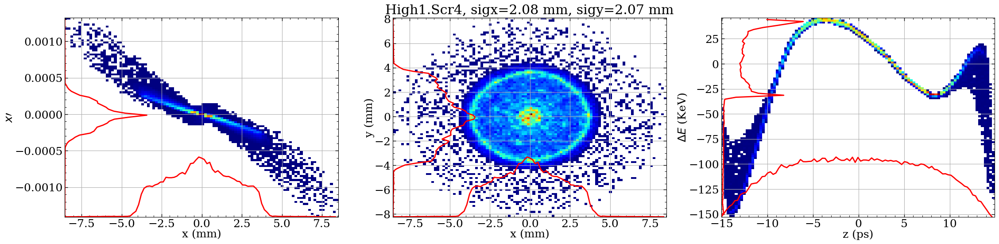

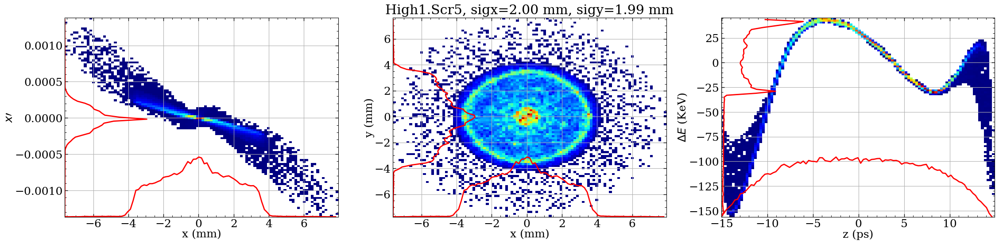

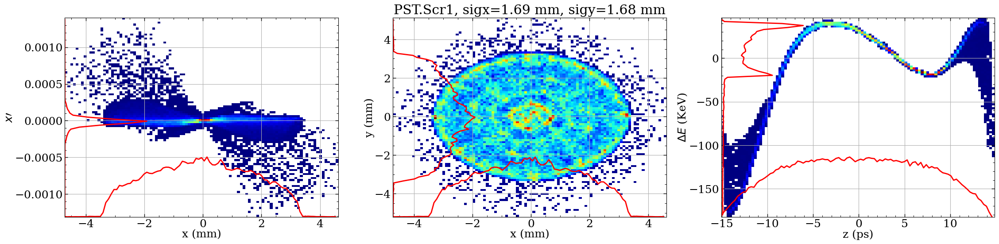

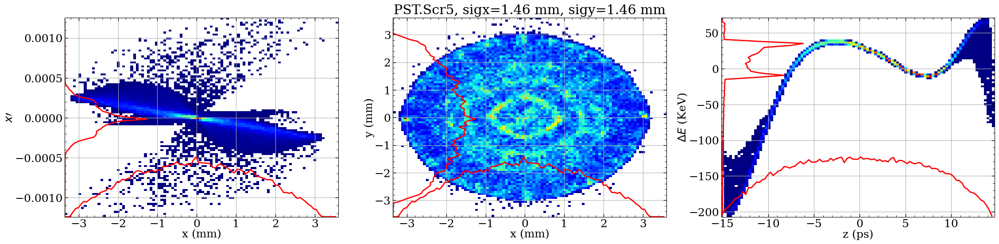

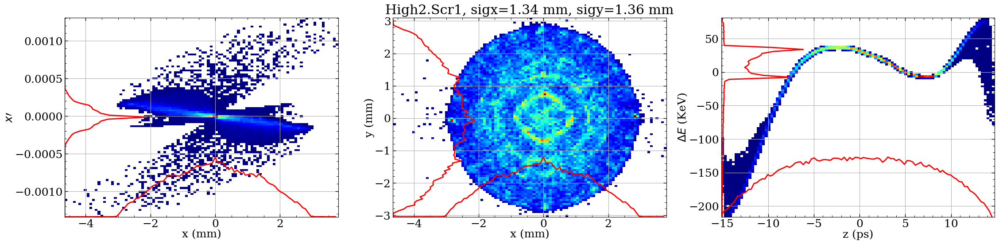

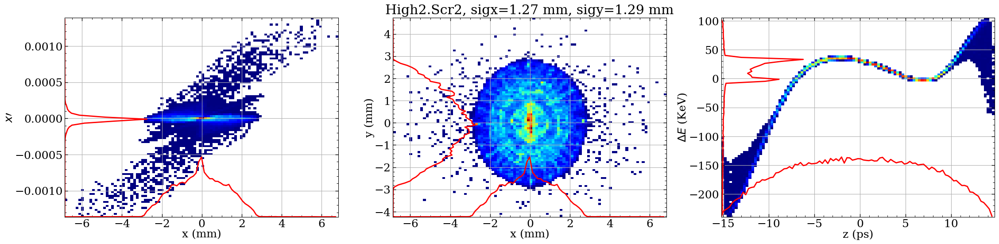

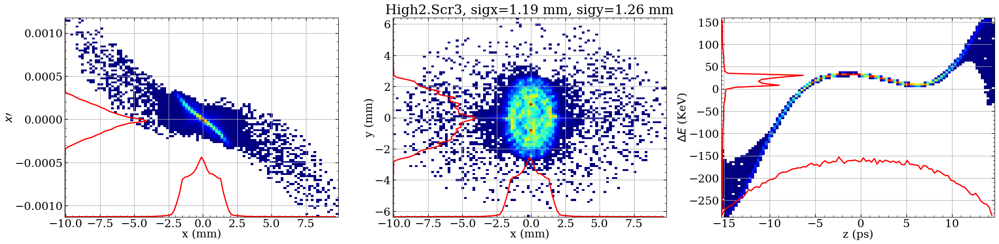

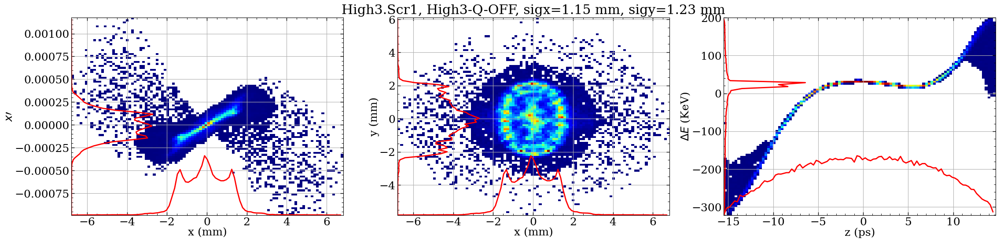

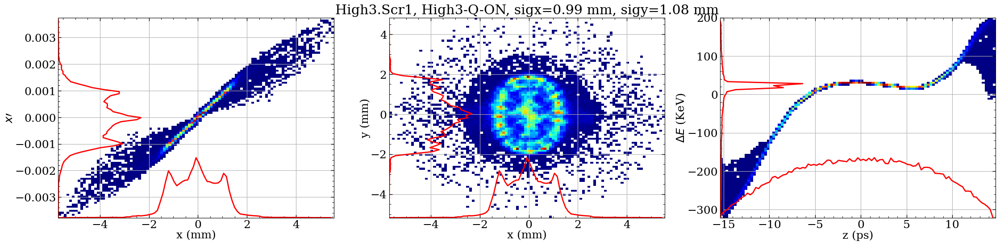

In [45]:
workdir='/mnt/d/NextCloud/subjects/2025/202502_Experiment/flattop_bcOFF_2nC/02_matchedLattice_impz'
os.chdir(workdir)

bins = 100

def plot_xxp_yyp_zzp(fname, title="@High1.Scr1"):
    pha = np.loadtxt(fname,skiprows=1)
    z0 = np.mean(pha[:,4])
    
    z = pha[:,4] - z0  #m
    t = z/2.998e8*1e12 #ps
    
    plt.figure(figsize=(8*3.5,6))
    
    plt.subplot(1,3,1)
    # plot_dotpha(pha[:,0]*1e3,pha[:,1],bins=40)
    plot_heatpha(pha[:,0]*1e3,pha[:,1],bins=bins)
    plt.xlabel("x (mm)")
    plt.ylabel("$x\prime$")
    
    plt.subplot(1,3,2)
    plt.title( title+f", sigx={np.std(pha[:,0]*1e3):.2f} mm, sigy={np.std(pha[:,2]*1e3):.2f} mm" )
    
    # plot_heatpha(pha[:,2]*1e3,pha[:,3],bins=100)
    # plt.xlabel("y (mm)")
    # plt.ylabel("$\\gamma \\beta_y$")
    plot_heatpha(pha[:,0]*1e3,pha[:,2]*1e3,bins=bins)
    plt.xlabel("x (mm)")
    plt.ylabel("y (mm)")
    # plt.xlim([-8,8])
    # plt.ylim([-8,8])
    
    
    plt.subplot(1,3,3)
    # plot_dotpha(t,pha[:,5]*0.511001e3,bins=bins)
    plot_heatpha(t,pha[:,5]*0.511001e3,bins=bins)
    plt.xlabel("z (ps)")
    plt.ylabel("$\Delta E$ (KeV)")

    plt.savefig(f"{fname}.png")

fname = "fort.1000"
plot_xxp_yyp_zzp(fname, title="High1.Scr4")

fname = "fort.1001"
plot_xxp_yyp_zzp(fname, title="High1.Scr5")

fname = "fort.1002"
plot_xxp_yyp_zzp(fname, title="PST.Scr1")

fname = "fort.1003"
plot_xxp_yyp_zzp(fname, title="PST.Scr5")

fname = "fort.1004"
plot_xxp_yyp_zzp(fname, title="High2.Scr1")

fname = "fort.1005"
plot_xxp_yyp_zzp(fname, title="High2.Scr2")

fname = "fort.1006"
plot_xxp_yyp_zzp(fname, title="High2.Scr3")

fname = "fort.1007_h3qoff"
plot_xxp_yyp_zzp(fname, title="High3.Scr1, High3-Q-OFF")

fname = "fort.1007"
plot_xxp_yyp_zzp(fname, title="High3.Scr1, High3-Q-ON")

## phi2-current

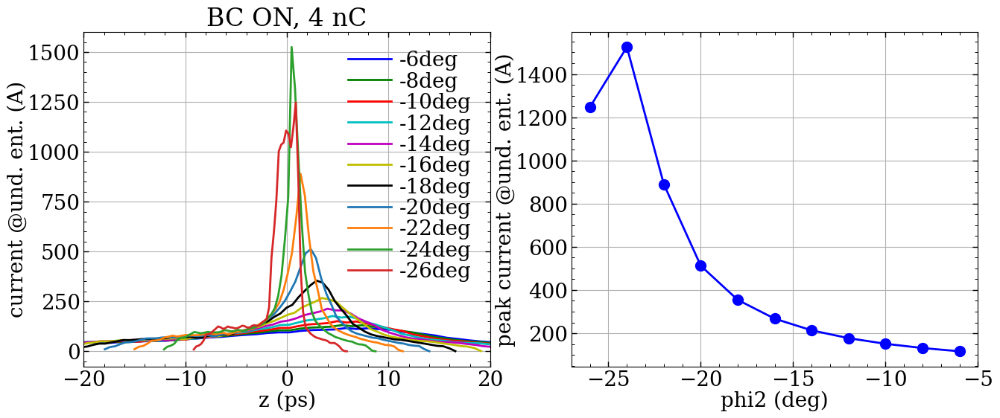

In [9]:
profile="flattop"

def func():
    if profile =="gauss": #or profile=="flattop":
        core=6464
        Np="5.24e+06"
    elif profile =="flattop":
        core=3232
        Np="6.55e+05"
    
    basedir = f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
    os.chdir(basedir)
    
    tmp1 = f'cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_' 
    tmp2 = 'deg_phi1_0deg/01_impz/fort.11003'
               
    degl = np.arange(-6, -26-1, -2)
    # degl = np.arange(-16, -40-1, -2)
    
    
    plt.figure(figsize=(16,6))
    
    # dat = np.loadtxt('/afs/ifh.de/group/pitz/data/biaobin/sim1/2024/SASE_Chicane/202411-ScanBooster-S2E/20241130_grid_3232064/phi2_-32deg/01_impz/fort.11000')
    # plt.plot(dat[:,0]*1e3,dat[:,2],'-',label='cds exit')
    plt.subplot(1,2,1)
    peak_cur = []
    
    j=0
    for jj in degl:
        tmp = tmp1 +"{:.1f}".format(jj) +tmp2
        dat = np.loadtxt(tmp)
        peak_cur.append(np.max(dat[:,2]))
        plt.plot(dat[:,0]/2.998e8*1e12,dat[:,2],'-',label=str(jj)+'deg')
        j +=1
    
    plt.title(f"BC {bc_stat}, {charge} nC")    
    plt.xlabel('z (ps)')
    plt.ylabel('current @und. ent. (A)')
    plt.legend()
    plt.grid()
    plt.xlim([-20,20])
    
    plt.subplot(1,2,2)
    plt.plot(degl,peak_cur)
    plt.xlabel('phi2 (deg)')
    plt.ylabel('peak current @und. ent. (A)')
    plt.grid()
    
    
    dat = np.column_stack((degl,peak_cur))
    np.savetxt("degl_peakcurrent.txt", dat)
    
    plt.savefig("phi2-current.png")

# bc_statl = ["OFF","ON"]
# chargel = [1,1.5,2]
bc_statl = ["ON"]
chargel = [4]

for bc_stat in bc_statl:
    for charge in chargel:
        func()
    
#phi2-core_current
#-----------------
# get the core-current manually

# for jj in degl:
#     plt.figure(figsize=(8,6))
#     tmp = tmp1 +"{:.1f}".format(jj) +tmp2
#     dat = np.loadtxt(tmp)
    
#     plt.plot(dat[:,0]/2.998e8*1e12,dat[:,2],'-',label=str(jj)+'deg')
#     plt.title("phi2="+str(jj))
    
# plt.xlabel('z (ps)')
# plt.ylabel('current @und. ent. (A)')
# plt.legend()

# get the core-current manually
# core_current=[285, 660, 1174, 863, 325, 238, 166, 129, 108, 97, 83, 77, 71]
# core_current.reverse()

# plt.figure(figsize=(8,6))
# plt.plot(degl,core_current,'o-')
# plt.xlabel('phi2 (deg)')
# plt.ylabel('core sec. current @und. ent. (A)')
# plt.show()    
# plt.savefig("phi2--core-current.png")

## phi2-current @several charges

First run the upper code with updating charge: 1, 1.5, 2nC; The run this section code to get the phi2-peak_current for different charges.

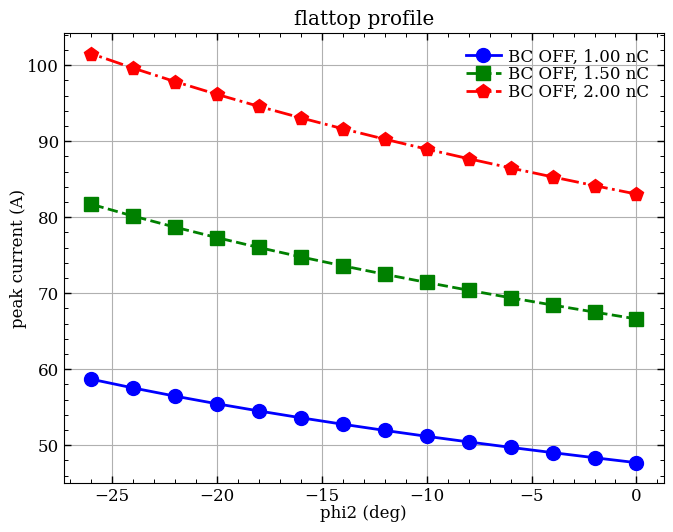

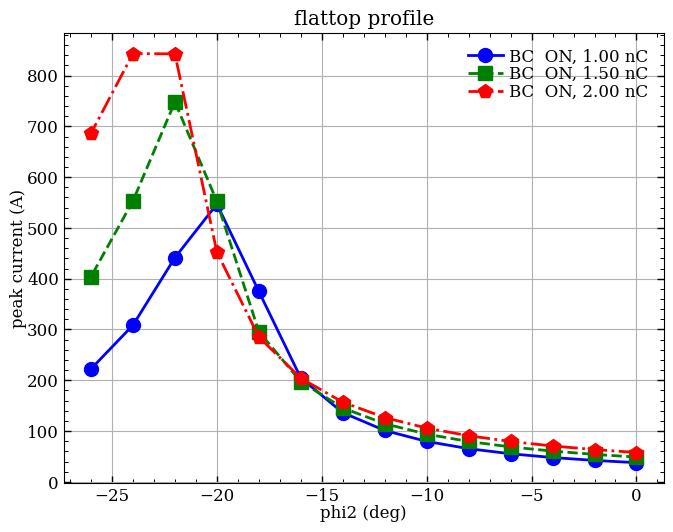

In [52]:
rootdir = "/lustre/fs22/group/pitz/biaobin/2025/"
profile="flattop"

def func():
    chargel = [1,1.5,2]
    
    if profile =="gauss" or profile=="flattop":
        core=6464
        Np="5.24e+06"
    # elif profile =="flattop":
    #     core=3232
    #     Np="6.55e+05"
    
    plt.figure(figsize=(8,6))
    
    for bc_stat in bc_statl:
        for charge in chargel:
            basedir = f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC/'
            
            fname = basedir + "degl_peakcurrent.txt"
            dat = np.loadtxt(fname)
            
            
            plt.plot(dat[:,0],dat[:,1],label=f"BC {bc_stat:>3}, {charge:.2f} nC")
            
    plt.legend()        
    plt.title(f"{profile} profile")        
    plt.xlabel("phi2 (deg)")
    plt.ylabel("peak current (A)")
    plt.grid("ON")
    
    plt.savefig(f"{rootdir}{profile}_{bc_statl}_phi2_peakcurrent.png")

# bc_statl=["OFF","ON"]
bc_statl=["OFF"]
func()

bc_statl=["ON"]
func()


## phi2-sigz, sigE, enx/eny

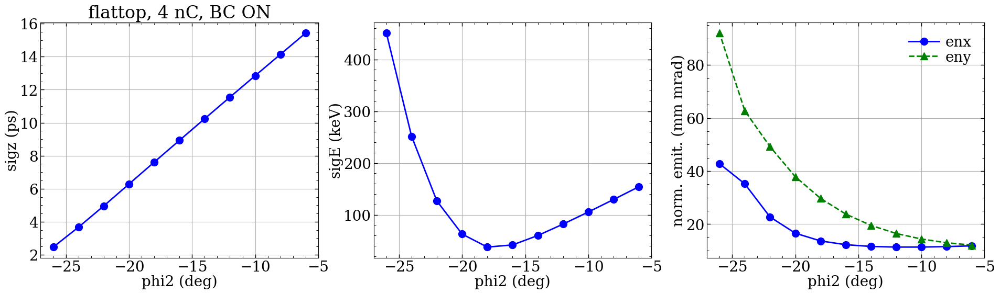

In [7]:

def func():
    if profile =="gauss":  # or profile=="flattop":
        core=6464
        Np="5.24e+06"
        degl = np.arange(-16,-41,-2)
    
    elif profile =="flattop":
        core=3232
        Np="6.55e+05"
        degl = np.arange(-6, -26 -1, -2)
        
    sigzl = []
    enxl = []
    enyl = []
    sigEl = []
    peakCur=[]
    for deg in degl:    
        tmppath =f"cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_{deg:.1f}deg_phi1_0deg/01_impz/"
        
        tmp = post.twissplot(path=tmppath)
        # plt.figure(figsize=(6,5))
        # plt.plot(tmp.s,tmp.sigz,'r-')
        
        interp_func_sigz= interp1d(tmp.s, tmp.sigz, kind='linear', fill_value="extrapolate")
        interp_func_enx = interp1d(tmp.s, tmp.enx, kind='linear', fill_value="extrapolate")
        interp_func_eny = interp1d(tmp.s, tmp.eny, kind='linear', fill_value="extrapolate")
        interp_func_sigE = interp1d(tmp.s, tmp.sigE, kind='linear', fill_value="extrapolate")
        
        s_undu = 22.94
        sigzl.append(interp_func_sigz(s_undu))
        enxl.append(interp_func_enx(s_undu))
        enyl.append(interp_func_eny(s_undu))
        sigEl.append(interp_func_sigE(s_undu))
        
    sigzl = np.array(sigzl)*1e-3/2.998e8*1e12  #ps        
    plt.figure(figsize=(24,6))
    plt.subplot(1,3,1)
    plt.title(f"{profile}, {charge} nC, BC {bc_stat}")
    plt.plot(degl,sigzl,'o-')  
    plt.grid()
    plt.xlabel('phi2 (deg)')
    plt.ylabel("sigz (ps)")
    
    # plt.subplot(1,4,2)
    # get the core-current manually
    # core_current=[285, 660, 1174, 863, 325, 238, 166, 129, 108, 97, 83, 77, 71]
    # core_current.reverse()
    # plt.plot(degl,core_current,'o-')
    # plt.xlabel('phi2 (deg)')
    # plt.ylabel('core sec. current @und. ent. (A)')
    
    plt.subplot(1,3,2)
    plt.plot(degl,np.array(sigEl)*1e3,'o-')    
    plt.xlabel('phi2 (deg)')
    plt.ylabel("sigE (keV)")
    plt.grid()
    
    plt.subplot(1,3,3)
    plt.plot(degl,enxl,'o-',label='enx')    
    plt.xlabel('phi2 (deg)')
    plt.ylabel("enx (mm mrad)")
    
    plt.plot(degl,enyl,'^--',label='eny')    
    plt.xlabel('phi2 (deg)')
    plt.ylabel("norm. emit. (mm mrad)")
    plt.grid()
    plt.legend()
    
    plt.savefig("phi2-sigz-sigE-enxeny.png")

# profilel  = ["gauss", "flattop"]
# bc_statl = ["OFF", "ON"]
# chargel  = [1,1.5,2]

profilel  = ["flattop"]
bc_statl = ["ON"]
chargel  = [4]

for profile in profilel:
    for bc_stat in bc_statl:
        for charge in chargel:
            basedir = f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
            # basedir = f'/afs/ifh.de/group/pitz/data/biaobin/sim2/2025_bugPhaseV/bcOFF_1nC/'
            os.chdir(basedir)
            
            func()

## phi2-Longitudinal phase space

In [2]:
# workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcON_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg_phi1_-30deg/00_impt'

%matplotlib inline

bc_stat = "OFF"
profile="flattop"
charge= 4

basedir = f'/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_4nC'

# basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_2nC"

os.chdir(basedir)

# if profile =="gauss":
#     core=6464
#     Np="5.24e+06"
# elif profile=="twobeam" or  profile=="flattop":
#     core=3232
#     Np="6.55e+05"
core=3232
Np="6.55e+05"

# degl = np.arange(-16, -40 -1, -2)
# degl = [-28,-30,-32,-34]

degl = [-6]
# degl = [-20,-22,-24,-26]
for deg in degl:    
    #---------------------------------------------------------------
    
    # tmp = f"cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_{deg}.0deg_phi1_-30deg/01_impz/"
    # tmp = f"cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_{deg}.0deg/01_impz/"
    
    # tmp = "cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-32.0deg_phi1_20deg_sigt4ps/01_impz/"
    tmp = "cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-20.0deg_phi1_0deg/01_impz/"

    # tmp = "cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-20.0deg_phi1_5deg_sigt4ps/01_impz/"
    
    # rms-evo
    twi = post.twissplot(path=tmp)
    
    twi.plot_rms(enxy='ON')
    plt.savefig("phi2="+str(deg)+"deg-"+"rmsevo.png")
    
    # continue

    #jet plot
    #---------------------------------------------------------------
    def zdgamplot(fname1):
        # fname1 = 'fort.1000'
        # fname2 = 'fort.11000'
        fname2 = fname1.split('.')[0]+'.'+str(10000+int(fname1.split('.')[1]))
        
        fort1001= np.loadtxt(tmp+fname1,skiprows=1)
        fort11001 =np.loadtxt(tmp+fname2)
        
        
        plt.figure(figsize=(12,5))
        
        plt.subplot(1,2,1)
        plt.title(f"BC {bc_stat}, phi2="+str(deg)+" deg, "+fname1)
        plt.hist2d(fort1001[:,4]/2.998e8*1e12,fort1001[:,5],bins=300,cmap='jet')
        plt.xlabel('z (ps)')
        plt.ylabel(r'$\Delta\gamma$')
        
        plt.subplot(1,2,2)
        plt.plot(fort11001[:,0]/2.998e8*1e12,fort11001[:,2],'-r')
        plt.xlabel('z (ps)')
        plt.ylabel('current (A)')
        
        plt.savefig("phi2="+str(deg)+"deg-"+fname1+"-zdgam.png")
    
    fname1 = 'fort.1000'
    zdgamplot(fname1)
    
    if bc_stat == "ON":
        fname1 = 'fort.1001'
        zdgamplot(fname1)
        
        fname1 = 'fort.1002'
        zdgamplot(fname1)
    
    fname1 = 'fort.1003'
    zdgamplot(fname1)
    
    # dot plot
    #---------------------------------------------------------------
    #plot together
    def zdgam_dotplot(fname1):
        # fname1 = 'fort.1000'
        # fname2 = 'fort.11000'
        fname2 = fname1.split('.')[0]+'.'+str(10000+int(fname1.split('.')[1]))
        
        fort1001= np.loadtxt(tmp+fname1,skiprows=1)
        fort11001 =np.loadtxt(tmp+fname2)
        
        plt.subplot(1,4,1)
        plt.title(f"BC {bc_stat}, phi2="+str(deg)+"deg")
        plt.plot(fort1001[::10,4]/2.998e8*1e12,fort1001[::10,5],'.')
        # plt.ylim([-0.6,0.4])
        plt.xlabel('z (ps)')
        plt.ylabel(r'$\Delta\gamma$')
        
        plt.subplot(1,4,2)
        plt.plot(fort11001[:,0]/2.998e8*1e12,fort11001[:,2],'-')
        plt.xlabel('z (ps)')
        plt.ylabel('current (A)')
        
        if fname1 in ["fort.1001","fort.1002"]:
            if fname1 == "fort.1001":
                labl = "before BC"
            elif fname1 == "fort.1002":
                labl = "after BC"

            plt.subplot(1,4,3)
            plt.plot(fort11001[:,0]/2.998e8*1e12,fort11001[:,3]*1e6,'-',label=labl+': enx')
            plt.plot(fort11001[:,0]/2.998e8*1e12,fort11001[:,4]*1e6,'--',label=labl+': eny')
            plt.xlabel('z (ps)')
            plt.ylabel('slice enx & eny (um rad)') 
            plt.legend()
            
            plt.subplot(1,4,4)
            plt.plot(fort11001[:,0]/2.998e8*1e12,fort11001[:,6]/1e3,'-',label=labl)
            plt.xlabel('z (ps)')
            plt.ylabel('slice energy spread (keV)')
            plt.legend()    # os.chdir(tmp)

    
    plt.figure(figsize=(28,5))
    
    zdgam_dotplot('fort.1000')
    if bc_stat == "ON":
        zdgam_dotplot('fort.1001')
        zdgam_dotplot('fort.1002')
    zdgam_dotplot('fort.1003')
    
    plt.savefig("phi2="+str(deg)+"deg-"+"zdgam_0123.png",bbox_inches='tight')
    
    # plt.close("all")


NameError: name 'post' is not defined

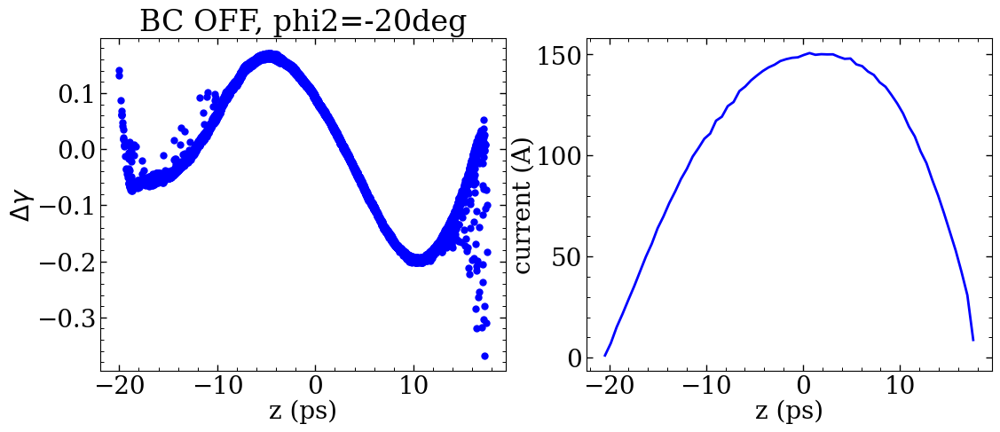

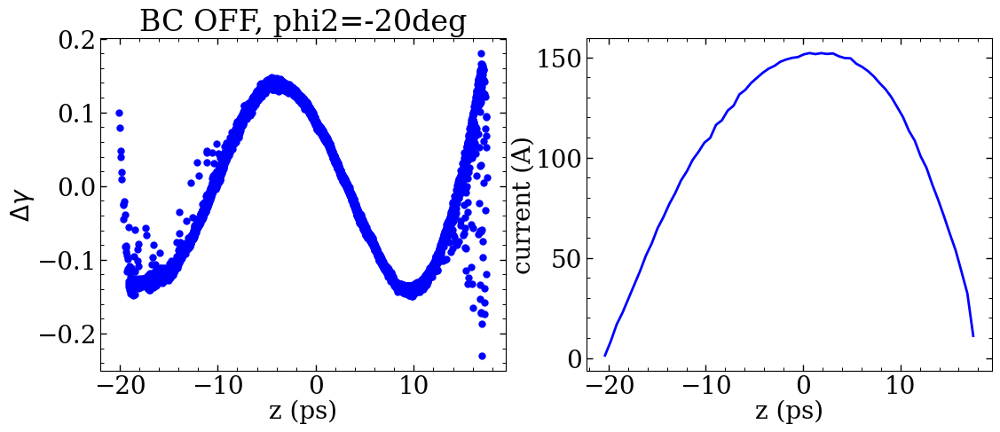

In [7]:
plt.figure(figsize=(28,5)); zdgam_dotplot('fort.1003')

plt.figure(figsize=(28,5)); zdgam_dotplot('fort.1004')

## longitudinal phase space

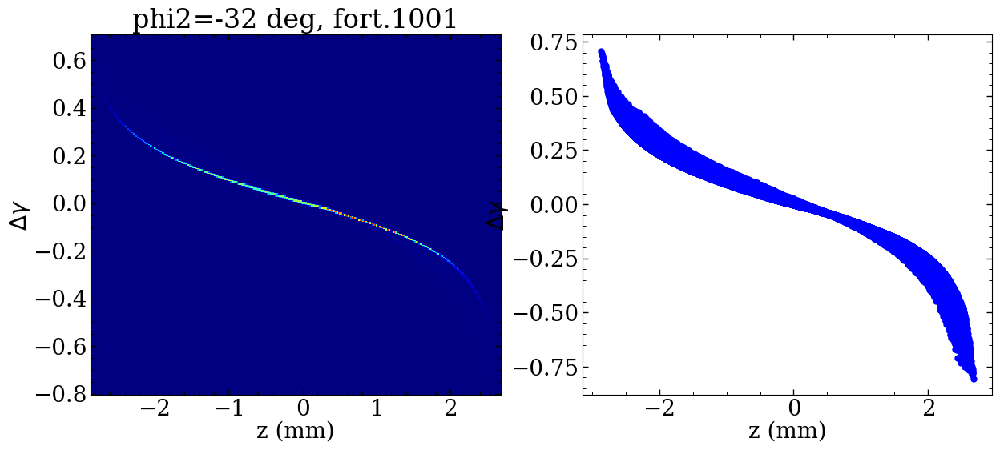

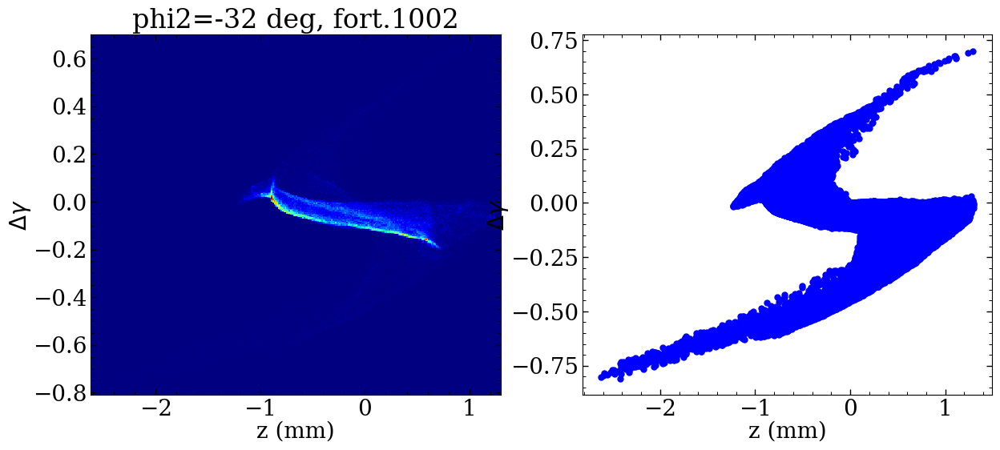

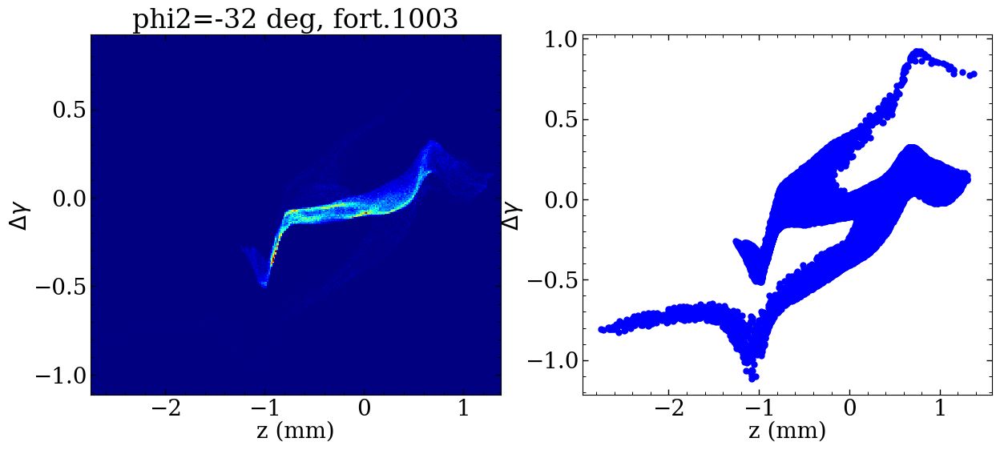

In [3]:
deg = -32

bc_stat = "ON"
profile="gauss"
charge= 1

basedir = f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
os.chdir(basedir)
  
tmp1 = 'cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_' 
tmp2 = 'deg/01_impz/'
tmp3 = tmp1 +"{:.1f}".format(deg)+"deg"
tmp =tmp3+"/01_impz/"

def plot_zdgam_jet_dot(fname1):
    fort1001 = np.loadtxt(tmp+fname1,skiprows=1)
    plt.figure(figsize=(15,6))
    
    plt.subplot(1,2,1)
    plt.title("phi2="+str(deg)+" deg, "+fname1)
    plt.hist2d(fort1001[:,4]*1e3,fort1001[:,5],bins=300,cmap='jet')
    plt.xlabel('z (mm)')
    plt.ylabel(r'$\Delta\gamma$')
    
    plt.subplot(1,2,2)
    plt.plot(fort1001[:,4]*1e3,fort1001[:,5],'.')
    plt.xlabel('z (mm)')
    plt.ylabel(r'$\Delta\gamma$')    
    
    plt.savefig("phi2="+str(deg)+"deg-"+fname1+"-zdgam-jet-dot.png")

fname1 = "fort.1001"    
plot_zdgam_jet_dot(fname1)    
    
fname1 = "fort.1002"    
plot_zdgam_jet_dot(fname1) 

fname1 = "fort.1003"    
plot_zdgam_jet_dot(fname1) 

# Genesis section

## gain curve

(1). Given gen4 path, plot the gain curve vs s.

.h5
intensity-farfield phase-farfield 3.6000000000000076
intensity-farfield phase-farfield -1
intensity-farfield phase-farfield 2.0


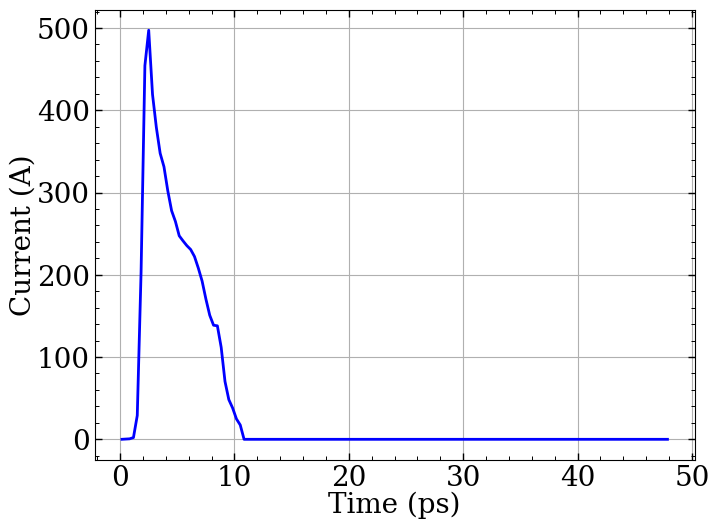

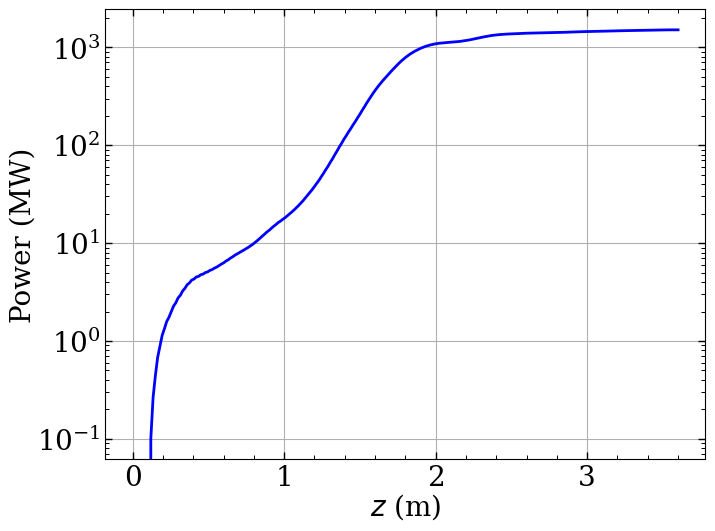

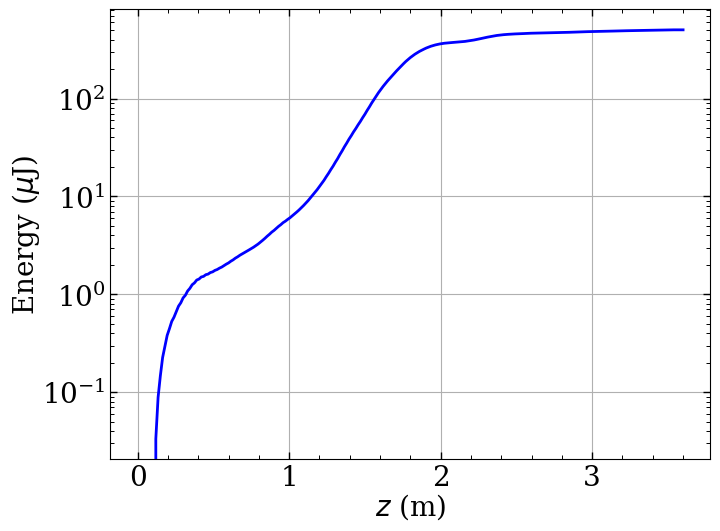

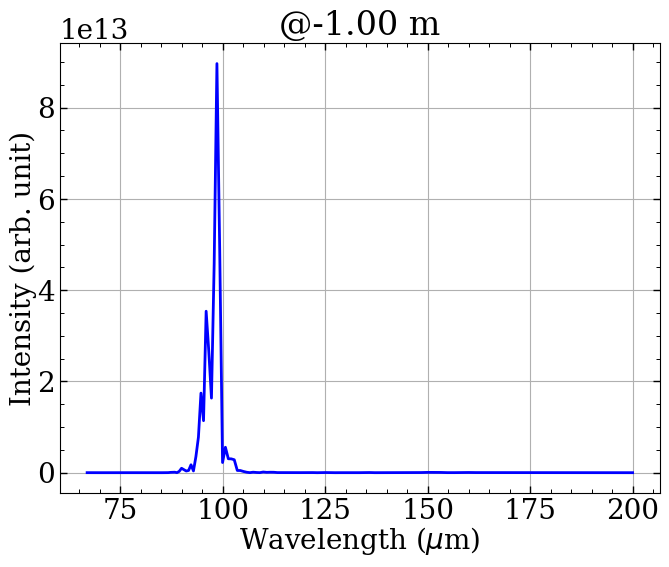

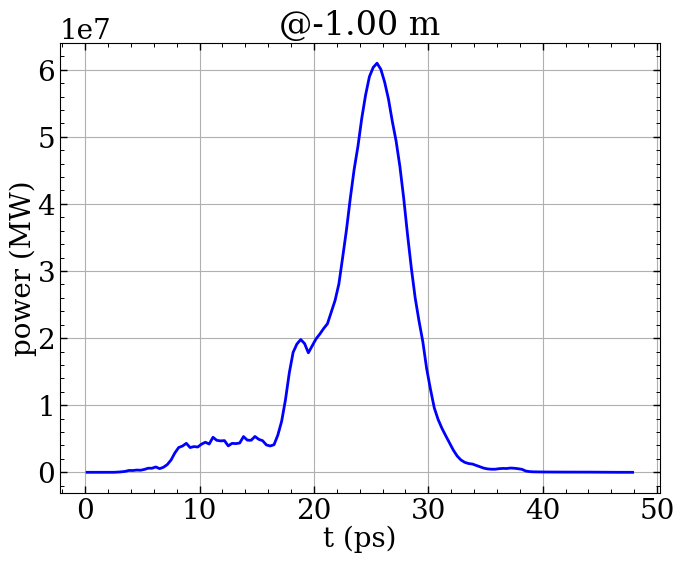

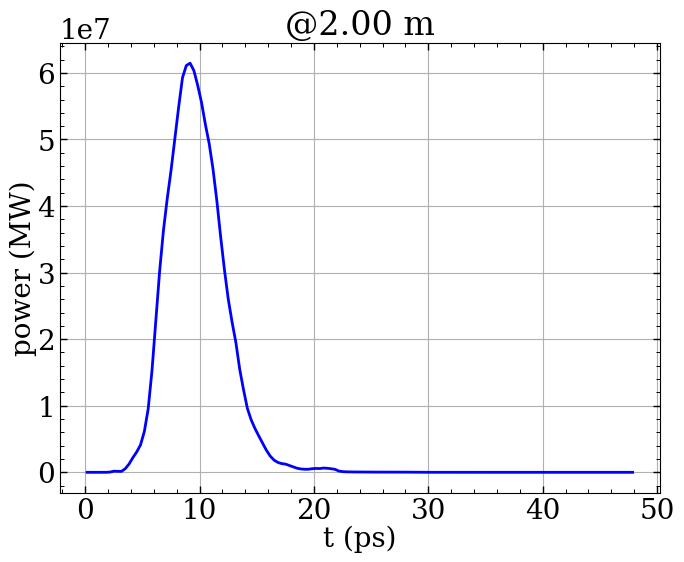

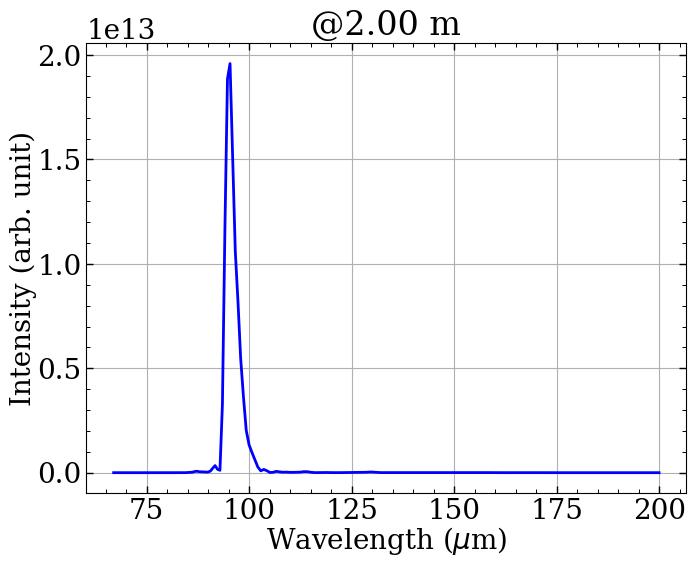

In [23]:
# workdir ='/lustre/fs22/group/pitz/biaobin/2025/test_flattop_rs_3ps_22psTop/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-8.0deg/02_gen4/copenChirp'
# workdir=r'/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/02_gen4/lscOFF/' 
workdir=r'/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_2nC_twiceLen_lscOFF/Q_0.5nC_0.5Len_lscOFF'

workdir='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcON_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-10.0deg_phi1_-30deg/02_gen4'

workdir='/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-28.0deg_phi1_5deg_sigt4ps/02_gen4'
workdir='/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-30.0deg/02_gen4'

os.chdir(workdir)

fname = "gen4.seed5.nper10.fitdeg3.out.h5"
pg = PostGenesis(fname, debug=1, version=4, fig_ext = '.png')

pg.plot_tpower(at=2.0)
pg.plot_spectrum(at=2.0)

# fname2 = "../gen4.seed5.nper5.fitdeg1.out.h5"
# pg2 = PostGenesis(fname2, debug=0, version=4, fig_ext = '.png')

# plt.figure(figsize=(6,5))
# plt.plot(pg.zplot, pg.zenergy*1e6,'-',label='2nC')
# plt.yscale("log")

# # plt.plot(pg2.zplot, pg2.zenergy*1e6,'--',label='1nC')
# # plt.yscale("log")
# plt.grid()
# plt.xlabel("s (m)")
# plt.ylabel("THz energy (uJ)")
# plt.legend()

(2). for scanned phi2, plot all the gain curves together

same: profile, charge, bc_stat


.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076


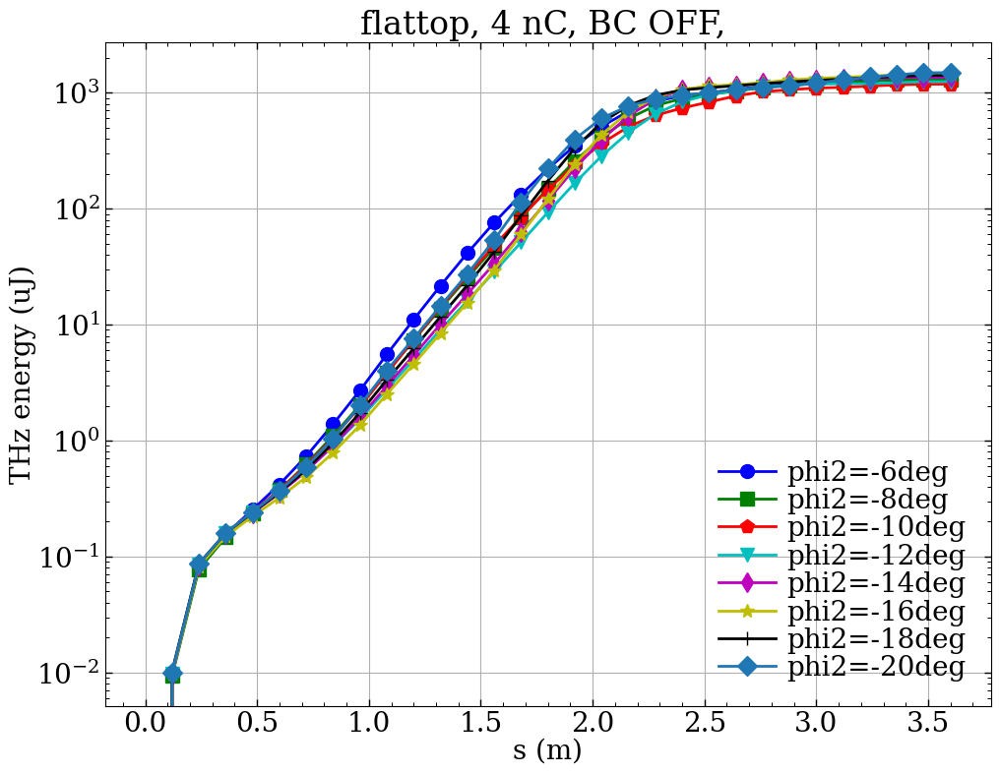

In [8]:
rootdir = "/lustre/fs22/group/pitz/biaobin/2025/"
markers = [
    'o', 's', 'p', 'v', 'd', '*', '+', 'D', '>', 'h', 'H', '^', '<', '.', ',', 
    'x', 'X', '|', '_', '1', '2', '3', '4', '8', 'P']

profilel = ["flattop"]
bc_statl = ["OFF"]
chargel = [4]
seed= 5

degl = np.arange(-6, -20 -1, -2)

keyword="power"
keyword="energy"

plt.figure(figsize=(8*1.5,6*1.5))
j = 0
for profile in profilel:
    for bc_stat in bc_statl:
        for charge in chargel:
            
            basedir=f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
            os.chdir(basedir)
            
            if profile =="gauss" :
                core=6464
                Np="5.24e+06"
            elif profile =="flattop":
                core=3232
                Np="6.55e+05"
                 
            for deg in degl:        
                tmp = f"cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_{deg:.1f}deg_phi1_0deg/02_gen4/"
                
                if bc_stat == "OFF":
                    fname = f"gen4.seed{seed}.nper5.fitdeg1.out.h5"
                elif bc_stat == "ON":
                    fname = f"gen4.seed{seed}.nper10.fitdeg3.out.h5"
                # print("fname=",fname)
                pg = PostGenesis(tmp+fname, debug=0, version=4, fig_ext = '.png')
                if keyword=="energy":
                    yy = pg.zenergy*1e6 #uJ
                elif keyword == "power":
                    yy = pg.zpower/1e6   #MW
                    
                plt.plot(pg.zplot[::8],yy[::8],'-',marker=markers[j],label="phi2="+str(deg)+"deg")
                plt.yscale("log")
                j +=1
            
            plt.grid()
            plt.xlabel("s (m)")
            plt.legend(loc="lower right")
            plt.title(f"{profile}, {charge} nC, BC {bc_stat}, ")
            
            if keyword == "energy":
                plt.ylabel(f"THz {keyword} (uJ)")
            elif keyword == "power":
                plt.ylabel(f"THz {keyword} (MW)")
    
plt.savefig(f"{rootdir}{profile}_{charge}nC_BC{bc_stat}_allphi2_gaincurve.png")        


## THz energy @exit

Only plot seed5 case. Scan phi2, to get phi2-Energy, for several charges.

.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-fa

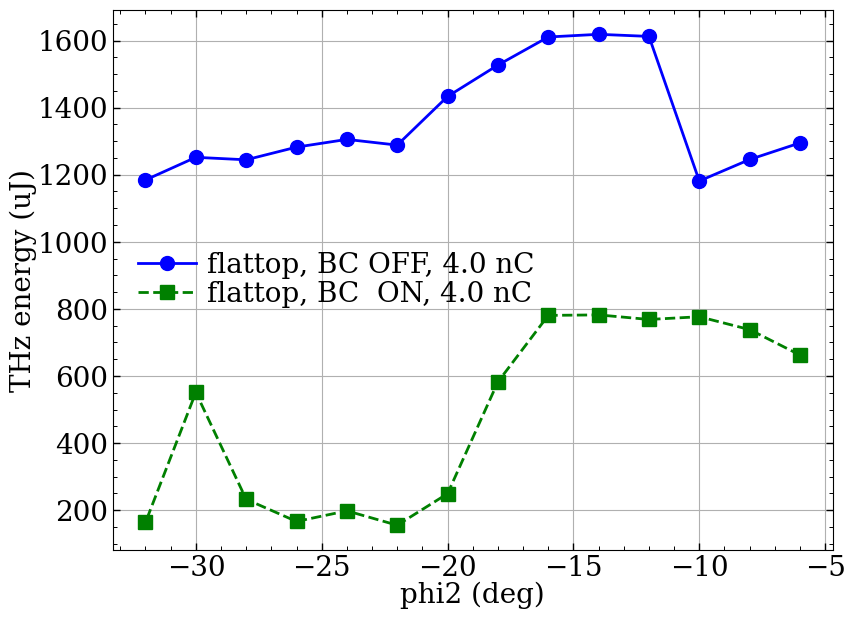

In [10]:
rootdir = "/lustre/fs22/group/pitz/biaobin/2025/"

# profilel = ["gauss","flattop"]
profilel = ["flattop"]
# bc_statl = ["OFF","ON"]
bc_statl = ["OFF","ON"]

# chargel = [1,1.5,2]
# degl = np.arange(0, -26 -1, -2)

chargel = [4]
degl = np.arange(-6, -32-1, -2)
seed= 5

keyword="power"
keyword="energy"

maxE = []
for profile in profilel:
    for bc_stat in bc_statl:
        for charge in chargel:
            
            basedir=f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
            os.chdir(basedir)
            
            if profile =="gauss":  #or profile=="flattop":
                core=6464
                Np="5.24e+06"
            elif profile =="flattop":
                core=3232
                Np="6.55e+05"
                
            tmp_maxE = []    
            for deg in degl:        
                tmp = f"cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_{deg:.1f}deg_phi1_0deg/02_gen4/"
                tmp = f"Np_5.24e+06_phi1_0deg_phi2_{deg:.0f}deg/02_gen4/"
                
                if bc_stat == "OFF":
                    fname = f"gen4.seed{seed}.nper5.fitdeg1.out.h5"
                elif bc_stat == "ON":
                    fname = f"gen4.seed{seed}.nper10.fitdeg3.out.h5"
                # print("fname=",fname)
                pg = PostGenesis(tmp+fname, debug=0, version=4, fig_ext = '.png')
                if keyword=="energy":
                    tmp_maxE.append(np.max(pg.zenergy)*1e6 ) #uJ
                elif keyword == "power":
                    tmp_maxE.append(np.max(pg.zpower)/1e6)   #MW
            maxE.append(tmp_maxE)
#======            
plt.figure(figsize=(8*1.2,6*1.2))
j=0   
for profile in profilel:
    for bc_stat in bc_statl:
        for charge in chargel:     
            maxE = np.array(maxE)                
            plt.plot(degl,maxE[j],label=f"{profile}, BC {bc_stat:>3}, {charge:.1f} nC")
            plt.xlabel("phi2 (deg)")
            if keyword == "energy":
                plt.ylabel(f"THz {keyword} (uJ)")
            elif keyword == "power":
                plt.ylabel(f"THz {keyword} (MW)")
            plt.legend()
            j += 1
plt.grid()

os.chdir(rootdir)
plt.savefig(f"{rootdir}{'_'.join(profilel)}_{'_'.join(bc_statl)}_phi2_THz{keyword}_seed{seed}.png")

## 20 seeds: THz energy @exit

THz energy vs phi2, with error bar.

(1).  get the phi2-THzEnergy.txt data for each deg

.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-fa

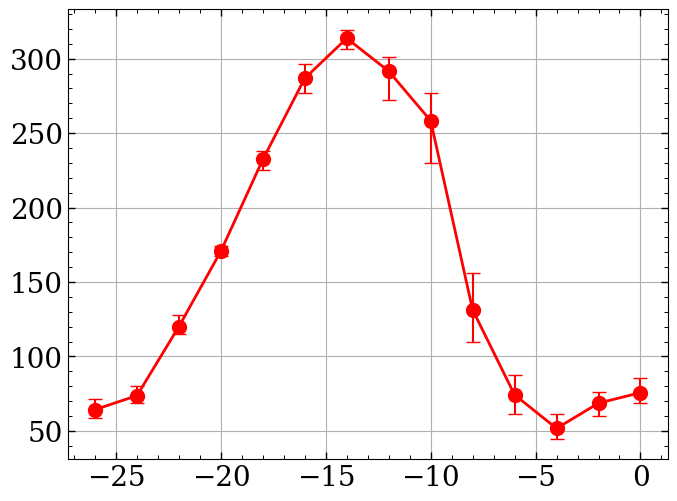

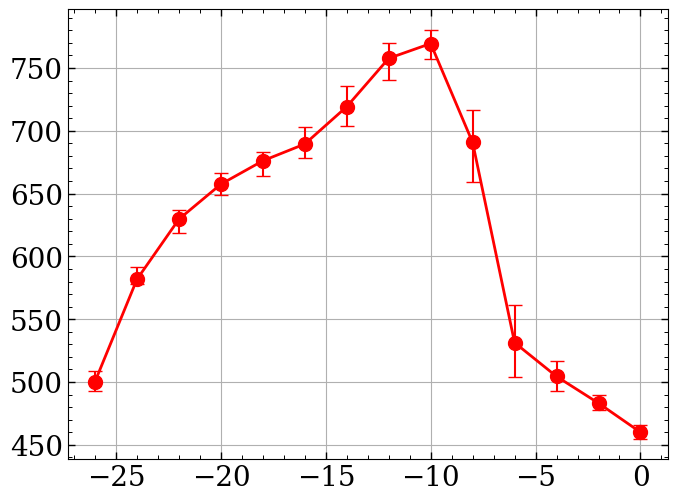

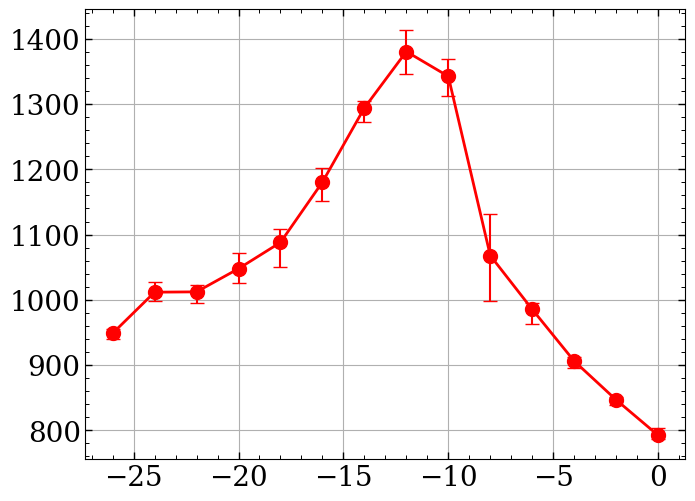

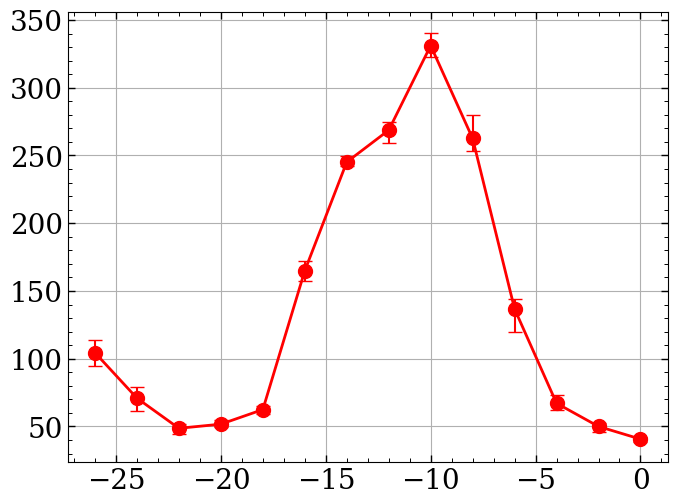

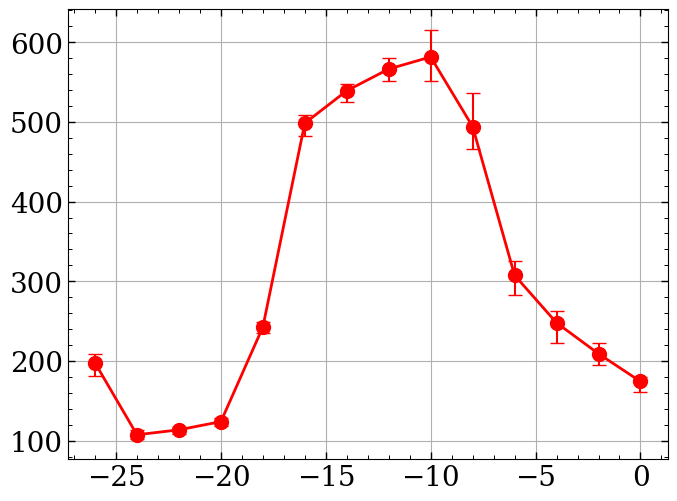

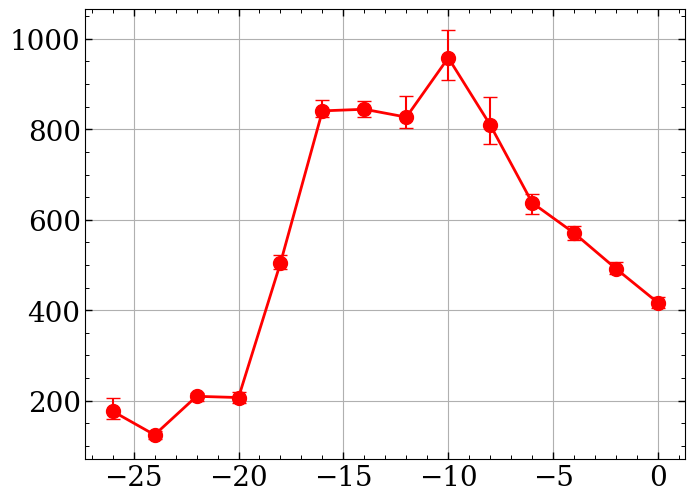

In [22]:
profile = "flattop"

bc_statl = ["OFF","ON"]
chargel =[1,1.5,2]

seedl = np.arange(5,25,1)

if profile =="gauss":
    core=6464
    Np="5.24e+06"
    degl = np.arange(-16, -40 -1, -2)
elif profile =="flattop":
    core=6464
    Np="5.24e+06"
    degl = np.arange(0, -26-1, -2)
# elif profile =="flattop":
#     core=3232
#     Np="6.55e+05"

zenpow = "zpower" #zpower
# zenpow = "zenergy"

for bc_stat in bc_statl:
    for charge in chargel:
        basedir=f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
        os.chdir(basedir)
        
        # degl=[-16]
        for deg in degl:
            # uncooment the follwing #lines, will plot one figure for one deg with 20 shots
            plt.figure(figsize=(8,6))
            energy_20seeds = []
            for seed in seedl:  
                tmp = f"cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_{deg:.1f}deg/02_gen4/"
                
                if bc_stat == "OFF":
                    fname = f"gen4.seed{seed}.nper5.fitdeg1.out.h5"
                elif bc_stat == "ON":
                    fname = f"gen4.seed{seed}.nper10.fitdeg3.out.h5"
                # print("fname=",fname)
                pg = PostGenesis(tmp+fname, debug=0, version=4, fig_ext = '.png')
                if zenpow == "zenergy": 
                    pgzep = pg.zenergy*1e6  #uJ
                    unit = "uJ"
                    label = "THz Energy"
                elif zenpow == "zpower":
                    pgzep = pg.zpower/1e6   #MW
                    unit = "MW"
                    label = "THz power"
                
                energy_20seeds.append(pgzep)    
            
                plt.plot(pg.zplot,pgzep,"g-")
                
                plt.yscale('log')
                plt.xlabel('z (m)')
                plt.ylabel(f'{label} ({unit})')    
                
            plt.grid()
            plt.savefig(tmp+f"phi2-20seeds-GainCurves-{zenpow}.png")
            plt.close()
        
            s = pg.zplot
            aveE = np.mean(energy_20seeds,0)
            maxE = np.max(energy_20seeds,0)
            minE = np.min(energy_20seeds,0)
            sigE = np.std(energy_20seeds,0)
            
            lower_errors = np.array(aveE)-np.array(minE)
            upper_errors = np.array(maxE)-np.array(aveE)
            errors = [lower_errors, upper_errors]
            
            # plt.figure(figsize=(8,5))
            # plt.errorbar(s, aveE, yerr=errors, fmt="o-", color="gray", capsize=5, capthick=1, elinewidth=1.5)
            
            data = np.column_stack((s,aveE,minE,maxE,lower_errors,upper_errors,sigE))
            np.savetxt(tmp+f"20seeds{zenpow}.txt", data, fmt="%20.15e")
        
        #% 20seeds: (2)phi2-ave_max_E
        #---------------------------
        # run the previous section, to get the 20seeds{zenpow}.txt file first
        
        os.chdir(basedir)
        
        Eexit=[]
        errors_tt =[]
        sigE_exit_tt = []
        for deg in degl:
            tmp = f"cores_016_impt_{core}0064_impz_{core}0064_Np_{Np}_phi2_{deg:.1f}deg/02_gen4/"
                
            dat = np.loadtxt(tmp+f"20seeds{zenpow}.txt")
            
            aveE = dat[:,1]
            minE = dat[:,2]
            maxE = dat[:,3]
            lowErr = dat[:,4] 
            uppErr = dat[:,5]
            sigE   = dat[:,6]
            
            Eexit.append( aveE[-1] )
            errors_tt.append( [lowErr[-1],uppErr[-1]] )
            sigE_exit_tt.append( [sigE[-1],sigE[-1]])
        
        errors = np.array(errors_tt).T
        sigE_exit = np.array(sigE_exit_tt).T
            
        plt.figure(figsize=(8,6))
        # plt.plot(degl,Eexit,'o-')
        
        #p2p
        plt.errorbar(degl, Eexit, yerr=errors, fmt="o-", color="red", capsize=5, capthick=1, elinewidth=1.5)   
        #rms
        # plt.errorbar(degl, Eexit, yerr=sigE_exit, fmt="o-", color="red", capsize=5, capthick=1, elinewidth=1.5)   
        plt.grid()  
        plt.savefig(f"phi2-THz{zenpow}_bc{bc_stat}_{charge}nC.png")
        
        data = np.column_stack((degl, Eexit, errors[0], errors[1], sigE_exit[0], sigE_exit[1]))  
        np.savetxt(basedir+f"/phi2-{zenpow}Exit-Error.txt", data, fmt="%20.15e")

### then plot together

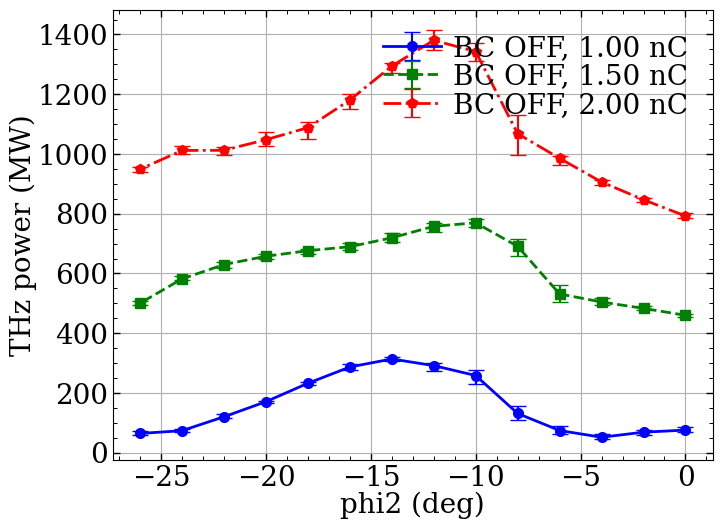

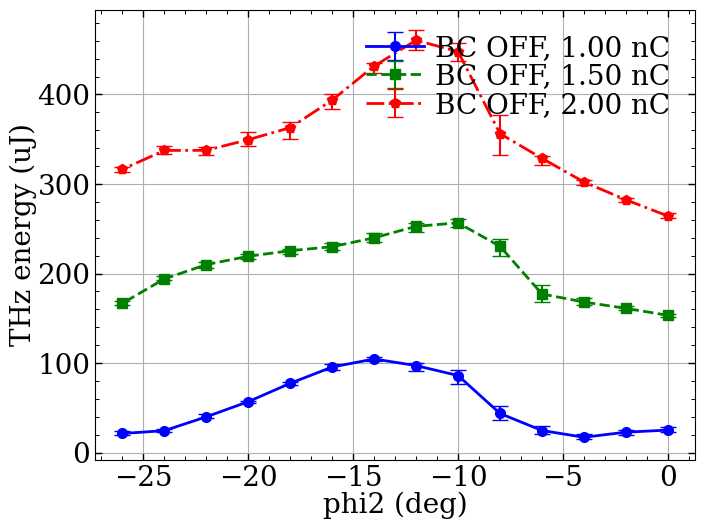

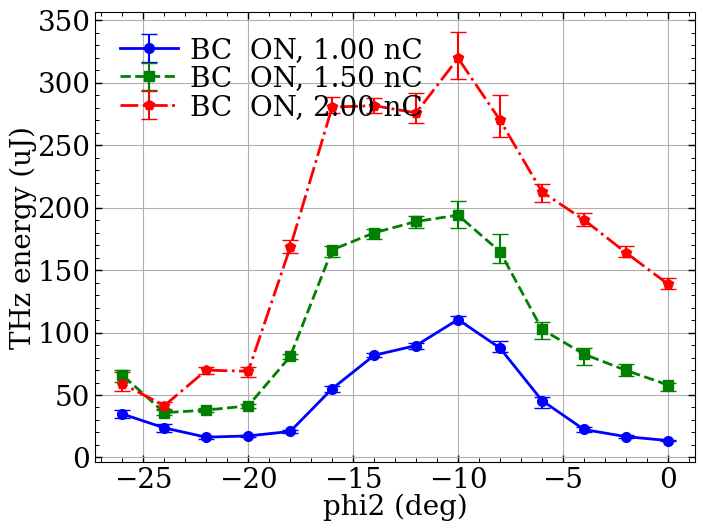

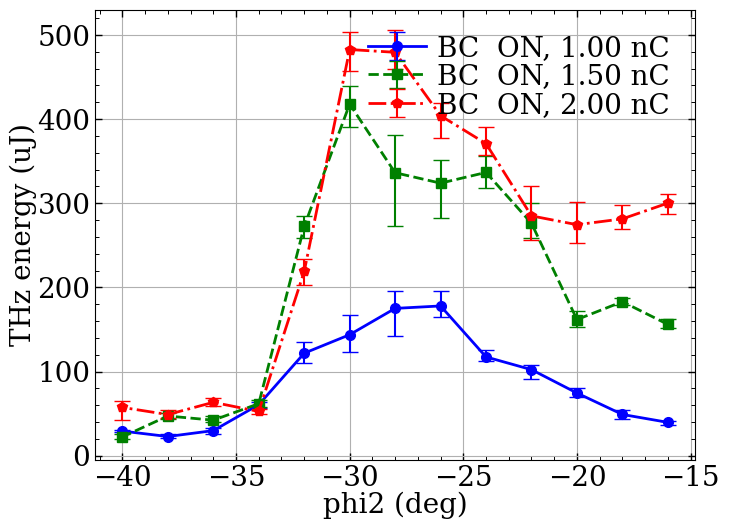

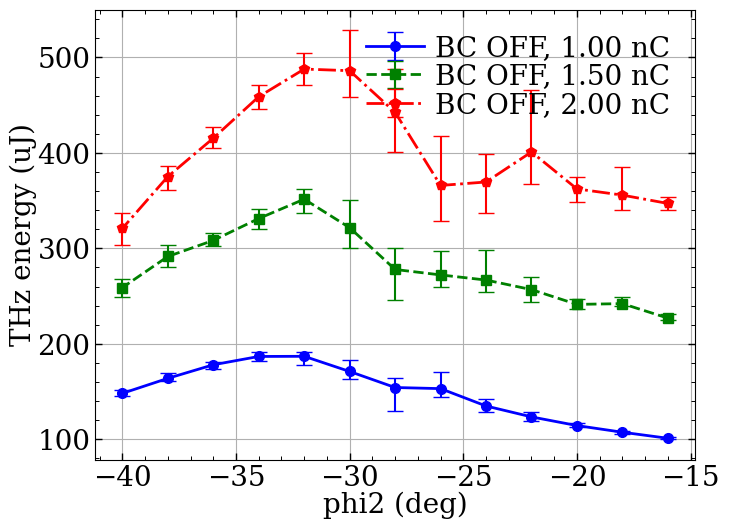

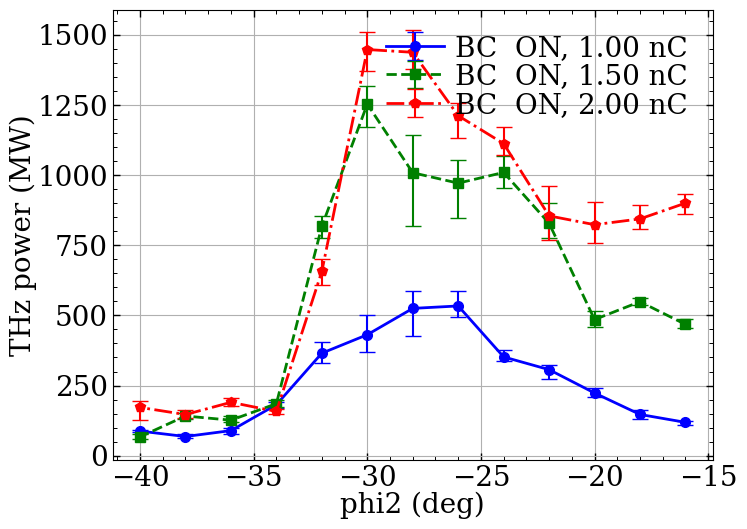

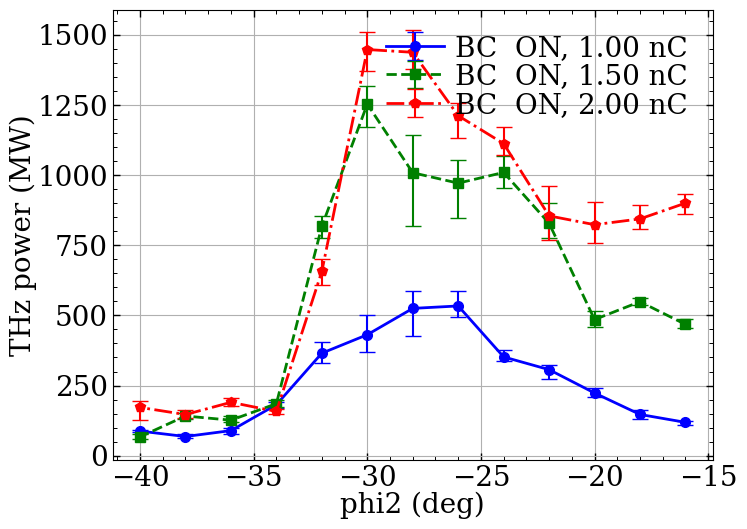

In [15]:
%matplotlib inline

rootdir = "/lustre/fs22/group/pitz/biaobin/2025/"

# profilel = ["gauss","flattop"]
profilel = ["gauss"]
bc_statl = ["ON"]

# bc_statl = ["OFF"]
chargel = [1,1.5,2]

zenpow = "zpower" #zpower
# zenpow = "zenergy"

if zenpow == "zenergy":
    unit = "uJ"
    label="THz energy"
elif zenpow == "zpower":
    unit = "MW"
    label="THz power"

plt.figure(figsize=(8,6))
for profile in profilel:
    for bc_stat in bc_statl:
        for charge in chargel:
            
            basedir=f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC'
            os.chdir(basedir)
            
            fname = f"phi2-{zenpow}Exit-Error.txt"
    
            dat = np.loadtxt(fname)
            degl = dat[:,0]
            Eexit = dat[:,1]
            
            #peak 2 peak
            lowErr = dat[:,2]
            uppErr = dat[:,3]
            errors = np.array([lowErr,uppErr])
            
            #rms, sig,sig
            # lowErr = dat[:,4]
            # uppErr = dat[:,5]
            # errors = np.array([lowErr,uppErr])
            
            plt.errorbar(degl, Eexit, yerr=errors, markersize=7 ,capsize=6, capthick=1, elinewidth=1.5,label=f'BC {bc_stat:>3}, {charge:.2f} nC')   
            plt.legend()    

plt.grid()
plt.xlabel("phi2 (deg)")
plt.ylabel(f"{label} ({unit})")
plt.savefig(f"{rootdir}{profile}-phi2-THz{zenpow}-ErrorBar-BC-{'_'.join(bc_statl)}.png")     

## Lsat

0.9 MaxEenergy => Lsat

(1). get the results from seed5.

.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-farfield 3.6000000000000076
.h5
intensity-farfield phase-fa

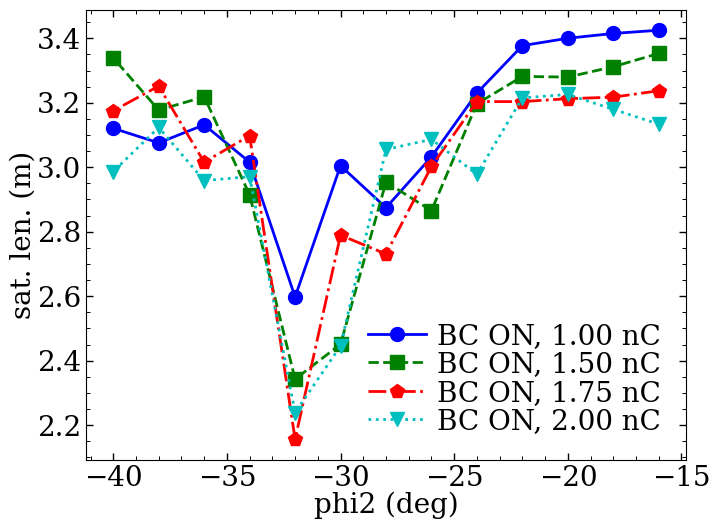

In [6]:
rootdir = "/lustre/fs22/group/pitz/biaobin/2025/"

# profile = "flattop"
# bc_stat = "OFF"
# chargel = [1,1.5,2]  #nC
# degl = np.arange(0, -26-1, -2)

profile = "gauss"
bc_stat = "ON"
chargel = [1,1.5,1.75,2]  #nC
degl = np.arange(-16, -40 -1, -2)

j=0

plt.figure(figsize=(8,6))
for charge in chargel:
    basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC"
    os.chdir(basedir)
    
    Lsat = []
    for deg in degl:  
        tmp = "cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_{:.1f}deg/02_gen4/".format(deg)
        
        if bc_stat == "ON":
            fname = "gen4.seed5.nper10.fitdeg3.out.h5"
        else:
            fname = "gen4.seed5.nper5.fitdeg1.out.h5"
        pg = PostGenesis(tmp+fname, debug=0, version=4, fig_ext = '.png')
    
        interp_func_Lsat= interp1d(pg.zenergy, pg.zplot, kind='linear', fill_value="extrapolate")
        
        maxEnergy = np.max(pg.zenergy)
        Lsat.append( interp_func_Lsat(0.9*maxEnergy) )
      
    data = np.column_stack((degl,Lsat))
    np.savetxt(basedir+"/seed5_degl_Lsat.txt", data, fmt="%20.15e")       

    plt.plot(degl,Lsat,label=f"BC {bc_stat}, {charge:.2f} nC")
    plt.xlabel("phi2 (deg)")
    plt.ylabel("sat. len. (m)")
    plt.legend()
    plt.grid()
plt.savefig(f"{rootdir}{profile}_BC{bc_stat}_Lsat.png")

(2). from 20 seeds

In [11]:
#%%%% phi2-Lsat from 20seeds
# get Lsat from <aveE> gain curve

# profile = "gauss"
# bc_statl = ["OFF","ON"]
# chargel = [1,1.5,1.75,2]  #nC
# degl = np.arange(-16, -40 -1, -2)

profile = "flattop"
bc_statl = ["OFF","ON"]
chargel = [1,1.5,2]  #nC
degl = np.arange(0, -26-1, -2)

rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'

for bc_stat in bc_statl:
    for charge in chargel:
        
        basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC"
        os.chdir(basedir)
        
        Lsat = []
        for deg in degl:  
            tmp = "cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_{:.1f}deg/02_gen4/".format(deg)
        
            fname = "20seedszenergy.txt"
            dat = np.loadtxt(tmp+fname)
        
            interp_func_Lsat= interp1d(dat[:,1],dat[:,0], kind='linear', fill_value="extrapolate")
            
            maxEnergy = np.max(dat[:,1])
            Lsat.append( interp_func_Lsat(0.8*maxEnergy) )
            
        data = np.column_stack((degl,Lsat))
        np.savetxt(basedir+"/20seeds_ave_degl_Lsat.txt", data, fmt="%20.15e")

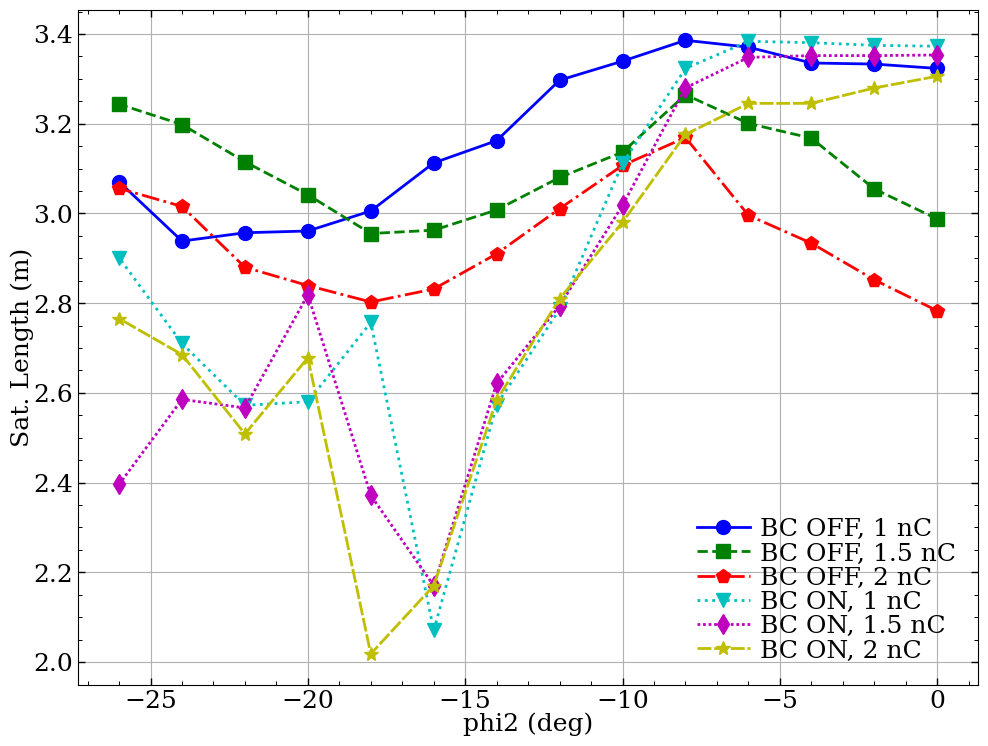

In [12]:
bc_statl = ["OFF","ON"]
plt.figure(figsize=(8*1.5,6*1.5))
for bc_stat in bc_statl:
    for charge in chargel:
        basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC"
        fname = basedir+"/20seeds_ave_degl_Lsat.txt"
        
        dat= np.loadtxt(fname)
        
        plt.plot(dat[:,0],dat[:,1],label=f'BC {bc_stat}, {charge} nC')
        plt.legend()
    
plt.grid()
plt.xlabel("phi2 (deg)")
plt.ylabel("Sat. Length (m)") 
plt.savefig(rootdir+f"{profile}_bc{'-'.join(bc_statl)}_phi2_Lsat.png")

## t-power

I added beam current profile fitting, in order to get some feelings of: THz pulse width & beam profile width.

My question is:
Why for some cases when BC is off, there are two THz pulse spikes? like:
- BC OFF, 1nC, phi2=-14deg 


### t-power, t-current, t-dgam

#### one job

.h5
intensity-farfield phase-farfield 3.6000000000000076


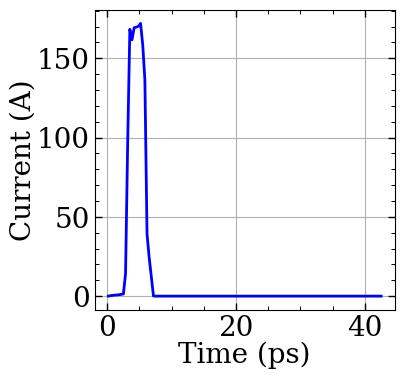

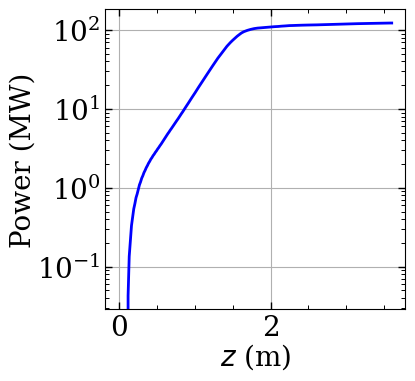

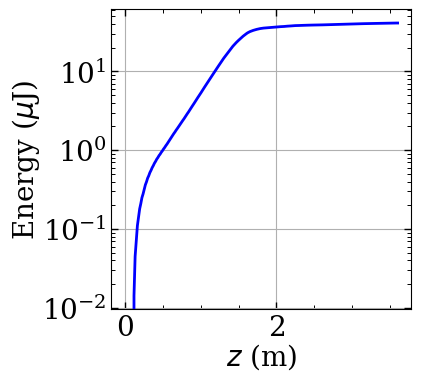

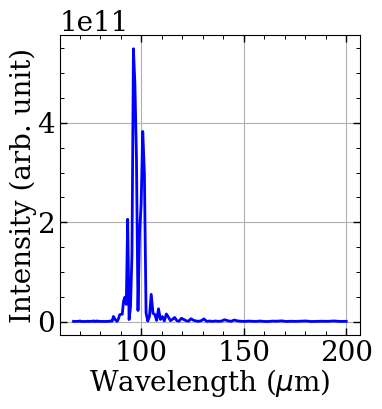

In [12]:
basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_0.5nC_0.5Len_lscOFF"
os.chdir(basedir)

fname = "gen4.seed5.nper10.fitdeg3.out.h5"
    
pg = PostGenesis(fname, debug=1, version=4, fig_ext = '.png')


#### fitting for one job

<>:62: SyntaxWarning: invalid escape sequence '\s'
<>:62: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_3396931/1430444116.py:62: SyntaxWarning: invalid escape sequence '\s'
  plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))


.h5
intensity-farfield phase-farfield 3.6000000000000076


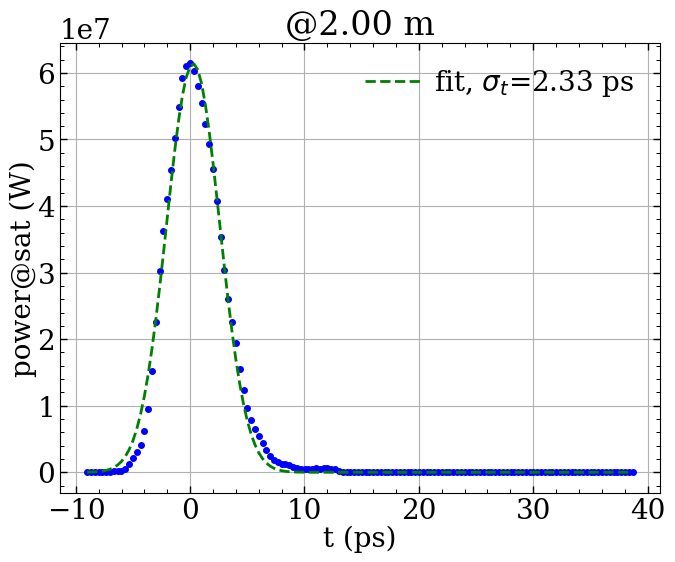

In [24]:
%matplotlib inline

# basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_2nC_twiceLen_lscOFF"
# basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_0.5nC_0.5Len_lscOFF"
# os.chdir(basedir)
# fname = "gen4.seed5.nper10.fitdeg3.out.h5"

workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_2nC_2Len_lscOFF"
workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/"
workdir="/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_2nC/cores_016_impt_32320064_impz_32320064_Np_6.55e+05_phi2_-28.0deg_phi1_5deg_sigt4ps/02_gen4/"
workdir="/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-30.0deg/02_gen4"

os.chdir(workdir)
fname = "./gen4.seed5.nper10.fitdeg3.out.h5"

pg = PostGenesis(fname, debug=0, version=4, fig_ext = '.png')

# Define Gaussian function
from scipy.optimize import curve_fit
def gaussian(x, a, mu, sigma):
    return a * np.exp(-((x - mu) ** 2) / (2 * sigma ** 2))

key = "power"

file = h5py.File(fname,'r')

# pos_satl = np.arange(0.3,3.6,20)
pos_satl=[1.0,1.2,1.4,1.6,1.8,2.0,2.2,2.4,2.6,2.8,3.0]
pos_satl=[2.0]

for pos_sat in pos_satl:
    jj_sat = int( pos_sat/3.6*file["Field"][key].shape[0])
    
    sliceNum = file["Field"][key].shape[1]
    power0 = file["Field"][key][jj_sat,:]
    t0 = np.array(list(range(0,sliceNum)))*100e-6/2.998e8 *1e12 #ps
    max_index = np.argmax(power0)
    t0 -= t0[max_index]
    
    # cut between [-20,20]
    idd = (t0>-40) & (t0<40)
    t = t0[idd]
    power = power0[idd]
    
    max_index = np.argmax(power)
    t -= t[max_index]
    
    # Initial guesses: amplitude=1, mean=0, std dev=1
    p0 = [np.max(power), 0, 1]
    # Perform curve fitting
    params, covariance = curve_fit(gaussian, t, power, p0=p0)
    power_fit = gaussian(t, *params)
    # Extract fitted parameters
    a_fit, mu_fit, sigma_fit = params
    # print(f"Fitted Parameters: Amplitude={a_fit:.3f}, Mean={mu_fit:.3f}, Sigma={sigma_fit:.3f}")
    
    plt.figure(figsize=(8,6))
    
    #t-power    
    plt.title(f"@{pos_sat:.2f} m")
    plt.plot(t[::1],power[::1],'.',markersize=8)
    plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))
    plt.xlabel('t (ps)')
    plt.ylabel(key+"@sat (W)")
    plt.legend()
    plt.grid()



<>:51: SyntaxWarning: invalid escape sequence '\s'
<>:51: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_97414/4279546838.py:51: SyntaxWarning: invalid escape sequence '\s'
  plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))


.h5
intensity-farfield phase-farfield 3.6000000000000076


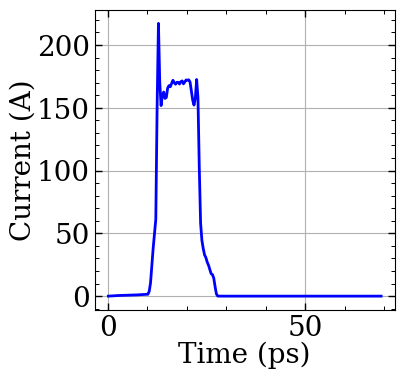

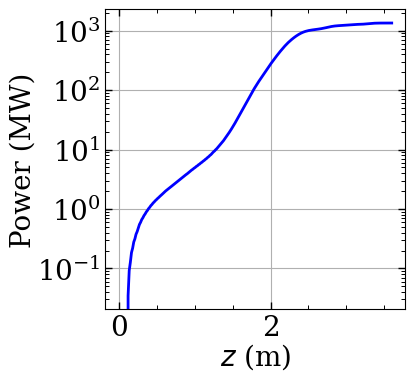

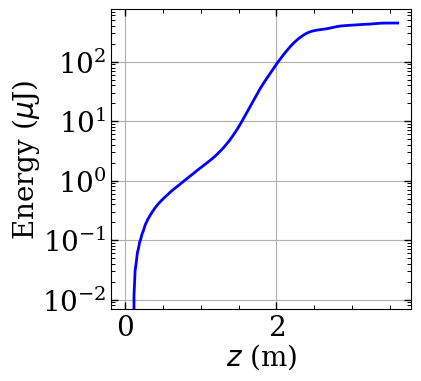

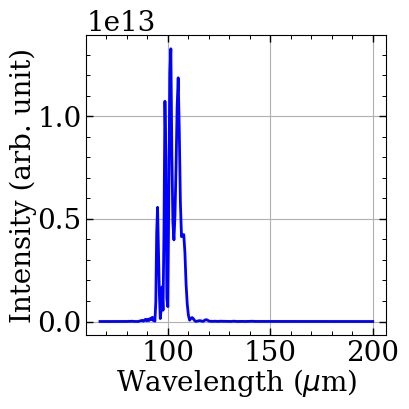

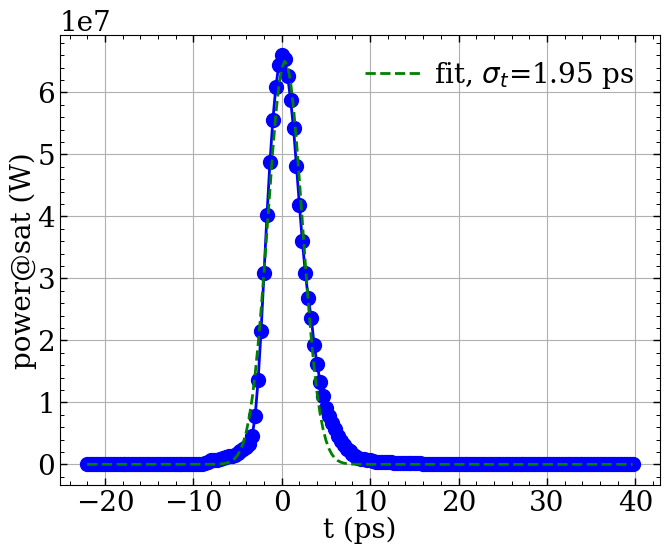

In [24]:
%matplotlib inline

basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_2nC_twiceLen_lscOFF"
# basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_0.5nC_0.5Len_lscOFF"

os.chdir(basedir)

fname = "gen4.seed5.nper10.fitdeg3.out.h5"

pg = PostGenesis(fname, debug=1, version=4, fig_ext = '.png')

# Define Gaussian function
from scipy.optimize import curve_fit
def gaussian(x, a, mu, sigma):
    return a * np.exp(-((x - mu) ** 2) / (2 * sigma ** 2))

key = "power"

file = h5py.File(fname,'r')

pos_sat = 2.5
jj_sat = int( pos_sat/3.6*file["Field"][key].shape[0])

sliceNum = file["Field"][key].shape[1]
power0 = file["Field"][key][jj_sat,:]
t0 = np.array(list(range(0,sliceNum)))*100e-6/2.998e8 *1e12 #ps
max_index = np.argmax(power0)
t0 -= t0[max_index]

# cut between [-20,20]
idd = (t0>-40) & (t0<40)
t = t0[idd]
power = power0[idd]

max_index = np.argmax(power)
t -= t[max_index]

# Initial guesses: amplitude=1, mean=0, std dev=1
p0 = [np.max(power), 0, 1]
# Perform curve fitting
params, covariance = curve_fit(gaussian, t, power, p0=p0)
power_fit = gaussian(t, *params)
# Extract fitted parameters
a_fit, mu_fit, sigma_fit = params
# print(f"Fitted Parameters: Amplitude={a_fit:.3f}, Mean={mu_fit:.3f}, Sigma={sigma_fit:.3f}")

plt.figure(figsize=(8,6))

#t-power    
plt.plot(t[::1],power[::1])
plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))
plt.xlabel('t (ps)')
plt.ylabel(key+"@sat (W)")
plt.legend()
plt.grid()


<>:51: SyntaxWarning: invalid escape sequence '\s'
<>:51: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_97414/2721554148.py:51: SyntaxWarning: invalid escape sequence '\s'
  plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))


.h5
intensity-farfield phase-farfield 3.6000000000000076


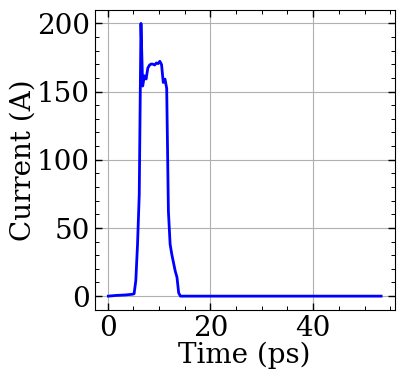

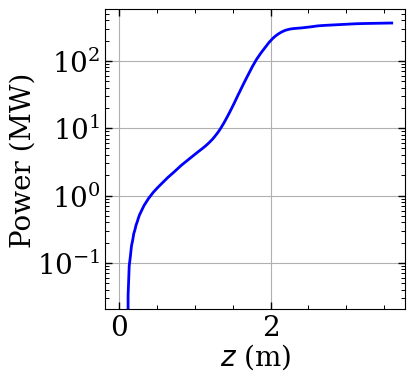

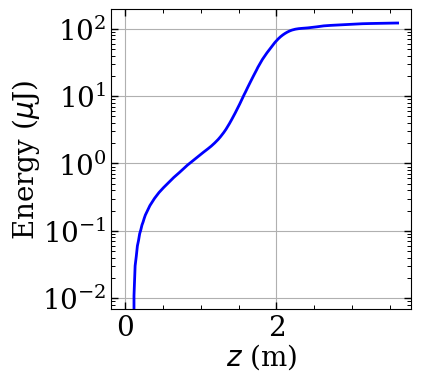

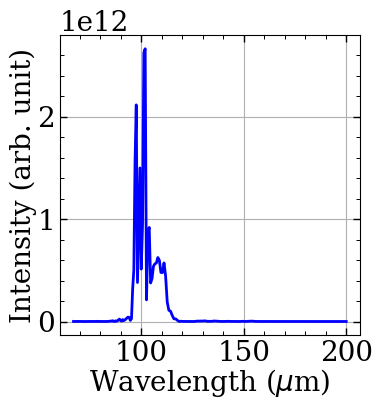

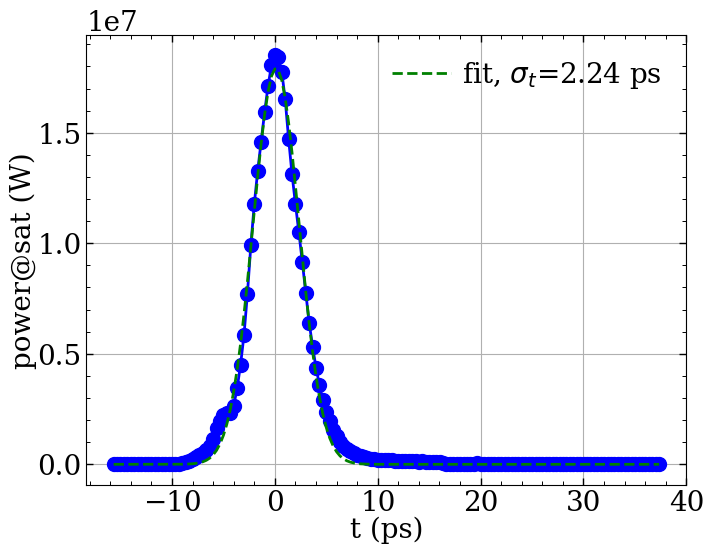

In [25]:
%matplotlib inline

basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4"
# basedir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_0.5nC_0.5Len_lscOFF"

os.chdir(basedir)

fname = "gen4.seed5.nper10.fitdeg3.out.h5"

pg = PostGenesis(fname, debug=1, version=4, fig_ext = '.png')

# Define Gaussian function
from scipy.optimize import curve_fit
def gaussian(x, a, mu, sigma):
    return a * np.exp(-((x - mu) ** 2) / (2 * sigma ** 2))

key = "power"

file = h5py.File(fname,'r')

pos_sat = 2.5
jj_sat = int( pos_sat/3.6*file["Field"][key].shape[0])

sliceNum = file["Field"][key].shape[1]
power0 = file["Field"][key][jj_sat,:]
t0 = np.array(list(range(0,sliceNum)))*100e-6/2.998e8 *1e12 #ps
max_index = np.argmax(power0)
t0 -= t0[max_index]

# cut between [-20,20]
idd = (t0>-40) & (t0<40)
t = t0[idd]
power = power0[idd]

max_index = np.argmax(power)
t -= t[max_index]

# Initial guesses: amplitude=1, mean=0, std dev=1
p0 = [np.max(power), 0, 1]
# Perform curve fitting
params, covariance = curve_fit(gaussian, t, power, p0=p0)
power_fit = gaussian(t, *params)
# Extract fitted parameters
a_fit, mu_fit, sigma_fit = params
# print(f"Fitted Parameters: Amplitude={a_fit:.3f}, Mean={mu_fit:.3f}, Sigma={sigma_fit:.3f}")

plt.figure(figsize=(8,6))

#t-power    
plt.plot(t[::1],power[::1])
plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))
plt.xlabel('t (ps)')
plt.ylabel(key+"@sat (W)")
plt.legend()
plt.grid()


#### scan jobs

<>:109: SyntaxWarning: invalid escape sequence '\s'
<>:117: SyntaxWarning: invalid escape sequence '\s'
<>:109: SyntaxWarning: invalid escape sequence '\s'
<>:117: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_2091814/3341659839.py:109: SyntaxWarning: invalid escape sequence '\s'
  plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))
/tmp/ipykernel_2091814/3341659839.py:117: SyntaxWarning: invalid escape sequence '\s'
  plt.plot(zI,curI,'-',label='$\sigma_t$=%.2f ps' % (sigma_fit_beam))


Fitted Parameters: Amplitude=1917503.374, Mean=-0.684, Sigma=7.087
Fitted Parameters: Amplitude=3194150.213, Mean=2.894, Sigma=5.974
Fitted Parameters: Amplitude=5179103.049, Mean=1.738, Sigma=5.170
Fitted Parameters: Amplitude=8338021.832, Mean=0.994, Sigma=4.536
Fitted Parameters: Amplitude=10750316.321, Mean=0.363, Sigma=3.701
Fitted Parameters: Amplitude=20354095.806, Mean=0.152, Sigma=3.055
Fitted Parameters: Amplitude=20048923.381, Mean=0.176, Sigma=2.719
Fitted Parameters: Amplitude=17452502.282, Mean=1.053, Sigma=3.140
Fitted Parameters: Amplitude=17774540.821, Mean=0.105, Sigma=2.280
Fitted Parameters: Amplitude=2865467.449, Mean=-2.843, Sigma=7.540
Fitted Parameters: Amplitude=1108384.394, Mean=2.014, Sigma=10.841
Fitted Parameters: Amplitude=790989.723, Mean=4.178, Sigma=11.008
Fitted Parameters: Amplitude=1473082.449, Mean=-3.729, Sigma=7.486
Fitted Parameters: Amplitude=8279032.669, Mean=2.241, Sigma=7.249
Fitted Parameters: Amplitude=10691189.136, Mean=0.212, Sigma=6.142


/tmp/ipykernel_2091814/3341659839.py:103: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(8*2.5,6))


Fitted Parameters: Amplitude=46069035.743, Mean=0.045, Sigma=1.825
Fitted Parameters: Amplitude=2929006.039, Mean=-2.017, Sigma=7.843
Fitted Parameters: Amplitude=1470688.343, Mean=-6.508, Sigma=12.488
Fitted Parameters: Amplitude=1955594.914, Mean=4.584, Sigma=8.589
Fitted Parameters: Amplitude=836055.344, Mean=8.930, Sigma=10.038
Fitted Parameters: Amplitude=13646838.503, Mean=1.660, Sigma=5.882
Fitted Parameters: Amplitude=16074308.606, Mean=1.889, Sigma=5.195
Fitted Parameters: Amplitude=19677738.334, Mean=1.698, Sigma=5.122
Fitted Parameters: Amplitude=50568674.818, Mean=-0.048, Sigma=2.374
Fitted Parameters: Amplitude=47365333.190, Mean=0.313, Sigma=2.114
Fitted Parameters: Amplitude=65112996.090, Mean=-0.048, Sigma=2.070
Fitted Parameters: Amplitude=58707676.862, Mean=0.127, Sigma=2.099
Fitted Parameters: Amplitude=40135808.616, Mean=-0.860, Sigma=3.260
Fitted Parameters: Amplitude=35688706.427, Mean=0.028, Sigma=1.997
Fitted Parameters: Amplitude=1841966.038, Mean=-1.520, Sigma

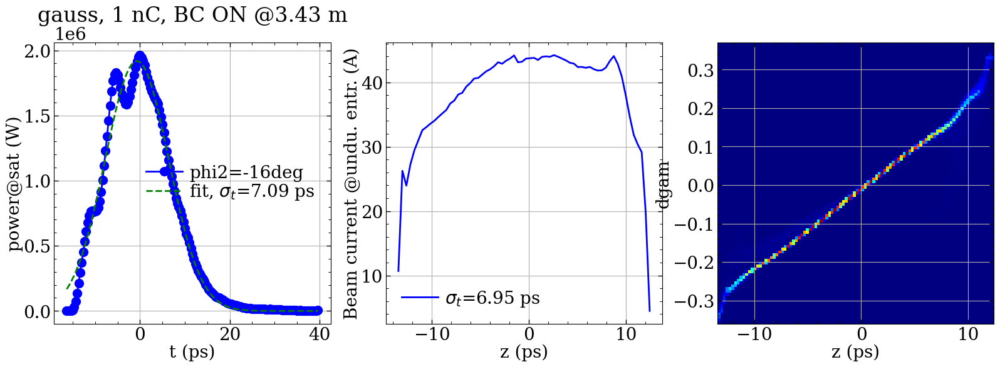

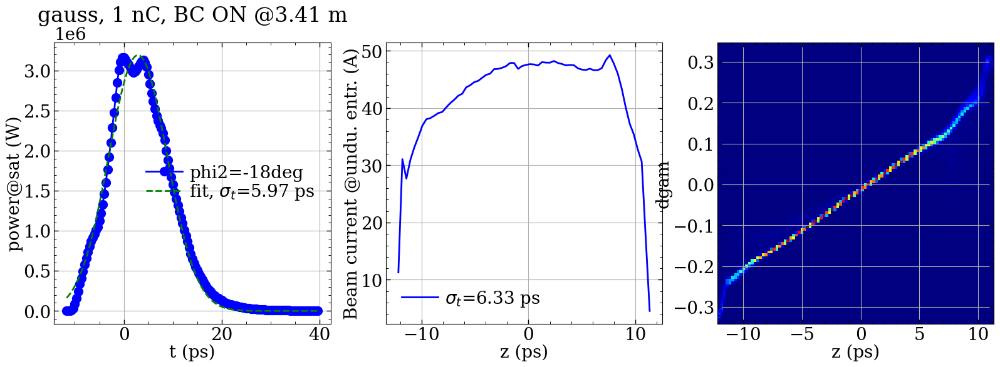

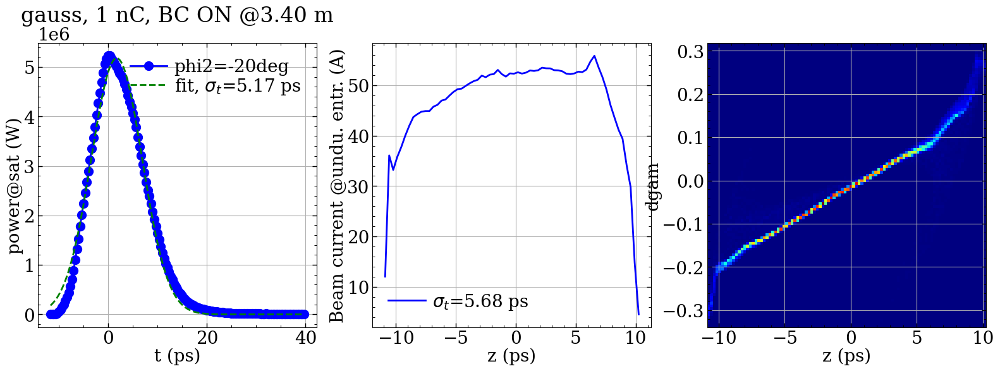

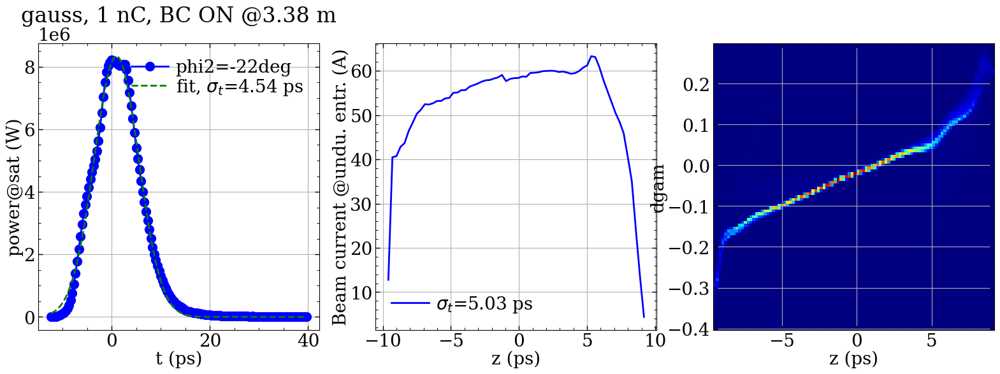

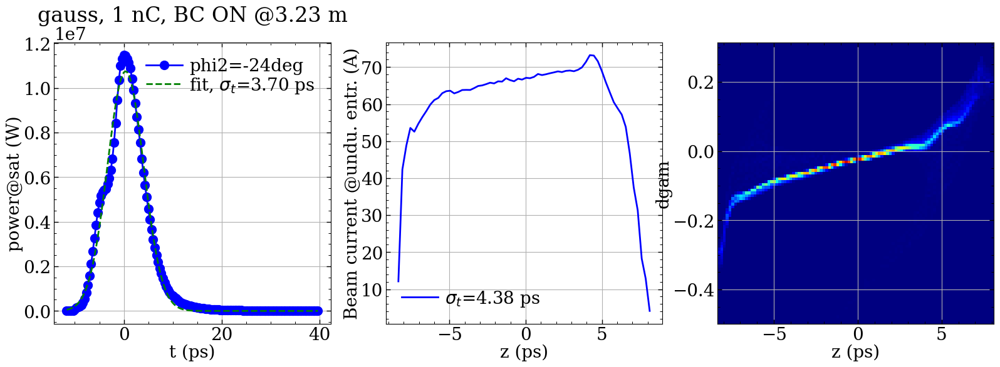

...

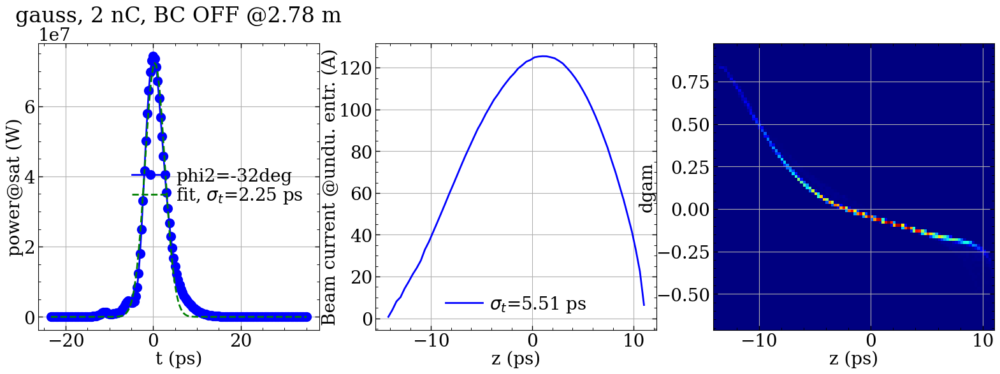

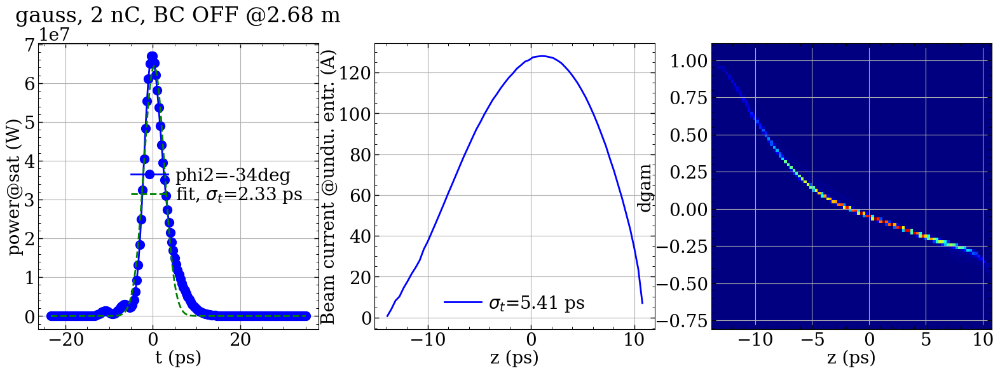

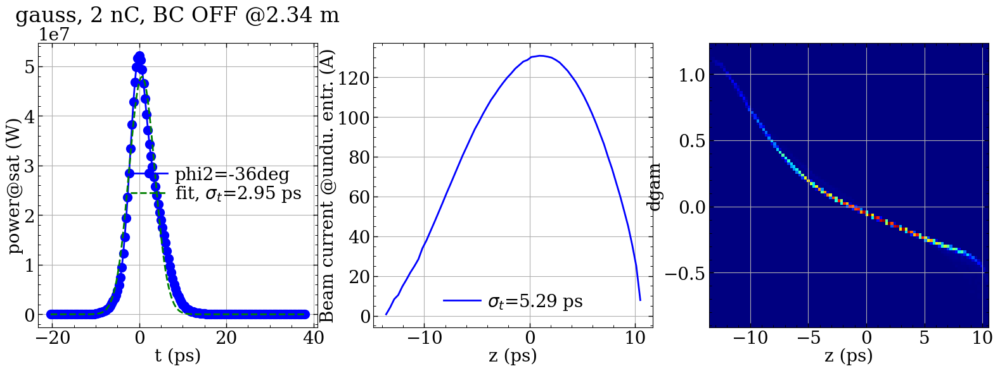

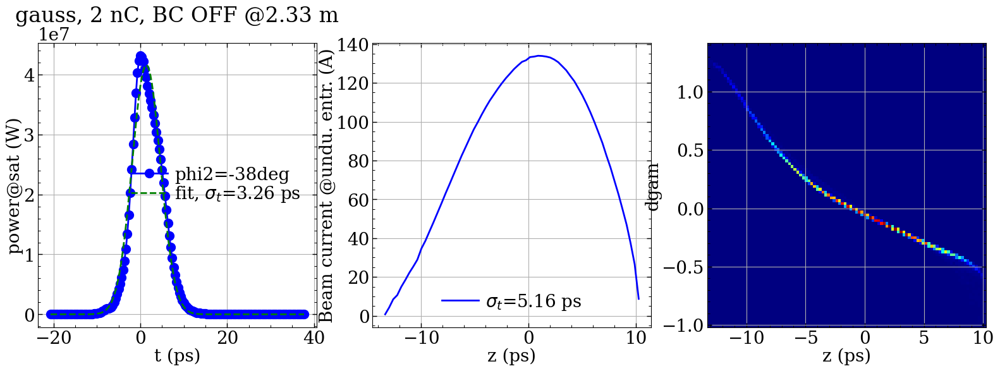

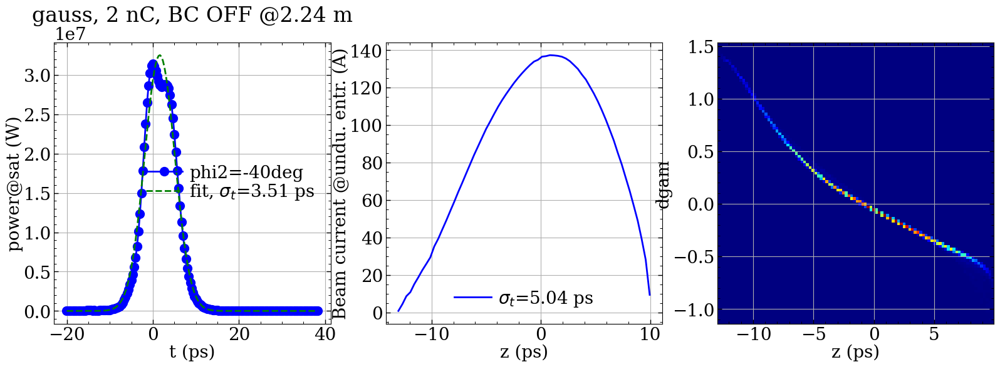

In [13]:
rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'

# uncomment the fitting current lines for flattop, I commented them for gauss case
# profile = "flattop"
# bc_statl = ["ON","OFF"]
# chargel = [1,1.5,2]  #nC
# degl = np.arange(0, -26-1, -2)

profile = "gauss"
bc_statl = ["ON","OFF"]
chargel = [1,1.5,1.75,2]  #nC
degl = np.arange(-16, -40-1, -2)

# #for debug
# bc_statl = ["ON"]
# chargel = [1]  #nC
# degl = [-32]

# Define Gaussian function
from scipy.optimize import curve_fit
def gaussian(x, a, mu, sigma):
    return a * np.exp(-((x - mu) ** 2) / (2 * sigma ** 2))

key = "power"

for bc_stat in bc_statl:
    for charge in chargel:
        basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC/"
        os.chdir(basedir)
        
        dat = np.loadtxt("seed5_degl_Lsat.txt")
        degll    = dat[:,0]
        pos_satl = dat[:,1]
        interp_func_posSat= interp1d(degll, pos_satl, kind='linear', fill_value="extrapolate")
        
        j=0
        sigl = []
        sigl_beam = []
        for deg in degl:    
            gen4path = "cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_{:.1f}deg/02_gen4/".format(deg)
            if bc_stat == "OFF":
                fname = "gen4.seed5.nper5.fitdeg1.out.h5"
            else:
                fname = "gen4.seed5.nper10.fitdeg3.out.h5"
                
            # pg = PostGenesis(fname, debug=0, version=4, fig_ext = '.png')
            file = h5py.File(gen4path+fname,'r')

            pos_sat = interp_func_posSat(deg)
            jj_sat = int( pos_sat/3.6*file["Field"][key].shape[0])
            
            sliceNum = file["Field"][key].shape[1]
            power0 = file["Field"][key][jj_sat,:]
            t0 = np.array(list(range(0,sliceNum)))*100e-6/2.998e8 *1e12 #ps
            max_index = np.argmax(power0)
            t0 -= t0[max_index]
            
            # cut between [-20,20]
            idd = (t0>-40) & (t0<40)
            t = t0[idd]
            power = power0[idd]
            
            max_index = np.argmax(power)
            t -= t[max_index]
            
            # Initial guesses: amplitude=1, mean=0, std dev=1
            p0 = [np.max(power), 0, 1]
            # Perform curve fitting
            params, covariance = curve_fit(gaussian, t, power, p0=p0)
            power_fit = gaussian(t, *params)
            # Extract fitted parameters
            a_fit, mu_fit, sigma_fit = params
            print(f"Fitted Parameters: Amplitude={a_fit:.3f}, Mean={mu_fit:.3f}, Sigma={sigma_fit:.3f}")
            sigl.append(sigma_fit)

            # add beam current profile plot
            fort11003 = np.loadtxt(f"{gen4path}../01_impz/fort.11003")
            zI = fort11003[:,0]/2.998e8*1e12 #ps
            curI = fort11003[:,2]

            # #fitting current profile
            # max_index = np.argmax(curI)
            # zI -= zI[max_index]
            # # Initial guesses: amplitude=1, mean=0, std dev=1
            # p0 = [np.max(curI), 0, 1]
            # # Perform curve fitting
            # params, covariance = curve_fit(gaussian, zI, curI, p0=p0)
            # curI_fit = gaussian(zI, *params)
            # # Extract fitted parameters
            # a_fit_beam, mu_fit_beam, sigma_fit_beam = params
            # print(f"Fitted Parameters for beam current: Amplitude={a_fit_beam:.3f}, Mean={mu_fit_beam:.3f}, Sigma={sigma_fit_beam:.3f}")
            # sigl_beam.append(sigma_fit_beam)

            fort1003 = np.loadtxt(f"{gen4path}../01_impz/fort.1003",skiprows=1)
            z = fort1003[:,4]/2.998e8*1e12 #ps

            #get sigl from std(z)
            sigma_fit_beam = np.std(z)
            sigl_beam.append(sigma_fit_beam)
            
            dgam = fort1003[:,5]
         
            plt.figure(figsize=(8*2.5,6))

            #t-power    
            plt.subplot(1,3,1)
            plt.title(f"{profile}, {charge} nC, BC {bc_stat} @{pos_sat:.2f} m")
            plt.plot(t[::1],power[::1],label="phi2="+str(deg)+"deg")
            plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))
            plt.xlabel('t (ps)')
            plt.ylabel(key+"@sat (W)")
            plt.legend()
            plt.grid()

            # current profile
            plt.subplot(1,3,2)
            plt.plot(zI,curI,'-',label='$\sigma_t$=%.2f ps' % (sigma_fit_beam))
            # plt.plot(zI, curI_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit_beam))
            plt.grid()
            plt.legend()
            plt.xlabel("z (ps)")
            plt.ylabel("Beam current @undu. entr. (A)")

            #z-dgam phase space
            plt.subplot(1,3,3)
            # plt.plot(z,dgam,'.')
            plt.hist2d(z,dgam,bins=100,cmap="jet")
            plt.grid()
            plt.xlabel("z (ps)")
            plt.ylabel("dgam")
            
            plt.savefig(basedir+f"/t_power_fitting_phi2={deg}deg")
            # plt.close()
            
            j=j+1
        
        dat = np.column_stack((degl,sigl,sigl_beam))
        np.savetxt(basedir+"degl_sigl.txt",dat)

### convert into MP4
not finished yet

In [ ]:
import imageio.v2 as imageio

rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'
os.chdir(rootdir)

profile = "gauss"
# bc_statl = ["ON","OFF"]
# chargel = [1,1.5,1.75,2]  #nC
# degl = np.arange(-16, -40-1, -2)

# for debug
bc_stat = "ON"
charge = 1
degl = np.arange(-16, -40-1, -2)

# for bc_stat in bc_statl:
#     for charge in chargel:
#         basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC/"
#         os.chdir(basedir)

# basedir+f"/t_power_fitting_phi2={deg}deg"

for deg in degl:
    
    basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC/"
    fname = basedir+f"/t_power_fitting_phi2={deg}deg"


# List of PNG files (ensure they are in the correct order)
png_files = [f"frame_{i:02d}.png" for i in range(1, 21)]  # Adjust filenames as needed

# Output MP4 file
output_file = "output.mp4"

# Create video writer
fps = 10  # Adjust frame rate as needed
with imageio.get_writer(output_file, fps=fps, codec="libx264") as writer:
    for filename in png_files:
        image = imageio.imread(filename)
        writer.append_data(image)

print(f"Video saved as {output_file}")


### sig_beam & sig_THz

For BC OFF, when phi2 gose to <-10 deg, two THz pulses are being generated, thus, the sig_THz is increasing with shorter bunch.

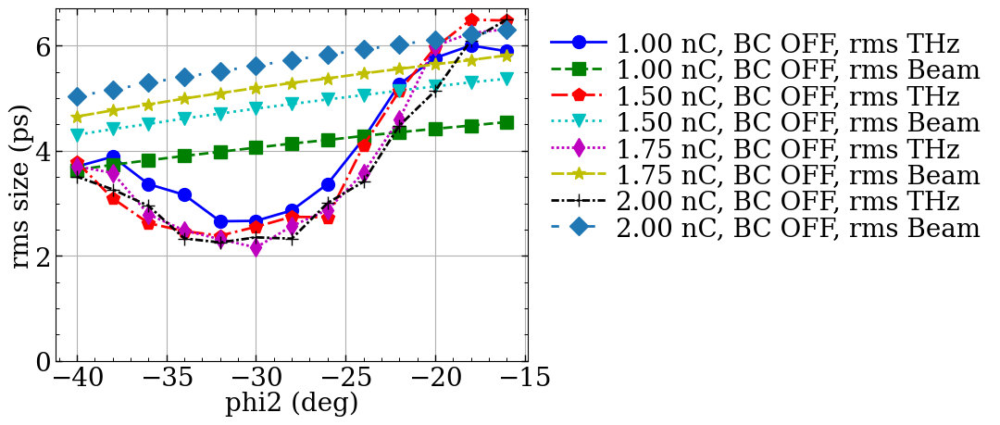

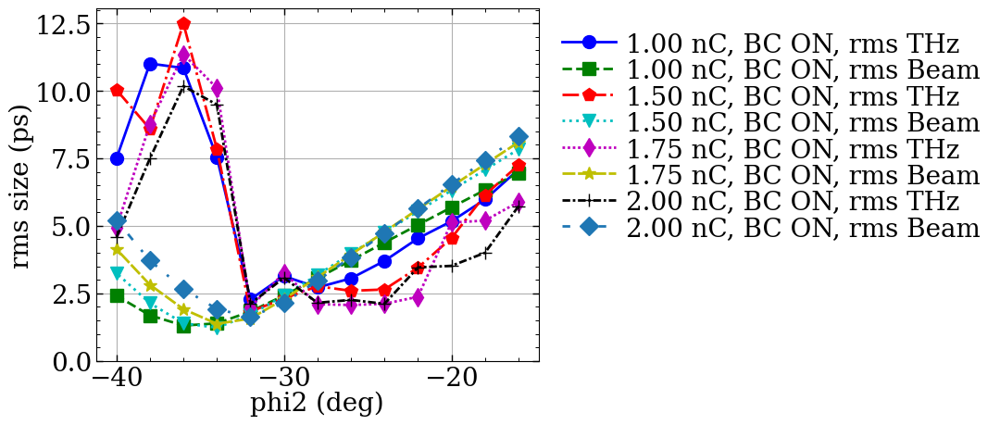

In [14]:
rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'
# profile = "flattop"
profile = "gauss"
bc_statl = ["ON","OFF"]

chargel = [1,1.5,1.75,2]  #nC

def plot_rmsBeamPul(bc_stat):
    plt.figure(figsize=(8*1.4,5))
    for charge in chargel:
        basedir = f'{rootdir}{profile}_bc{bc_stat}_{charge}nC'
        fname = basedir+"/degl_sigl.txt"
        
        dat= np.loadtxt(fname)
        plt.plot(dat[:,0],dat[:,1],label=f'{charge:.2f} nC, BC {bc_stat}, rms THz')
        plt.plot(dat[:,0],dat[:,2],label=f'{charge:.2f} nC, BC {bc_stat}, rms Beam')
        
    plt.grid()
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.xlabel("phi2 (deg)")
    plt.ylabel("rms size (ps)")  
    plt.ylim([0,None])
    plt.tight_layout()
      
    plt.savefig(rootdir+f"{profile}_phi2_sigBeamTHz_bc{bc_stat}.png")

plot_rmsBeamPul("OFF")
plot_rmsBeamPul("ON")

### phi2 - THz pulse lens 

In [17]:
%matplotlib qt

rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'
profile = "gauss"
bc_statl = ["ON","OFF"]

chargel = [1,1.5,2]  #nC

def plot_phi2_rmsPul(bc_stat):
    plt.figure(figsize=(8,6))
    for charge in chargel:
        basedir = f'{rootdir}{profile}_bc{bc_stat}_{charge}nC'
        fname = basedir+"/degl_sigl.txt"
        
        dat= np.loadtxt(fname)
        plt.plot(dat[:,0],dat[:,1],label=f'BC {bc_stat}, {charge} nC')
        
    plt.grid()
    plt.legend()
    plt.xlabel("phi2 (deg)")
    plt.ylabel("rms THz pulse Len. (ps)")  
    plt.ylim([1,None])
      
    plt.savefig(rootdir+f"{profile}_phi2_PulseLen_bc{bc_stat}.png")

plot_phi2_rmsPul("OFF")
plot_phi2_rmsPul("ON")

## 20 seeds: phi2-THz pulse length

<>:80: SyntaxWarning: invalid escape sequence '\s'
<>:80: SyntaxWarning: invalid escape sequence '\s'
/tmp/ipykernel_3857912/147583620.py:80: SyntaxWarning: invalid escape sequence '\s'
  plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))


Fitted Parameters: Amplitude=1156057.689, Mean=0.703, Sigma=6.304
Fitted Parameters: Amplitude=1319572.804, Mean=0.098, Sigma=6.025
Fitted Parameters: Amplitude=1292123.327, Mean=-0.510, Sigma=6.071
Fitted Parameters: Amplitude=1264118.551, Mean=-0.112, Sigma=6.076
Fitted Parameters: Amplitude=1316489.238, Mean=-0.642, Sigma=5.980
Fitted Parameters: Amplitude=1322263.289, Mean=0.296, Sigma=5.975
Fitted Parameters: Amplitude=1332964.119, Mean=0.546, Sigma=5.768
Fitted Parameters: Amplitude=1201254.034, Mean=-0.437, Sigma=6.230
Fitted Parameters: Amplitude=1201244.990, Mean=0.351, Sigma=6.141
Fitted Parameters: Amplitude=1390484.032, Mean=-0.086, Sigma=5.875
Fitted Parameters: Amplitude=1260870.051, Mean=0.803, Sigma=6.056
Fitted Parameters: Amplitude=1367656.614, Mean=0.258, Sigma=5.777
Fitted Parameters: Amplitude=1252642.523, Mean=0.575, Sigma=6.105
Fitted Parameters: Amplitude=1370710.250, Mean=0.301, Sigma=5.920
Fitted Parameters: Amplitude=1582220.981, Mean=-0.051, Sigma=5.676
Fitt

/tmp/ipykernel_3857912/147583620.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(20/2,12/2))


Fitted Parameters: Amplitude=12713125.929, Mean=-2.012, Sigma=6.639
Fitted Parameters: Amplitude=11499647.158, Mean=4.077, Sigma=7.020
Fitted Parameters: Amplitude=12119414.333, Mean=-2.195, Sigma=6.869
Fitted Parameters: Amplitude=12013431.136, Mean=-2.122, Sigma=6.848
Fitted Parameters: Amplitude=12728259.848, Mean=4.300, Sigma=6.630
Fitted Parameters: Amplitude=12890580.906, Mean=-2.036, Sigma=6.411
Fitted Parameters: Amplitude=12072375.200, Mean=-2.354, Sigma=6.907
Fitted Parameters: Amplitude=12526461.852, Mean=-2.276, Sigma=6.744
Fitted Parameters: Amplitude=13164803.859, Mean=-1.832, Sigma=6.417
Fitted Parameters: Amplitude=12579747.651, Mean=-2.084, Sigma=6.607
Fitted Parameters: Amplitude=12410046.160, Mean=-1.797, Sigma=6.770
Fitted Parameters: Amplitude=12531772.199, Mean=3.975, Sigma=6.565
Fitted Parameters: Amplitude=11931218.984, Mean=4.515, Sigma=6.772
Fitted Parameters: Amplitude=12765533.672, Mean=-2.162, Sigma=6.370
Fitted Parameters: Amplitude=12430728.462, Mean=-2.1

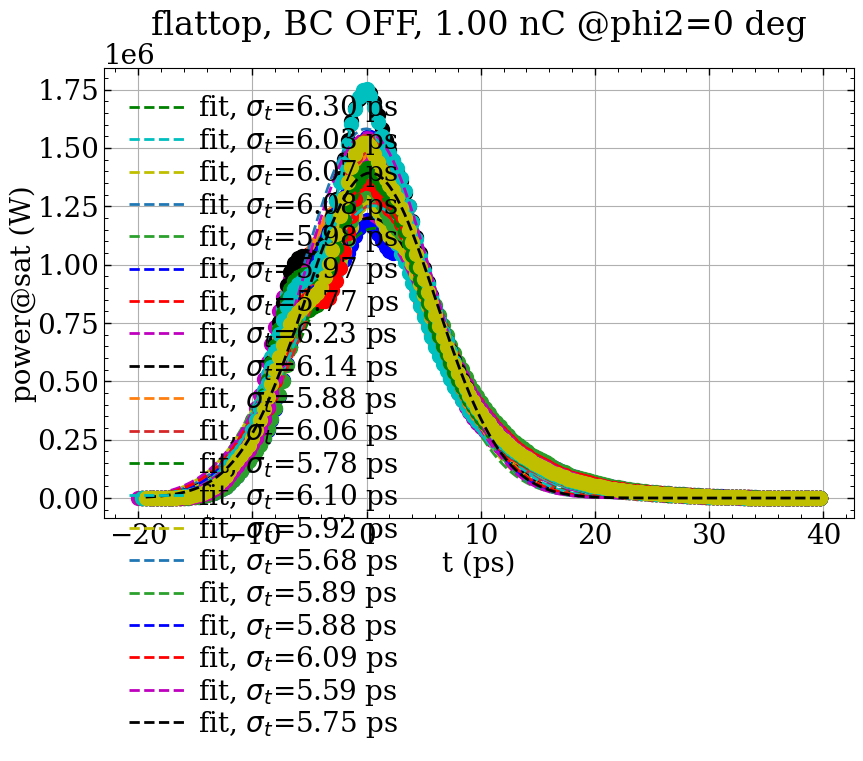

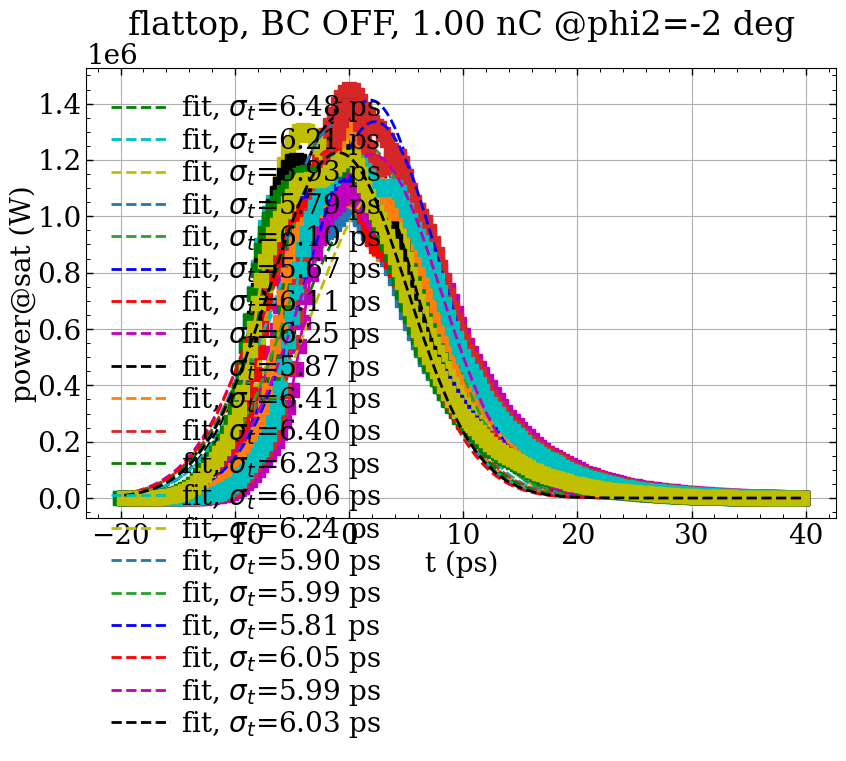

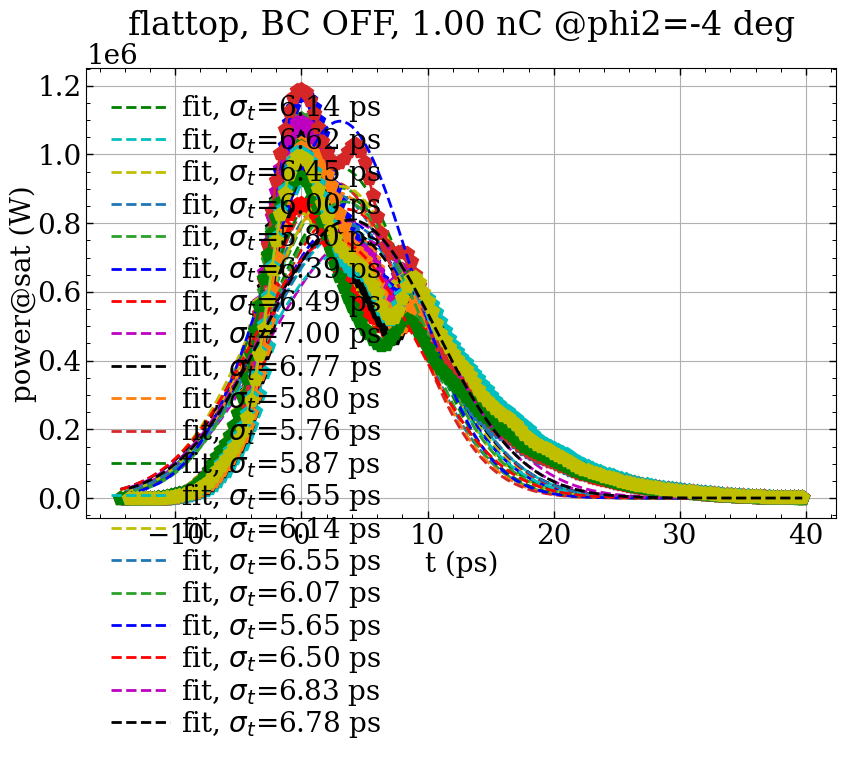

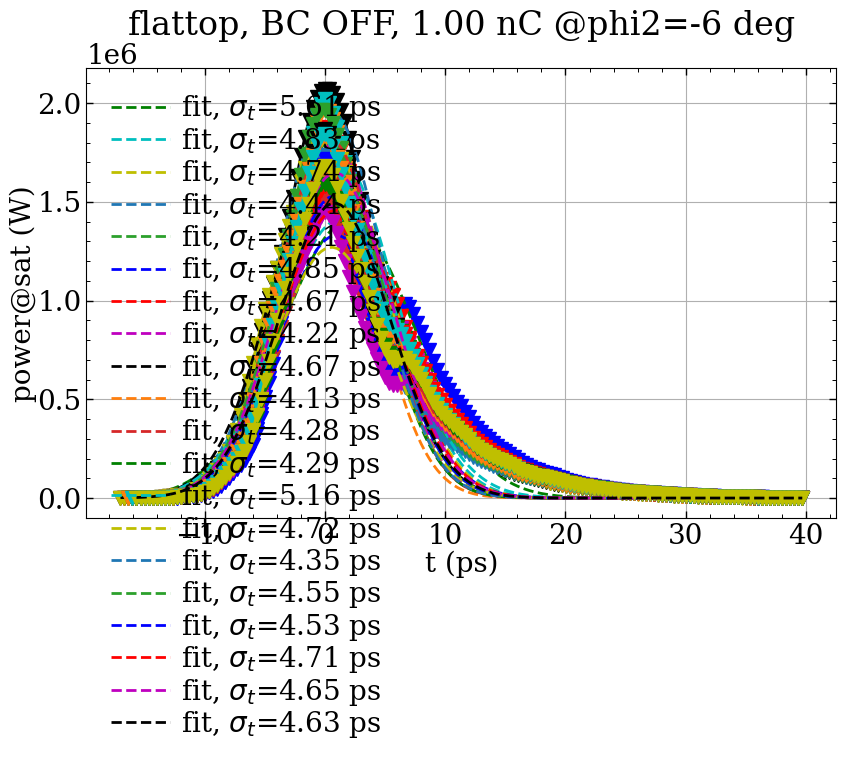

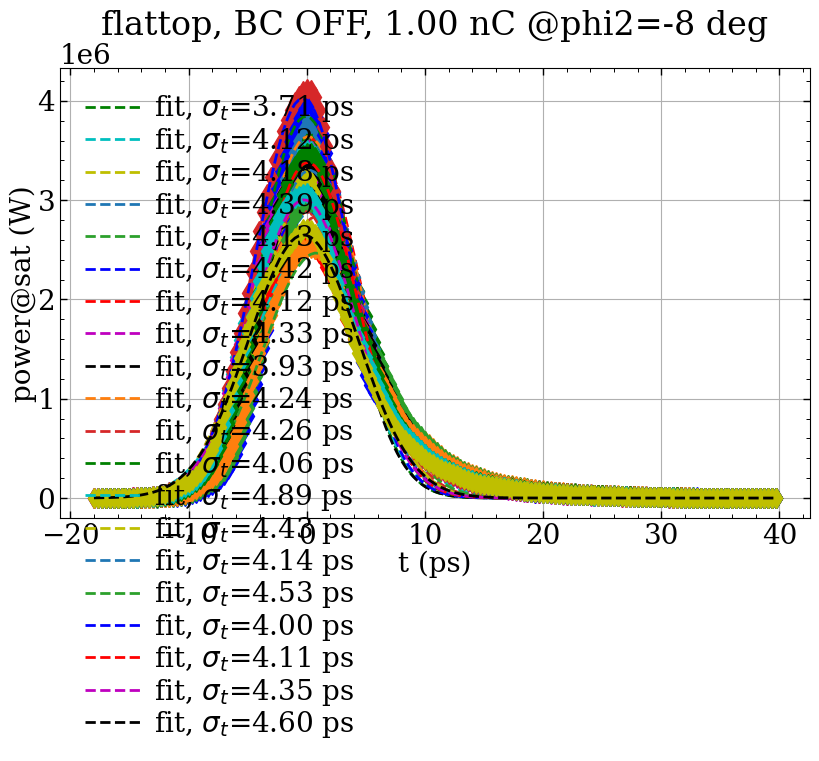

...

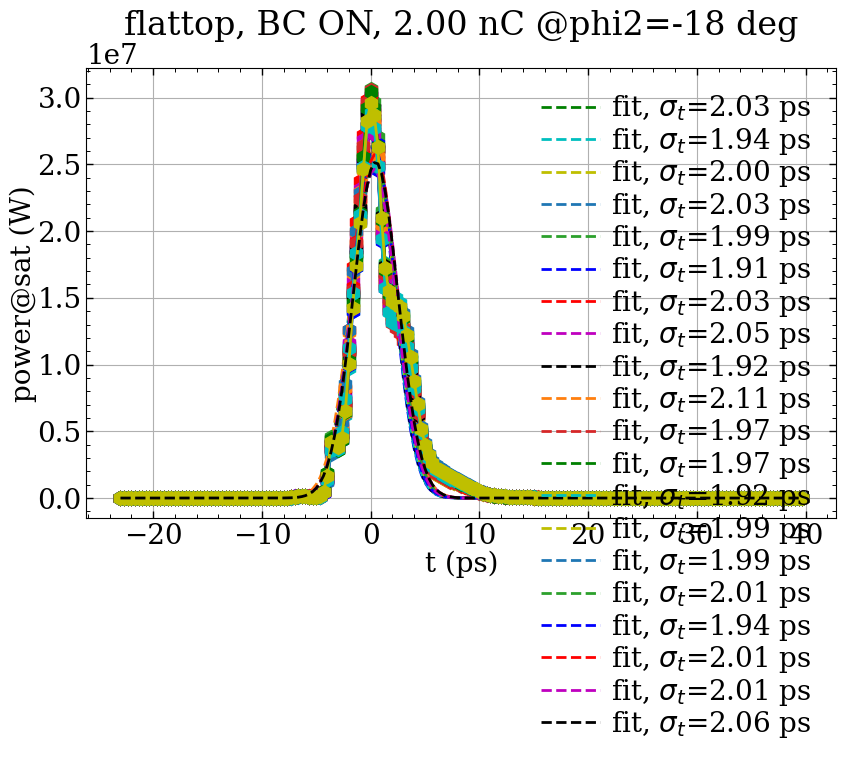

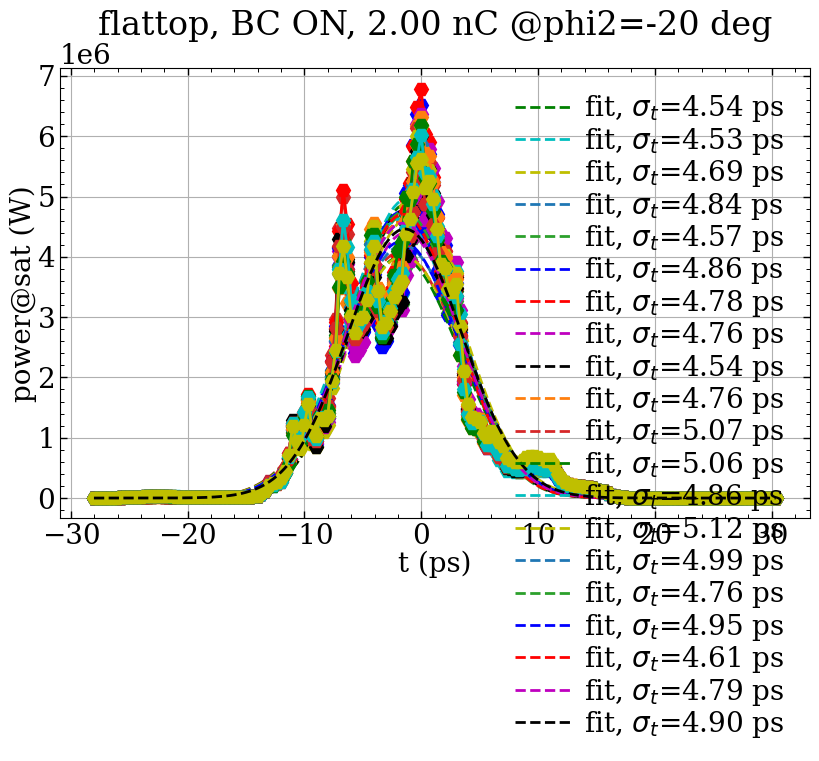

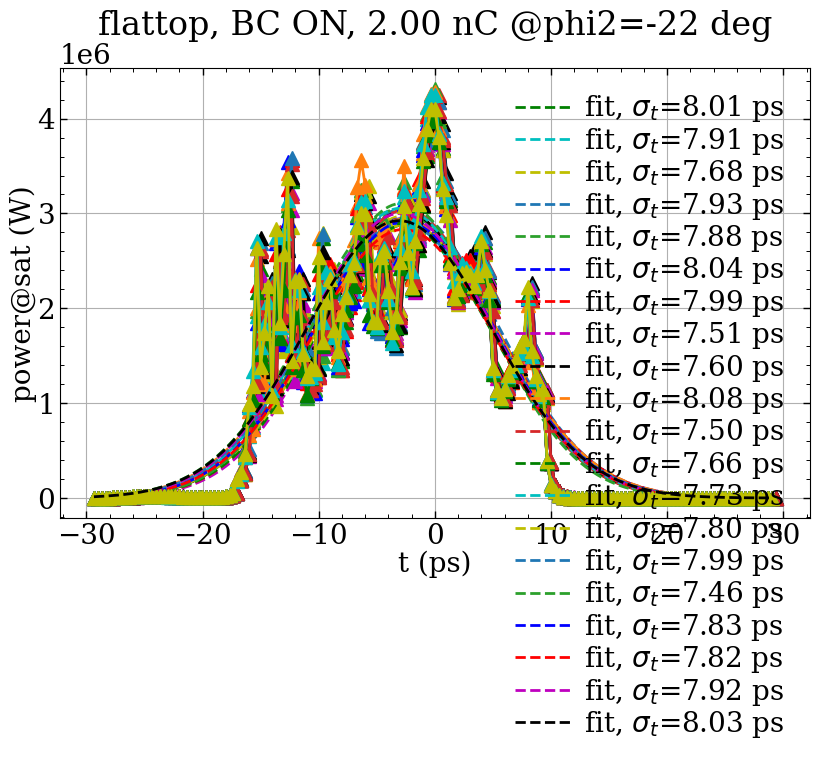

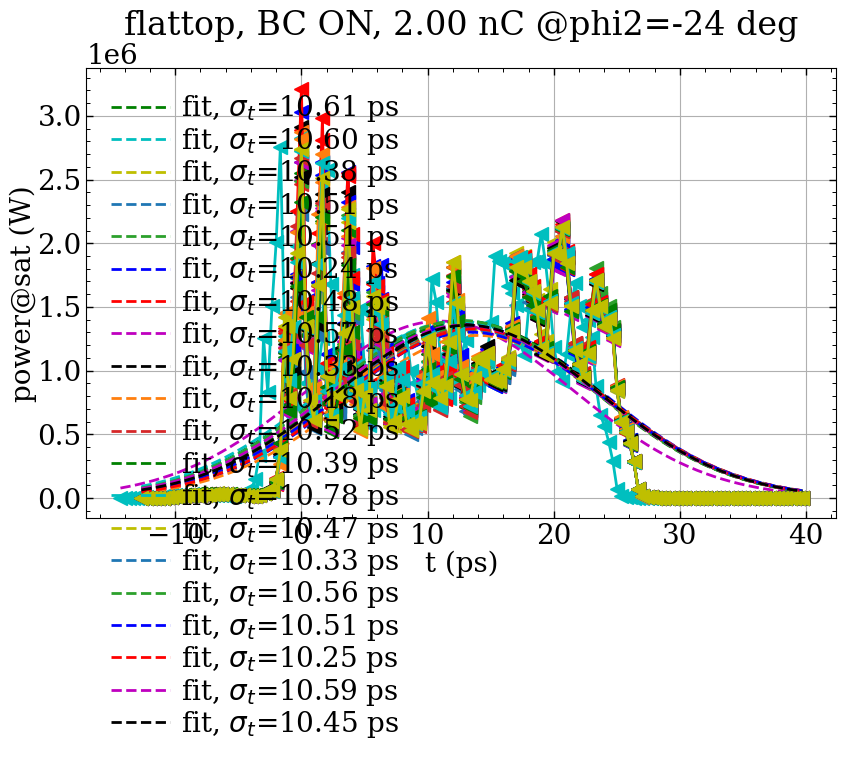

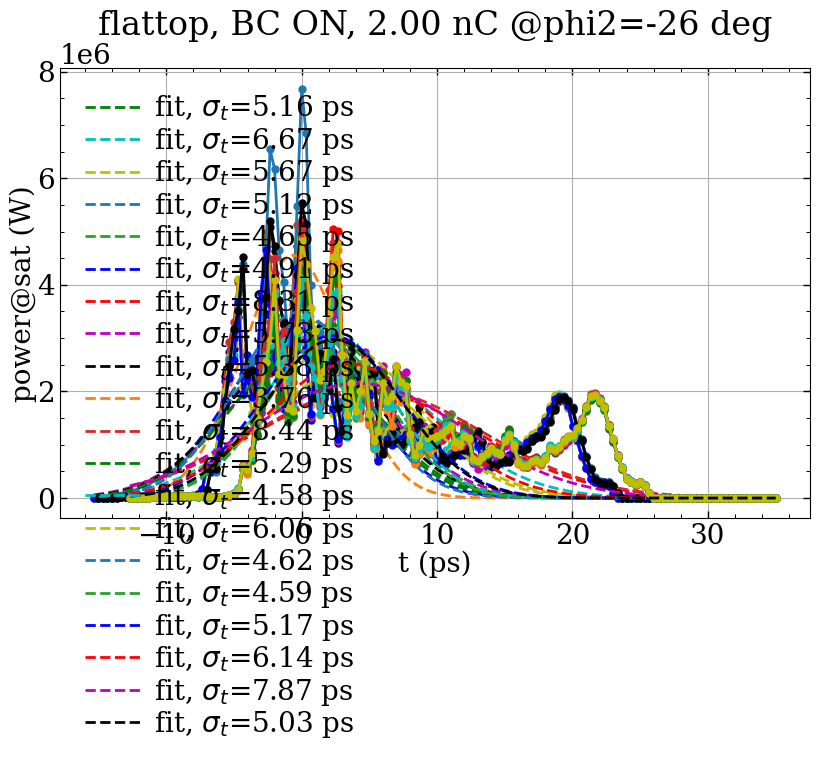

In [36]:
rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'
markers = ['o', 's', 'p', 'v', 'd', '*', '+', 'D', '>', 'h', 'H', '^', '<', '.', ',','o', 's', 'p', 'v', 'd', '*', '+', 'D', '>', 'h', 'H', '^', '<', '.', ',']

# profile = "gauss"
# chargel = [1, 1.5, 1.75, 2]  #nC
# bc_statl = ["OFF","ON"]
# degl = np.arange(-16, -40 -1, -2)
# seedl = np.arange(5,25,1)

profile = "flattop"
chargel = [1,1.5,2]  #nC
bc_statl = ["OFF","ON"]
degl = np.arange(0,-26-1,-2)
seedl = np.arange(5,25,1)

# Define Gaussian function
from scipy.optimize import curve_fit
def gaussian(x, a, mu, sigma):
    return a * np.exp(-((x - mu) ** 2) / (2 * sigma ** 2))

for bc_stat in bc_statl:
    for charge in chargel:
    
        basedir = f'/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC/'
        os.chdir(basedir)
        
        dat = np.loadtxt("20seeds_ave_degl_Lsat.txt")
        Lsat = dat[:,1]
        pos_sat = dat[:,1] 
        
        j=0
        key = "power"
        
        min_sigt=[]
        max_sigt=[]
        ave_sigt=[]
        for deg in degl:    
            tmp = "cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_{:.1f}deg/02_gen4/".format(deg)
            
            plt.figure(figsize=(20/2,12/2))            
            sigl = []
            for seed in seedl:
                if bc_stat == "OFF":
                    fname = f"gen4.seed{seed}.nper5.fitdeg1.out.h5"
                else:
                    fname = f"gen4.seed{seed}.nper10.fitdeg3.out.h5"
                
                # pg = PostGenesis(fname, debug=0, version=4, fig_ext = '.png')
                file = h5py.File(tmp+fname,'r')
                
                jj_sat = int(pos_sat[j]/3.6*file["Field"][key].shape[0])
                
                sliceNum = file["Field"][key].shape[1]
                power0 = file["Field"][key][jj_sat,:]
                t0 = np.array(list(range(0,sliceNum)))*100e-6/2.998e8 *1e12 #ps
                max_index = np.argmax(power0)
                t0 -= t0[max_index]
                
                # cut between [-20,20]
                # idd = (t0>-100) & (t0<100)
                idd = (t0>-40) & (t0<40)
                t = t0[idd]
                power = power0[idd]
                
                max_index = np.argmax(power)
                t -= t[max_index]
                
                # Initial guesses: amplitude=1, mean=0, std dev=1
                p0 = [np.max(power), 0, 1]
                # Perform curve fitting
                params, covariance = curve_fit(gaussian, t, power, p0=p0)
                power_fit = gaussian(t, *params)
                # Extract fitted parameters
                a_fit, mu_fit, sigma_fit = params
                print(f"Fitted Parameters: Amplitude={a_fit:.3f}, Mean={mu_fit:.3f}, Sigma={sigma_fit:.3f}")
                sigl.append(sigma_fit)
                
                
                plt.plot(t[::1],power[::1],'-',marker=markers[j])
                plt.plot(t, power_fit,'--',label='fit, $\sigma_t$=%.2f ps' % (sigma_fit))
            plt.title("phi2="+str(deg)+"deg")   
            plt.xlabel('t (ps)')
            plt.ylabel(key+"@sat (W)")
            plt.legend()
            plt.grid()
            plt.title(f"{profile}, BC {bc_stat}, {charge:.2f} nC @phi2={deg} deg")
            plt.savefig(basedir+f"/bc_{bc_stat}_t_power_fitting_20seeds_phi2={deg}deg")
            # plt.close()
            
            min_sigt.append(np.min(sigl))
            max_sigt.append(np.max(sigl))
            ave_sigt.append(np.mean(sigl))
            
            j=j+1
            
        
        dat = np.column_stack((degl,ave_sigt,min_sigt,max_sigt))
        np.savetxt(basedir+"/20seeds_degl_ave_min_max_sigt.txt",dat)



### then plot together

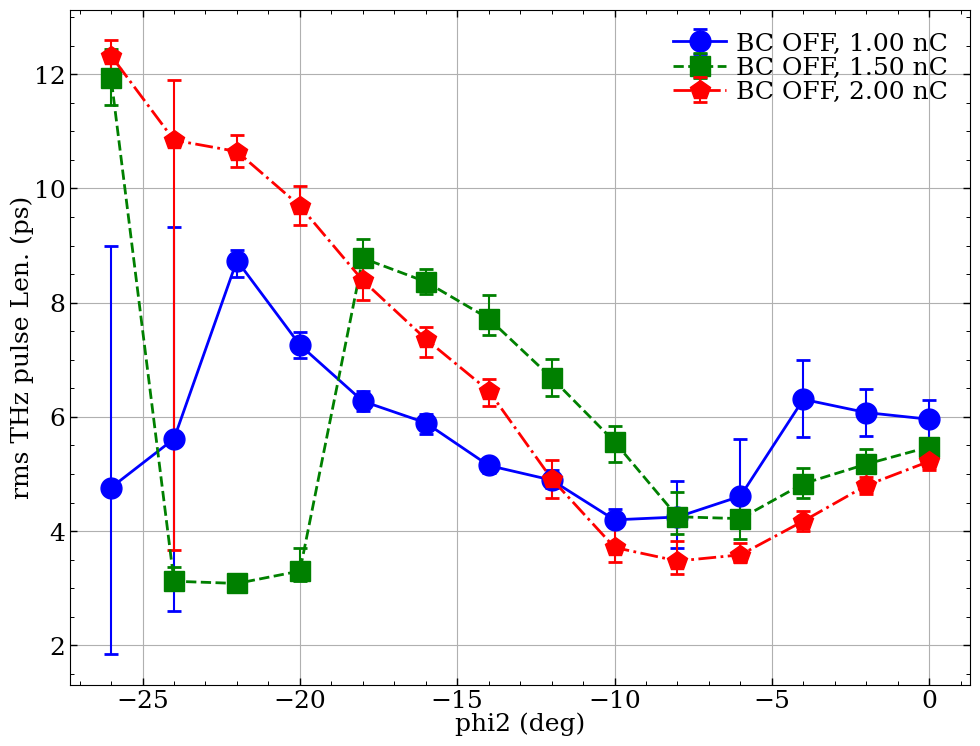

In [38]:
# Set global styles
font = 18
plt.rcParams['font.size'] = font  # Default font size (affects labels, titles, legend)
plt.rcParams['lines.linewidth'] = 2  # Default line width
plt.rcParams['lines.markersize'] = 2 # 10  # Default marker size
plt.rcParams['legend.fontsize'] = font  # Default legend font size
plt.rcParams['xtick.labelsize'] = font  # X-axis tick label size
plt.rcParams['ytick.labelsize'] = font  # Y-axis tick label size
import matplotlib as mpl
mpl.rcParams['savefig.bbox'] = 'tight'

rootdir = r'/lustre/fs22/group/pitz/biaobin/2025/'

#%%%% plot together
profile = "flattop"
chargel = [1,1.5,2]  #nC

bc_statl = ["OFF","ON"]
bc_statl = ["OFF"]

#---------------------------------------  
plt.figure(figsize=(8*1.5,6*1.5))  

for bc_stat in bc_statl:
    for charge in chargel:
        basedir = rootdir+f'{profile}_bc{bc_stat}_{charge}nC/'
        fname = "20seeds_degl_ave_min_max_sigt.txt"
        
        dat = np.loadtxt(basedir+fname)
        degl  = dat[:,0]
        avePL = dat[:,1]
        minPL = dat[:,2]
        maxPL = dat[:,3]
        lowErr= np.array(avePL)-np.array(minPL)
        uppErr= np.array(maxPL)-np.array(avePL)
    
        errors = np.array([lowErr,uppErr])
        
        plt.errorbar(degl, avePL, yerr=errors,markersize=15, \
                      capsize=5, capthick=2, elinewidth=1.5,label=f'BC {bc_stat:<3}, {charge:.2f} nC')   
        plt.legend()    
        # plt.legend(handletextpad=1.5, borderpad=1.2)


plt.xlabel("phi2 (deg)")
plt.ylabel("rms THz pulse Len. (ps)")
plt.grid()
plt.savefig(rootdir+f"{profile}_phi2-PulseLen-20seeds-BC{'-'.join(bc_statl)}.png")


## spectrum

In [19]:
rootdir = f"/lustre/fs22/group/pitz/biaobin/2025/"
os.chdir(rootdir)

profile = "flattop"

# profile = "gauss"
# bc_stat = "ON"
bc_stat = "ON"

chargel = [1,1.5,2]

# degl = [-32]
# degl = np.arange(-16,-40-1,-2)
# degl = np.arange(0,-26-1,-2)
degl = [-16]

for deg in degl:
    plt.figure(figsize=(8,6))
    markers = ['o', 's', '^', 'v', '<', '>', 'd', 'D', 'p', '*', 'h', 'H', 'x', '+', '.', ',']
    for charge in chargel:
       
        basedir = f"/lustre/fs22/group/pitz/biaobin/2025/{profile}_bc{bc_stat}_{charge}nC/"
        os.chdir(basedir)
        
        dat = np.loadtxt("20seeds_ave_degl_Lsat.txt")
        # dat = np.loadtxt("seed5_degl_Lsat.txt")
        degll = dat[:,0]
        pos_satl = dat[:,1] 
        
        tmp = "cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_{:.1f}deg/02_gen4/".format(deg)
        
        if bc_stat =="OFF":
            fname = basedir+tmp+"gen4.seed5.nper5.fitdeg1.out.h5"
        else:
            fname = basedir+tmp+"gen4.seed5.nper10.fitdeg3.out.h5"
        
        pg = PostGenesis(fname, debug=0, version=4, fig_ext = '.png')
       
        interp_func_posSat= interp1d(degll, pos_satl, kind='linear', fill_value="extrapolate")
        pos_sat = interp_func_posSat(deg)
        print(f"pos sat@{deg}deg=",pos_sat)
        
        jj_sat = int(pos_sat/3.6*pg.zplot.shape[0])
        wavelen, amp = pg.get_spectrum(pg.zplot[jj_sat])
        
        # plt.plot(wavelen*1e6,amp/np.max(amp),'-',label=f"{charge} nC")
        plt.plot(wavelen*1e6,amp,'-',label=f"{charge} nC")
        plt.legend()
        plt.xlabel('wavelength (um)')
        plt.ylabel('intensity')
        
    plt.grid()
    plt.title(f"{profile}, BC {bc_stat:<3}, phi2={deg} deg")
    plt.xlim([60,150])
    
    plt.savefig(f"{rootdir}{profile}_BC{bc_stat}_{deg}deg-THZ-spectrum@sat.png")

.h5
intensity-farfield phase-farfield 3.6000000000000076
pos sat@-16deg= 2.070548810958233
intensity-farfield phase-farfield 2.069999999999995
.h5
intensity-farfield phase-farfield 3.6000000000000076
pos sat@-16deg= 2.170297893782186
intensity-farfield phase-farfield 2.174999999999996
.h5
intensity-farfield phase-farfield 3.6000000000000076
pos sat@-16deg= 2.17040413694493
intensity-farfield phase-farfield 2.174999999999996


## Animation

### load h5 output

In [68]:
# workdir ='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/02_gen4/lscOFF'

# workdir=f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_1nC_1Len_lscOFF"
# workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_0.5nC_0.5Len_lscOFF"
workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/"
os.chdir(workdir)

fname = "./gen4.seed5.nper10.fitdeg3.out.h5"

file = h5py.File(fname,'r')

pg = PostGenesis(fname, debug=1, version=4, fig_ext = '.png')

pg.plot_tpower(at=2.0)
pg.plot_spectrum(at=2.0)

.h5
intensity-farfield phase-farfield 3.6000000000000076
intensity-farfield phase-farfield -1
intensity-farfield phase-farfield 2.0


### pg.field

#### spectrum

#### t-power & spectrum

intensity-farfield phase-farfield 2.0


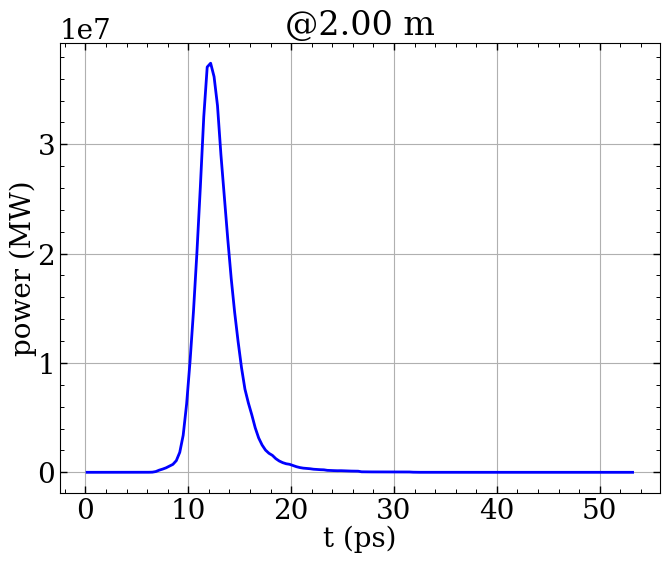

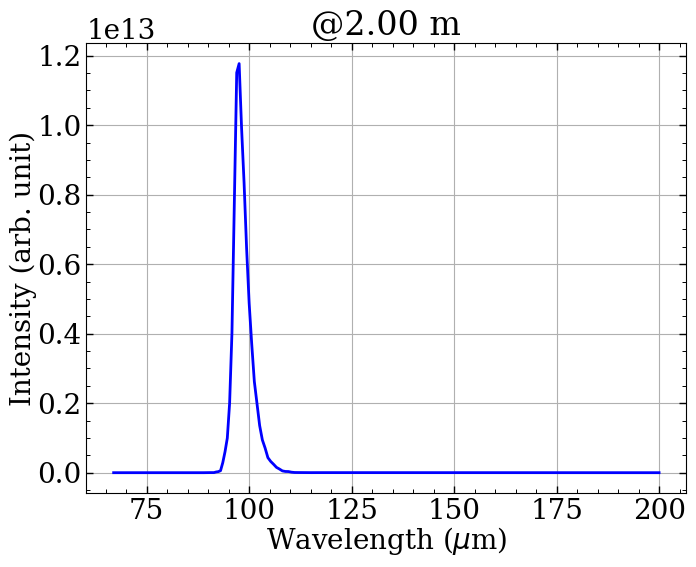

In [3]:
# pg.field

# power     = pg.get_fielddata("power",at=0.5)
# nearField = pg.get_fielddata('intensity-nearfield', at=2.0)
# farField  = pg.get_fielddata('intensity-farfield', at=2.0)

# plt.figure()
# plt.plot(pg.zbunch/2.998e8*1e12, power/1e6,'-')
# plt.xlabel("t (ps)")
# plt.ylabel("power (MW)")

# # plt.figure()
# # plt.plot(nearField,'-')

# # plt.figure()
# # plt.plot(farField,'-')

pg.plot_tpower(at=2.0)
pg.plot_spectrum(at=2.0)

Current profile is unchanged inside the undulator:

In [52]:
file.keys()
file["Beam"]["current"]

<HDF5 dataset "current": shape (1, 160), type "<f8">

(0.0, 50.0)

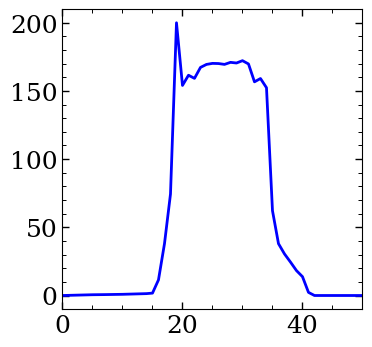

In [54]:
plt.figure()
plt.plot(file["Beam"]["current"][:].flatten(),'-')
plt.xlim([0,50])

### animation of FEL process

.h5
intensity-farfield phase-farfield 3.6000000000000076
intensity-farfield phase-farfield 0.0
intensity-farfield phase-farfield 0.03
intensity-farfield phase-farfield 0.06
intensity-farfield phase-farfield 0.09
intensity-farfield phase-farfield 0.12
intensity-farfield phase-farfield 0.15000000000000002
intensity-farfield phase-farfield 0.18000000000000005
intensity-farfield phase-farfield 0.21000000000000008
intensity-farfield phase-farfield 0.2400000000000001
intensity-farfield phase-farfield 0.27000000000000013
intensity-farfield phase-farfield 0.30000000000000016
intensity-farfield phase-farfield 0.3300000000000002
intensity-farfield phase-farfield 0.3600000000000002
intensity-farfield phase-farfield 0.39000000000000024
intensity-farfield phase-farfield 0.42000000000000026
intensity-farfield phase-farfield 0.4500000000000003
intensity-farfield phase-farfield 0.4800000000000003
intensity-farfield phase-farfield 0.5100000000000003
intensity-farfield phase-farfield 0.5400000000000004


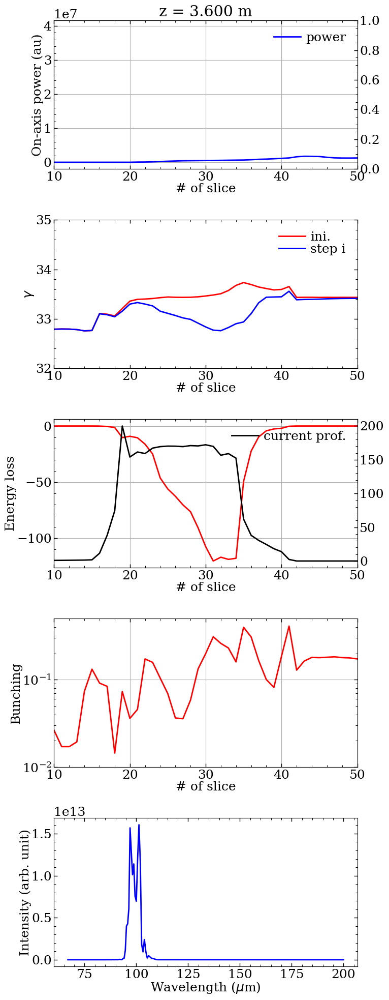

In [81]:
%matplotlib inline

# Set global styles
font = 18
plt.rcParams['font.size'] = font  # Default font size (affects labels, titles, legend)
plt.rcParams['lines.linewidth'] = 2  # Default line width
plt.rcParams['lines.markersize'] = font  # Default marker size
plt.rcParams['legend.fontsize'] = font  # Default legend font size
plt.rcParams['xtick.labelsize'] = font  # X-axis tick label size
plt.rcParams['ytick.labelsize'] = font  # Y-axis tick label size

# workdir ='/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/02_gen4/lscOFF'
workdir ='/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-34.0deg/02_gen4'

workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4"
workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_0.5nC_0.5Len_lscOFF"
workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_2nC_2Len_lscOFF"

workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_1nC_1Len_lscOFF"
os.chdir(workdir)

fname = "./gen4.seed5.nper10.fitdeg3.out.h5"

pg = PostGenesis(fname, debug=0, version=4, fig_ext = '.png')

fig, [ax1, ax2, ax3, ax4, ax5] = plt.subplots(nrows = 5, figsize = (8, 20))
ax12 = ax1.twinx()
ax32 = ax3.twinx()

# plt.show()

name1 = 'intensity-farfield'
name2 = 'phase-farfield'

ppower = pg.get_fielddata('power')
p_mid = pg.get_fielddata(name1)
phi_mid = pg.get_fielddata(name2)
gamma = pg.get_beamdata('energy')
bunching = pg.get_beamdata('bunching')

step = 2
for i in np.arange(0, ppower.shape[0], step):
# for i in [10]:
    
    # ax1.plot(p_mid[i]/p_mid[i].max(), 'r-')
    # ax12.plot(ppower[i]/ppower[i].max(), 'b-')
    # ax1.plot(p_mid[i]/p_mid[i].max(), 'r-',label='intensity-farfield')
    # ax1.plot(ppower[i]/ppower[i].max(), 'b-',label='power')
    ax1.plot(ppower[i], 'b-',label='power')
    
    # title = str.format('z = %.3f m,%0d undu.' % (pg.zplot[i], (pg.zplot[i]-0.105)/0.03))
    title = str.format('z = %.3f m' % (pg.zplot[i]))

    ax1.set_title(title)
    ax1.set_xlabel(r'# of slice')
    ax1.set_ylabel(r'On-axis power (au)')
    #ax12.set_ylabel(r'Power (au)')
    # ax1.set_ylim(0, 2e7)
    ax1.grid()
    
    ax1.set_xlim(0, 125)
    # ax1.set_xlim(0,80)
    # ax1.set_xlim(5,60)
    ax1.set_xlim(10,50)

    
    # ax1.set_ylim(0., 1.1)
    #ax1.set_yscale('log')
    ax1.legend()
    # ax12.set_ylim(0.0, 1.1)
    #ax12.set_yscale('log')
    
    ax2.plot(gamma[0], 'r-',label='ini.')
    ax2.plot(gamma[i], 'b-',label='step i')
    ax2.set_xlabel('# of slice')
    ax2.set_ylabel(r'$\gamma$')
    # ax2.grid()
    ax2.set_ylim(32, 35)
    
    # ax2.set_xlim(0, 125)
    # ax2.set_xlim(0, 125)
    ax2.set_xlim(10,50)
    # ax2.set_xlim(0,30)
    # ax2.set_xlim(20,100)
    
    ax2.legend()
    
    DE = (gamma[i]-gamma[0])*pg.current 
    # DE = (gamma[i]-gamma[0])*0.511e3 #keV
    #ax3.plot(DE/np.max(np.abs(DE)), 'r-')
    ax3.plot(DE, 'r-')
    
    # ax3.set_xlim(0, 125)
    ax3.set_xlim(10,50)
    # ax3.set_xlim(0,30)
    # ax3.set_xlim(20,100)
    
    # ax3.set_ylim(-2, 2)
    ax3.set_xlabel('# of slice')
    ax3.set_ylabel(r'Energy loss')
    ax3.grid(True)
    
    ax32.plot(pg.current, 'k-',label='current prof.')
    #ax32.set_ylabel(r'Current (A)')
    ax32.legend()
    
    ax4.plot(bunching[i], 'r-')
    ax4.set_xlabel('# of slice')
    ax4.set_ylabel('Bunching')
    
    ax4.set_ylim(1e-2, 0.5)
    ax4.set_yscale('log')
    
    # ax4.set_xlim(0, 125)
    ax4.set_xlim(10,50)
    # ax4.set_xlim(0,30)
    # ax4.set_xlim(20,100)
    
    ax4.grid(True)
    
    w, s = pg.get_spectrum(pg.zplot[i])
    #ax5.plot(w*1e6, s/np.max(s), '-')
    ax5.plot(w*1e6, s, '-')
    
    
    # w, s = calcSpectrum(p_mid[i], phi_mid[i])
    # ax5.plot(w*1e6, s/np.max(s), '-')
    
    # ax5.set_xlim(80, 120)
    #ax5.set_ylim(0, 1.1)
    # ax5.set_ylim(0, 2e13)
    
    ax5.set_xlabel(r'Wavelength ($\mu$m)')
    ax5.set_ylabel(r'Intensity (arb. unit)')
    
    # display.display(plt.gcf())
    # display.clear_output(wait=True)

    fig.tight_layout()
    fig.savefig('10to50_z_%.2fm' % pg.zplot[i] + '.png')    
    
    # plt.pause(1)
    if i<ppower.shape[0]-step:
        ax1.cla()
        ax12.cla()
        ax2.cla()
        ax3.cla()
        ax32.cla()
        ax4.cla()
        ax5.cla()


In [45]:
pg.current

array([0.00000000e+00, 1.15403119e-01, 3.10964401e-01, 4.20798562e-01,
       4.94305728e-01, 5.61592097e-01, 5.79177909e-01, 6.62302843e-01,
       7.24366296e-01, 8.05759440e-01, 8.70435574e-01, 9.92829451e-01,
       1.12137117e+00, 1.24126696e+00, 1.37553808e+00, 1.74703501e+00,
       1.14627415e+01, 3.80016887e+01, 7.43998783e+01, 1.99963634e+02,
       1.54034636e+02, 1.61499975e+02, 1.59209587e+02, 1.67231268e+02,
       1.69431238e+02, 1.70191190e+02, 1.70073147e+02, 1.69448492e+02,
       1.70946907e+02, 1.70472672e+02, 1.72174697e+02, 1.69771278e+02,
       1.56667644e+02, 1.59087866e+02, 1.52348019e+02, 6.21484822e+01,
       3.80084213e+01, 3.04889408e+01, 2.45021772e+01, 1.82500277e+01,
       1.37998811e+01, 2.28694002e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
      

# beam phase

## beam phase evo

/tmp/ipykernel_2526778/2242282020.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(15*1.2,5*1.2))


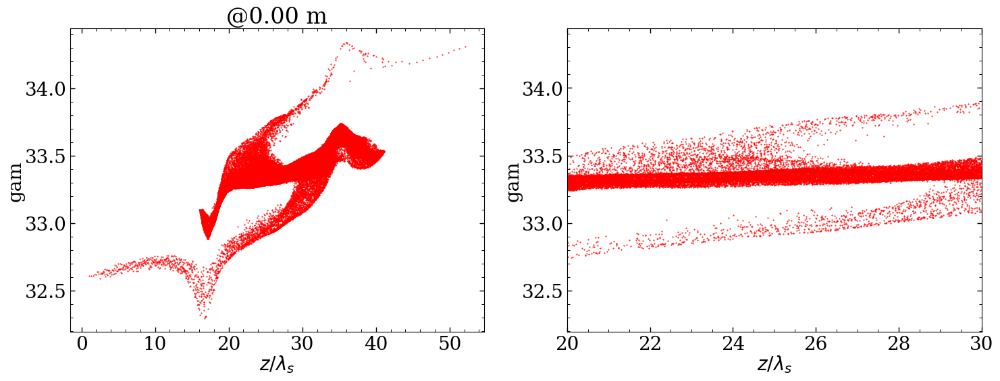

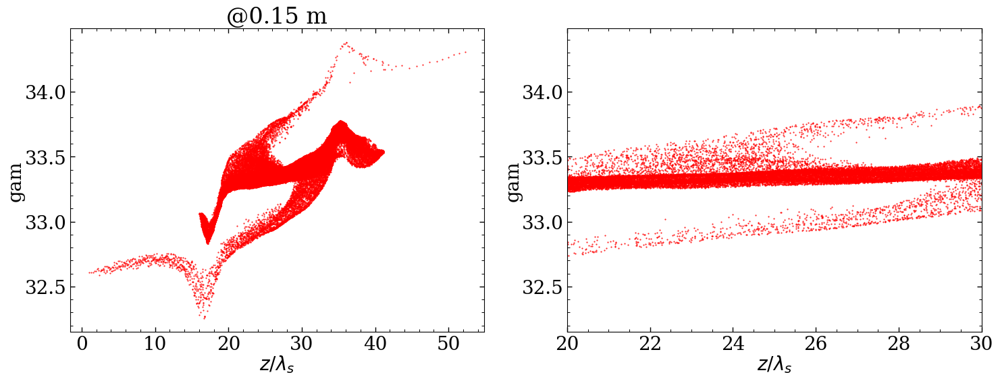

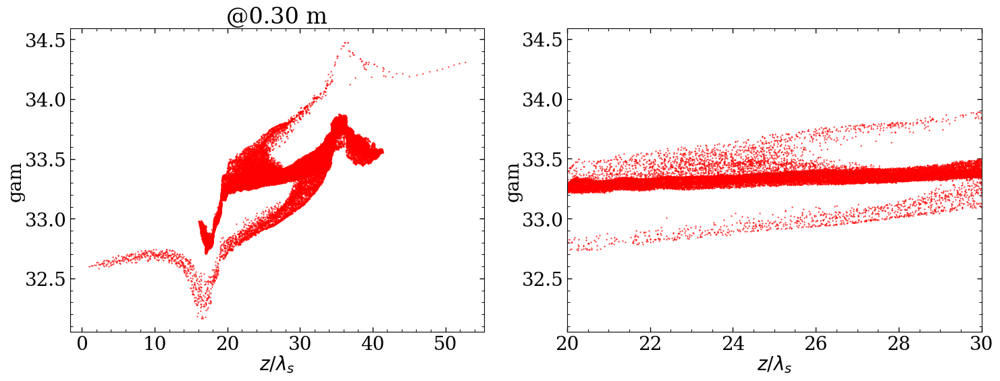

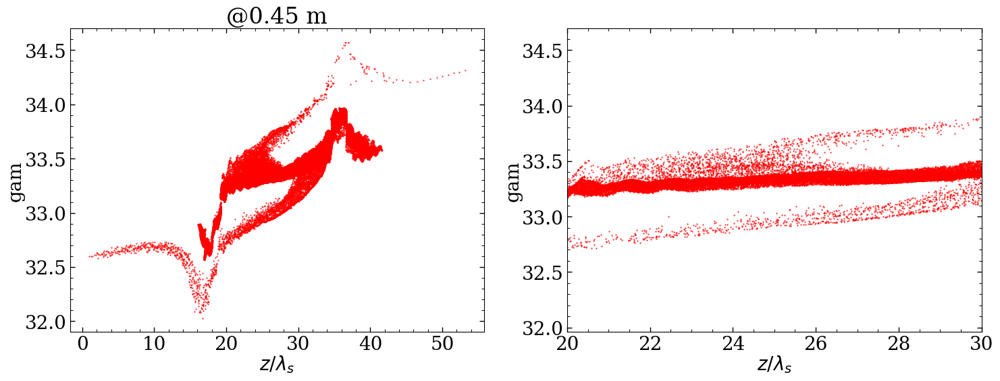

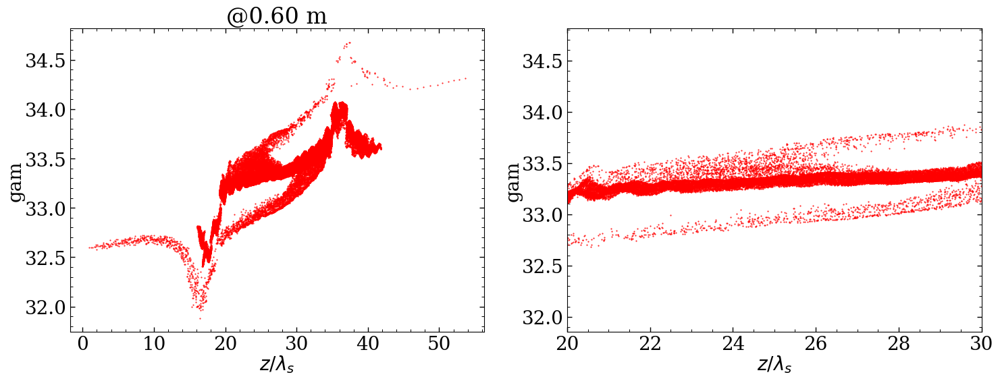

...

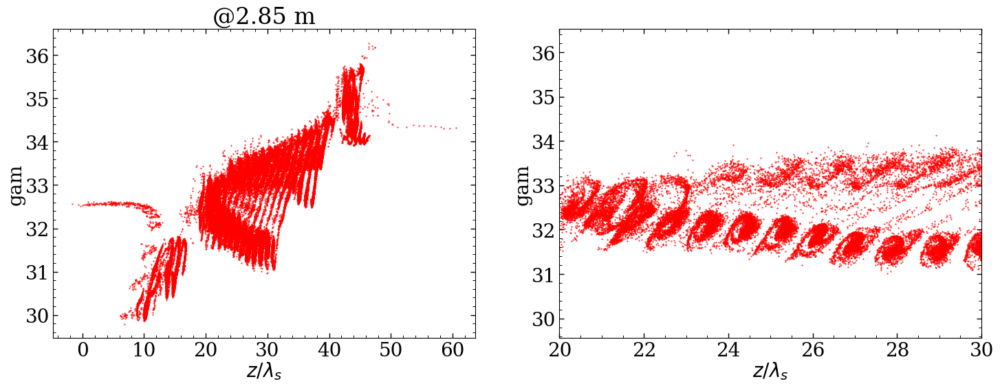

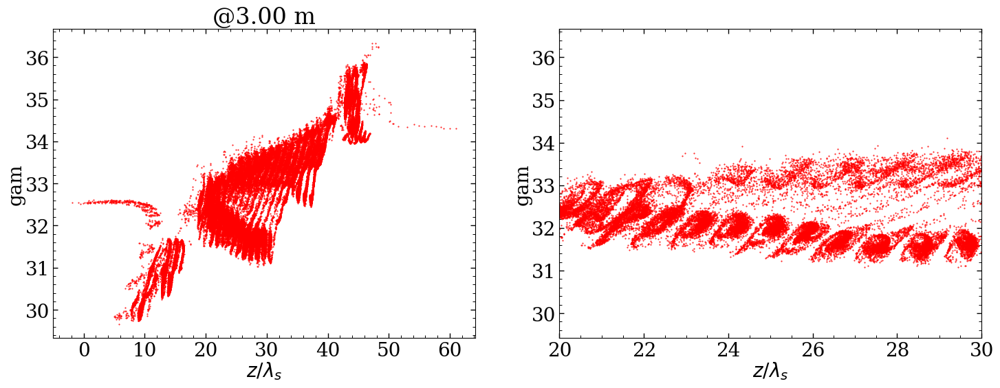

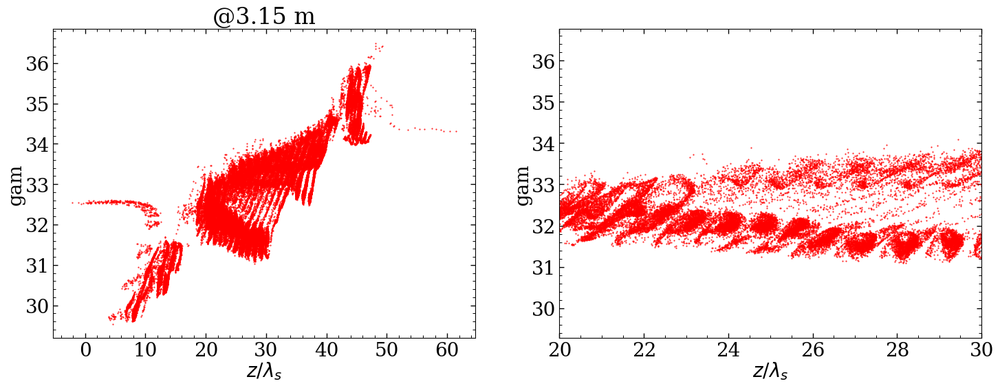

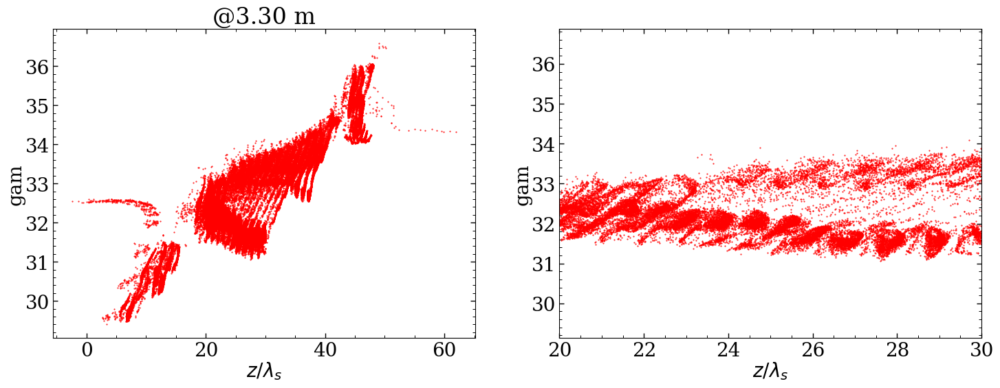

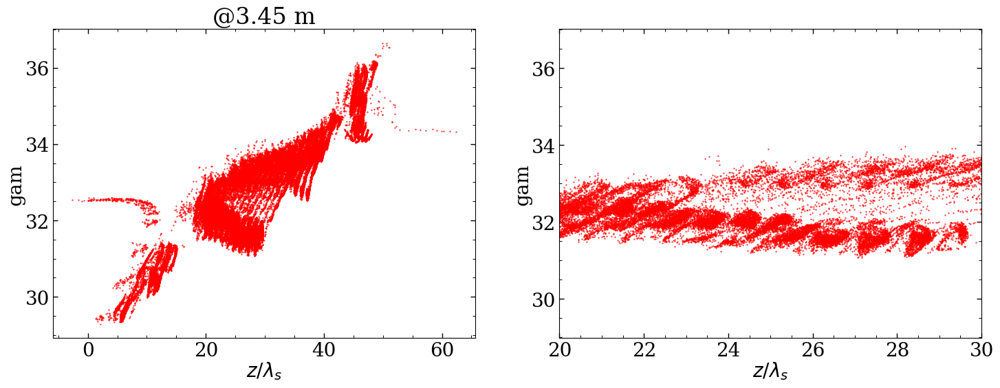

In [22]:
%matplotlib inline
import os
# workdir=r'/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/02_gen4/lscOFF/' 
# workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_1nC_1Len_lscOFF"
workdir = f"/lustre/fs22/group/pitz/biaobin/2025/gauss_bcON_1nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-32.0deg/02_gen4/Q_2nC_2Len_lscOFF"  
# workdir=r'/afs/ifh.de/user/b/biaobin/Desktop/sim1/2024/SASE_Chicane/20241202-NonCompressor-ScanPhase/cores_016_impt_32320064_impz_32320064_Np_1.00e+07_phi2_-32.0deg/02_gen4/'           

workdir=f"/afs/ifh.de/group/pitz/data/biaobin/sim1/2024/SASE_Chicane/202411-ScanBooster-S2E/20241130_grid_3232064/phi2_-32deg/02_gen4/slsc_off_lscON"
# workdir=f"/afs/ifh.de/group/pitz/data/biaobin/sim1/2024/SASE_Chicane/202411-ScanBooster-S2E/20241130_grid_3232064/phi2_-32deg/02_gen4"

os.chdir(workdir)
import h5py

for jj in range(24):
# for jj in [20]:
    fname = 'gen4.seed5.nper10.fitdeg3.'+str(jj*10)+'.par.h5'
    fname = 'gen4.'+str(jj*10)+'.par.h5'

    f = h5py.File(fname,'r')

    position_s = jj*10*0.015 #m
    s1 = 1
    s2 = 90
    
    dlamda = s1
    lamdas = 1 
    x= np.array([])
    y= np.array([])
    # for j in range(90):
    for j in np.arange(s1,s2,1):
        if j+1 < 10:
            name = 'slice000'+'00'+str(j+1)
        elif j+1 < 100:
            name = 'slice000'+'0'+str(j+1)
        elif j+1 < 1000:
            name = 'slice000'+str(j+1)
    
        x = np.append(x,f[name]['theta'][:]/(2*np.pi)*lamdas+dlamda)
        y = np.append(y,f[name]['gamma'][:])
        # plt.plot(f[name]['theta'][:]/np.pi*180+dphi,f[name]['gamma'][:],'.r')
        dlamda = dlamda +lamdas
    
    plt.figure(figsize=(15*1.2,5*1.2))
    
    plt.subplot(1,2,1)
    plt.title(f"@{position_s:.2f} m")
    plt.plot(x[::100],y[::100],'r.', markersize=1)
    plt.xlabel(r'$z/\lambda_s$')
    plt.ylabel('gam')

    plt.subplot(1,2,2)
    plt.plot(x[::200],y[::200],'r.', markersize=1)
    plt.xlim([20,30])
    plt.xlabel(r'$z/\lambda_s$')
    plt.ylabel('gam')
    

    plt.savefig(f"{position_s:.2f}m_beamPhase.png")

In [28]:
f.keys()
# f["refposition"][:]

0.015*240

3.5999999999999996

## initial beam distribution

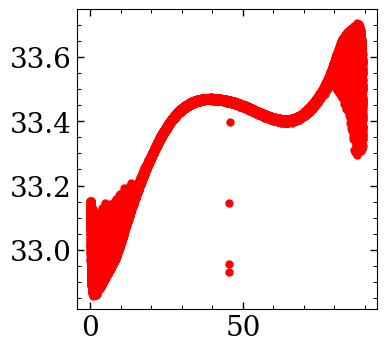

In [43]:
import os
import h5py
workdir=r'/lustre/fs22/group/pitz/biaobin/2025/flattop_bcOFF_2nC/cores_016_impt_64640064_impz_64640064_Np_5.24e+06_phi2_-12.0deg/02_gen4/lscOFF/' 
os.chdir(workdir)

fname = 'scan.seed5.nper5.fitdeg1.out.par.h5'
f = h5py.File(fname,'r')

dlamda = 0
lamdas = 1 
plt.figure()
for j in range(90):
# for j in np.arange(10,15):
    # print("j=",j)
    if j+1 < 10:
        name = 'slice000'+'00'+str(j+1)
    elif j+1 < 100:
        name = 'slice000'+'0'+str(j+1)
    elif j+1 < 1000:
        name = 'slice000'+str(j+1)
    plt.plot(f[name]['theta'][::100]/(2*np.pi)*lamdas+dlamda,f[name]['gamma'][::100],'.r')
    dlamda = dlamda +lamdas
plt.show()

In [34]:
f.keys()

<KeysViewHDF5 ['beamletsize', 'one4one', 'refposition', 'slice000001', 'slice000002', 'slice000003', 'slice000004', 'slice000005', 'slice000006', 'slice000007', 'slice000008', 'slice000009', 'slice000010', 'slice000011', 'slice000012', 'slice000013', 'slice000014', 'slice000015', 'slice000016', 'slice000017', 'slice000018', 'slice000019', 'slice000020', 'slice000021', 'slice000022', 'slice000023', 'slice000024', 'slice000025', 'slice000026', 'slice000027', 'slice000028', 'slice000029', 'slice000030', 'slice000031', 'slice000032', 'slice000033', 'slice000034', 'slice000035', 'slice000036', 'slice000037', 'slice000038', 'slice000039', 'slice000040', 'slice000041', 'slice000042', 'slice000043', 'slice000044', 'slice000045', 'slice000046', 'slice000047', 'slice000048', 'slice000049', 'slice000050', 'slice000051', 'slice000052', 'slice000053', 'slice000054', 'slice000055', 'slice000056', 'slice000057', 'slice000058', 'slice000059', 'slice000060', 'slice000061', 'slice000062', 'slice000063',